In [480]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

84


In [481]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [482]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])*(t- coeffs[3]) )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [502]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [503]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [504]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [505]:
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,1337466,North America,North America,NaN,6113.0,433.0,"+4,577",NaN,19364.0,NaN,2700859,153642.0,1209751.0,NaN,NaN
1,NaN,\n,NaN,NaN,727337,South America,South America,NaN,1036.0,25.0,416,NaN,12432.0,NaN,1746976,70324.0,949315.0,NaN,NaN
2,NaN,\n,NaN,NaN,863448,Europe,Europe,NaN,8472.0,117.0,"+5,734",NaN,6321.0,NaN,2306239,187504.0,1255287.0,NaN,NaN
3,NaN,\n,NaN,NaN,639559,Asia,Asia,NaN,7429.0,160.0,"+5,185",NaN,15905.0,NaN,1867917,47451.0,1180907.0,NaN,NaN
4,NaN,\n,NaN,NaN,146922,Africa,Africa,NaN,180.0,10.0,163,NaN,481.0,NaN,300021,7951.0,145148.0,NaN,NaN


In [506]:
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,NaN,,NaN,NaN,639559,Asia,Total:,NaN,7429.0,160.0,"+5,185",NaN,15905.0,NaN,1867917,47451.0,1180907.0,NaN,NaN
226,NaN,,NaN,NaN,146922,Africa,Total:,NaN,180.0,10.0,163,NaN,481.0,NaN,300021,7951.0,145148.0,NaN,NaN
227,NaN,,NaN,NaN,470,Australia/Oceania,Total:,NaN,27.0,NaN,NaN,NaN,2.0,NaN,9079,124.0,8485.0,NaN,NaN
228,NaN,,NaN,NaN,55,NaN,Total:,NaN,NaN,NaN,NaN,NaN,4.0,NaN,721,15.0,651.0,NaN,NaN
229,NaN,NaN,NaN,NaN,160958,Europe,European Union,296.280399,9.0,0.0,NaN,NaN,2672.0,57894.987629,1242834,131919.0,590858.0,25777773.0,2791.314015


In [507]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,1337466,North America,North America,NaN,6113.0,433.0,"+4,577",NaN,19364.0,NaN,2700859,153642.0,1209751.0,NaN,NaN
1,NaN,\n,NaN,NaN,727337,South America,South America,NaN,1036.0,25.0,416,NaN,12432.0,NaN,1746976,70324.0,949315.0,NaN,NaN
2,NaN,\n,NaN,NaN,863448,Europe,Europe,NaN,8472.0,117.0,"+5,734",NaN,6321.0,NaN,2306239,187504.0,1255287.0,NaN,NaN
3,NaN,\n,NaN,NaN,639559,Asia,Asia,NaN,7429.0,160.0,"+5,185",NaN,15905.0,NaN,1867917,47451.0,1180907.0,NaN,NaN
4,NaN,\n,NaN,NaN,146922,Africa,Africa,NaN,180.0,10.0,163,NaN,481.0,NaN,300021,7951.0,145148.0,NaN,NaN


In [508]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
114,108.0,"1,517","35,828",7,249,Europe,Lithuania,28.0,0.0,0.0,0,"2,722,962",16.0,143394.0,1795,76.0,1470.0,390457.0,659.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


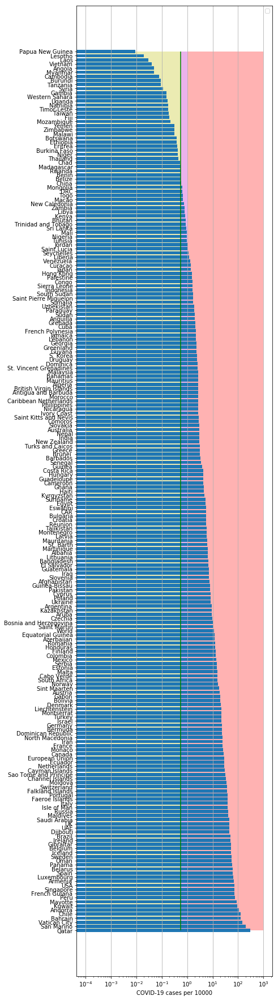

In [509]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


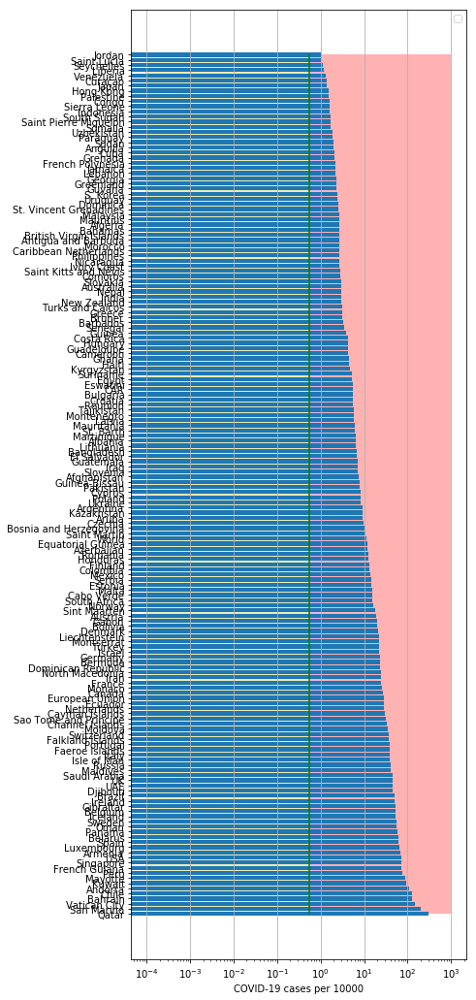

In [510]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

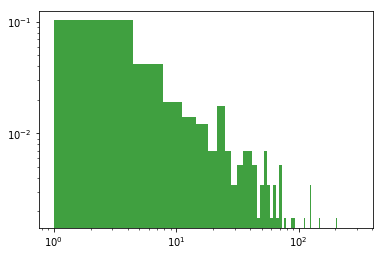

In [511]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [512]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date   cases  active    death
112 2020-06-16  291408       0  27136.0
113 2020-06-17  291763       0  27136.0
114 2020-06-18  292348       0  27136.0
115 2020-06-19  292655       0  28315.0
116 2020-06-20  293018       0  28322.0
GB
           date   cases  active    death
111 2020-06-16  298136       0  41969.0
112 2020-06-17  299251       0  42153.0
113 2020-06-18  300469       0  42288.0
114 2020-06-19  301815       0  42461.0
115 2020-06-20  303110       0  42589.0
IT
           date   cases  active    death
114 2020-06-16  237101   24569  34405.0
115 2020-06-17  237429   23925  34448.0
116 2020-06-18  237760   23101  34514.0
117 2020-06-19  238011   21543  34561.0
118 2020-06-20  238275   21212  34610.0
LT
           date   cases  active  death     tests
99  2020-06-16  1778.0     245   76.0  375572.0
100 2020-06-17  1784.0     249   76.0  381225.0
101 2020-06-18  1792.0     254   76.0  386194.0
102 2020-06-19  1795.0     249   76.0  390457.0
103 2020-06-20  1795.0  

PM
           date  cases   active  death
98  2020-06-16  21962   7731.0  457.0
99  2020-06-17  22597   8353.0  470.0
100 2020-06-18  23351   9094.0  475.0
101 2020-06-19  24274   9430.0  485.0
102 2020-06-20  25222  10370.0  493.0
PU
           date   cases    active   death
101 2020-06-16  237156  104895.0  7056.0
102 2020-06-17  240908  105029.0  7257.0
103 2020-06-18  244388  105737.0  7461.0
104 2020-06-19  247925  104745.0  7660.0
105 2020-06-20  251338  104714.0  7861.0
SB
           date  cases  active  death
98  2020-06-16  12426   659.0  256.0
99  2020-06-17  12522   754.0  257.0
100 2020-06-18  12616   847.0  258.0
101 2020-06-19  12709   939.0  259.0
102 2020-06-20  12803  1032.0  260.0
AG
           date    cases   active  death
104 2020-06-16  34159.0  23107.0  878.0
105 2020-06-17  35552.0  24127.0  913.0
106 2020-06-18  37510.0  25841.0  948.0
107 2020-06-19  39570.0  26740.0  979.0
108 2020-06-20  41204.0  28006.0  992.0
CT
           date   cases  active  death
108 20

In [513]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [514]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.6078114034498203
intercept: -0.9547291937476623
slope: [0.06012444]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


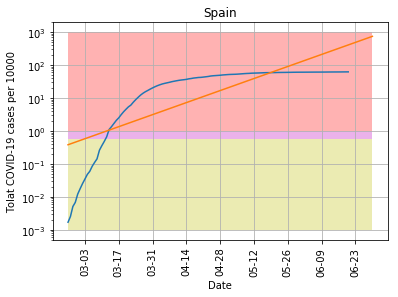

In [515]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-06-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [516]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.7453929830716097
intercept: -2.5646103079143074
slope: [0.07265801]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


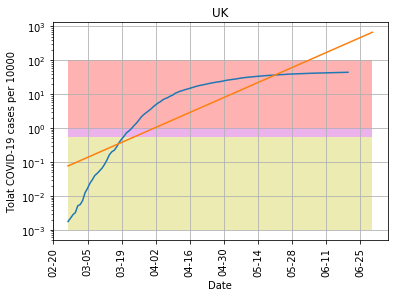

In [517]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-06-30', "pictures/coronaGB.png", model1, 'UK',100)

In [518]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9651926281851285
intercept: 1.5808917559364848
slope: [-0.04175715]


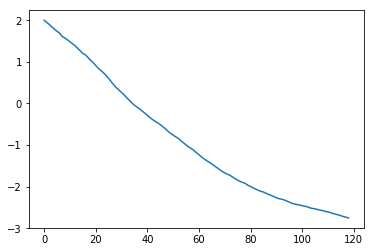

In [519]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


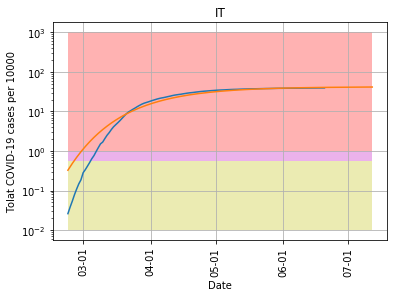

In [520]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [521]:
cs=y_pred11[-1]/10000.*populationIT

In [522]:
cs

250448.13573254354

In [523]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.5317359482033439
intercept: -1.1188554186640074
slope: [0.03995618]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


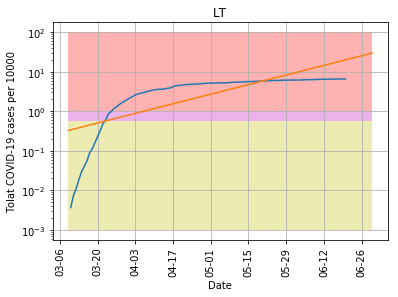

In [524]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-06-30', "pictures/coronaLT.png", model1, 'LT',100)

In [525]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7682587104324923
intercept: -4.3671215111212796
slope: [0.07929839]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


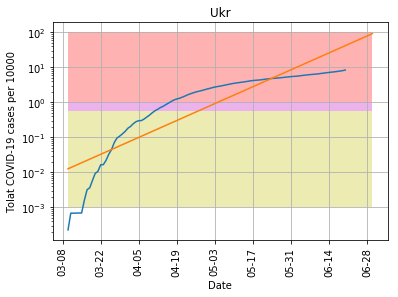

In [526]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-06-30', "pictures/coronaUkr.png", model11, 'Ukr',100)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


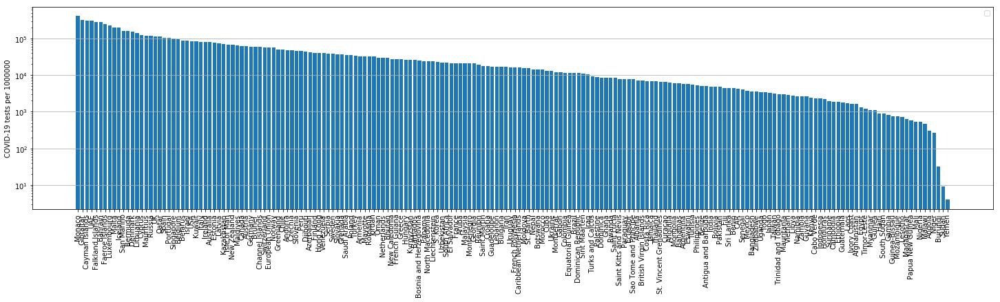

In [527]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [528]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7113158235271237
intercept: -2.015490795940298
slope: [0.07326036]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


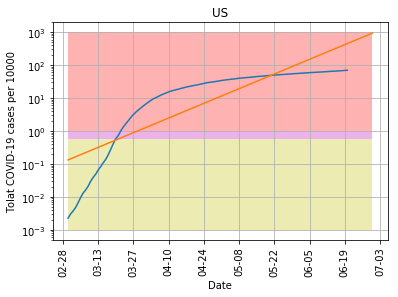

In [529]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-06-30', "pictures/coronaUS.png", model11, 'US',1000)

In [530]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
229  European Union  0.106144


(0, 0.15)

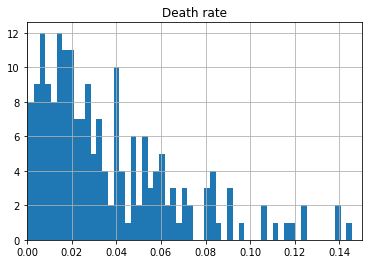

In [531]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

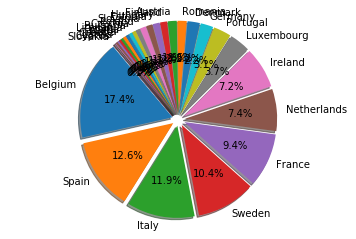

In [532]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [533]:
dfTTh.head()

,Country,Deathsper1Mpop
28,Belgium,837.0
12,Spain,606.0
14,Italy,572.0
30,Sweden,500.0
21,France,454.0


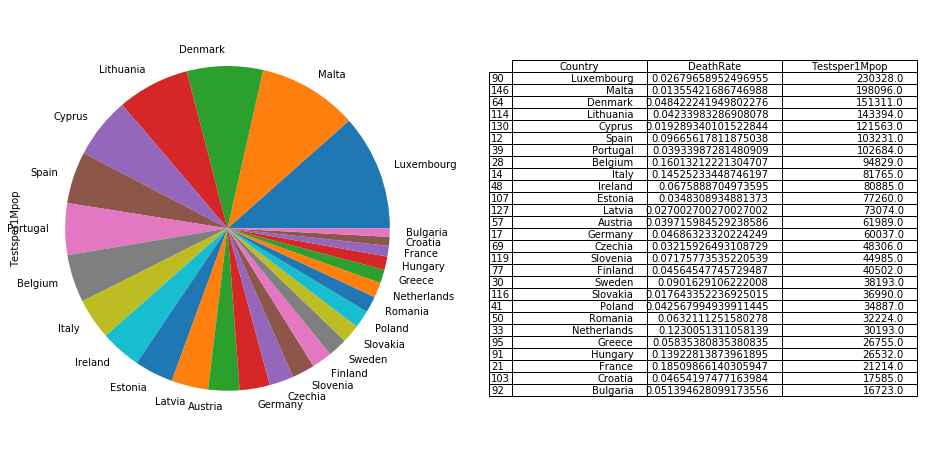

In [534]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

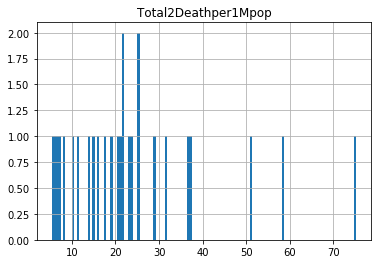

In [535]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [536]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
12,Spain,6267.0,606.0
14,Italy,3941.0,572.0
17,Germany,2282.0,107.0
21,France,2453.0,454.0
28,Belgium,5225.0,837.0


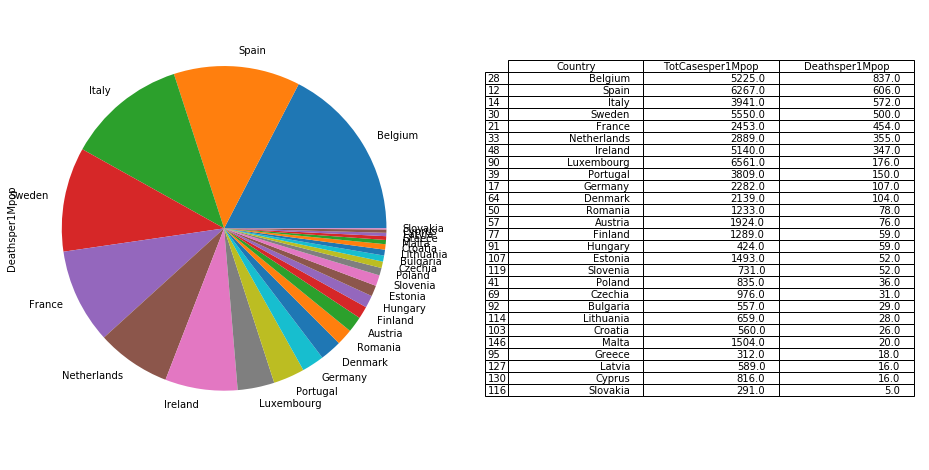

In [537]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [538]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,0.0,\n,0,0,1337466,North America,North America,0.0,6113.0,433.0,"+4,577",0,19364.0,0.0,2700859,153642.0,1209751.0,0.0,0.0
1,0.0,\n,0,0,727337,South America,South America,0.0,1036.0,25.0,416,0,12432.0,0.0,1746976,70324.0,949315.0,0.0,0.0
2,0.0,\n,0,0,863448,Europe,Europe,0.0,8472.0,117.0,"+5,734",0,6321.0,0.0,2306239,187504.0,1255287.0,0.0,0.0
3,0.0,\n,0,0,639559,Asia,Asia,0.0,7429.0,160.0,"+5,185",0,15905.0,0.0,1867917,47451.0,1180907.0,0.0,0.0
4,0.0,\n,0,0,146922,Africa,Africa,0.0,180.0,10.0,163,0,481.0,0.0,300021,7951.0,145148.0,0.0,0.0


In [539]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
12,Spain,0.060709
14,Italy,0.048199
17,Germany,0.038010
21,France,0.115631
28,Belgium,0.055099


In [540]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.145315
      France             0.115631
 Netherlands             0.095684
     Ireland             0.063547
       Spain             0.060709
     Belgium             0.055099
       Italy             0.048199
     Romania             0.038263
     Germany             0.038010
    Portugal             0.037094
    Bulgaria             0.033307
     Croatia             0.031845
     Finland             0.031826
     Austria             0.031038
  Luxembourg             0.028485
      Poland             0.023934
     Czechia             0.020205
     Estonia             0.019324
    Slovenia             0.016250
     Hungary             0.015981
     Denmark             0.014136
      Greece             0.011661
      Latvia             0.008060
    Slovakia             0.007867
       Malta             0.007592
      Cyprus             0.006713
   Lithuania             0.004596


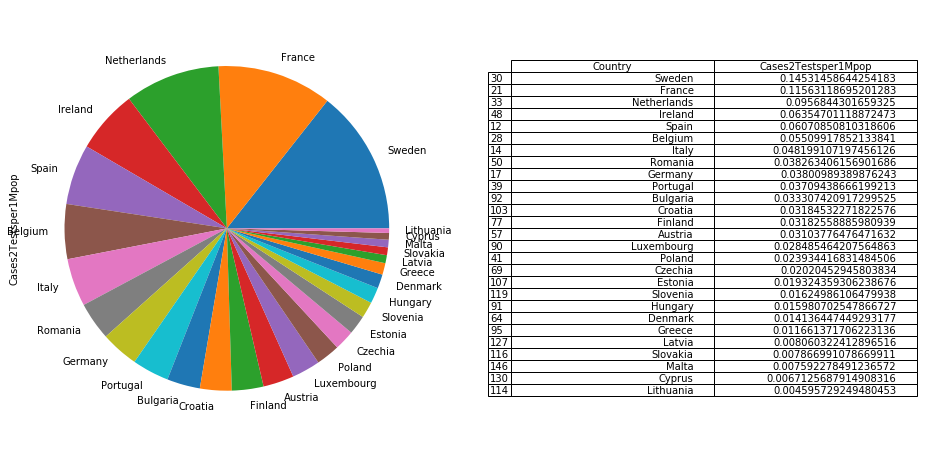

In [541]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [542]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
36,Singapore,0.000618,98510.000000
26,Qatar,0.001087,113147.000000
156,Réunion,0.001980,19215.000000
105,French Guiana,0.002312,27015.000000
72,Nepal,0.002557,14474.000000
142,Rwanda,0.002849,8346.000000
52,Bahrain,0.002860,276869.000000
78,Uzbekistan,0.003057,22376.000000
104,Maldives,0.003658,65775.000000
139,Palestine,0.003827,8804.000000


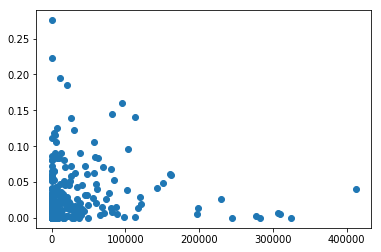

In [543]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.5/dist-packages/matplotlib/patches.py:694: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.5/dist-packages/matplotlib/projections/polar.py:67: RuntimeWarning: invalid value encountered in less
  mask = r < 0


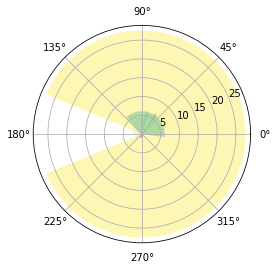

In [544]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

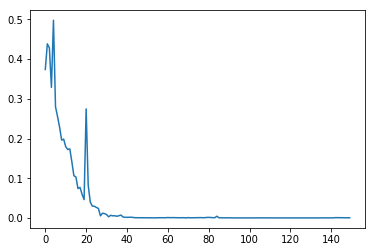

In [545]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [546]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


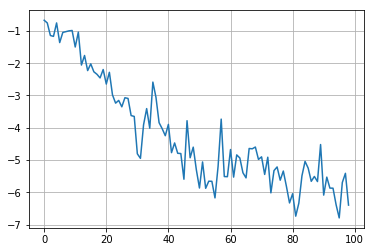

In [547]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

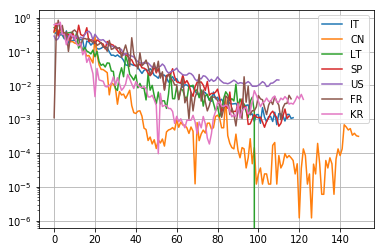

In [548]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

111 111
coefficient of determination: 0.8195284496260946
intercept: -9.825838494524557
slope: [-0.10702493]


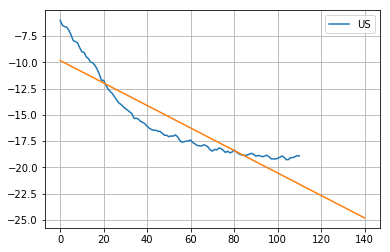

In [549]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [550]:
#np.diff(dfIT["cases"])

118 118
coefficient of determination: 0.8934953283989965
intercept: -10.156486751382102
slope: [-0.09252046]


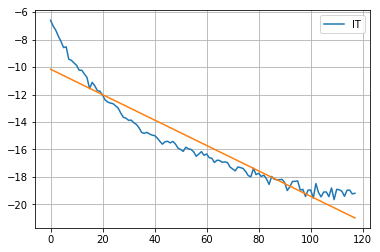

In [551]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [552]:
#model11.coef_

In [553]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

100 100
coefficient of determination: 0.894121111803065
intercept: -15.327583820616637
slope: [-0.05678844]


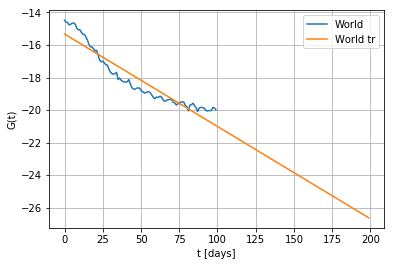

In [554]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

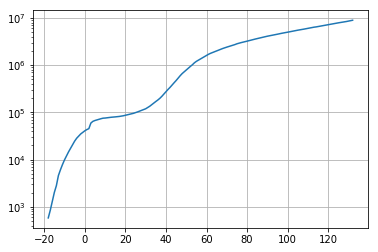

In [555]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [556]:
dfW['cases'].values

array([    580,     845,    1317,    2015,    2800,    4581,    6058,
          7813,    9823,   11950,   14553,   17391,   20630,   24545,
         28266,   31439,   34876,   37552,   40553,   43099,   45134,
         59287,   64438,   67100,   69197,   71329,   73332,   75184,
         75700,   76677,   77673,   78651,   79205,   80087,   80828,
         81820,   83112,   84615,   86604,   88585,   90443,   93016,
         95314,   98425,  102050,  106099,  109991,  114381,  118948,
        126214,  134576,  145483,  156653,  169593,  182490,  198238,
        218822,  244933,  275597,  305036,  337489,  378860,  422629,
        471035,  531864,  596366,  663079,  723279,  784738,  858355,
        936237, 1016330, 1117928, 1203058, 1274578, 1347566, 1432869,
       1519195, 1605277, 1700004, 1780713, 1853505, 1925330, 2000065,
       2084633, 2183942, 2252370, 2332650, 2407467, 2482272, 2557917,
       2638909, 2725972, 2833697, 2921571, 2995209, 3065871, 3139009,
       3221029, 3308

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 1.50584468e+07  1.03594996e+00 -9.43947989e+01  1.91499589e-02]


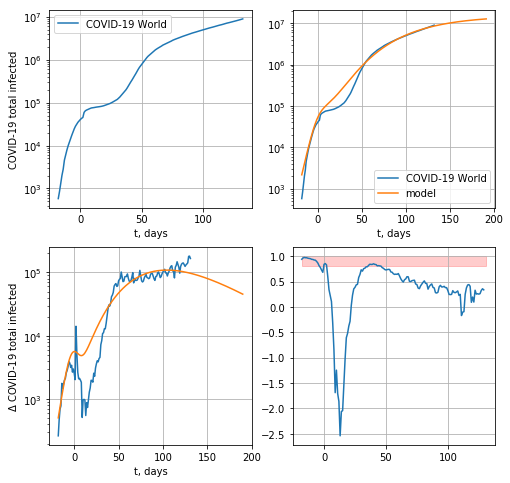

144898.48576708708


In [557]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

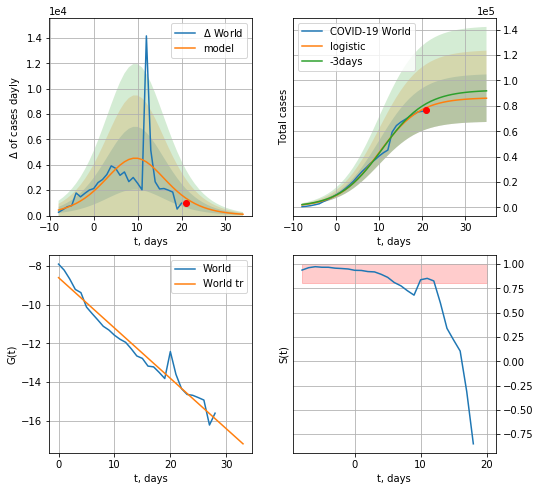

World data at: 2020-06-20
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +14 days
	 deltaDaycases:  105
	 total cases:  86019 ± 18735
	 total death:  4497 ± 2938
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


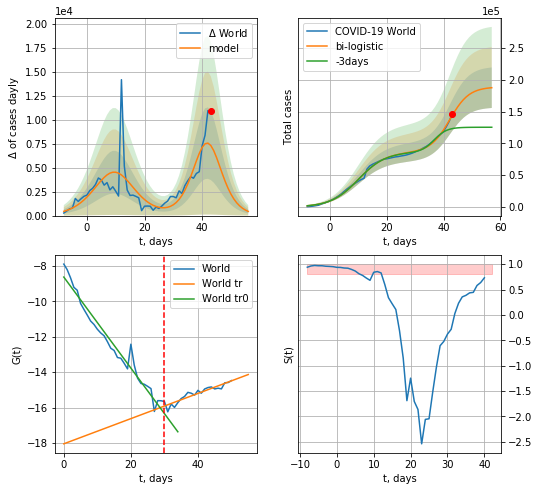

World data at: 2020-06-20
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +14 days
	 deltaDaycases:  435
	 total cases:  187412 ± 31846
	 total death:  9799 ± 4995
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


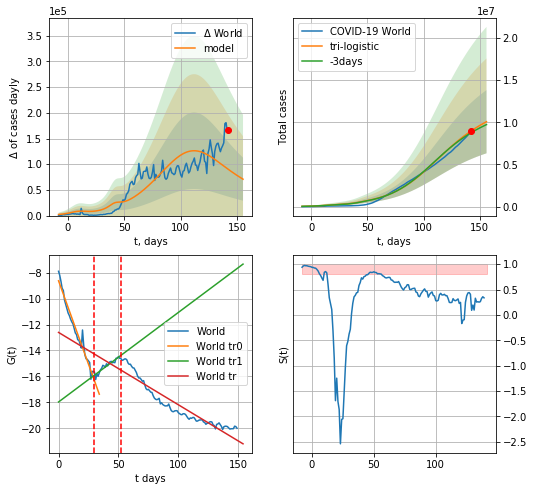

World data at: 2020-06-20
+3 day model MAPE: 0.025075135142078764
model: tri-logistic
coeffs:  [9.86193511e+06 4.80564271e-02 1.09754123e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.372152409011522
forecast at the end of period: +14 days
	 deltaDaycases:  70854
	 total cases:  10067258 ± 3746554
	 total death:  526379 ± 587679
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.889181
 intercept: -12.609346
 slope: -0.055748


In [559]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*14-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*14-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*14-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

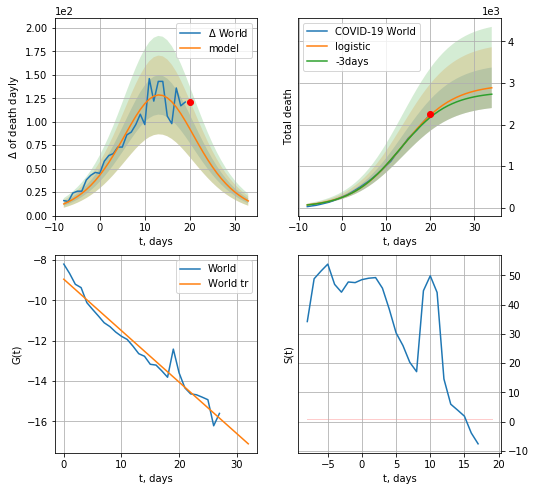

World data at: 2020-06-20
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +14 days
	 total death:  2884 ± 488
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


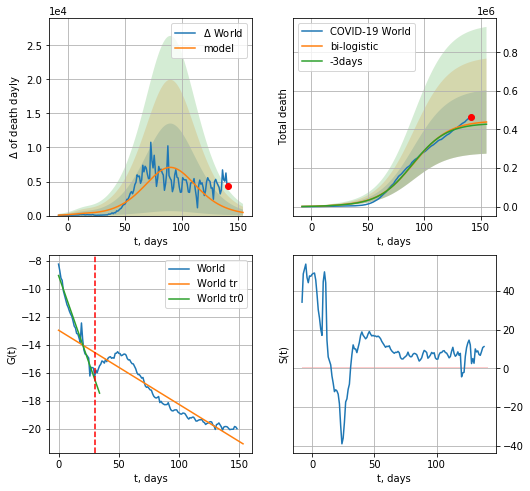

World data at: 2020-06-20
+3 day model MAPE: 0.02295705030172747
model: bi-logistic
coeffs:  [4.42689179e+05 6.39772154e-02 9.06441242e+01] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.3746254453751248
forecast at the end of period: +14 days
	 deltaDaydeath:  460
	 total death:  438563 ± 164297
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.900619
 intercept: -12.941382
 slope: -0.053155


In [560]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*14-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*14-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [561]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


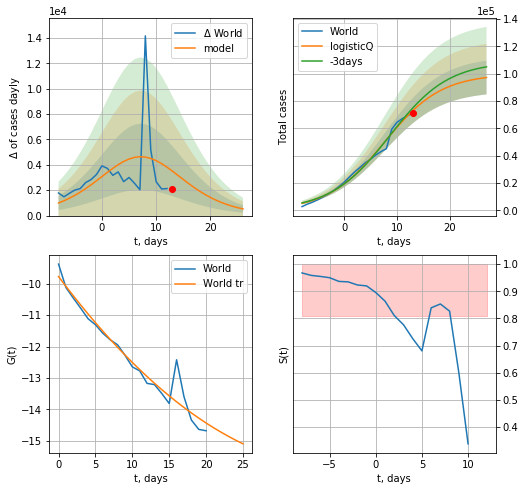

World data at: 2020-06-20
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +14 days
	 deltaDaycases: 524
	 total cases: 97221 ± 12343
	 total death: 5083 ± 1935
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


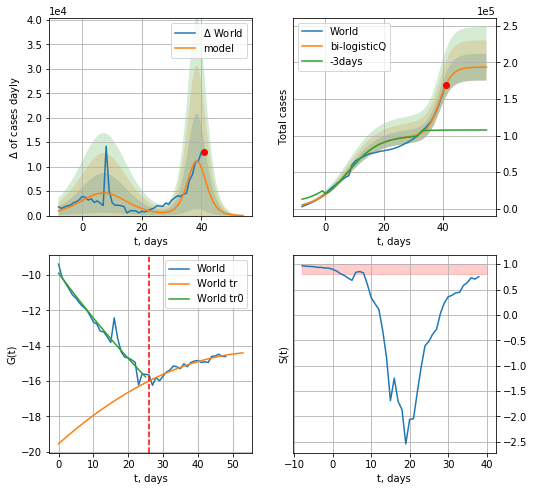

World data at: 2020-06-20
+3 day model MAPE: 0.635593
model: bi-logisticQ
coeffs: [ 9.37578627e+04  2.55228565e-05  3.89552969e+01 -1.87082152e+04]
rational stdev: 0.094698
forecast at the end of period: +14 days
	 deltaDaycases: 29
	 total cases: 193564 ± 18330
	 total death: 10120 ± 2875
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


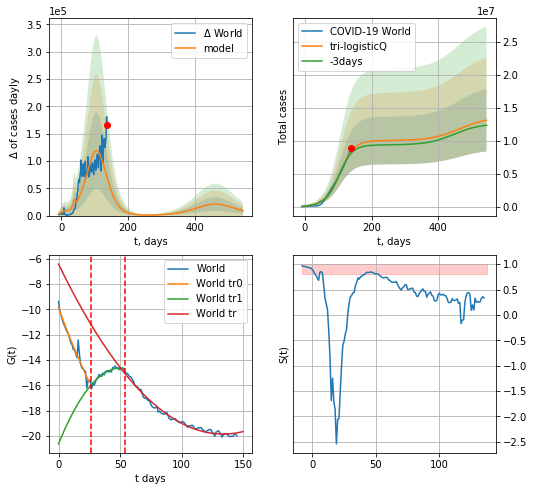

World data at: 2020-06-20
+3 day model MAPE: 0.033026
model: tri-logisticQ
coeffs: [ 9.84166097e+06  2.65418350e-07  1.05706095e+02 -1.81409766e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.360809
forecast at the end of period: +406 days
	 deltaDaycases: 8830
	 total cases: 13111789 ± 4730847
	 total death: 685566 ± 742074
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.986606
 intercept_: -6.432830631674195
 coeffs_: [ 0.         -0.20059358  0.00074962]


In [562]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*14-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*14-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


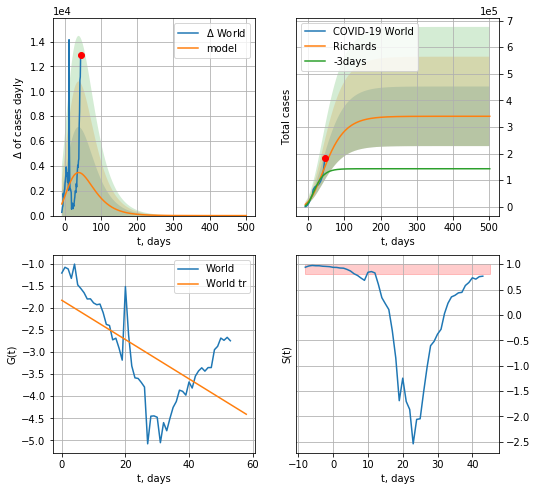

World data at: 2020-06-20
+3 day model MAPE: 0.241624
model: Richards
coeffs: [ 3.40077948e+05  3.51040118e+00 -1.35212982e+02  7.92067107e-03]
rational stdev: 0.329278
forecast at the end of period: +456 days
	 deltaDaycases: 0
	 total cases: 340077 ± 111979
	 total death: 17781 ± 17564
trend coefficient of determination: 0.389866
 intercept: -1.829818
 slope: -0.044449


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


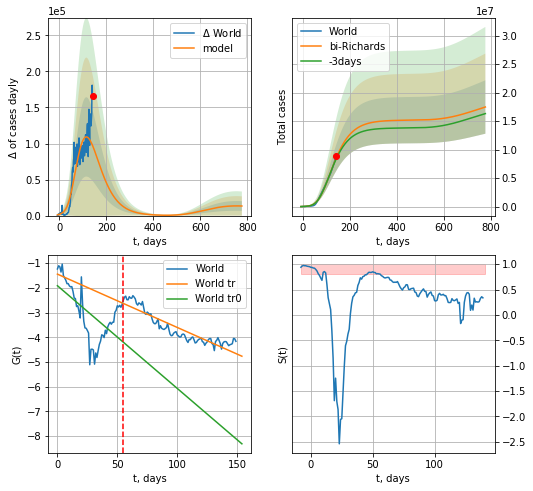

World data at: 2020-06-20
+3 day model MAPE: 0.021023
model: bi-Richards
coeffs: [ 1.48418990e+07  1.77460143e+00 -1.09231838e+02  1.12257907e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.267993
forecast at the end of period: +636 days
	 deltaDaycases: 13293
	 total cases: 17478196 ± 4684025
	 total death: 913869 ± 734730
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.357434
 intercept: -1.914006
 slope: -0.041563
trend coefficient of determination: 0.832128
 intercept: -1.444848
 slope: -0.021578


In [563]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

151


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


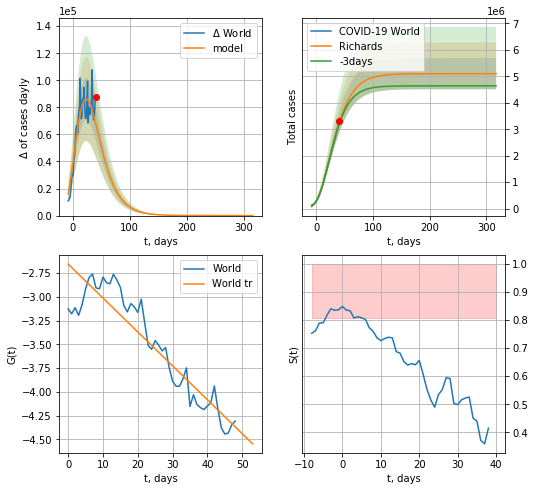

World data at: 2020-06-20
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10254335e+06  1.04395582e+00 -4.20545297e+01  4.49970923e-02]
rational stdev: 0.115529
forecast at the end of period: +276 days
	 deltaDaycases: 0
	 total cases: 5102537 ± 589489
	 total death: 266792 ± 92466
trend coefficient of determination: 0.854892
 intercept: -2.655636
 slope: -0.035656


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


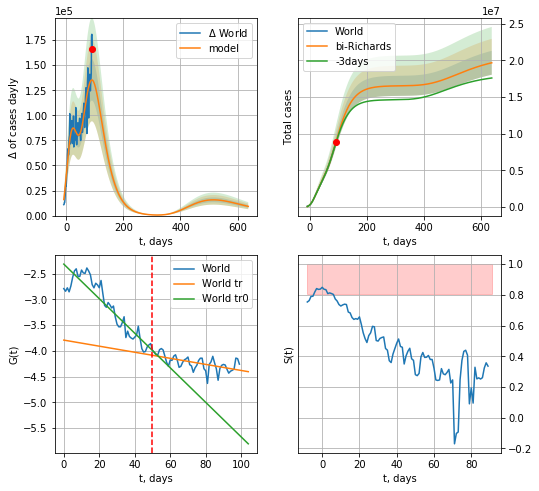

World data at: 2020-06-20
+3 day model MAPE: 0.011815
model: bi-Richards
coeffs: [ 1.14459952e+07  1.77958744e+00 -4.04431815e+01  1.69789257e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.082811
forecast at the end of period: +546 days
	 deltaDaycases: 9156
	 total cases: 19674461 ± 1629254
	 total death: 1028703 ± 255562
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.842139
 intercept: -2.317104
 slope: -0.033533
trend coefficient of determination: 0.355133
 intercept: -3.791796
 slope: -0.005892


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


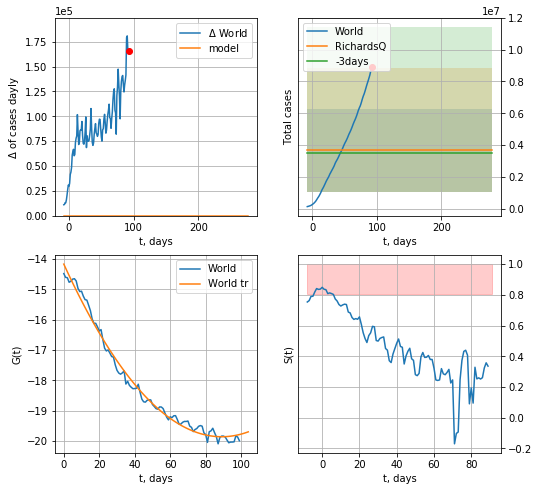

World data at: 2020-06-20
+3 day model MAPE: 0.044414
model: RichardsQ
coeffs: [ 3.66698945e+06  5.82810576e-01 -4.00381876e+02  3.48449136e+02
 -5.00072503e-01]
rational stdev: 0.705662
forecast at the end of period: +186 days
	 deltaDaycases: 0
	 total cases: 3666989 ± 2587653
	 total death: 191733 ± 405895
trend coefficient of determination: 0.989621
 intercept_: -14.165492797050923
 coeffs_: [ 0.         -0.12793998  0.00071872]


In [564]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,70*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-50)
x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


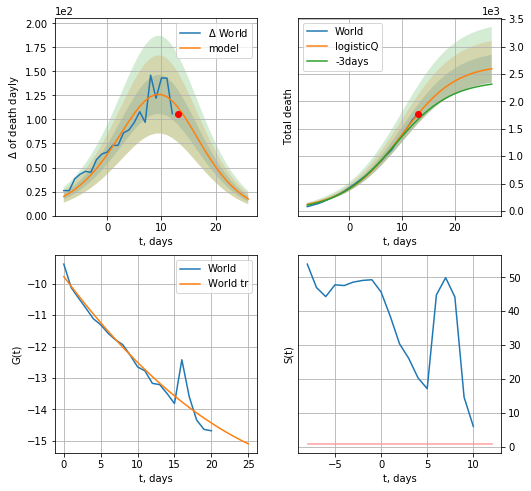

World data at: 2020-06-20
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +14 days
	 total death: 2596 ± 254
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


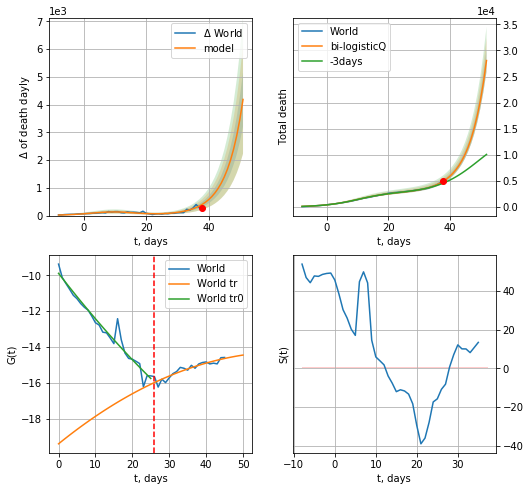

World data at: 2020-06-20
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +14 days
	 total death: 28055 ± 2148
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp


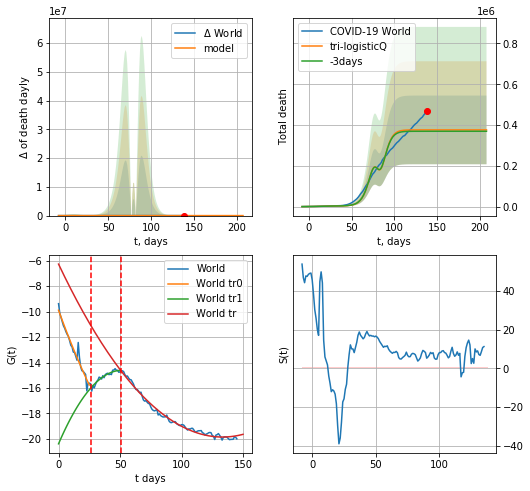

World data at: 2020-06-20
+3 day model MAPE: 0.018195
model: tri-logisticQ
coeffs: [-6.04855347e+06  9.43558944e-04 -1.70573378e+02  7.95656485e+01]
rational stdev: 0.447445
forecast at the end of period: +70 days
	 total death: 376158 ± 168310
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.988627
 intercept_: -6.266742315791342
 coeffs_: [ 0.         -0.20380168  0.00076443]


In [566]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*14-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*14-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


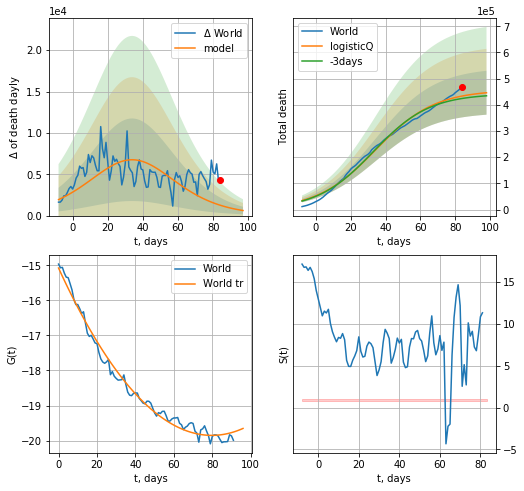

World data at: 2020-06-20
+3 day model MAPE: 0.022291
model: logisticQ
coeffs: [ 4.56494140e+05  3.44151590e-07  3.43302527e+01 -1.71907515e+05]
rational stdev: 0.187844
forecast at the end of period: +14 days
	 total death: 446197 ± 83815
trend coefficient of determination: 0.986606
 intercept_: -15.077842885418338
 coeffs_: [ 0.         -0.11970768  0.00075042]


In [568]:
x = forecastRRR("World",dfW[58:],d1,7*14-dT,1.0,False,cases='death')

In [569]:
#trend(dfSP,'SP',10)

In [570]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
           date   cases  active    death
112 2020-06-16  291408       0  27136.0
113 2020-06-17  291763       0  27136.0
114 2020-06-18  292348       0  27136.0
115 2020-06-19  292655       0  28315.0
116 2020-06-20  293018       0  28322.0


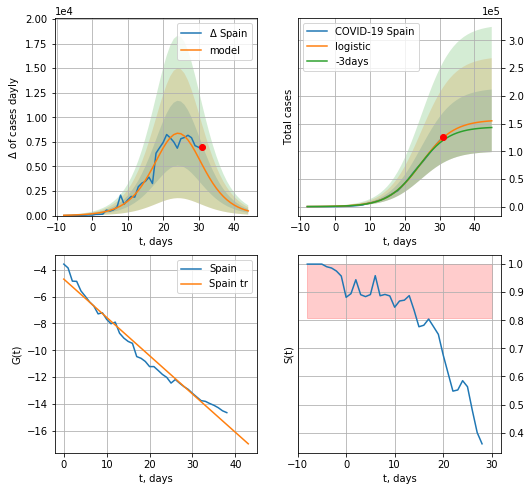

Spain data at: 2020-06-20
+3 day model MAPE: 0.04562669977631666
model: logistic
coeffs:  [1.56957534e+05 2.13812412e-01 2.47399190e+01]
rational stdev:  0.3648922799171356
forecast at the end of period: +14 days
	 deltaDaycases:  477
	 total cases:  154921 ± 56529
	 total death:  14974 ± 16391
trend coefficient of determination: 0.974785
 intercept: -4.699916
 slope: -0.285083


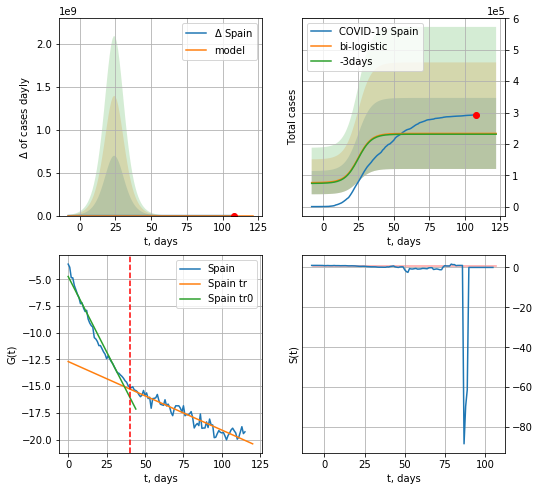

Spain data at: 2020-06-20
+3 day model MAPE: 0.01063169592686234
model: bi-logistic
coeffs:  [ 6.10968395e+04 -5.55383329e+00  1.45623554e+02] [1.56957534e+05 2.13812412e-01 2.47399190e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.48535784191788856
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  233328 ± 113247
	 total death:  22552 ± 32837
bi-logistic approximation splitting point: 40
trend0 coefficient of determination: 0.974598
 intercept: -4.739484
 slope: -0.281959
trend coefficient of determination: 0.911246
 intercept: -12.702383
 slope: -0.064165


In [572]:
dfSP = read_df(pd.DataFrame(),"SP")
vL = 40#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,7*14-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

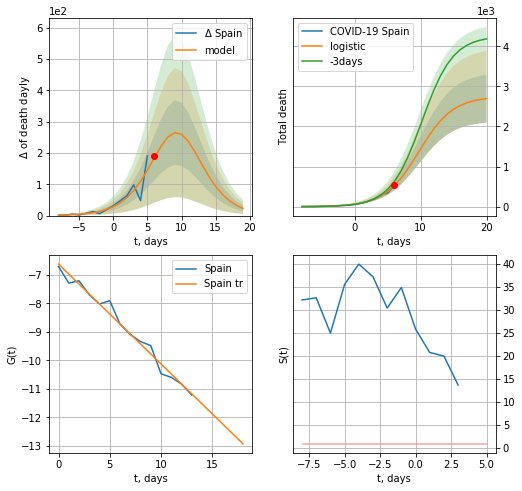

Spain data at: 2020-06-20
+3 day model MAPE: 0.1992580202993838
model: logistic
coeffs:  [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.22139705331908888
forecast at the end of period: +14 days
	 total death:  2695 ± 596
trend coefficient of determination: 0.980020
 intercept: -6.621221
 slope: -0.350134


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: invalid value encountered in true_divide


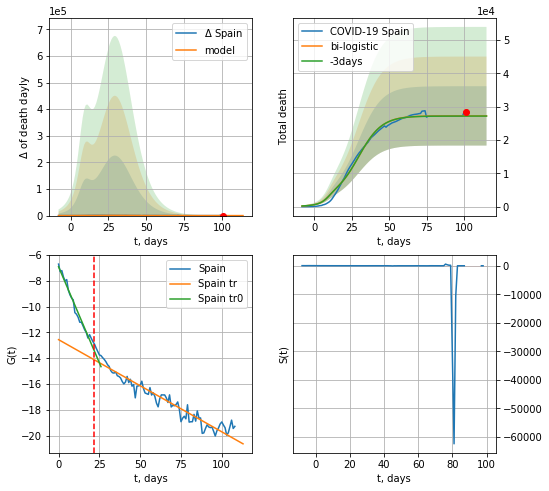

Spain data at: 2020-06-20
+3 day model MAPE: 0.002041925752423516
model: bi-logistic
coeffs:  [2.44634807e+04 1.28813116e-01 2.97439999e+01] [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.3269519083984407
forecast at the end of period: +14 days
	 deltaDaydeath:  0
	 total death:  27208 ± 8895
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.976968
 intercept: -6.910878
 slope: -0.297821
trend coefficient of determination: 0.928217
 intercept: -12.560726
 slope: -0.071455


In [574]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*14-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*14-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


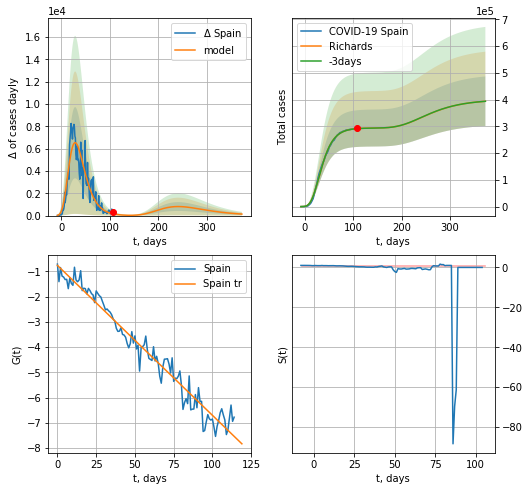

Spain data at: 2020-06-20
+3 day model MAPE: 0.000655
model: Richards
coeffs: [ 2.93918378e+05  9.51468716e+00 -5.45020308e+01  6.36810987e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.235243
forecast at the end of period: +266 days
	 deltaDaycases: 136
	 total cases: 393710 ± 92617
	 total death: 38054 ± 26855
trend coefficient of determination: 0.961701
 intercept: -0.763318
 slope: -0.059376


In [575]:
x = forecastRR('Spain',dfSP[1:],d1,7*50-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


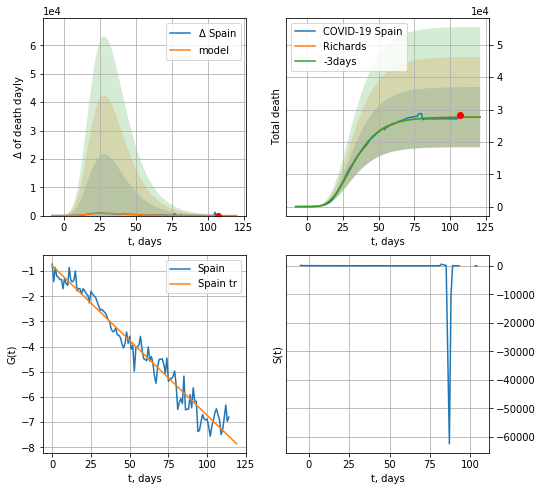

Spain data at: 2020-06-20
+3 day model MAPE: 0.001040
model: Richards
coeffs: [ 2.76804629e+04  9.23134470e+00 -3.00672000e+01  8.76209784e-03]
rational stdev: 0.335905
forecast at the end of period: +14 days
	 total death: 27664 ± 9292
trend coefficient of determination: 0.961897
 intercept: -0.782429
 slope: -0.059508


In [577]:
x = forecastRR('Spain',dfSP[1:],d1,7*14-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


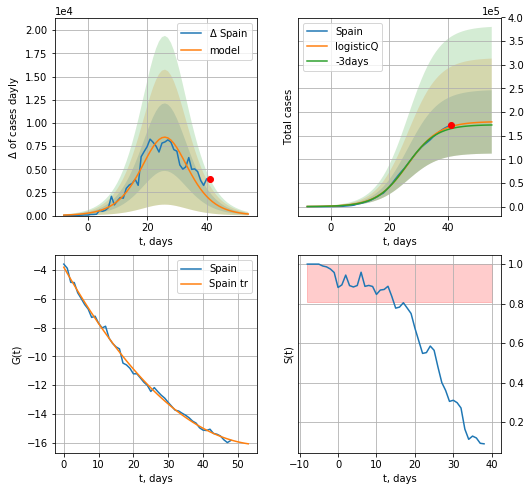

Spain data at: 2020-06-20
+3 day model MAPE: 0.028163
model: logisticQ
coeffs: [ 1.79944314e+05  4.82942779e-06  2.63952863e+01 -3.89581546e+04]
rational stdev: 0.373922
forecast at the end of period: +14 days
	 deltaDaycases: 168
	 total cases: 179126 ± 66979
	 total death: 17313 ± 19421
trend coefficient of determination: 0.997334
 intercept_: -3.7990007659330134
 coeffs_: [ 0.         -0.42831531  0.00370949]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


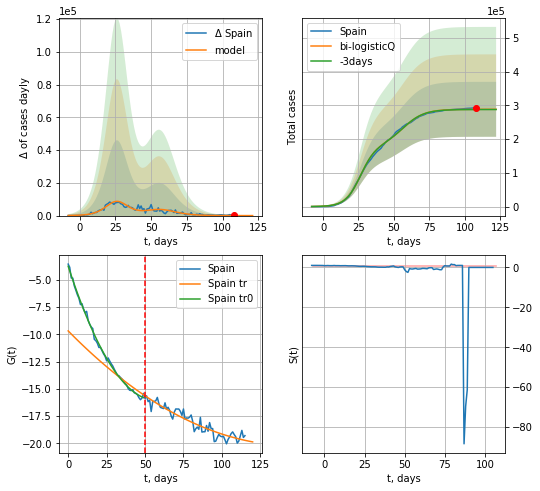

Spain data at: 2020-06-20
+3 day model MAPE: 0.002142
model: bi-logisticQ
coeffs: [ 1.08372370e+05  5.29999861e-07  5.66468811e+01 -2.55089577e+05]
rational stdev: 0.282239
forecast at the end of period: +14 days
	 deltaDaycases: 2
	 total cases: 288300 ± 81369
	 total death: 27866 ± 23594
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997131
 intercept_: -3.7751216617675887
 coeffs_: [ 0.         -0.43240435  0.00381547]
trend coefficient of determination: 0.885078
 intercept_: -9.696023439740733
 coeffs_: [ 0.         -0.14310619  0.00048724]


In [578]:
x = forecastRRR('Spain',dfSP[:50],d1,7*14-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


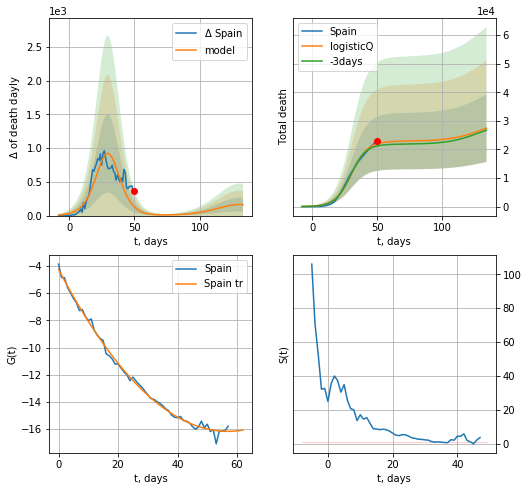

Spain data at: 2020-06-20
+3 day model MAPE: 0.037624
model: logisticQ
coeffs: [ 2.28798062e+04  1.92571131e-06  3.00460867e+01 -8.38155043e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430820
forecast at the end of period: +84 days
	 total death: 27429 ± 11817
trend coefficient of determination: 0.995937
 intercept_: -4.2575122176431694
 coeffs_: [ 0.         -0.41856419  0.00368029]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


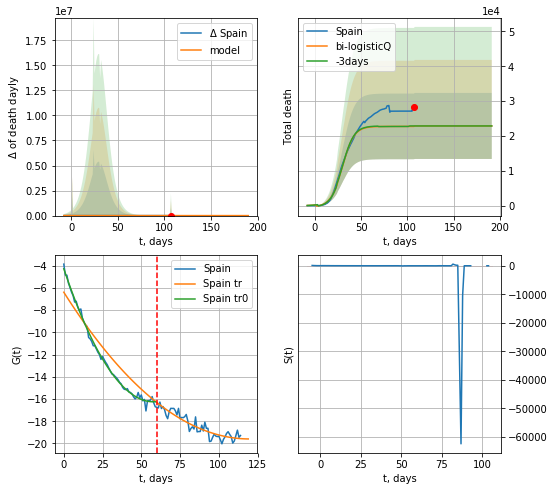

Spain data at: 2020-06-20
+3 day model MAPE: 0.000084
model: bi-logisticQ
coeffs: [-366.29013628   -4.63112586   24.67431009    1.62895992]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.414182
forecast at the end of period: +84 days
	 total death: 22879 ± 9476
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.995783
 intercept_: -4.28878212009627
 coeffs_: [ 0.         -0.41413346  0.00358475]
trend coefficient of determination: 0.840766
 intercept_: -6.399701178043291
 coeffs_: [ 0.         -0.22037395  0.00092036]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [579]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


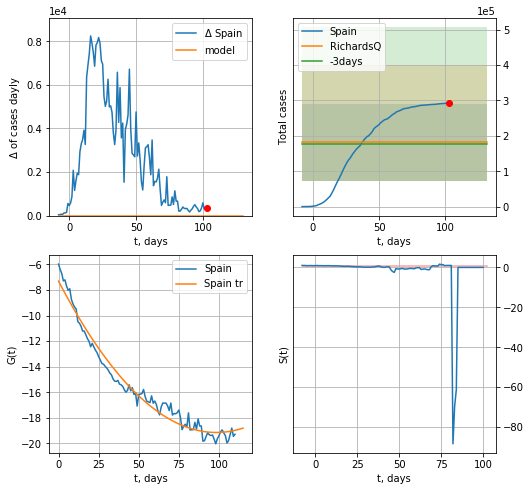

Spain data at: 2020-06-20
+3 day model MAPE: 0.017224
model: RichardsQ
coeffs: [ 1.81199759e+05  1.29735379e+00 -2.52469843e+03  2.02417030e+03
 -3.47255250e+00]
rational stdev: 0.600566
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 181199 ± 108822
	 total death: 17514 ± 31554
trend coefficient of determination: 0.971151
 intercept_: -7.30818420248867
 coeffs_: [ 0.         -0.24062193  0.00122325]


In [580]:
x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

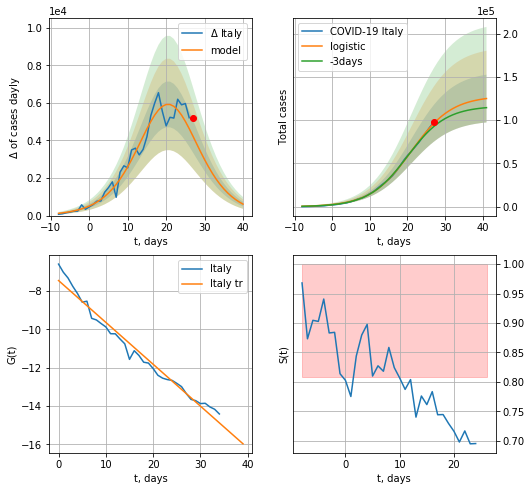

Italy data at: 2020-06-20
+3 day model MAPE: 0.045578378390248614
model: logistic
coeffs:  [1.28139025e+05 1.85112183e-01 2.10100292e+01]
rational stdev:  0.22065596678975638
forecast at the end of period: +14 days
	 deltaDaycases:  610
	 total cases:  125048 ± 27592
	 total death:  18163 ± 12023
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:189: RuntimeWarning: overflow encountered in exp


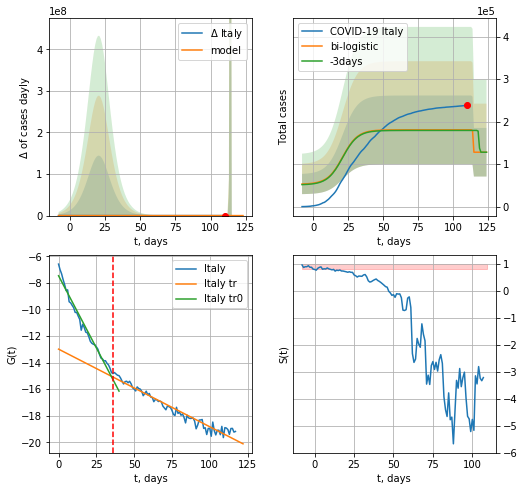

Italy data at: 2020-06-20
+3 day model MAPE: 0.008228165476305204
model: bi-logistic
coeffs:  [ 5.27842902e+04 -1.04521416e+01  1.14317781e+02] [1.28139025e+05 1.85112183e-01 2.10100292e+01]
rational stdev:  0.4461037769418818
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  128139 ± 57163
	 total death:  18612 ± 24908
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.951483
 intercept: -12.989365
 slope: -0.058415


In [581]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,14*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,14*7-dT,x,1.0,vL=vL)

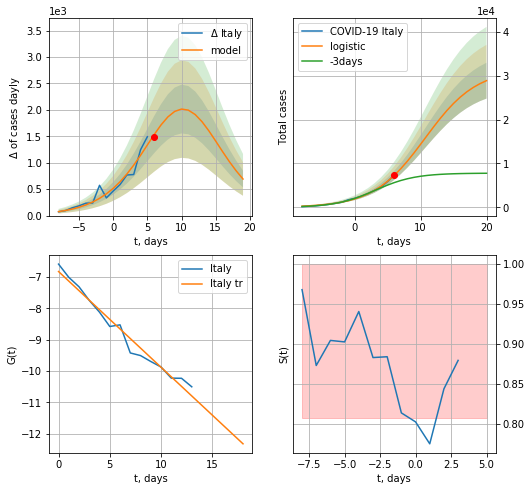

Italy data at: 2020-06-20
+3 day model MAPE: 0.44264442257961345
model: logistic
coeffs:  [3.14978181e+04 2.56455869e-01 1.06869163e+01]
rational stdev:  0.14147817336323687
forecast at the end of period: +14 days
	 deltaDaycases:  691
	 total cases:  28850 ± 4081
	 total death:  4190 ± 1778
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


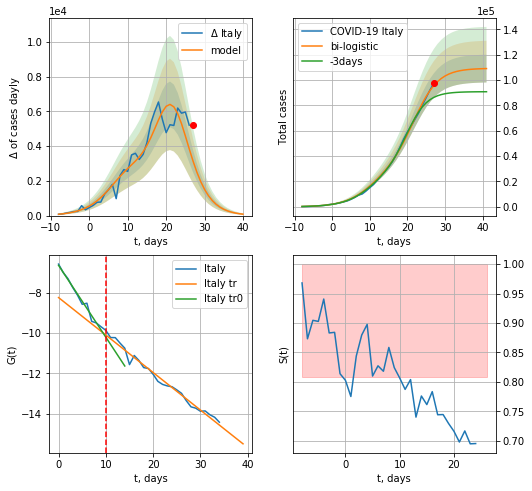

Italy data at: 2020-06-20
+3 day model MAPE: 0.1273932560599292
model: bi-logistic
coeffs:  [7.78644605e+04 3.07215535e-01 2.18188307e+01] [3.14978181e+04 2.56455869e-01 1.06869163e+01]
rational stdev:  0.10049358500066935
forecast at the end of period: +14 days
	 deltaDaycases:  80
	 total cases:  109134 ± 10967
	 total death:  15852 ± 4779
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


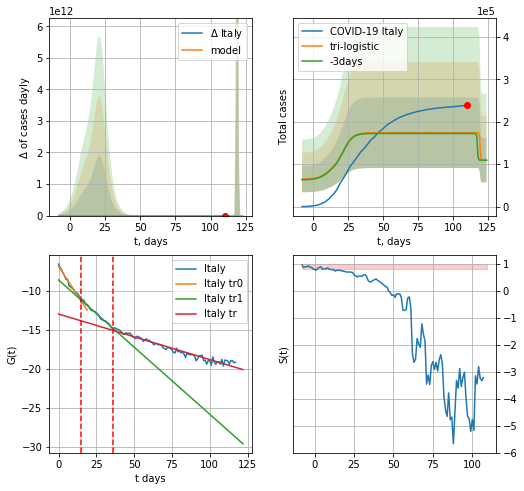

Italy data at: 2020-06-20
+3 day model MAPE: 0.00959644910340368
model: tri-logistic
coeffs:  [ 6.46846157e+04 -4.47830000e+00  1.19384938e+02] [3.14978181e+04 2.56455869e-01 1.06869163e+01 7.78644605e+04
 3.07215535e-01 2.18188307e+01]
forecast rational stdev:  0.47710970682312587
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  109362 ± 52177
	 total death:  15885 ± 22736
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.951483
 intercept: -12.989365
 slope: -0.058415


In [583]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*14-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*14-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*14-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

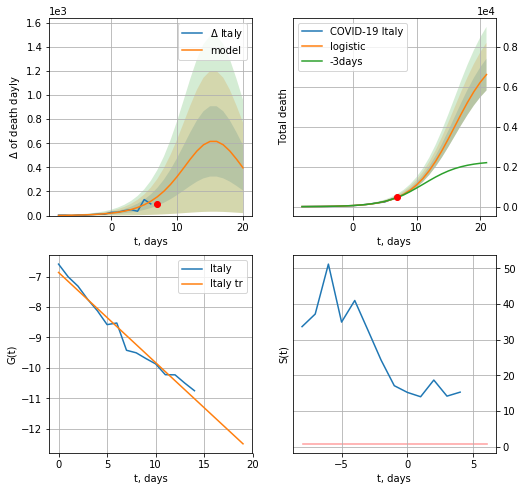

Italy data at: 2020-06-20
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +14 days
	 total death:  6610 ± 793
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


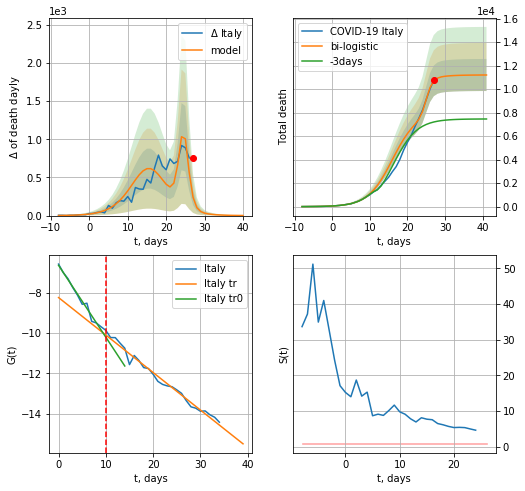

Italy data at: 2020-06-20
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +14 days
	 deltaDaydeath:  1
	 total death:  11207 ± 1364
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


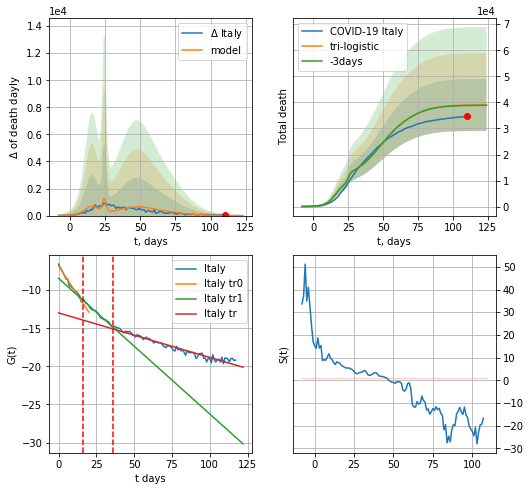

Italy data at: 2020-06-20
+3 day model MAPE: 0.003983106136686017
model: tri-logistic
coeffs:  [2.22759555e+04 1.08184805e-01 4.71504729e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.2556373343996637
forecast at the end of period: +14 days
	 deltaDaydeath:  2
	 total death:  39033 ± 9978
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.951483
 intercept: -12.989365
 slope: -0.058415


In [585]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*14-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*14-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*14-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


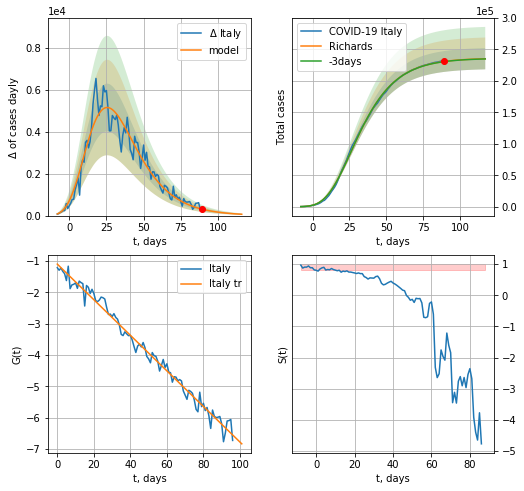

Italy data at: 2020-06-20
+3 day model MAPE: 0.001156
model: Richards
coeffs: [ 2.36268096e+05  5.92086146e+00 -5.11109937e+01  1.00690098e-02]
rational stdev: 0.071704
forecast at the end of period: +28 days
	 deltaDaycases: 63
	 total cases: 235228 ± 16866
	 total death: 34167 ± 7349
trend coefficient of determination: 0.984919
 intercept: -1.097364
 slope: -0.056780


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


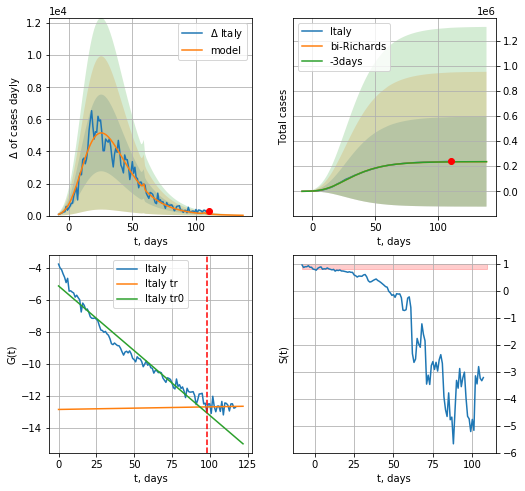

Italy data at: 2020-06-20
+3 day model MAPE: 0.000000
model: bi-Richards
coeffs: [-471.0939831    -5.72464529   59.63419296    0.47846907]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 1.517705
forecast at the end of period: +28 days
	 deltaDaycases: 18
	 total cases: 235970 ± 358133
	 total death: 34275 ± 156058
bi-Richards approximation splitting point: 98
trend coefficient of determination: 0.958707
 intercept: -5.123245
 slope: -0.081006
trend coefficient of determination: 0.001125
 intercept: -12.854496
 slope: 0.001627


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


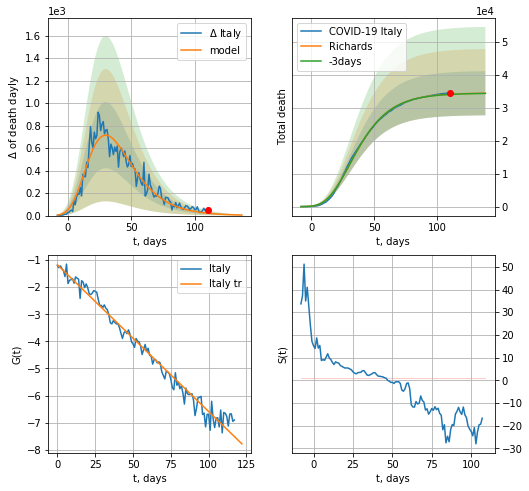

Italy data at: 2020-06-20
+3 day model MAPE: 0.001584
model: Richards
coeffs: [ 3.45536557e+04  7.14567528e+00 -5.51547536e+01  7.90961884e-03]
rational stdev: 0.194937
forecast at the end of period: +28 days
	 total death: 34474 ± 6720
trend coefficient of determination: 0.979510
 intercept: -1.172676
 slope: -0.054170


In [586]:
vL=98
x = forecastRR('Italy',dfIT[:vL],d1,16*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Italy',dfIT[:],d1,16*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,16*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


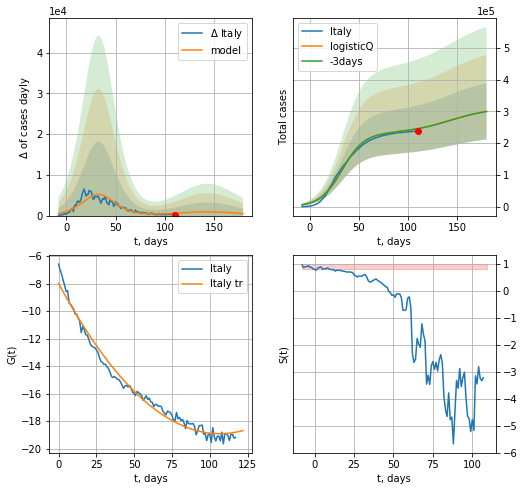

Italy data at: 2020-06-20
+3 day model MAPE: 0.002172
model: logisticQ
coeffs: [ 2.31418836e+05  3.02036125e-07  3.29231567e+01 -2.96699874e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.295420
forecast at the end of period: +70 days
	 deltaDaycases: 508
	 total cases: 300128 ± 88663
	 total death: 43594 ± 38635
trend coefficient of determination: 0.982916
 intercept_: -7.9836538290115024
 coeffs_: [ 0.         -0.2049114   0.00096062]


In [587]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


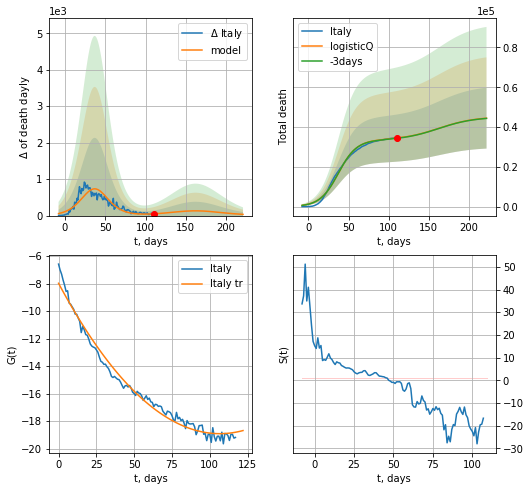

Italy data at: 2020-06-20
+3 day model MAPE: 0.003505
model: logisticQ
coeffs: [ 3.34284786e+04  2.81960349e-07  3.72846053e+01 -3.10864433e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.343798
forecast at the end of period: +112 days
	 total death: 44467 ± 15287
trend coefficient of determination: 0.982916
 intercept_: -7.9836538290115024
 coeffs_: [ 0.         -0.2049114   0.00096062]


In [588]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [589]:
dT

84

FR
           date     cases  active    death
122 2020-06-16  157716.0   54834  29547.0
123 2020-06-17  158174.0   54932  29575.0
124 2020-06-18  158641.0   55151  29603.0
125 2020-06-19  159452.0   55718  29617.0
126 2020-06-20  160093.0   56148  29633.0


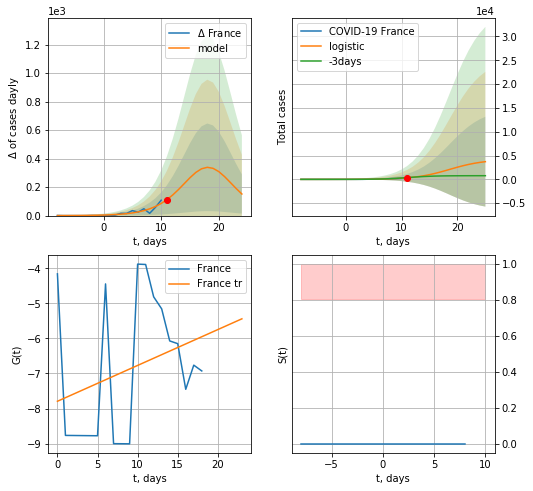

France data at: 2020-06-20
+3 day model MAPE: 0.04053337370546569
model: logistic
coeffs:  [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  2.5390562100826064
forecast at the end of period: +14 days
	 deltaDaycases:  151
	 total cases:  3712 ± 9426
	 total death:  687 ± 5232
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


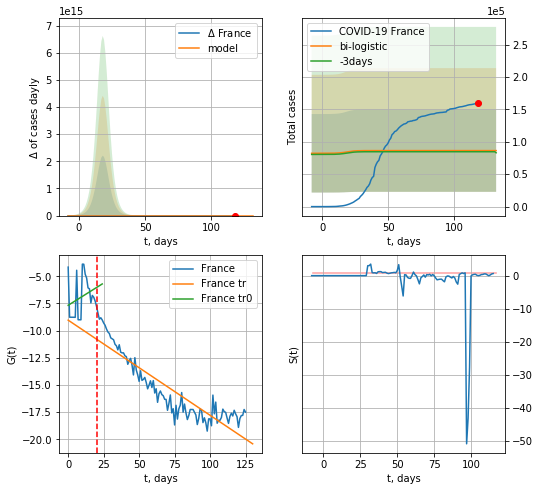

France data at: 2020-06-20
+3 day model MAPE: 0.02085235168329036
model: bi-logistic
coeffs:  [ 8.22524806e+04 -5.10008837e+00  1.34566422e+02] [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  0.7359033977135286
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  86426 ± 63601
	 total death:  15997 ± 35316
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.810375
 intercept: -9.039929
 slope: -0.087534


In [591]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,14*7-dT,1.0)
xx = forecast2('France',dfFR,d1,14*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [592]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

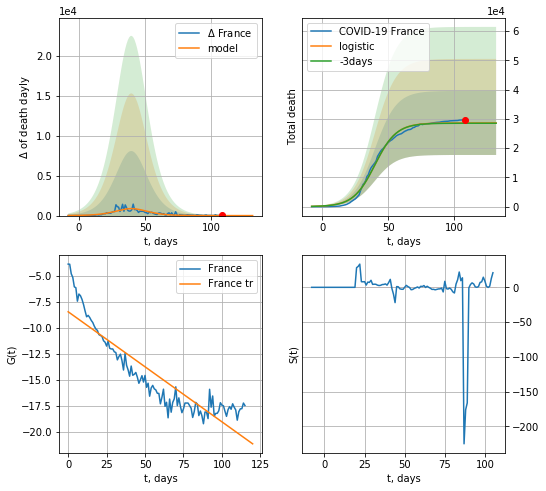

France data at: 2020-06-20
+3 day model MAPE: 0.0032825103362644145
model: logistic
coeffs:  [2.85829430e+04 1.22273959e-01 4.00326710e+01]
rational stdev:  0.38265214854967466
forecast at the end of period: +24 days
	 total death:  28582 ± 10937
trend coefficient of determination: 0.817026
 intercept: -8.470570
 slope: -0.105957


In [593]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*16-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


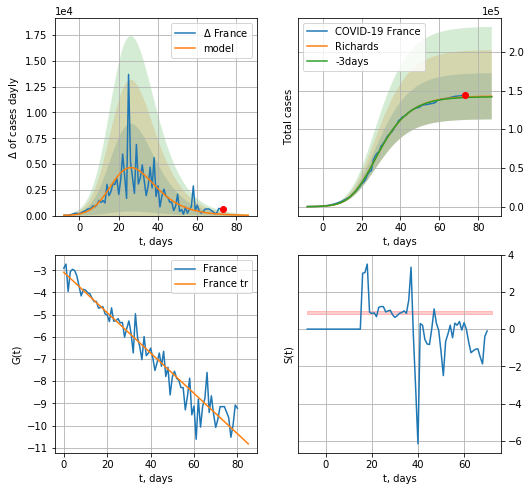

France data at: 2020-06-20
+3 day model MAPE: 0.005147
model: Richards
coeffs: [1.42848528e+05 3.23749564e-01 1.53796567e+01 3.15810253e-01]
rational stdev: 0.209496
forecast at the end of period: +14 days
	 deltaDaycases: 32
	 total cases: 142550 ± 29863
	 total death: 26385 ± 16582
trend coefficient of determination: 0.939070
 intercept: -3.090514
 slope: -0.090951


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


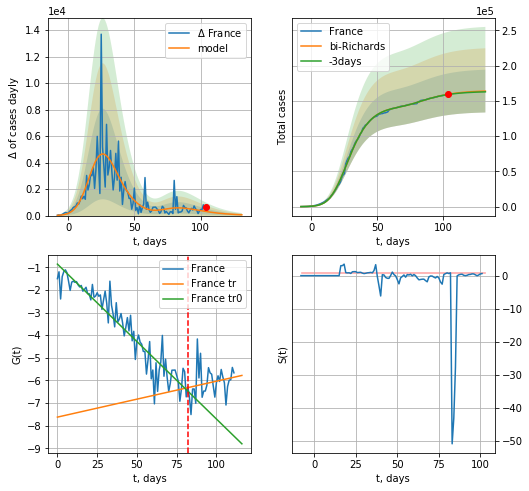

France data at: 2020-06-20
+3 day model MAPE: 0.002587
model: bi-Richards
coeffs: [2.18377536e+04 5.77945117e+00 1.99274160e+01 1.18037185e-02]
rational stdev: 0.185128
forecast at the end of period: +28 days
	 deltaDaycases: 60
	 total cases: 163816 ± 30327
	 total death: 30322 ± 16840
bi-Richards approximation splitting point: 82
trend coefficient of determination: 0.893504
 intercept: -0.859514
 slope: -0.068428
trend coefficient of determination: 0.043744
 intercept: -7.617645
 slope: 0.015871


In [594]:
vL = 82+14
x = forecastRR('France',dfFR[14:vL],d1,14*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,16*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


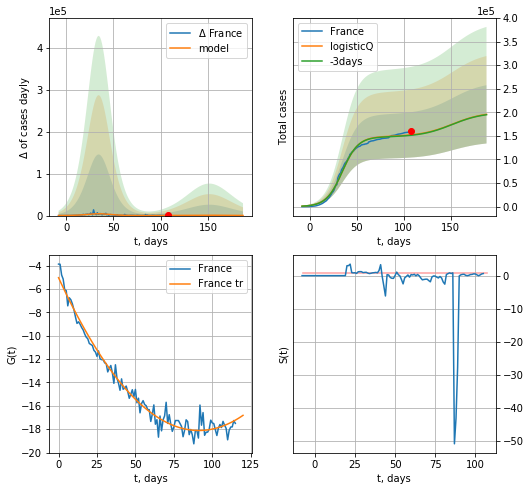

France data at: 2020-06-20
+3 day model MAPE: 0.005891
model: logisticQ
coeffs: [ 1.48656263e+05  3.47016270e-07  3.48448422e+01 -3.39346197e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.315897
forecast at the end of period: +80 days
	 deltaDaycases: 300
	 total cases: 195765 ± 61841
	 total death: 36235 ± 34339
trend coefficient of determination: 0.977737
 intercept_: -5.042536967933929
 coeffs_: [ 0.         -0.28638452  0.00156895]


In [595]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


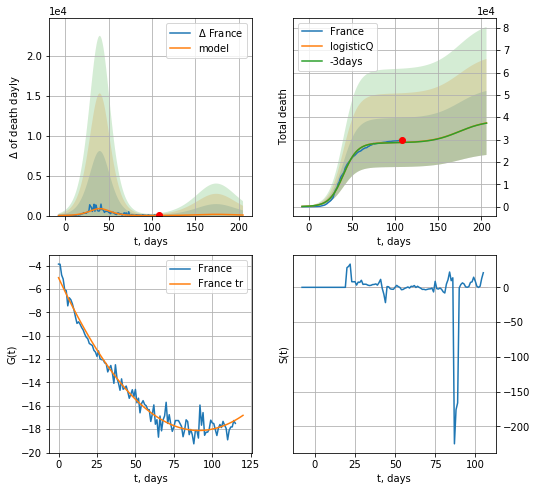

France data at: 2020-06-20
+3 day model MAPE: 0.003349
model: logisticQ
coeffs: [ 2.85828421e+04  4.56394424e-07  4.00333056e+01 -2.67790236e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.382719
forecast at the end of period: +98 days
	 total death: 37431 ± 14325
trend coefficient of determination: 0.977737
 intercept_: -5.042536967933929
 coeffs_: [ 0.         -0.28638452  0.00156895]


In [596]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [597]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [598]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

GR
           date   cases  active   death
113 2020-06-16  188382    5872  8910.0
114 2020-06-17  189504    7652  8927.0
115 2020-06-18  190126    7080  8946.0
116 2020-06-19  190660    7300  8960.0
117 2020-06-20  191216    7555  8961.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


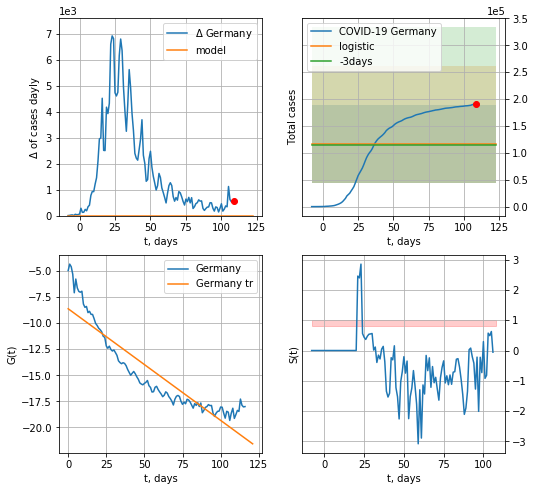

Germany data at: 2020-06-20
+3 day model MAPE: 0.017043758114756384
model: logistic
coeffs:  [ 1.16091026e+05 -4.61497328e+00  1.39071310e+02]
rational stdev:  0.6259609442706687
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  116091 ± 72668
	 total death:  5440 ± 10215
trend coefficient of determination: 0.836005
 intercept: -8.633757
 slope: -0.106888


In [600]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[:],d1,7*14-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


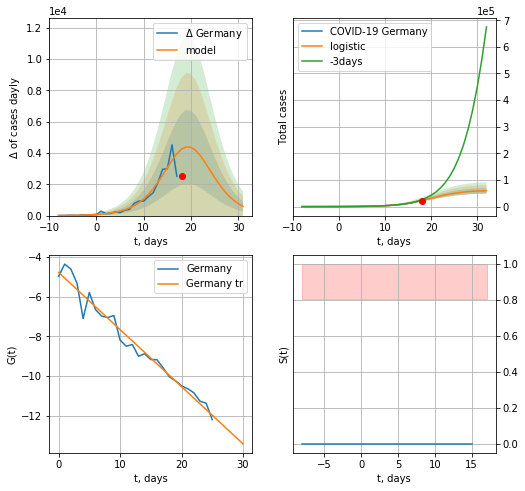

Germany data at: 2020-06-20
+3 day model MAPE: 0.18326880785963318
model: logistic
coeffs:  [6.15503822e+04 2.86340376e-01 1.98405527e+01]
rational stdev:  0.17812668621755098
forecast at the end of period: +14 days
	 deltaDaycases:  584
	 total cases:  59713 ± 10636
	 total death:  2798 ± 1495
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


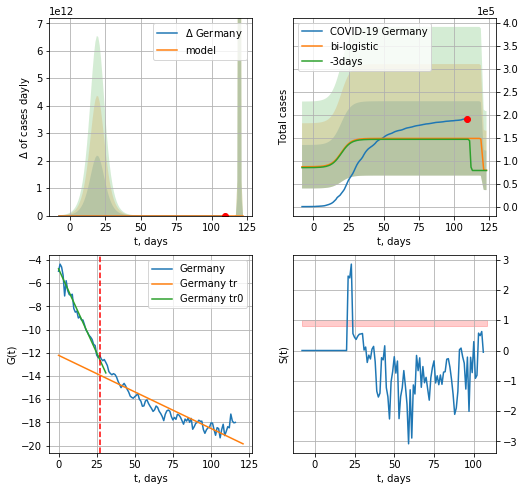

Germany data at: 2020-06-20
+3 day model MAPE: 0.013455687090156312
model: bi-logistic
coeffs:  [ 6.93239983e+04 -3.96983934e+00  1.19998467e+02] [6.15503822e+04 2.86340376e-01 1.98405527e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.5449491383540118
forecast at the end of period: +14 days
	 deltaDaycases:  -24
	 total cases:  78881 ± 42986
	 total death:  3696 ± 6042
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.843267
 intercept: -12.218721
 slope: -0.063031


In [602]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,14*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*14-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
           date   cases  active   death
113 2020-06-16  188382    5872  8910.0
114 2020-06-17  189504    7652  8927.0
115 2020-06-18  190126    7080  8946.0
116 2020-06-19  190660    7300  8960.0
117 2020-06-20  191216    7555  8961.0


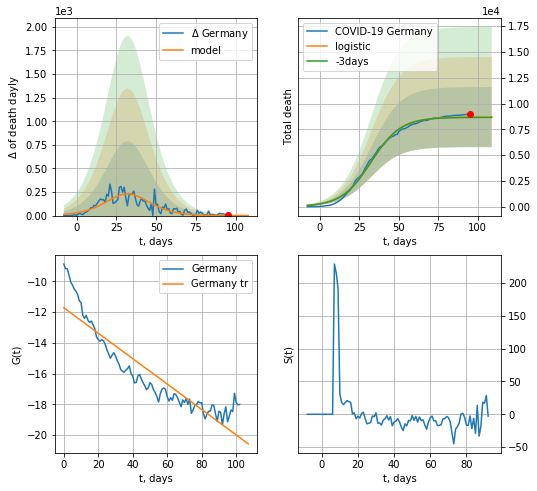

Germany data at: 2020-06-20
+3 day model MAPE: 0.003774057114650926
model: logistic
coeffs:  [8.68898689e+03 1.05934512e-01 3.25592031e+01]
rational stdev:  0.33557429263067434
forecast at the end of period: +14 days
	 total death:  8686 ± 2914
trend coefficient of determination: 0.837544
 intercept: -11.719774
 slope: -0.082710


In [604]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,14*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


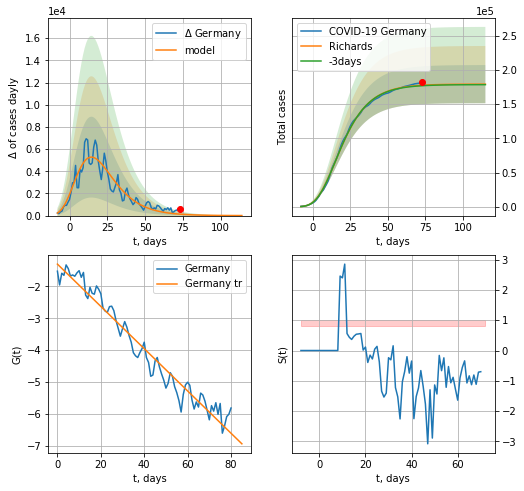

Germany data at: 2020-06-20
+3 day model MAPE: 0.003916
model: Richards
coeffs: [ 1.79110364e+05  9.11571266e+00 -4.38812227e+01  8.82260552e-03]
rational stdev: 0.155516
forecast at the end of period: +42 days
	 deltaDaycases: 4
	 total cases: 179053 ± 27845
	 total death: 8391 ± 3914
trend coefficient of determination: 0.956452
 intercept: -1.304650
 slope: -0.066180


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


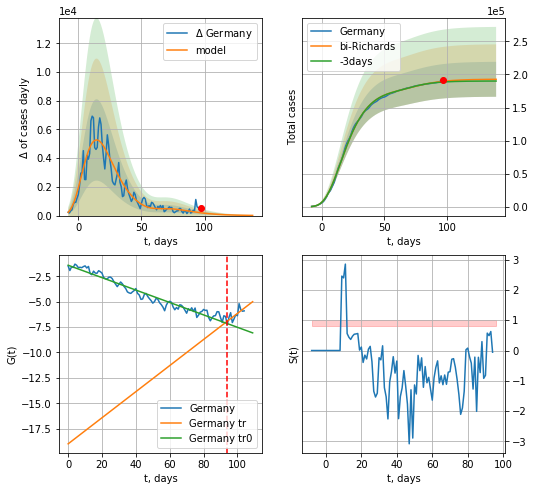

Germany data at: 2020-06-20
+3 day model MAPE: 0.006285
model: bi-Richards
coeffs: [1.37841484e+04 1.34190496e+01 1.38675318e+00 5.22275723e-03]
rational stdev: 0.136970
forecast at the end of period: +42 days
	 deltaDaycases: 12
	 total cases: 192716 ± 26396
	 total death: 9031 ± 3710
bi-Richards approximation splitting point: 94
trend coefficient of determination: 0.950737
 intercept: -1.412454
 slope: -0.061082
trend coefficient of determination: 0.512617
 intercept: -18.992400
 slope: 0.128358


In [605]:
vL = 94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Germany',dfGR[12:],d1,18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


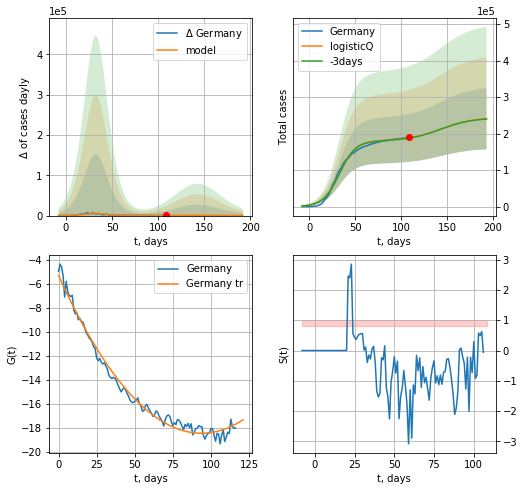

Germany data at: 2020-06-20
+3 day model MAPE: 0.004055
model: logisticQ
coeffs: [ 1.80423972e+05  3.00302973e-07  3.28080143e+01 -3.76834201e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.348086
forecast at the end of period: +84 days
	 deltaDaycases: 193
	 total cases: 240820 ± 83826
	 total death: 11285 ± 11784
trend coefficient of determination: 0.985604
 intercept_: -5.306224242507206
 coeffs_: [ 0.         -0.28050252  0.0014967 ]


In [606]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


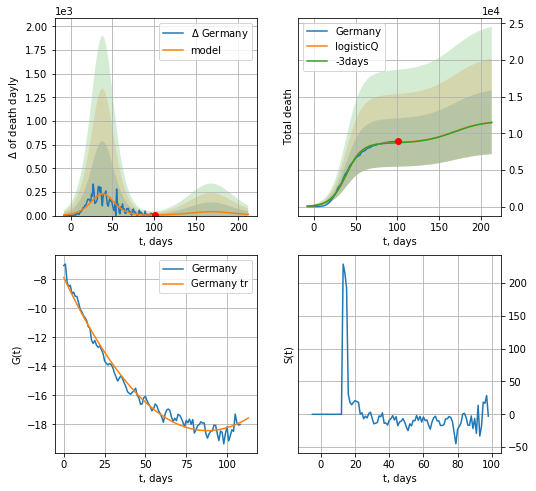

Germany data at: 2020-06-20
+3 day model MAPE: 0.003818
model: logisticQ
coeffs: [ 8.68730355e+03  5.73469138e-07  3.85564538e+01 -1.84926302e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.377339
forecast at the end of period: +112 days
	 total death: 11507 ± 4342
trend coefficient of determination: 0.982929
 intercept_: -7.869958702088902
 coeffs_: [ 0.         -0.24029635  0.00136816]


In [607]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
107 2020-06-16  2208400  1186227  119132.0
108 2020-06-17  2234471  1195734  119941.0
109 2020-06-18  2263749  1211985  120688.0
110 2020-06-19  2297190  1219722  121407.0
111 2020-06-20  2330578  1235657  121980.0


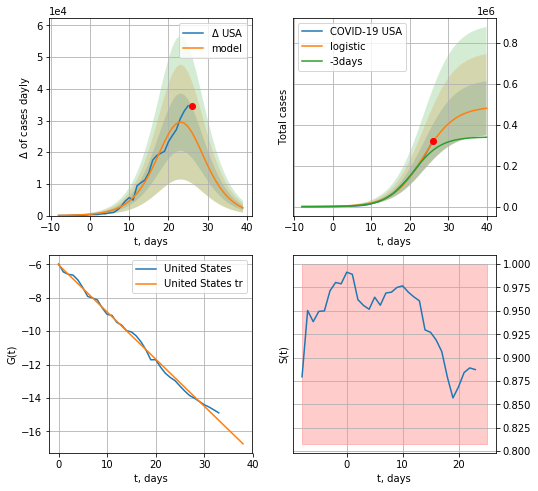

USA data at: 2020-06-20
+3 day model MAPE: 0.17962965715206392
model: logistic
coeffs:  [4.89025783e+05 2.41973857e-01 2.36121759e+01]
rational stdev:  0.2760702577358041
forecast at the end of period: +14 days
	 deltaDaycases:  2432
	 total cases:  479926 ± 132493
	 total death:  25118 ± 20802
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


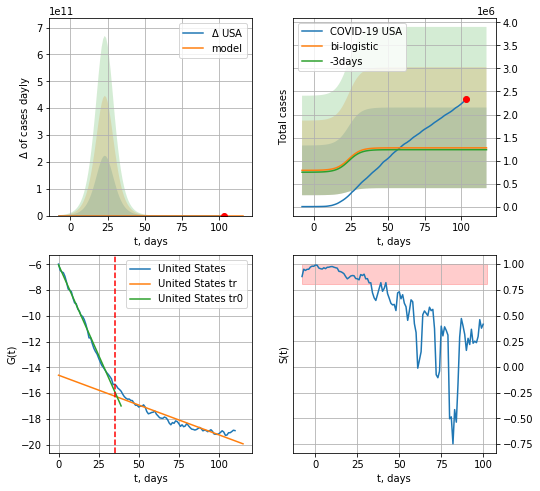

USA data at: 2020-06-20
+3 day model MAPE: 0.03279574274800498
model: bi-logistic
coeffs:  [ 6.29964063e+05 -8.34436119e+00  2.10604343e+02] [4.89025783e+05 2.41973857e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.6856716509355814
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  1276480 ± 875246
	 total death:  66809 ± 137427
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.897414
 intercept: -14.610079
 slope: -0.046276


In [609]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,14*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,14*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

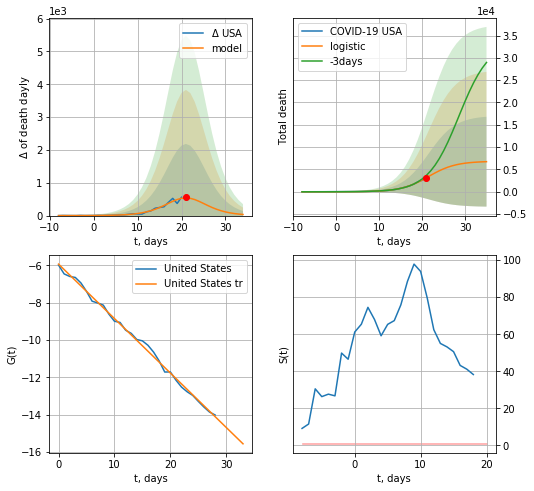

USA data at: 2020-06-20
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +14 days
	 total death:  6739 ± 10062
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


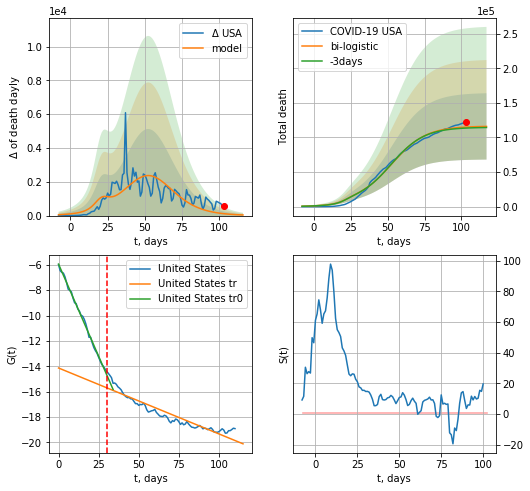

USA data at: 2020-06-20
+3 day model MAPE: 0.012856679688233428
model: bi-logistic
coeffs:  [1.09538101e+05 8.65543616e-02 5.27420520e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.4135235420510615
forecast at the end of period: +14 days
	 deltaDaydeath:  37
	 total death:  115952 ± 47949
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.882300
 intercept: -14.132763
 slope: -0.051939


In [611]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*14-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*14-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


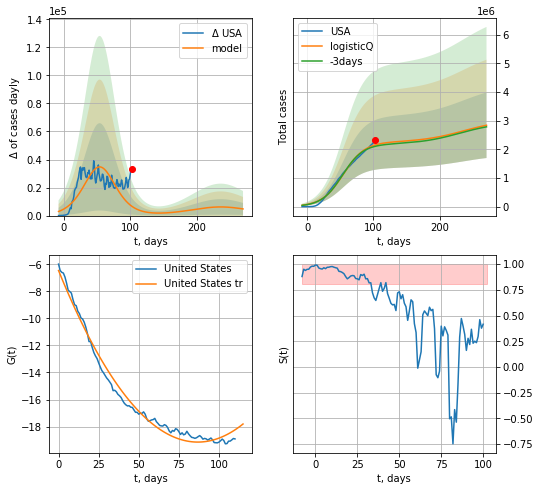

USA data at: 2020-06-20
+3 day model MAPE: 0.023287
model: logisticQ
coeffs: [ 2.24817580e+06  2.71771896e-07  5.43281418e+01 -2.26900414e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.402763
forecast at the end of period: +168 days
	 deltaDaycases: 4753
	 total cases: 2839728 ± 1143737
	 total death: 148628 ± 179585
trend coefficient of determination: 0.985755
 intercept_: -6.465315817055474
 coeffs_: [ 0.         -0.29201303  0.00168173]


In [612]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


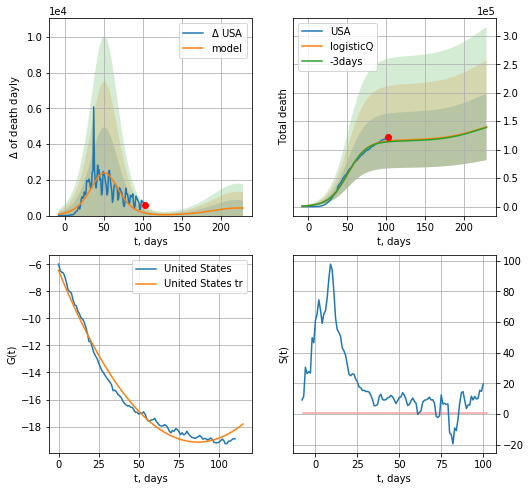

USA data at: 2020-06-20
+3 day model MAPE: 0.012448
model: logisticQ
coeffs: [ 1.16673240e+05  3.21895109e-07  5.10660188e+01 -2.54725696e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.417883
forecast at the end of period: +126 days
	 total death: 140056 ± 58527
trend coefficient of determination: 0.985755
 intercept_: -6.465315817055474
 coeffs_: [ 0.         -0.29201303  0.00168173]


In [613]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


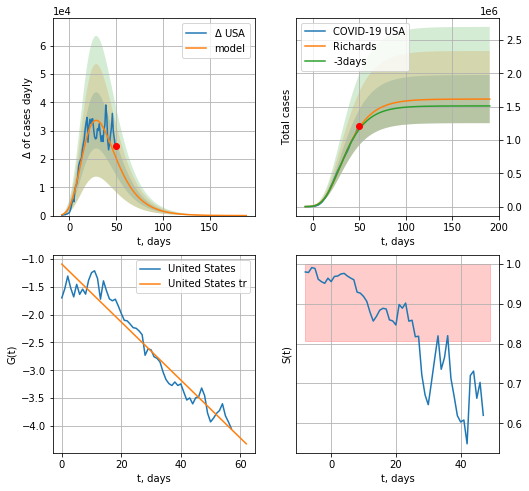

USA data at: 2020-06-20
+3 day model MAPE: 0.023592
model: Richards
coeffs: [ 1.61334019e+06  5.18353981e+00 -4.99145433e+01  1.09951095e-02]
rational stdev: 0.223706
forecast at the end of period: +140 days
	 deltaDaycases: 9
	 total cases: 1613171 ± 360876
	 total death: 84431 ± 56663
trend coefficient of determination: 0.940831
 intercept: -1.092869
 slope: -0.052069


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


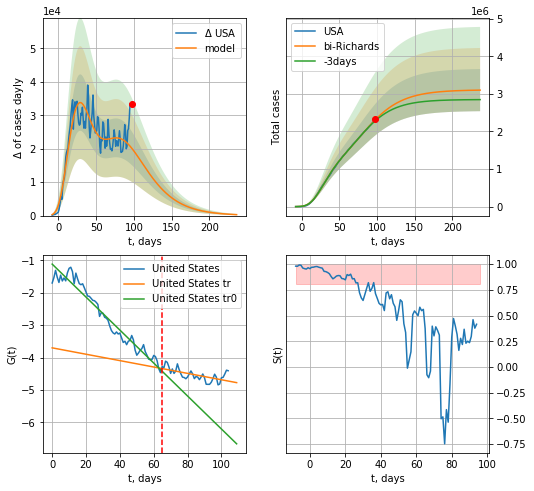

USA data at: 2020-06-20
+3 day model MAPE: 0.012397
model: bi-Richards
coeffs: [ 1.49453044e+06  3.23397525e+00 -3.98579412e+01  1.09011703e-02]
rational stdev: 0.180874
forecast at the end of period: +140 days
	 deltaDaycases: 282
	 total cases: 3099970 ± 560705
	 total death: 162249 ± 88040
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.952391
 intercept: -1.115141
 slope: -0.050885
trend coefficient of determination: 0.381902
 intercept: -3.699595
 slope: -0.009849


In [614]:
vL = 65+6
x = forecastRR('USA',dfUS[6:vL-6],d1,7*32-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('USA',dfUS[6:],d1,7*32-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-6)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


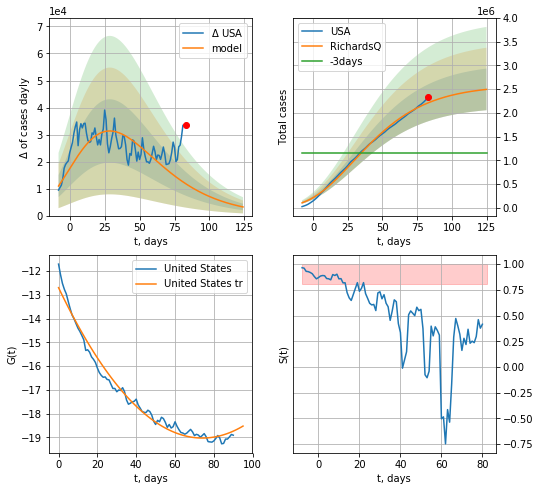

USA data at: 2020-06-20
+3 day model MAPE: 0.926230
model: RichardsQ
coeffs: [ 2.58067925e+06  8.06707664e-03 -1.80793147e+02 -1.66281309e+03
  2.15450191e-03]
rational stdev: 0.175914
forecast at the end of period: +42 days
	 deltaDaycases: 3199
	 total cases: 2492733 ± 438507
	 total death: 130467 ± 68852
trend coefficient of determination: 0.980145
 intercept_: -12.701862693958358
 coeffs_: [ 0.         -0.17071129  0.00115191]


In [615]:
x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date   cases  active    death
111 2020-06-16  298136       0  41969.0
112 2020-06-17  299251       0  42153.0
113 2020-06-18  300469       0  42288.0
114 2020-06-19  301815       0  42461.0
115 2020-06-20  303110       0  42589.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


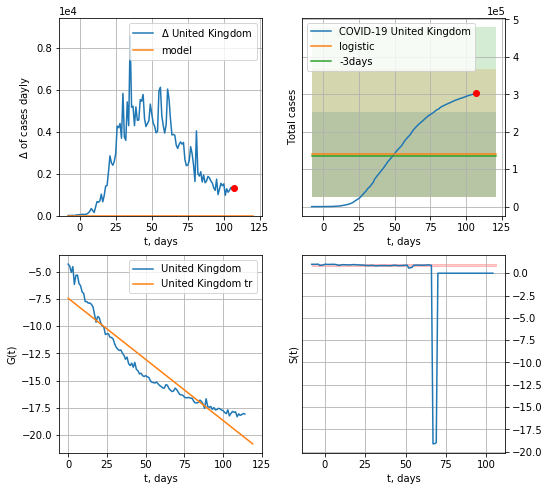

United Kingdom data at: 2020-06-20
+3 day model MAPE: 0.03192578575983471
model: logistic
coeffs:  [ 1.39377129e+05 -8.32104584e+00  2.17338083e+02]
rational stdev:  0.8148904655012803
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  139377 ± 113577
	 total death:  19583 ± 47873
trend coefficient of determination: 0.893617
 intercept: -7.453164
 slope: -0.112223


In [617]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,7*14-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


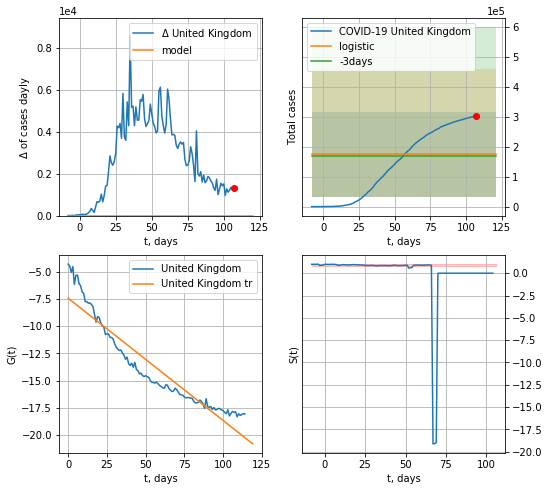

United Kingdom data at: 2020-06-20
+3 day model MAPE: 0.031925785759834666
model: logistic
coeffs:  [ 1.39377129e+05 -8.32104584e+00  2.17338083e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.8148904655012803
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  174221 ± 141971
	 total death:  24479 ± 59843
trend coefficient of determination: 0.893617
 intercept: -7.453164
 slope: -0.112223


In [619]:
x = forecast('United Kingdom',dfGB[:],d1,14*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


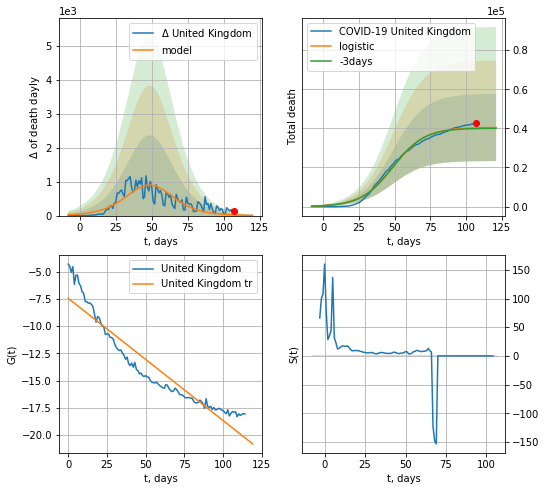

United Kingdom data at: 2020-06-20
+3 day model MAPE: 0.008991323215803516
model: logistic
coeffs:  [4.04905399e+04 8.92940848e-02 4.89138492e+01]
rational stdev:  0.42415804051223904
forecast at the end of period: +14 days
	 total death:  40425 ± 17146
trend coefficient of determination: 0.893617
 intercept: -7.453164
 slope: -0.112223


In [621]:
x = forecast('United Kingdom',dfGB[:],d1,14*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


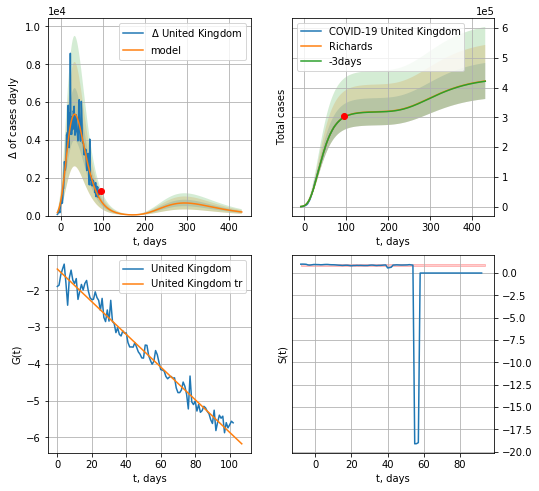

United Kingdom data at: 2020-06-20
+3 day model MAPE: 0.001530
model: Richards
coeffs: [ 3.19064633e+05  3.86526026e+00 -6.28773644e+01  1.18906351e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.143405
forecast at the end of period: +336 days
	 deltaDaycases: 191
	 total cases: 421869 ± 60498
	 total death: 59275 ± 25501
trend coefficient of determination: 0.974382
 intercept: -1.421146
 slope: -0.044446


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


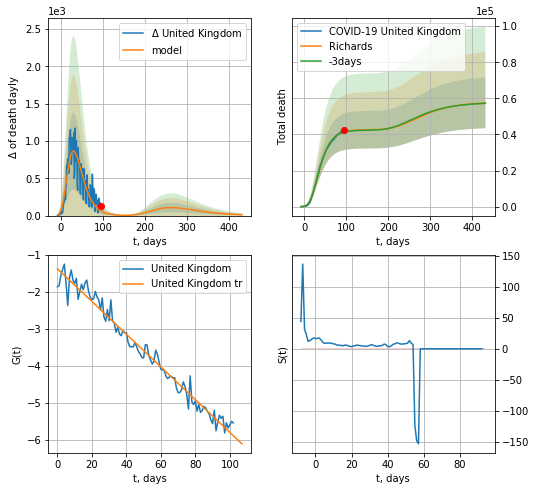

United Kingdom data at: 2020-06-20
+3 day model MAPE: 0.005234
model: Richards
coeffs: [ 4.26644067e+04  8.49287017e+00 -6.06272787e+01  6.49778487e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.244103
forecast at the end of period: +336 days
	 total death: 57497 ± 14035
trend coefficient of determination: 0.974032
 intercept: -1.374507
 slope: -0.044172


In [622]:
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


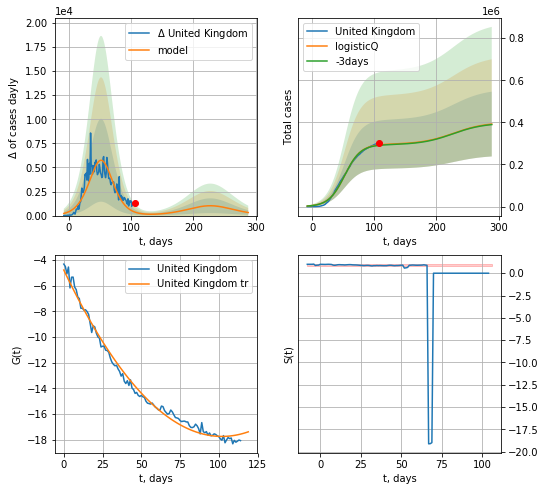

United Kingdom data at: 2020-06-20
+3 day model MAPE: 0.007091
model: logisticQ
coeffs: [ 2.95916956e+05  3.81650203e-07  5.22139973e+01 -2.03348770e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.392335
forecast at the end of period: +182 days
	 deltaDaycases: 317
	 total cases: 391992 ± 153792
	 total death: 55077 ± 64825
trend coefficient of determination: 0.990719
 intercept_: -4.778582673322221
 coeffs_: [ 0.         -0.25423979  0.00124578]


In [623]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


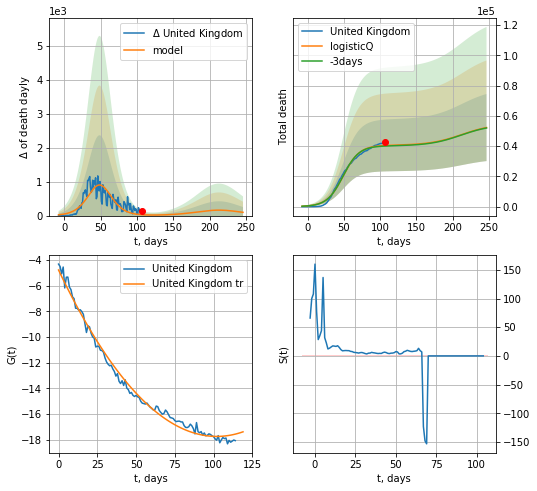

United Kingdom data at: 2020-06-20
+3 day model MAPE: 0.009073
model: logisticQ
coeffs: [ 4.04898388e+04  2.98734816e-07  4.89143089e+01 -2.98776614e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.424185
forecast at the end of period: +140 days
	 total death: 52252 ± 22164
trend coefficient of determination: 0.990719
 intercept_: -4.778582673322221
 coeffs_: [ 0.         -0.25423979  0.00124578]


In [624]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [625]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [136]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [137]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [138]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [139]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [626]:
dT

84

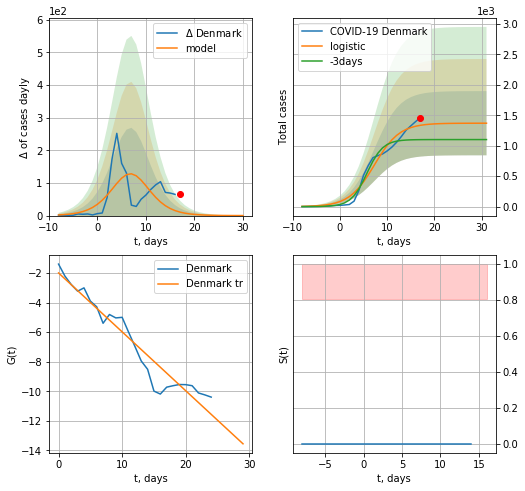

Denmark data at: 2020-06-20
+3 day model MAPE: 0.22309164372685597
model: logistic
coeffs:  [1.36966073e+03 3.75718860e-01 7.30059729e+00]
rational stdev:  0.38476605910227335
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  1369 ± 526
	 total death:  66 ± 76
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

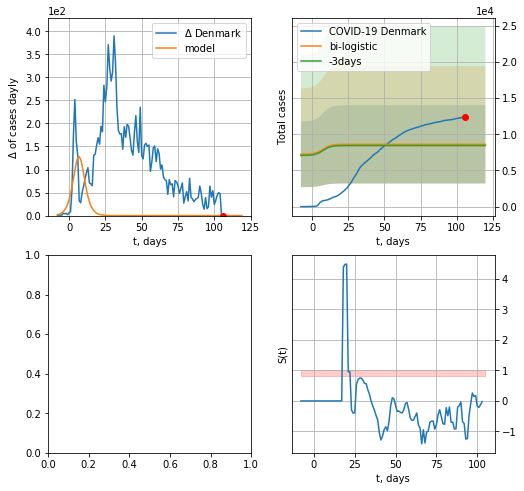

In [628]:
vL = 26
x = forecast('Denmark',dfDK[:vL],d1,7*14-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,14*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


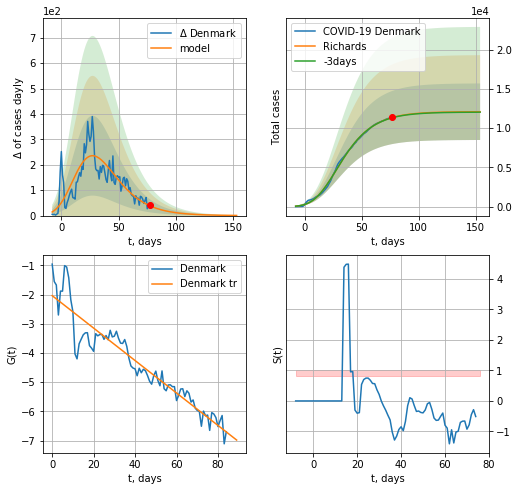

Denmark data at: 2020-06-20
+3 day model MAPE: 0.002529
model: Richards
coeffs: [ 1.21140731e+04  4.89681906e-01 -1.10544880e+01  1.14212374e-01]
rational stdev: 0.297827
forecast at the end of period: +77 days
	 deltaDaycases: 0
	 total cases: 12103 ± 3604
	 total death: 586 ± 523
trend coefficient of determination: 0.893797
 intercept: -2.036259
 slope: -0.055571


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

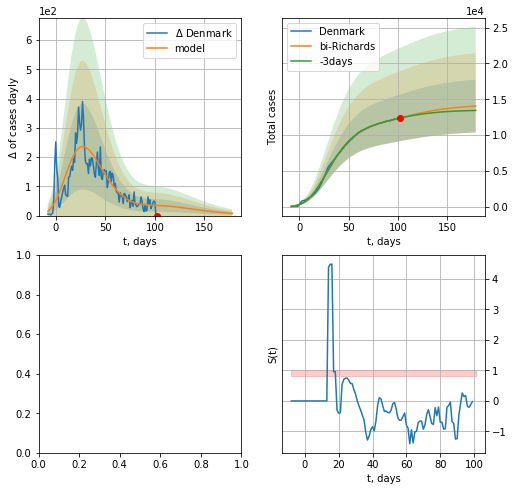

In [629]:
vL = 90+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,23*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Denmark',dfDK[4:],d1,23*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


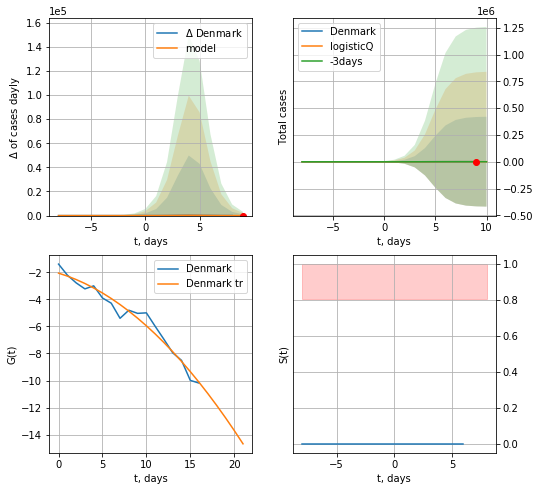

Denmark data at: 2020-06-19
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +1 days
	 deltaDaycases: 4
	 total cases: 860 ± 419136
	 total death: 41 ± 59934
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


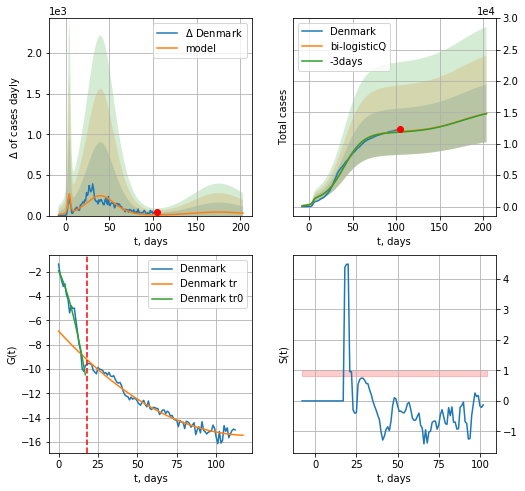

Denmark data at: 2020-06-19
+3 day model MAPE: 0.006230
model: bi-logisticQ
coeffs: [ 1.09543106e+04  2.54146764e-07  4.03700623e+01 -3.51672261e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.309105
forecast at the end of period: +99 days
	 deltaDaycases: 30
	 total cases: 14839 ± 4587
	 total death: 718 ± 665
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.970797
 intercept_: -6.884285413890612
 coeffs_: [ 0.         -0.14035075  0.00057467]


In [189]:
x = forecastRRR('Denmark',dfDK[:18],d1,12*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date  cases  active  death
111 2020-06-16   8660     280  242.0
112 2020-06-17   8692     311  243.0
113 2020-06-18   8708     326  244.0
114 2020-06-19   8726     344  244.0
115 2020-06-20   8742     360  244.0


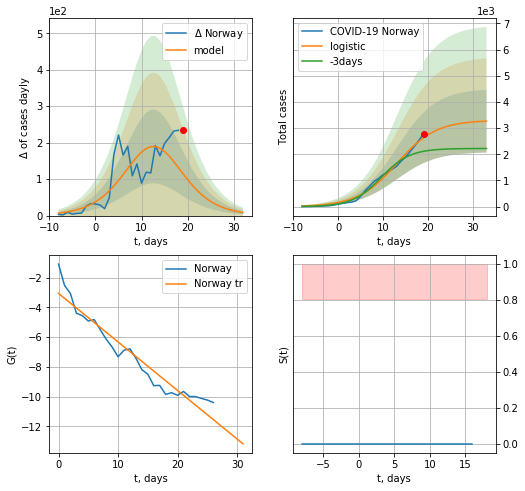

Norway data at: 2020-06-20
+3 day model MAPE: 0.2814819001616187
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.3674391911615601
forecast at the end of period: +14 days
	 deltaDaycases:  8
	 total cases:  3265 ± 1199
	 total death:  91 ± 100
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


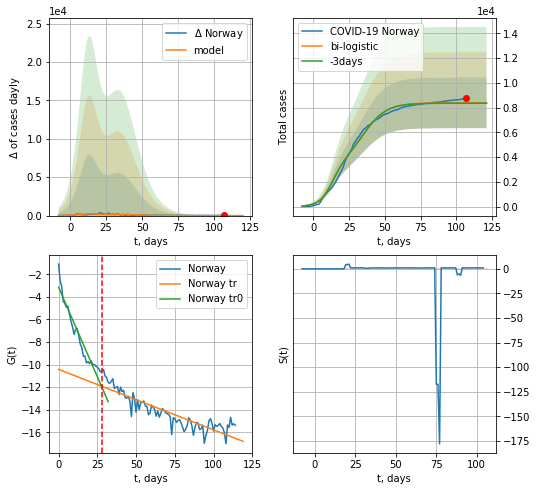

Norway data at: 2020-06-20
+3 day model MAPE: 0.0034602129411728374
model: bi-logistic
coeffs:  [5.08283344e+03 1.21993412e-01 3.48479594e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.2441037235815213
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  8380 ± 2045
	 total death:  233 ± 170
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.786311
 intercept: -10.430590
 slope: -0.053600


In [631]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*14-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,14*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

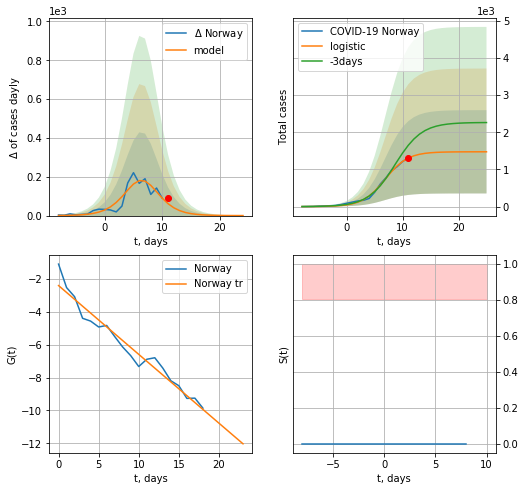

Norway data at: 2020-06-20
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  1474 ± 1120
	 total death:  41 ± 93
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


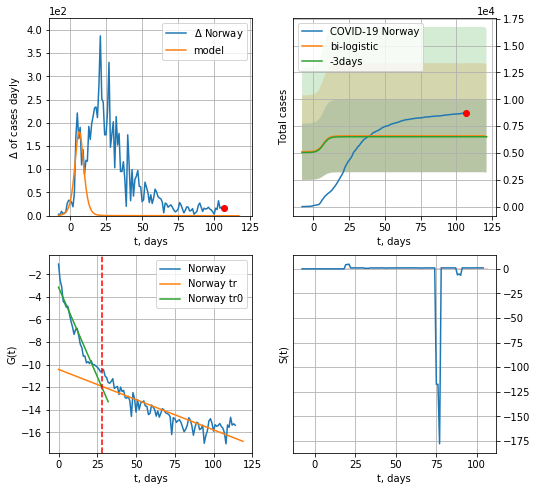

Norway data at: 2020-06-20
+3 day model MAPE: 0.012429126189032979
model: bi-logistic
coeffs:  [ 4.54340662e+03 -1.73404461e+00  1.23352427e+02] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.5136528912179602
forecast at the end of period: +14 days
	 deltaDaycases:  -62
	 total cases:  6510 ± 3344
	 total death:  181 ± 278
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.786311
 intercept: -10.430590
 slope: -0.053600


In [633]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*14-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,14*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


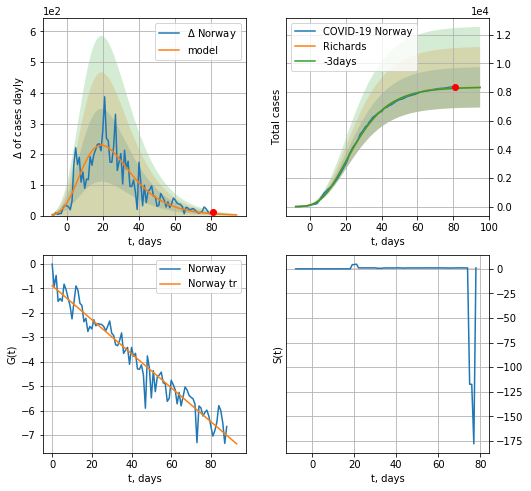

Norway data at: 2020-06-20
+3 day model MAPE: 0.001938
model: Richards
coeffs: [ 8.35144256e+03  6.60312441e+00 -3.98482814e+01  1.13741644e-02]
rational stdev: 0.168871
forecast at the end of period: +14 days
	 deltaDaycases: 2
	 total cases: 8322 ± 1405
	 total death: 232 ± 117
trend coefficient of determination: 0.941185
 intercept: -0.895025
 slope: -0.069489


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


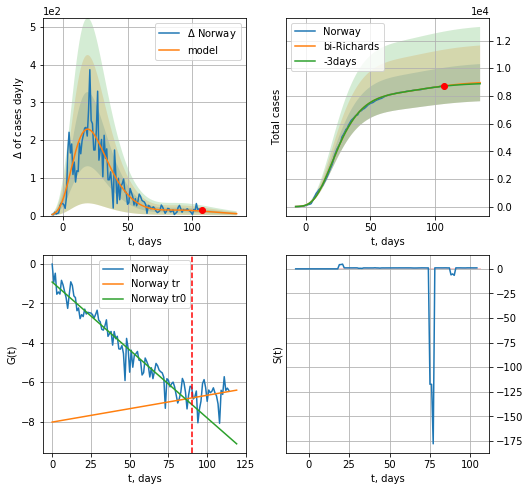

Norway data at: 2020-06-20
+3 day model MAPE: 0.002421
model: bi-Richards
coeffs: [7.20716176e+02 3.55212307e+00 3.05039929e+00 1.30004861e-02]
rational stdev: 0.149966
forecast at the end of period: +28 days
	 deltaDaycases: 5
	 total cases: 8955 ± 1343
	 total death: 249 ± 112
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.939729
 intercept: -0.922843
 slope: -0.068930
trend coefficient of determination: 0.031349
 intercept: -8.024134
 slope: 0.013610


In [635]:
vL = 90
x = forecastRR('Norway',dfNG[:vL],d1,14*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,16*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


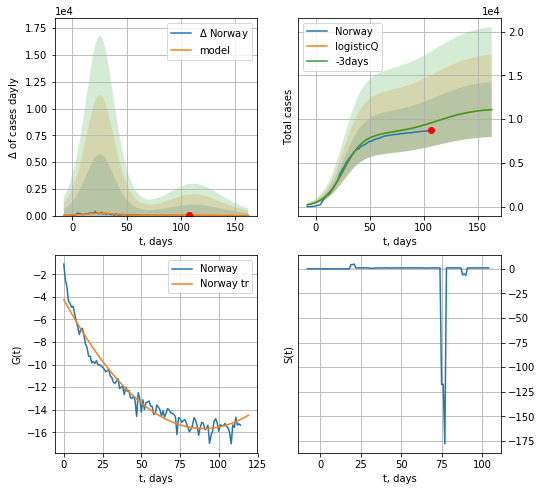

Norway data at: 2020-06-20
+3 day model MAPE: 0.001634
model: logisticQ
coeffs: [ 8.33836490e+03  3.00142163e-07  2.57376236e+01 -3.61115813e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.283038
forecast at the end of period: +56 days
	 deltaDaycases: 9
	 total cases: 11117 ± 3146
	 total death: 310 ± 263
trend coefficient of determination: 0.957695
 intercept_: -4.242023562922633
 coeffs_: [ 0.         -0.25370046  0.00140768]


In [636]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


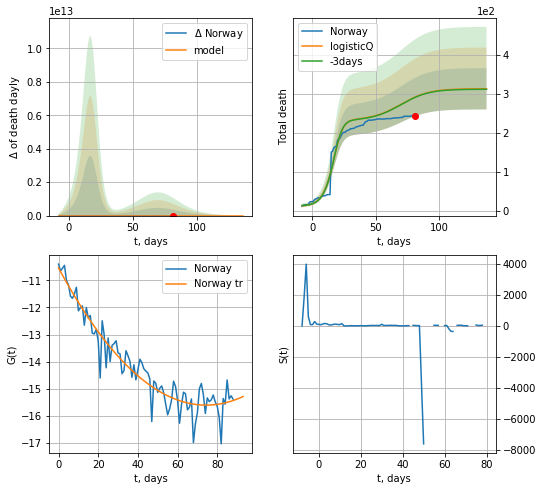

Norway data at: 2020-06-20
+3 day model MAPE: 0.002743
model: logisticQ
coeffs: [ 2.30888296e+02  4.84163049e-03  1.59070821e+01 -3.28865448e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.169230
forecast at the end of period: +56 days
	 total death: 312 ± 52
trend coefficient of determination: 0.911348
 intercept_: -10.542219864308576
 coeffs_: [ 0.         -0.13596536  0.00091368]


In [637]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

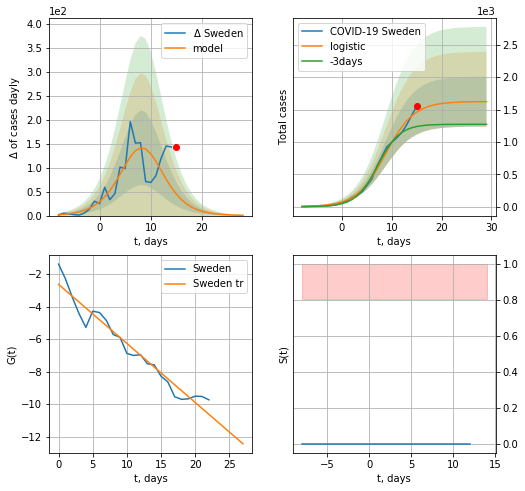

Sweden data at: 2020-06-20
+3 day model MAPE: 0.2037446768613992
model: logistic
coeffs:  [1.62331286e+03 3.49719159e-01 8.72648648e+00]
rational stdev:  0.23715803800431418
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  1621 ± 384
	 total death:  146 ± 103
trend coefficient of determination: 0.947996
 intercept: -2.632493
 slope: -0.363132


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

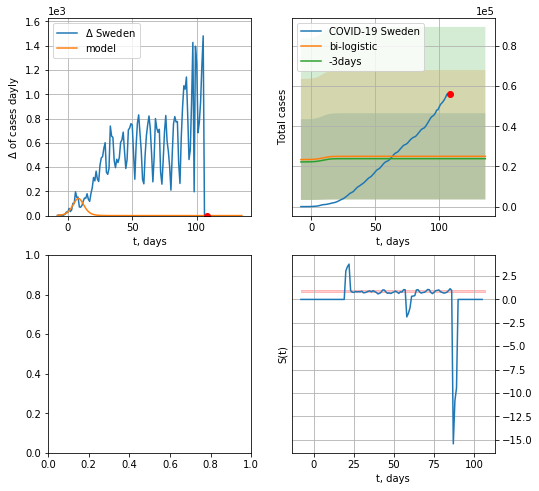

In [639]:
vL = 15#len(dfSW)-12-dT
x = forecast('Sweden',dfSW[:-9-dT],d1,7*14-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
           date  cases  active   death
112 2020-06-16  53323       0  4939.0
113 2020-06-17  54562       0  5041.0
114 2020-06-18  56043       0  5053.0
115 2020-06-19  56043       0  5053.0
116 2020-06-20  56043       0  5053.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

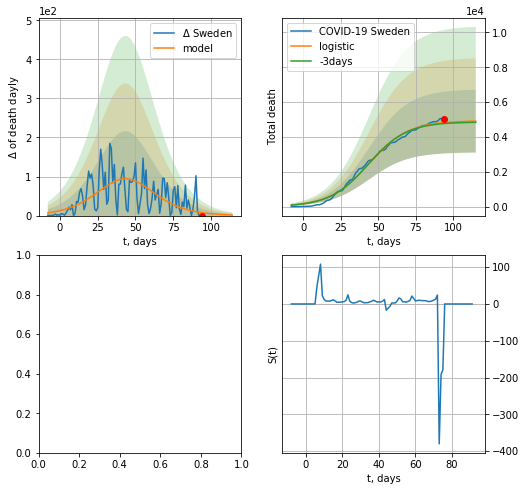

In [640]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


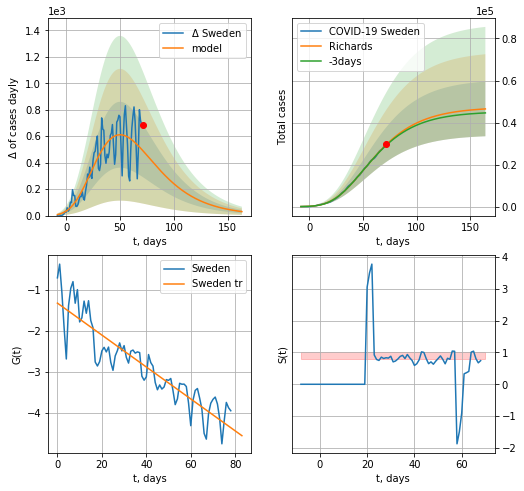

Sweden data at: 2020-06-18
+3 day model MAPE: 0.010517
model: Richards
coeffs: [ 4.73307988e+04  2.03831360e+00 -6.40325124e+01  1.73598705e-02]
rational stdev: 0.279833
forecast at the end of period: +93 days
	 deltaDaycases: 30
	 total cases: 46484 ± 13007
	 total death: 4191 ± 3518
trend coefficient of determination: 0.828153
 intercept: -1.321880
 slope: -0.038966


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


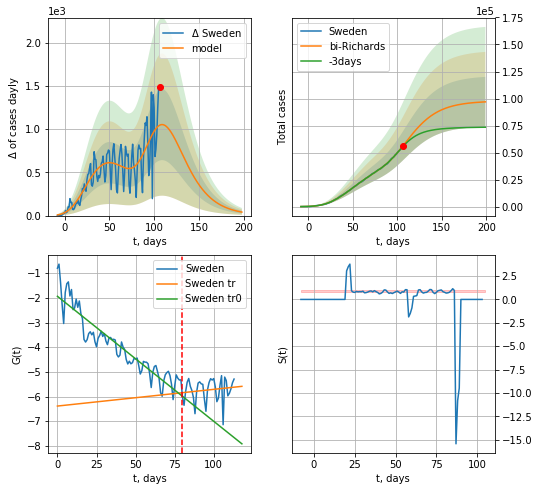

Sweden data at: 2020-06-18
+3 day model MAPE: 0.011272
model: bi-Richards
coeffs: [5.04354258e+04 3.34559612e-01 7.49812181e+01 1.51655643e-01]
rational stdev: 0.238570
forecast at the end of period: +93 days
	 deltaDaycases: 40
	 total cases: 96908 ± 23119
	 total death: 8737 ± 6253
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.862446
 intercept: -1.936169
 slope: -0.050683
trend coefficient of determination: 0.020888
 intercept: -6.386015
 slope: 0.006771


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


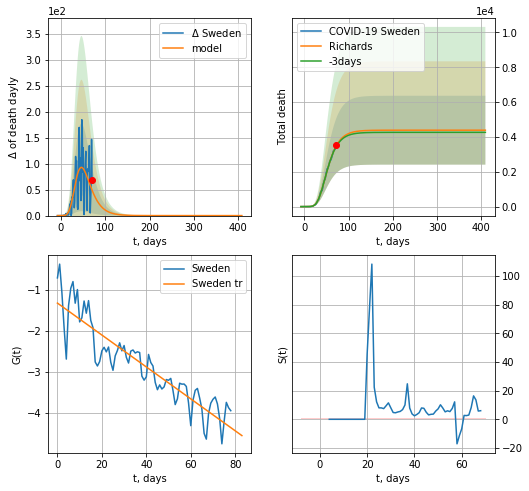

Sweden data at: 2020-06-18
+3 day model MAPE: 0.011124
model: Richards
coeffs: [ 4.38657395e+03  3.51961336e+00 -2.40389982e+01  1.65126178e-02]
rational stdev: 0.450450
forecast at the end of period: +338 days
	 total death: 4386 ± 1975
trend coefficient of determination: 0.827770
 intercept: -1.318103
 slope: -0.038888


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


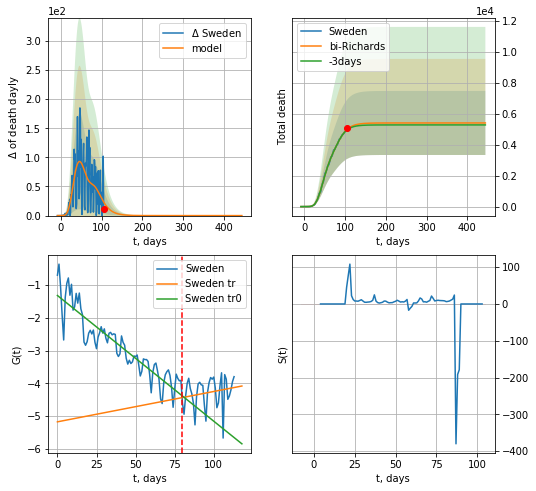

Sweden data at: 2020-06-18
+3 day model MAPE: 0.007616
model: bi-Richards
coeffs: [1.01716489e+03 4.53438115e+00 2.58285645e+01 1.49328011e-02]
rational stdev: 0.382800
forecast at the end of period: +338 days
	 total death: 5403 ± 2068
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.827060
 intercept: -1.322149
 slope: -0.038317
trend coefficient of determination: 0.038225
 intercept: -5.173311
 slope: 0.009251


In [142]:
vL = 80
x = forecastRR('Sweden',dfSW[:vL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sweden',dfSW[:],d1,25*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Sweden',dfSW[:vL],d1,60*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RR('Sweden',dfSW[:],d1,60*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


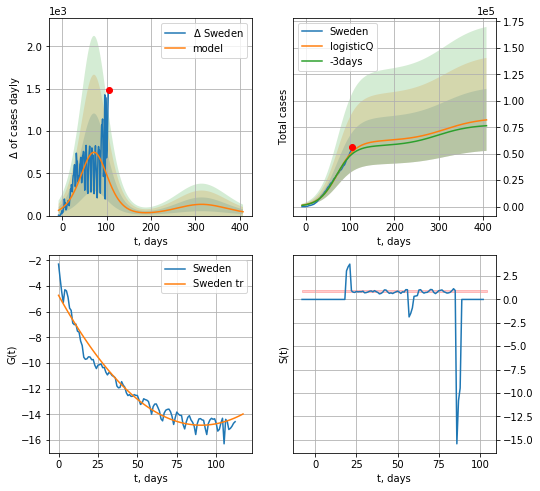

Sweden data at: 2020-06-18
+3 day model MAPE: 0.038133
model: logisticQ
coeffs: [ 6.20630328e+04  2.87534646e-07  7.21025386e+01 -1.67395751e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.357371
forecast at the end of period: +303 days
	 deltaDaycases: 45
	 total cases: 81986 ± 29299
	 total death: 7392 ± 7925
trend coefficient of determination: 0.958820
 intercept_: -4.715031927617985
 coeffs_: [ 0.         -0.22390949  0.001238  ]


In [143]:
x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


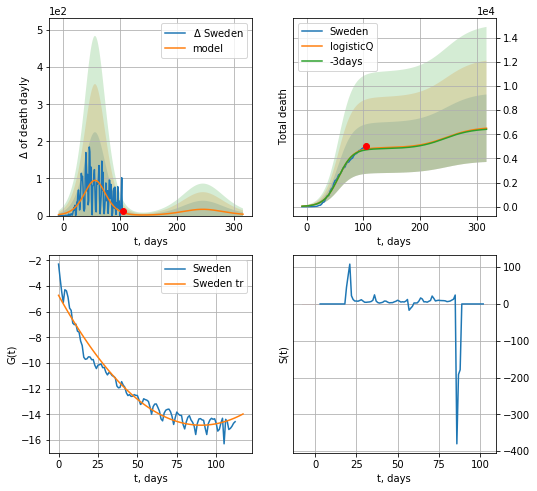

Sweden data at: 2020-06-18
+3 day model MAPE: 0.013713
model: logisticQ
coeffs: [ 4.87832846e+03  3.34901612e-07  5.64322575e+01 -2.32586900e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430776
forecast at the end of period: +212 days
	 total death: 6505 ± 2802
trend coefficient of determination: 0.958820
 intercept_: -4.715031927617985
 coeffs_: [ 0.         -0.22390949  0.001238  ]


In [144]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
146 2020-06-16  83265.0     252  4634.0
147 2020-06-17  83293.0     265  4634.0
148 2020-06-18  83325.0     293  4634.0
149 2020-06-19  83352.0     308  4634.0
150 2020-06-20  83378.0     331  4634.0


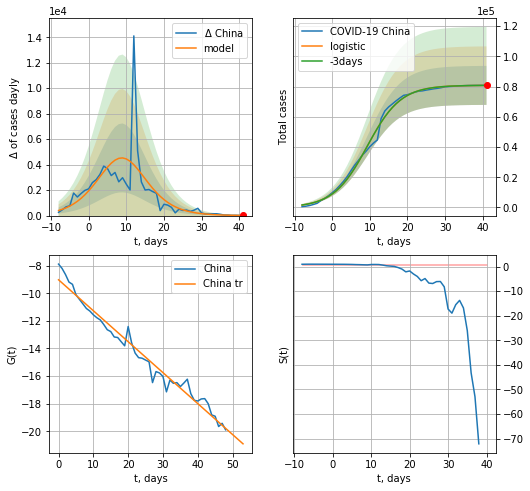

China data at: 2020-06-20
Exception occurs


In [641]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*12-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,14*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [642]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

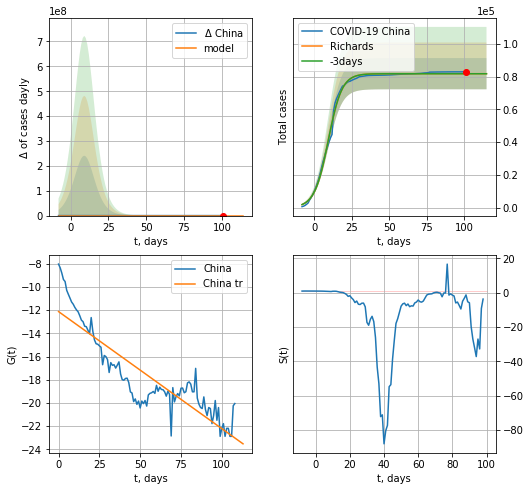

China data at: 2020-06-20
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736185e+04 2.15574478e-01 9.59539597e+00 1.02116157e+00]
rational stdev: 0.116457
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4544 ± 1587
trend coefficient of determination: 0.785239
 intercept: -12.125053
 slope: -0.100960


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


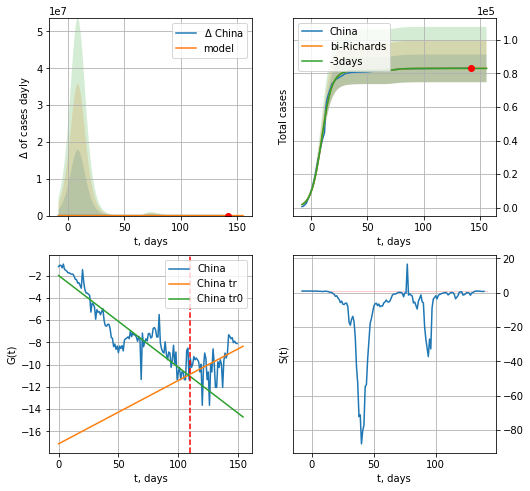

China data at: 2020-06-20
+3 day model MAPE: 0.000296
model: bi-Richards
coeffs: [1.24460119e+03 7.21867677e+01 4.05881086e+01 2.49834848e-03]
rational stdev: 0.099319
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 83018 ± 8245
	 total death: 4614 ± 1374
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.821002
 intercept: -1.978442
 slope: -0.082676
trend coefficient of determination: 0.195161
 intercept: -17.126988
 slope: 0.057010


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [643]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,14*7-dT,1.0)
xx = forecast2RR('China',dfCN[:],d1,14*7-dT,x,1.0,vL=vL)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

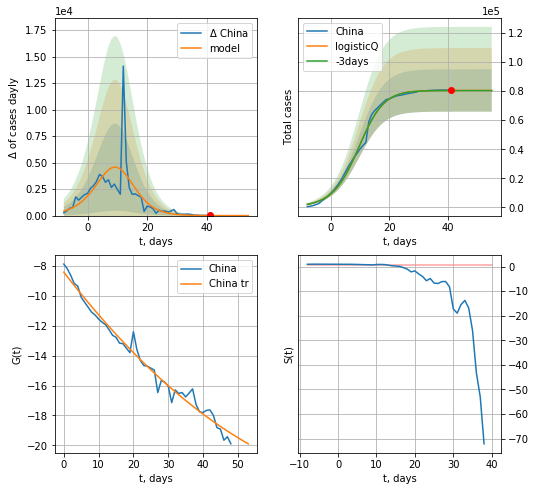

China data at: 2020-06-20
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 80417 ± 14557
	 total death: 4469 ± 2426
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


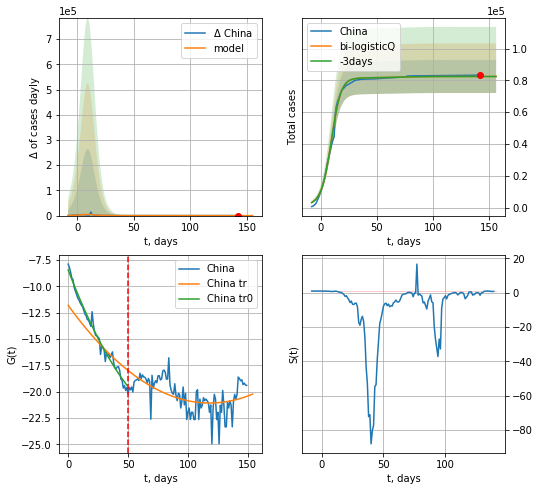

China data at: 2020-06-20
+3 day model MAPE: 0.000445
model: bi-logisticQ
coeffs: [ 2.01604010e+03  4.74280032e-04  2.47875370e+01 -3.56502322e-02]
rational stdev: 0.125998
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 82433 ± 10386
	 total death: 4581 ± 1731
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.309944
 intercept_: -11.802835518092884
 coeffs_: [ 0.         -0.15703336  0.00066436]


In [645]:
x = forecastRRR('China',dfCN[:50],d1,7*14-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,14*7-dT,x,1.0,vL=50)

In [646]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
122 2020-06-16  12198  1145.0  279.0
123 2020-06-17  12257  1177.0  280.0
124 2020-06-18  12306  1191.0  280.0
125 2020-06-19  12373  1237.0  280.0
126 2020-06-20  12421  1273.0  280.0


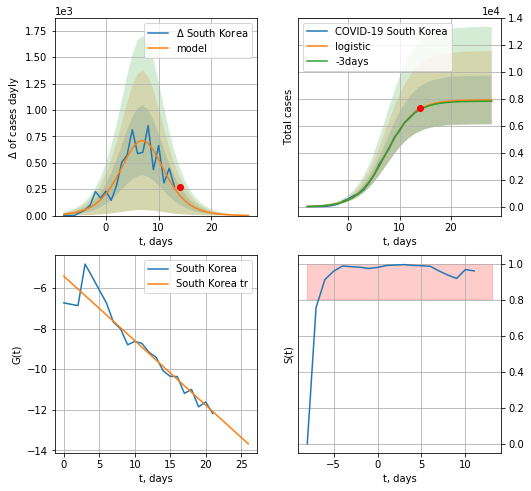

South Korea data at: 2020-06-20
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +14 days
	 deltaDaycases:  2
	 total cases:  7936 ± 1806
	 total death:  178 ± 121
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


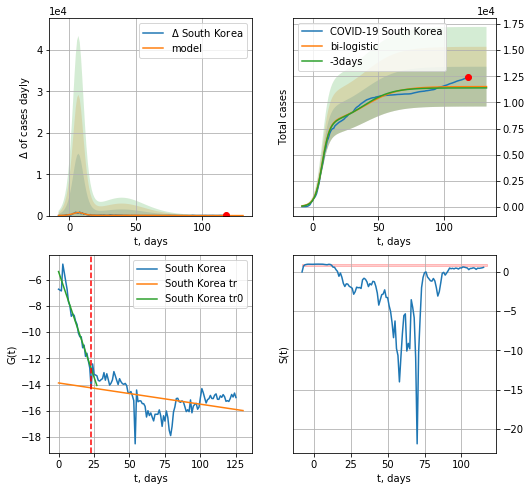

South Korea data at: 2020-06-20
+3 day model MAPE: 0.010601424436084717
model: bi-logistic
coeffs:  [3.56988159e+03 8.14561382e-02 4.01202588e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.16546817729117438
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  11509 ± 1904
	 total death:  259 ± 128
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.181195
 intercept: -13.875270
 slope: -0.016165


In [648]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*14-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,14*7-dT,x,1.0,vL=23)

In [649]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

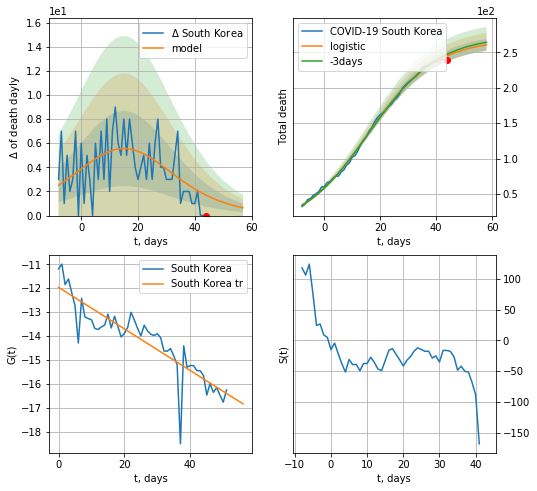

South Korea data at: 2020-06-20
model: logistic
coeffs:  [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.03241893689547546
forecast at the end of period: +14 days
	 total death:  260 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide


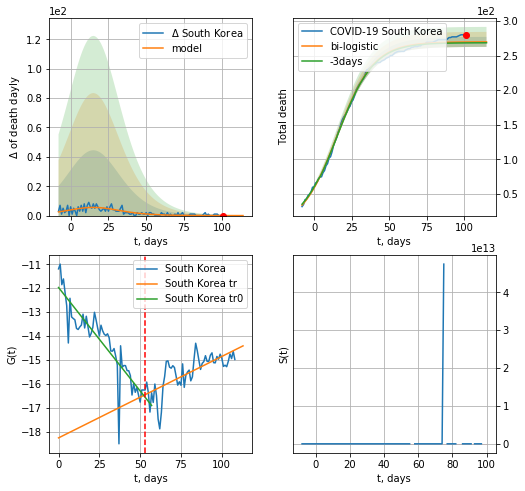

South Korea data at: 2020-06-20
+3 day model MAPE: 0.004699178919020023
model: bi-logistic
coeffs:  [ 1.41707949  0.02280503 10.44184156] [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.026726021024579594
forecast at the end of period: +14 days
	 deltaDaydeath:  0
	 total death:  269 ± 7
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.529586
 intercept: -18.260857
 slope: 0.034049


In [651]:
x = forecast('South Korea',dfKR[17:70],d1,14*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,14*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


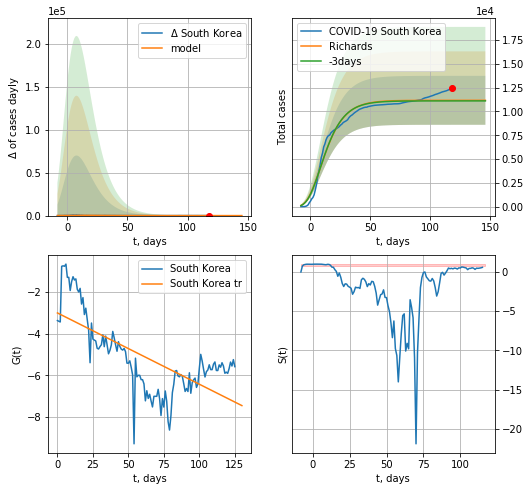

South Korea data at: 2020-06-20
+3 day model MAPE: 0.005542
model: Richards
coeffs: [ 1.11732405e+04  2.76450469e+01 -5.52806957e+01  3.25874087e-03]
rational stdev: 0.229569
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 11173 ± 2565
	 total death: 251 ± 172
trend coefficient of determination: 0.473612
 intercept: -3.012114
 slope: -0.034162


In [652]:
x = forecastRR('South Korea',dfKR[:],d1,16*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


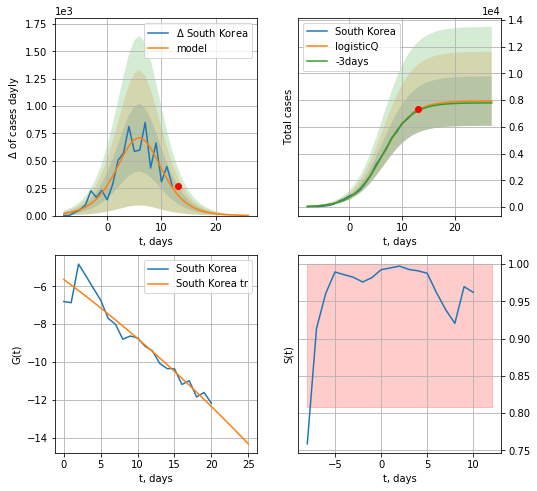

South Korea data at: 2020-06-20
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644801e+03  5.70813767e-05  6.37140978e+00 -6.30171017e+03]
rational stdev: 0.233522
forecast at the end of period: +14 days
	 deltaDaycases: 2
	 total cases: 7931 ± 1852
	 total death: 178 ± 124
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


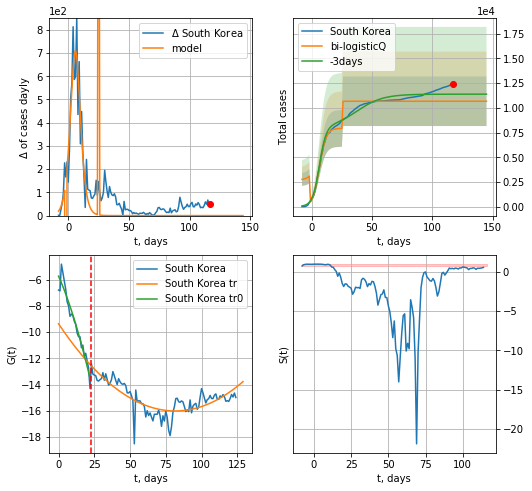

South Korea data at: 2020-06-20
+3 day model MAPE: 0.062637
model: bi-logisticQ
coeffs: [ 2.73493796e+03  4.23428268e+00  2.56053832e+01 -1.62698403e+00]
rational stdev: 0.234515
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 10671 ± 2502
	 total death: 240 ± 168
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.643267
 intercept_: -9.371144060947014
 coeffs_: [ 0.         -0.16262759  0.00099618]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [654]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,14*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

In [655]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


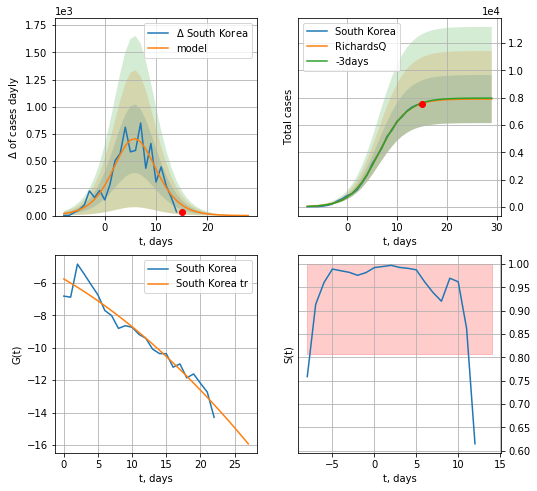

South Korea data at: 2020-06-20
+3 day model MAPE: 0.006079
model: RichardsQ
coeffs: [ 7.90607495e+03  3.14377481e-03 -1.32150046e+02  5.22462480e+00
  7.59593205e-01]
rational stdev: 0.222738
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 7904 ± 1760
	 total death: 178 ± 118
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:446: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:446: RuntimeWarning: overflow encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


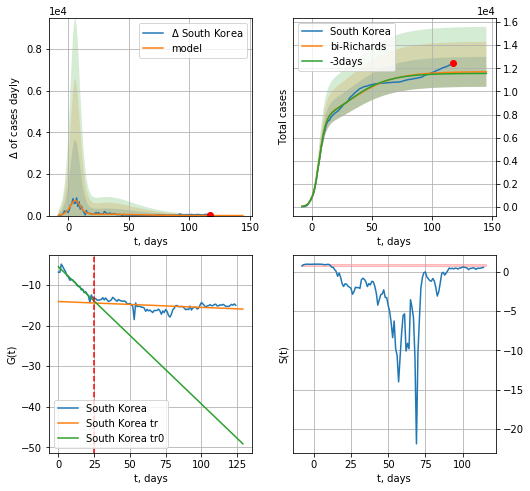

South Korea data at: 2020-06-20
+3 day model MAPE: 0.010571
model: bi-Richards
coeffs: [ 3.80275862e+03  7.57359884e-02 -1.50766063e+02 -2.52850456e+03
  2.34910961e-04]
rational stdev: 0.110812
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 11696 ± 1296
	 total death: 263 ± 87
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.936460
 intercept: -5.478818
 slope: -0.338423
trend coefficient of determination: 0.144192
 intercept: -14.051161
 slope: -0.014406


In [657]:
vL=25
x = forecastQR('South Korea',dfKR[1:vL],d1,14*7-dT,1.0)
xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


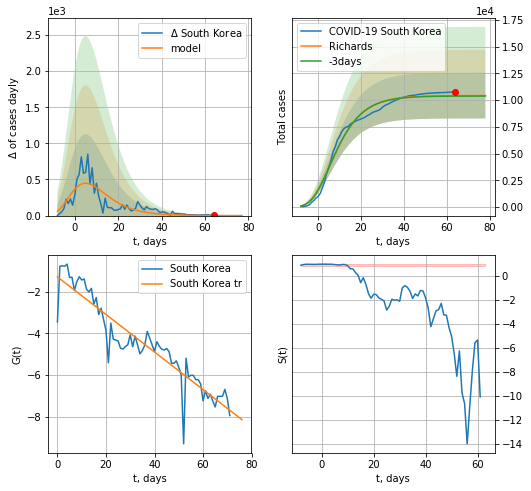

South Korea data at: 2020-06-20
+3 day model MAPE: 0.004451
model: Richards
coeffs: [ 1.04318163e+04  3.06447185e+01 -4.21690973e+01  3.81700530e-03]
rational stdev: 0.205493
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 10429 ± 2143
	 total death: 235 ± 144
trend coefficient of determination: 0.863609
 intercept: -1.289365
 slope: -0.090003


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


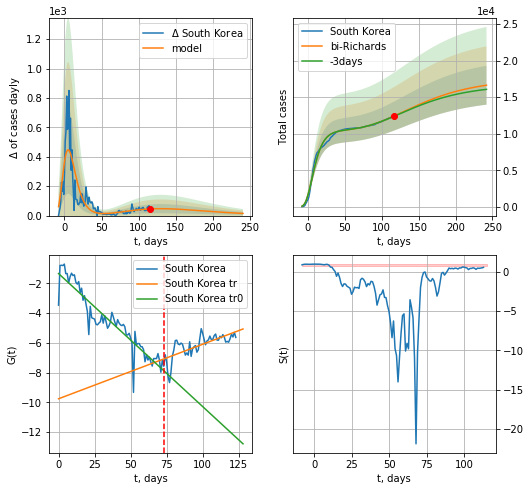

South Korea data at: 2020-06-20
+3 day model MAPE: 0.002635
model: bi-Richards
coeffs: [ 7.05305879e+03  2.21542671e+00 -1.33220142e+02  8.22440792e-03]
rational stdev: 0.159830
forecast at the end of period: +126 days
	 deltaDaycases: 14
	 total cases: 16622 ± 2656
	 total death: 374 ± 179
bi-Richards approximation splitting point: 73
trend coefficient of determination: 0.865727
 intercept: -1.337825
 slope: -0.089466
trend coefficient of determination: 0.515512
 intercept: -9.760254
 slope: 0.036674


In [659]:
vL = 2
vL1 = 75
x = forecastRR('South Korea',dfKR[vL:vL1],d1,14*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[vL:],d1,30*7-dT,x,1.0,vL=vL1-vL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [660]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


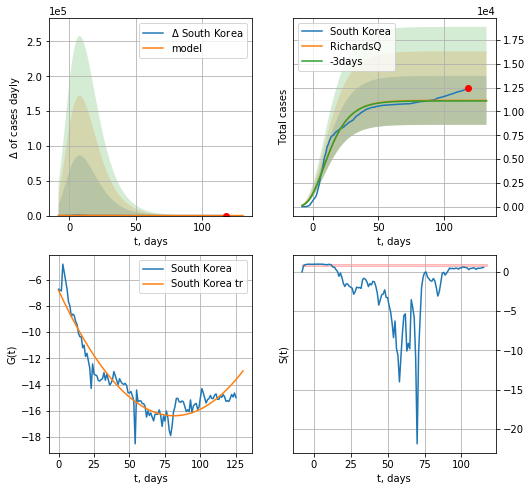

South Korea data at: 2020-06-20
+3 day model MAPE: 0.005563
model: RichardsQ
coeffs: [ 1.11679566e+04  1.22823755e-01 -8.86112861e+01 -3.37652258e+03
  2.10185456e-04]
rational stdev: 0.229870
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 11167 ± 2567
	 total death: 251 ± 173
trend coefficient of determination: 0.901971
 intercept_: -6.819124435997087
 coeffs_: [ 0.         -0.23482455  0.00144304]


In [662]:
x = forecastQR('South Korea',dfKR[:],d1,14*7-dT,1.0)

SG
           date    cases  active  death
145 2020-06-16  40969.0    9780   26.0
146 2020-06-17  41216.0    9252   26.0
147 2020-06-18  41473.0    8735   26.0
148 2020-06-19  41615.0    8130   26.0
149 2020-06-20  42095.0    7845   26.0


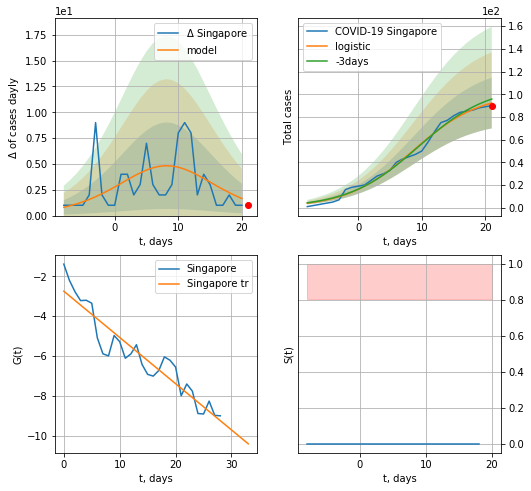

Singapore data at: 2020-06-20
Exception occurs


In [663]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*12-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,12*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


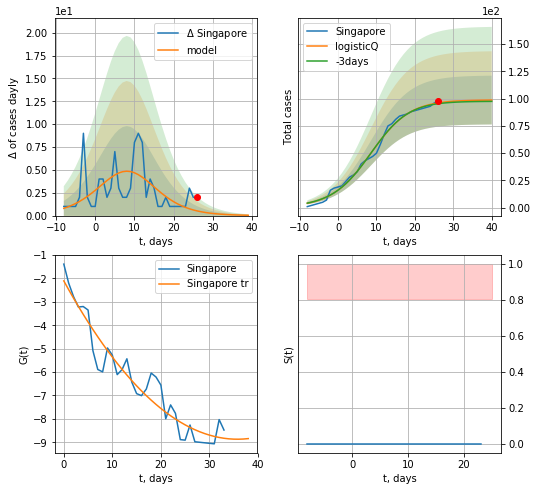

Singapore data at: 2020-06-20
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


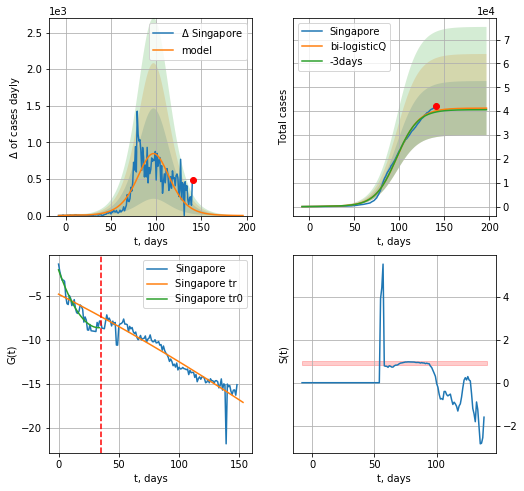

Singapore data at: 2020-06-20
+3 day model MAPE: 0.012873
model: bi-logisticQ
coeffs: [ 4.11623074e+04  4.04507499e-07  9.74994008e+01 -2.03509705e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.275008
forecast at the end of period: +56 days
	 deltaDaycases: 1
	 total cases: 41251 ± 11344
	 total death: 25 ± 20
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.911091
 intercept_: -4.810290593619761
 coeffs_: [ 0.00000000e+00 -7.03679655e-02 -6.65124297e-05]


In [665]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*14-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [666]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

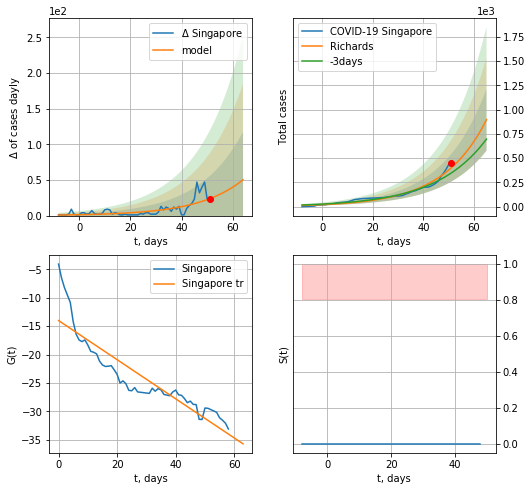

Singapore data at: 2020-06-20
+3 day model MAPE: 0.162175
model: Richards
coeffs: [9.30440928e+03 5.77261259e-02 1.05546035e+02 4.91744477e+00]
rational stdev: 0.355378
forecast at the end of period: +14 days
	 deltaDaycases: 50
	 total cases: 895 ± 318
	 total death: 0 ± 0
trend coefficient of determination: 0.813965
 intercept: -14.017324
 slope: -0.343928


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


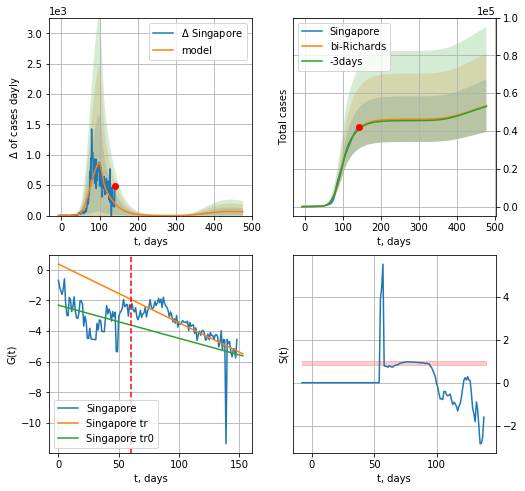

Singapore data at: 2020-06-20
+3 day model MAPE: 0.007891
model: bi-Richards
coeffs: [ 3.69629767e+04  5.29898315e+00 -2.23464486e+01  7.80672973e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.260613
forecast at the end of period: +336 days
	 deltaDaycases: 63
	 total cases: 53361 ± 13906
	 total death: 32 ± 25
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.125228
 intercept: -2.318831
 slope: -0.021610
trend coefficient of determination: 0.591080
 intercept: 0.358490
 slope: -0.038236


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


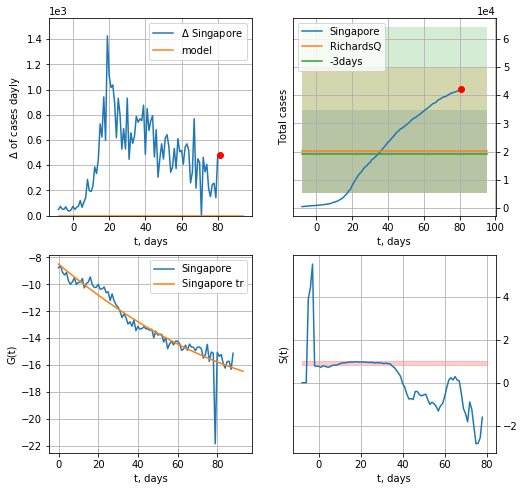

Singapore data at: 2020-06-20
+3 day model MAPE: 0.038793
model: RichardsQ
coeffs: [ 2.00325500e+04  1.64292524e+01 -3.40814477e+03  3.02639316e+03
 -6.58440687e+00]
rational stdev: 0.733657
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 20032 ± 14697
	 total death: 12 ± 26
trend coefficient of determination: 0.892840
 intercept_: -8.495315766678775
 coeffs_: [ 0.         -0.12320114  0.00040403]


In [668]:
vL = 60
x = forecastRR('Singapore',dfSG[:vL],d1,14*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[:],d1,60*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
x = forecastQR('Singapore',dfSG[60:],d1,14*7-dT,1.0)

ES
           date   cases  active  death
96  2020-06-16  1977.0     165   69.0
97  2020-06-17  1977.1     165   69.0
98  2020-06-18  1977.2     160   69.0
99  2020-06-19  1979.0     155   69.0
100 2020-06-20  1981.0     148   69.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


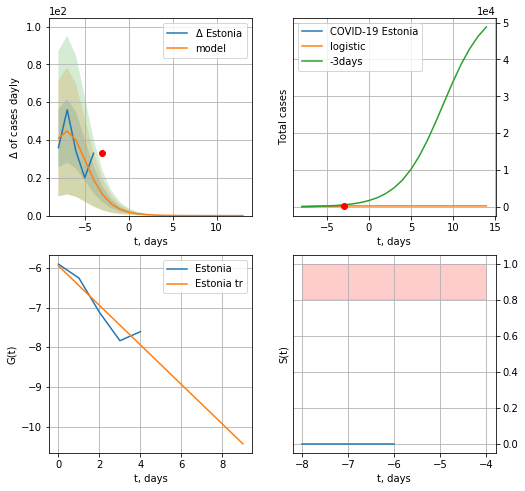

Estonia data at: 2020-06-20
+3 day model MAPE: 0.6707560476295664
model: logistic
coeffs:  [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.028784635346108894
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  9 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463


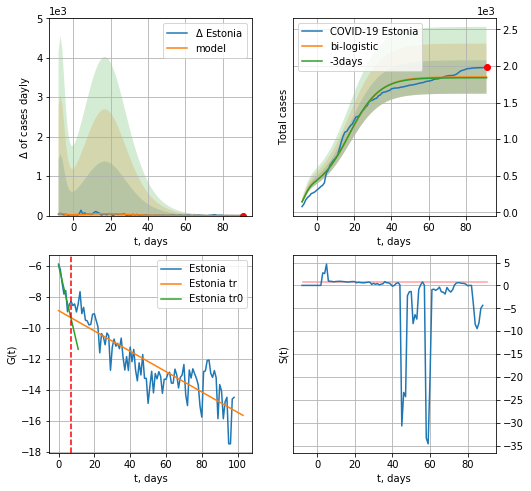

Estonia data at: 2020-06-20
Exception occurs


In [669]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    x = forecast('Estonia',dfES[1:7],d1,17,1.)
    xx = forecast2('Estonia',dfES[1:],d1,12*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

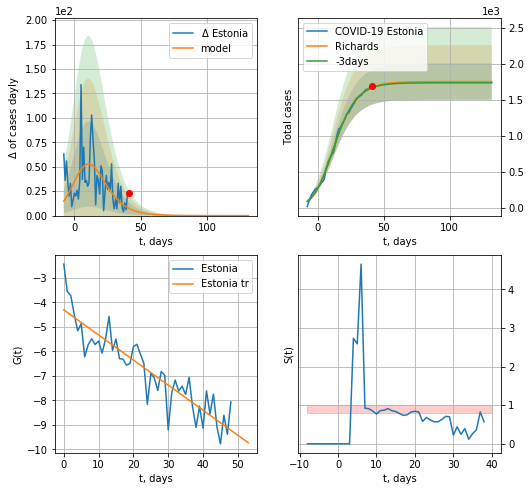

Estonia data at: 2020-06-20
+3 day model MAPE: 0.005500
model: Richards
coeffs: [1.74994618e+03 2.01777902e-01 4.40550518e+00 5.06367091e-01]
rational stdev: 0.144467
forecast at the end of period: +91 days
	 deltaDaycases: 0
	 total cases: 1749 ± 252
	 total death: 60 ± 26
trend coefficient of determination: 0.813896
 intercept: -4.307388
 slope: -0.102288


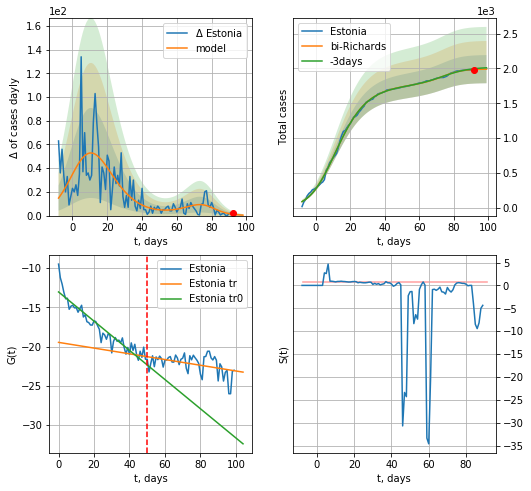

Estonia data at: 2020-06-20
+3 day model MAPE: 0.006490
model: bi-Richards
coeffs: [2.42441372e+02 9.31734551e-02 7.77045706e+01 2.12402468e+00]
rational stdev: 0.101651
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 1990 ± 202
	 total death: 69 ± 21
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.888011
 intercept: -13.049809
 slope: -0.185940
trend coefficient of determination: 0.186993
 intercept: -19.471762
 slope: -0.036419


In [670]:
vL=50
x = forecastRR('Estonia',dfES[:vL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[:],d1,7*13-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


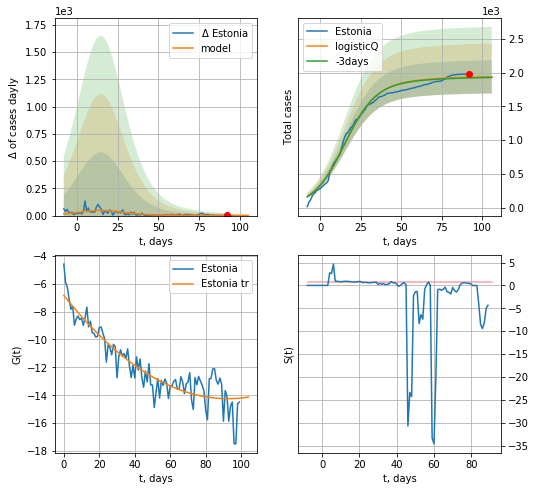

Estonia data at: 2020-06-20
+3 day model MAPE: 0.005032
model: logisticQ
coeffs: [ 1.86362661e+03  3.18592588e-07  1.50624152e+01 -3.18899202e+05]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.127102
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 1937 ± 246
	 total death: 67 ± 25
trend coefficient of determination: 0.841170
 intercept_: -6.838790098925572
 coeffs_: [ 0.         -0.1600748   0.00086503]


In [672]:
x = forecastRRR('Estonia',dfES[:],d1,7*14-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
101 2020-06-16  1098.0     195   28.0
102 2020-06-17  1104.0     199   30.0
103 2020-06-18  1108.0     175   30.0
104 2020-06-19  1110.0     177   30.0
105 2020-06-20  1111.0     178   30.0


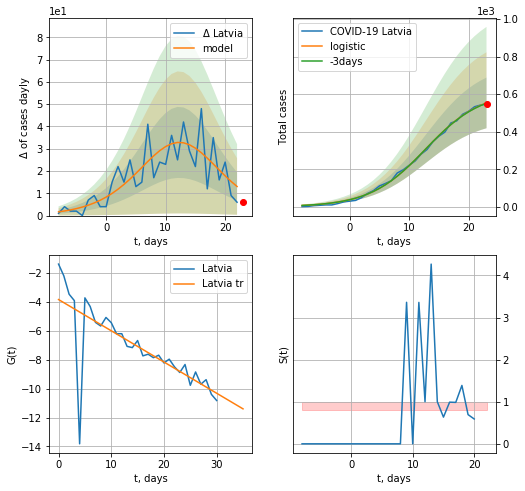

Latvia data at: 2020-06-20
Exception occurs


In [673]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,12*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,13*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


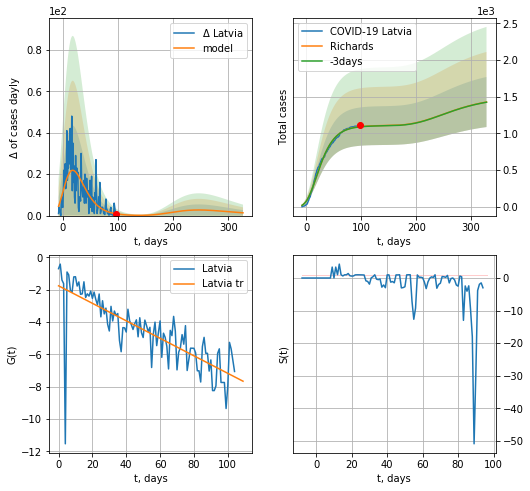

Latvia data at: 2020-06-20
+3 day model MAPE: 0.002574
model: Richards
coeffs: [ 1.10660293e+03  9.45746208e+00 -7.78116838e+01  5.69238307e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.239271
forecast at the end of period: +231 days
	 deltaDaycases: 1
	 total cases: 1426 ± 341
	 total death: 38 ± 27
trend coefficient of determination: 0.623748
 intercept: -1.757132
 slope: -0.054109


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


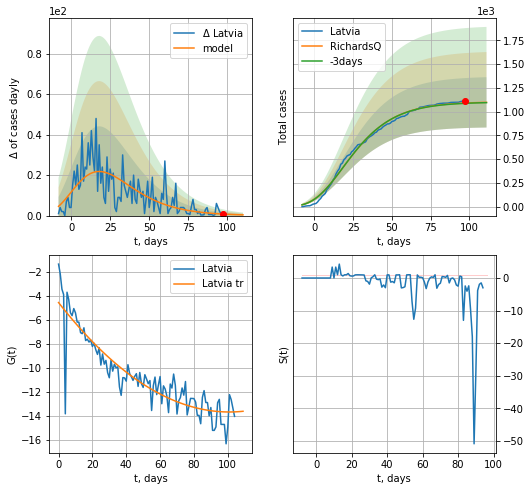

Latvia data at: 2020-06-20
+3 day model MAPE: 0.002801
model: RichardsQ
coeffs: [ 1.10332059e+03  3.18111226e-02 -1.25826857e+02 -2.28268588e+03
  6.90648703e-04]
rational stdev: 0.240952
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 1097 ± 264
	 total death: 29 ± 20
trend coefficient of determination: 0.813458
 intercept_: -4.576759828770178
 coeffs_: [ 0.         -0.18008803  0.00089247]


In [675]:
x = forecastRR('Latvia',dfLV[:],d1,7*45-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Latvia',dfLV[:],d1,7*14-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


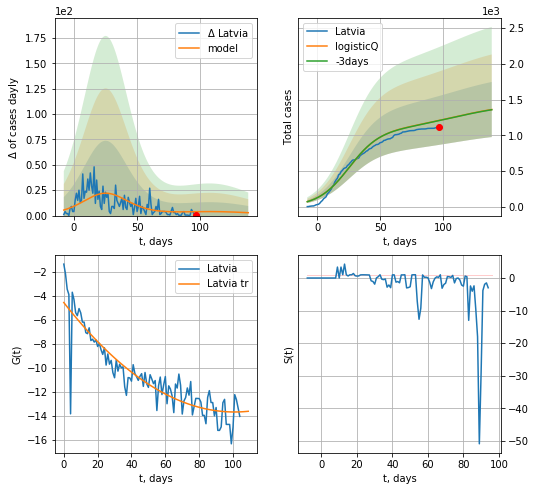

Latvia data at: 2020-06-20
+3 day model MAPE: 0.002613
model: logisticQ
coeffs: [ 1.07190814e+03  2.03339874e-07  2.53382826e+01 -3.96916094e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.283424
forecast at the end of period: +42 days
	 deltaDaycases: 2
	 total cases: 1360 ± 385
	 total death: 36 ± 30
trend coefficient of determination: 0.813458
 intercept_: -4.576759828770178
 coeffs_: [ 0.         -0.18008803  0.00089247]


In [676]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


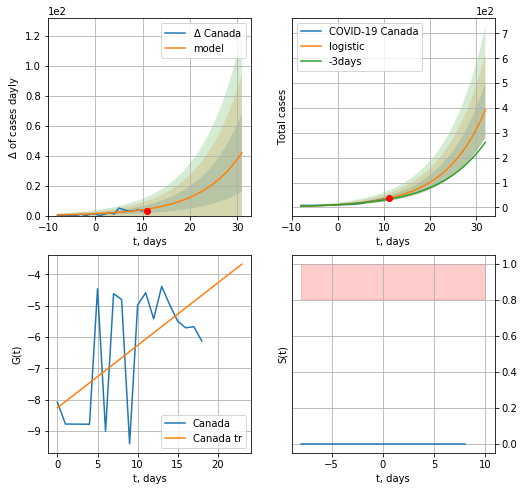

Canada data at: 2020-06-20
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  32 ± 27
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


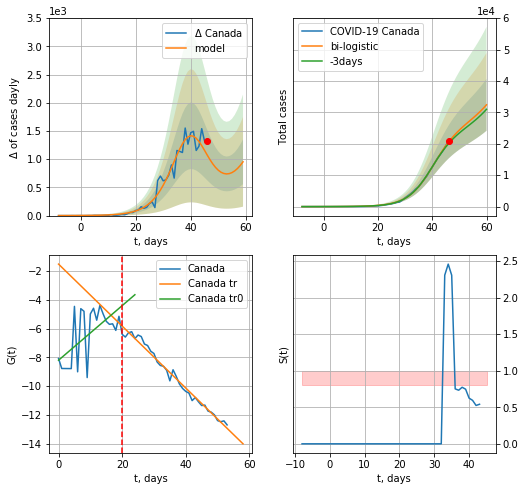

Canada data at: 2020-06-20
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +14 days
	 deltaDaycases:  953
	 total cases:  32410 ± 8262
	 total death:  2698 ± 2063
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


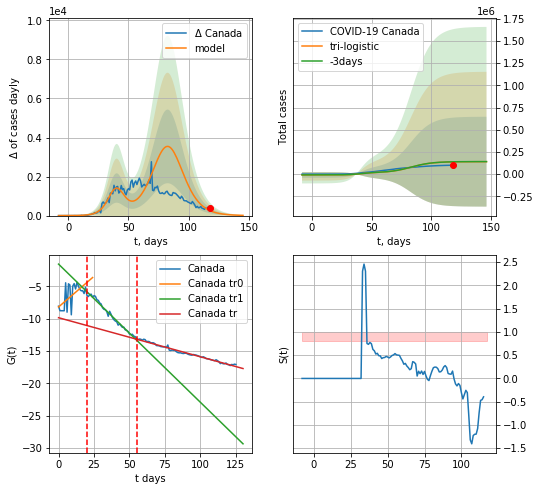

Canada data at: 2020-06-20
+3 day model MAPE: 0.006475125573341159
model: tri-logistic
coeffs:  [-8.84441709e+03 -3.97206372e+00  2.72119680e+02] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  3.6020156812654562
forecast at the end of period: +28 days
	 deltaDaycases:  11
	 total cases:  140412 ± 505768
	 total death:  11689 ± 126311
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.983961
 intercept: -9.852038
 slope: -0.060392


In [678]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,14*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active   death
122 2020-06-16   99467.0   29811  8213.0
123 2020-06-17   99853.0   29582  8254.0
124 2020-06-18  100220.0   29424  8300.0
125 2020-06-19  100629.0   29280  8346.0
126 2020-06-20  101019.0   29121  8410.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


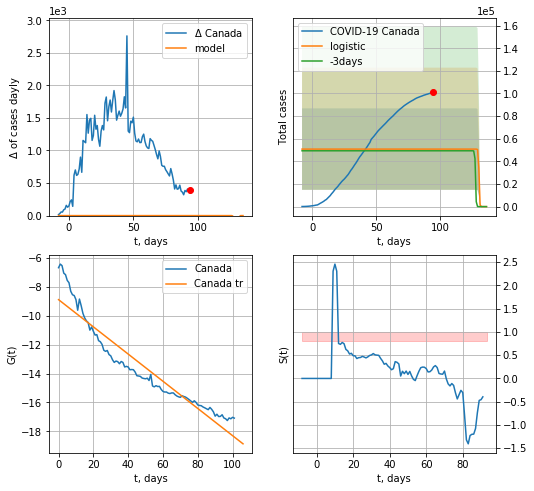

Canada data at: 2020-06-20
+3 day model MAPE: 0.030266957801546358
model: logistic
coeffs:  [ 5.08385437e+04 -4.27486723e+00  1.30174108e+02]
rational stdev:  0.7082325744038144
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.901589
 intercept: -8.899412
 slope: -0.093912


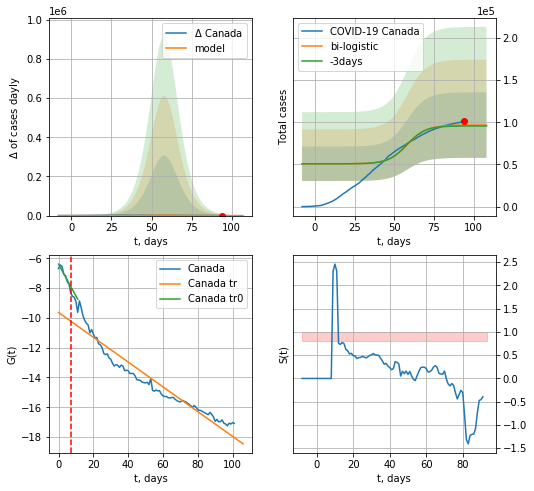

Canada data at: 2020-06-20
+3 day model MAPE: 0.009964470672250942
model: bi-logistic
coeffs:  [4.58329799e+04 1.67893840e-01 5.83128144e+01] [ 5.08385437e+04 -4.27486723e+00  1.30174108e+02]
rational stdev:  0.4013825757249424
forecast at the end of period: +14 days
	 deltaDaycases:  1
	 total cases:  96660 ± 38797
	 total death:  8047 ± 9689
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.922350
 intercept: -9.639528
 slope: -0.083136


In [679]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,14*7-dT,x,1.,vL=31-24,cases='cases')

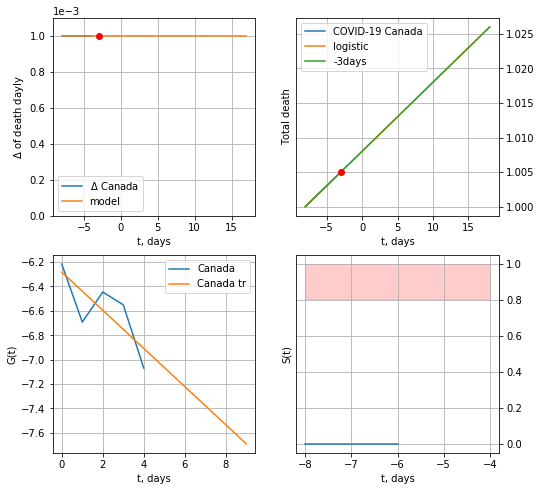

Canada data at: 2020-06-20
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


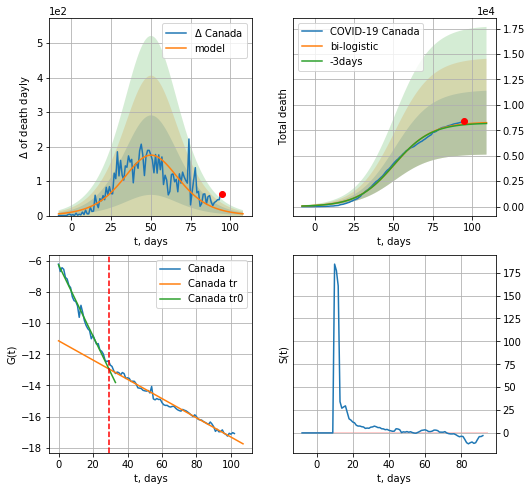

Canada data at: 2020-06-20
+3 day model MAPE: 0.008815510861221891
model: bi-logistic
coeffs:  [8.31002488e+03 8.43724925e-02 5.06701313e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.38024380430605964
forecast at the end of period: +14 days
	 deltaDaydeath:  5
	 total death:  8251 ± 3137
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.982663
 intercept: -11.135257
 slope: -0.061743


In [681]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,14*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


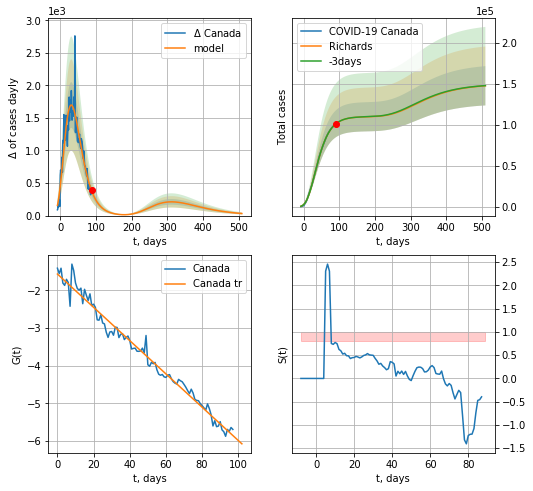

Canada data at: 2020-06-20
+3 day model MAPE: 0.000549
model: Richards
coeffs: [ 1.10067783e+05  3.68878196e+00 -7.48062506e+01  1.14347897e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.162106
forecast at the end of period: +420 days
	 deltaDaycases: 31
	 total cases: 147717 ± 23945
	 total death: 12297 ± 5980
trend coefficient of determination: 0.979899
 intercept: -1.564717
 slope: -0.044174


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


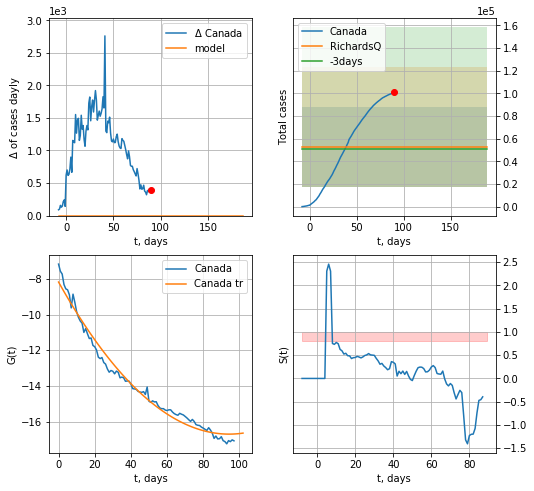

Canada data at: 2020-06-20
+3 day model MAPE: 0.029025
model: RichardsQ
coeffs: [ 5.28871212e+04 -1.80974227e+00 -1.02933962e+02 -5.23508154e+02
 -7.66377722e-01]
rational stdev: 0.666017
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 52887 ± 35223
	 total death: 4402 ± 8795
trend coefficient of determination: 0.980509
 intercept_: -8.180707550536916
 coeffs_: [ 0.         -0.18073179  0.00095812]


In [682]:
x = forecastRR('Canada',dfCA[28:],d1,60*7,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Canada',dfCA[28:],d1,14*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


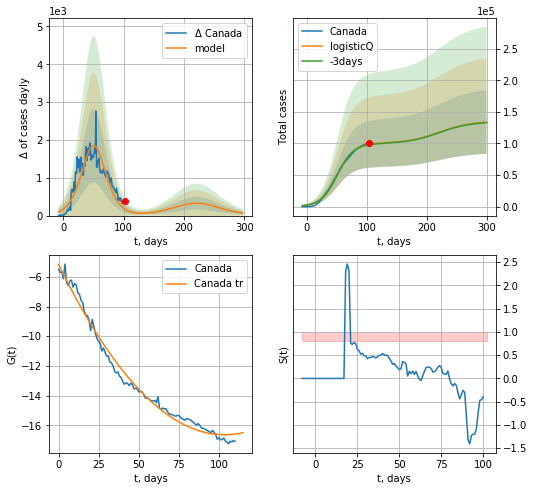

Canada data at: 2020-06-20
+3 day model MAPE: 0.006168
model: logisticQ
coeffs: [ 1.00211325e+05  3.94925320e-07  5.07087488e+01 -1.86231557e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.375749
forecast at the end of period: +196 days
	 deltaDaycases: 66
	 total cases: 133827 ± 50285
	 total death: 11141 ± 12558
trend coefficient of determination: 0.986865
 intercept_: -5.163332561184669
 coeffs_: [ 0.         -0.22180925  0.00107212]


In [683]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date  cases  active   death
106 2020-06-16  37336   12602  1522.0
107 2020-06-17  37672   12569  1523.0
108 2020-06-18  38089   12555  1524.0
109 2020-06-19  38464   12460  1527.0
110 2020-06-20  38841   12407  1528.0


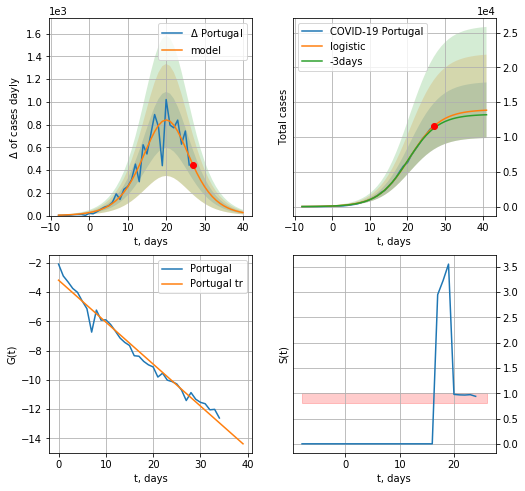

Portugal data at: 2020-06-20
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +14 days
	 deltaDaycases:  26
	 total cases:  13845 ± 3988
	 total death:  544 ± 470
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


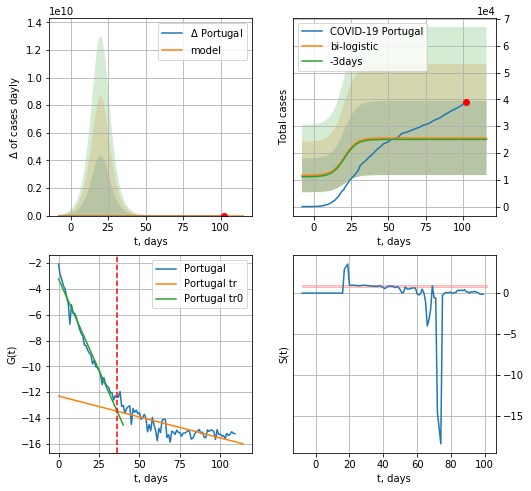

Portugal data at: 2020-06-20
+3 day model MAPE: 0.021069308102580835
model: bi-logistic
coeffs:  [ 9.31512150e+03 -4.94252408e+00  7.95807464e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.5398772309021347
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  25587 ± 13814
	 total death:  1006 ± 1629
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.604726
 intercept: -12.298537
 slope: -0.032446


In [685]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,14*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


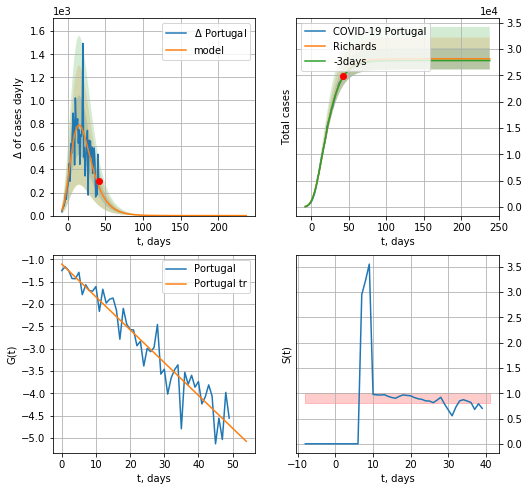

Portugal data at: 2020-06-20
+3 day model MAPE: 0.006186
model: Richards
coeffs: [ 2.81616178e+04  5.39214197e+00 -4.03941749e+01  1.41510332e-02]
rational stdev: 0.071740
forecast at the end of period: +196 days
	 deltaDaycases: 0
	 total cases: 28161 ± 2020
	 total death: 1107 ± 238
trend coefficient of determination: 0.913504
 intercept: -1.105984
 slope: -0.073555


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


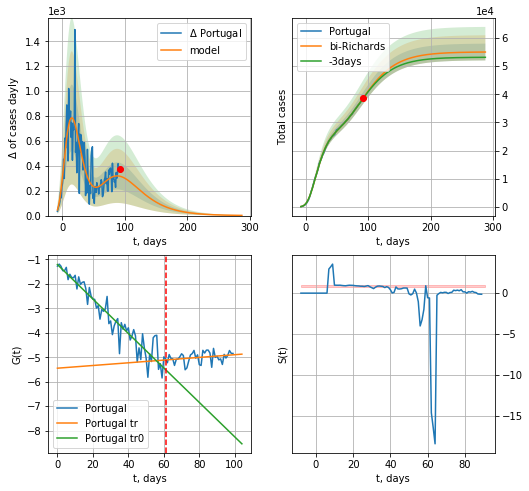

Portugal data at: 2020-06-20
+3 day model MAPE: 0.003275
model: bi-Richards
coeffs: [ 2.68882922e+04  1.59284890e+00 -3.32335594e+01  1.99472034e-02]
rational stdev: 0.054122
forecast at the end of period: +196 days
	 deltaDaycases: 1
	 total cases: 55000 ± 2976
	 total death: 2163 ± 351
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.904679
 intercept: -1.212287
 slope: -0.070432
trend coefficient of determination: 0.079835
 intercept: -5.447384
 slope: 0.005514


In [686]:
vL=61+10
x = forecastRR('Portugal',dfPT[10:vL-10],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[10:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


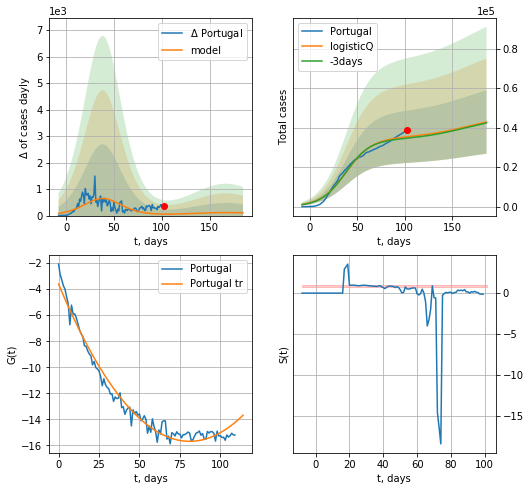

Portugal data at: 2020-06-20
+3 day model MAPE: 0.020274
model: logisticQ
coeffs: [ 3.46798107e+04  1.72559417e-07  3.84661520e+01 -4.30650938e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.374843
forecast at the end of period: +84 days
	 deltaDaycases: 102
	 total cases: 42847 ± 16061
	 total death: 1685 ± 1894
trend coefficient of determination: 0.975039
 intercept_: -3.608723353544603
 coeffs_: [ 0.         -0.29800388  0.00183925]


In [687]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

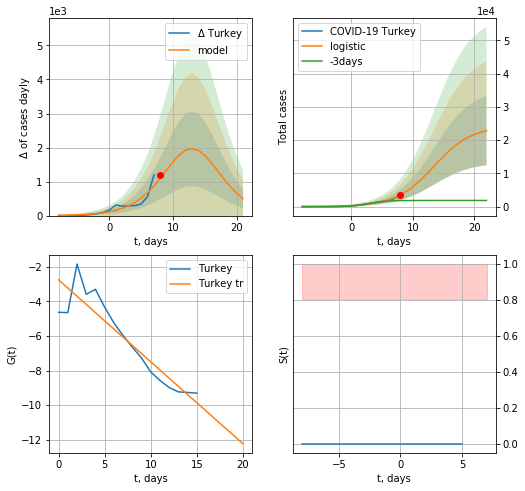

Turkey data at: 2020-06-20
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +14 days
	 deltaDaycases:  501
	 total cases:  22853 ± 10403
	 total death:  603 ± 823
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


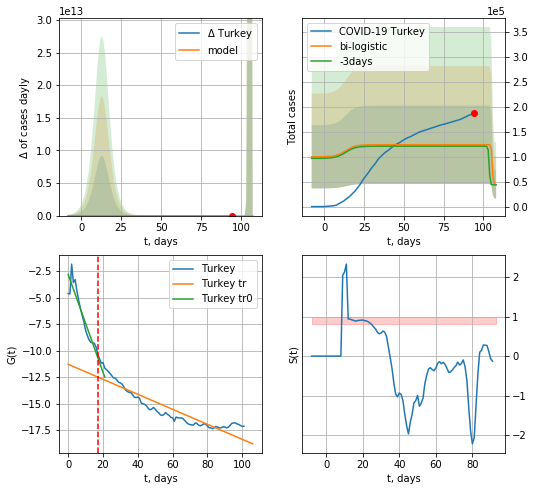

Turkey data at: 2020-06-20
+3 day model MAPE: 0.025249609760540345
model: bi-logistic
coeffs:  [ 7.96583182e+04 -3.55239983e+00  1.05602030e+02] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6344033164464541
forecast at the end of period: +14 days
	 deltaDaycases:  -535
	 total cases:  44197 ± 28039
	 total death:  1167 ± 2221
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.834697
 intercept: -11.294041
 slope: -0.070836


In [689]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*14-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,14*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


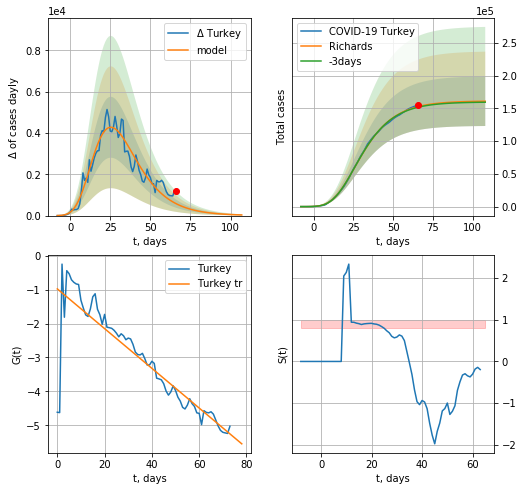

Turkey data at: 2020-06-20
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234317e+05  5.77708690e+00 -3.44331101e+01  1.25674474e-02]
rational stdev: 0.235071
forecast at the end of period: +42 days
	 deltaDaycases: 31
	 total cases: 160820 ± 37804
	 total death: 4248 ± 2995
trend coefficient of determination: 0.775257
 intercept: -0.978832
 slope: -0.058549


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


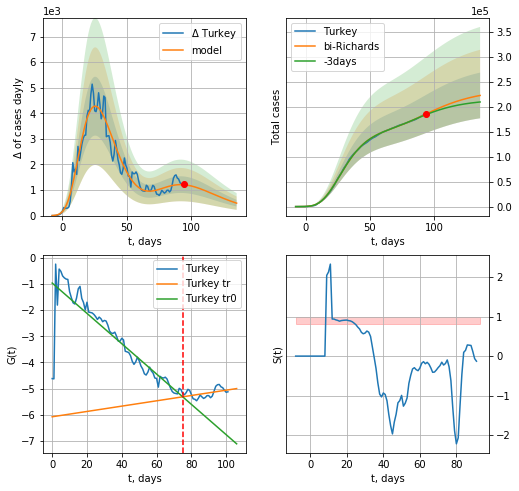

Turkey data at: 2020-06-20
+3 day model MAPE: 0.008317
model: bi-Richards
coeffs: [ 7.41653583e+04  4.47973794e+00 -1.73290113e+01  9.26762397e-03]
rational stdev: 0.205496
forecast at the end of period: +42 days
	 deltaDaycases: 485
	 total cases: 222795 ± 45783
	 total death: 5886 ± 3628
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.776848
 intercept: -0.966312
 slope: -0.057925
trend coefficient of determination: 0.205786
 intercept: -6.073541
 slope: 0.010161


In [690]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Turkey',dfTR[:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


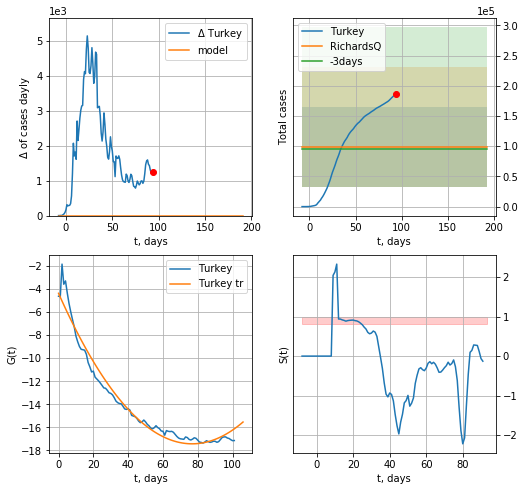

Turkey data at: 2020-06-20
+3 day model MAPE: 0.026988
model: RichardsQ
coeffs: [ 9.87527478e+04  3.13598317e+00 -9.76288534e+02  8.13969887e+02
 -1.70025943e+00]
rational stdev: 0.670577
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 98752 ± 66221
	 total death: 2608 ± 5246
trend coefficient of determination: 0.968333
 intercept_: -4.37202761638245
 coeffs_: [ 0.         -0.3400639   0.00221439]


In [691]:
x = forecastQR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


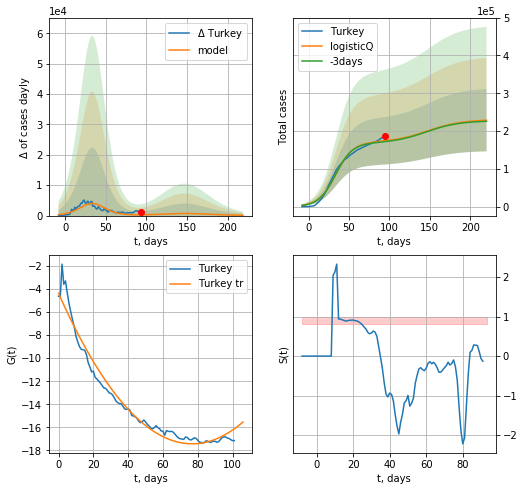

Turkey data at: 2020-06-20
+3 day model MAPE: 0.013432
model: logisticQ
coeffs: [ 1.70207616e+05  2.28137662e-07  3.38213243e+01 -4.11135649e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.359986
forecast at the end of period: +126 days
	 deltaDaycases: 88
	 total cases: 228590 ± 82289
	 total death: 6039 ± 6521
trend coefficient of determination: 0.968333
 intercept_: -4.37202761638245
 coeffs_: [ 0.         -0.3400639   0.00221439]


In [692]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [693]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.027002700270027002

In [694]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

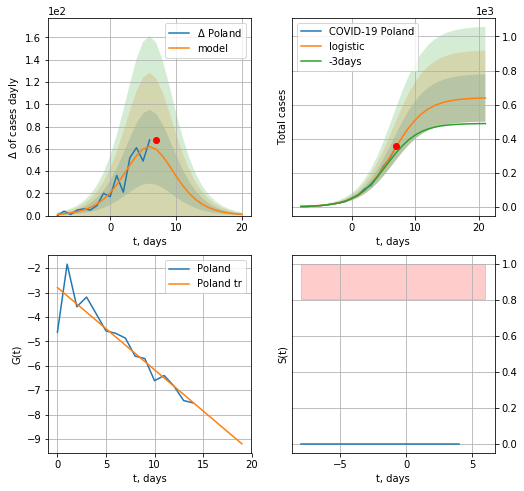

Poland data at: 2020-06-20
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +14 days
	 deltaDaycases:  1
	 total cases:  638 ± 139
	 total death:  27 ± 17
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


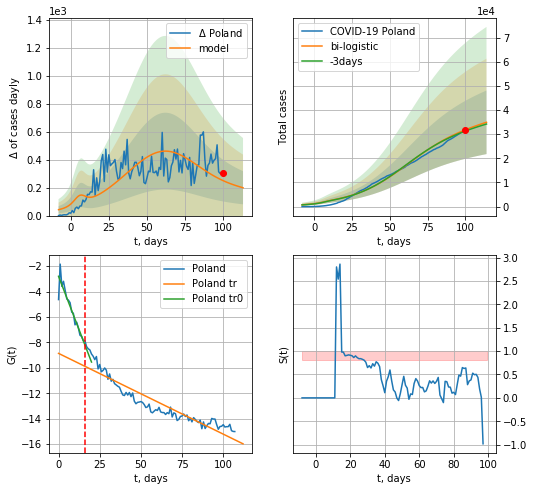

Poland data at: 2020-06-20
+3 day model MAPE: 0.016791630089794382
model: bi-logistic
coeffs:  [3.29114436e+04 5.41642701e-02 6.13732704e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37709086417025667
forecast at the end of period: +14 days
	 deltaDaycases:  199
	 total cases:  34911 ± 13164
	 total death:  1486 ± 1681
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.862175
 intercept: -8.857020
 slope: -0.063515


In [696]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*14-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,14*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


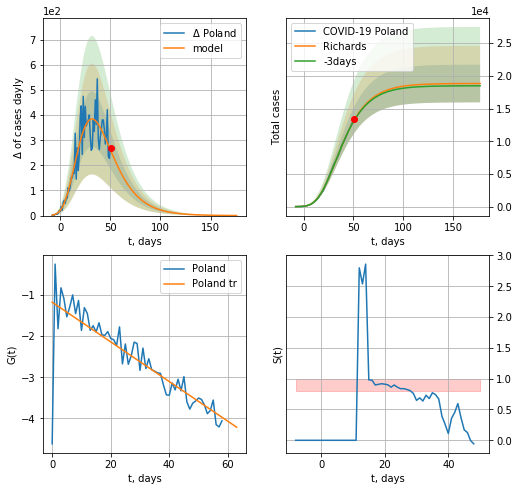

Poland data at: 2020-06-20
+3 day model MAPE: 0.005819
model: Richards
coeffs: [ 1.88418055e+04  3.45583442e+00 -4.15713344e+01  1.61921023e-02]
rational stdev: 0.153201
forecast at the end of period: +126 days
	 deltaDaycases: 0
	 total cases: 18836 ± 2885
	 total death: 801 ± 368
trend coefficient of determination: 0.708781
 intercept: -1.177313
 slope: -0.048172


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


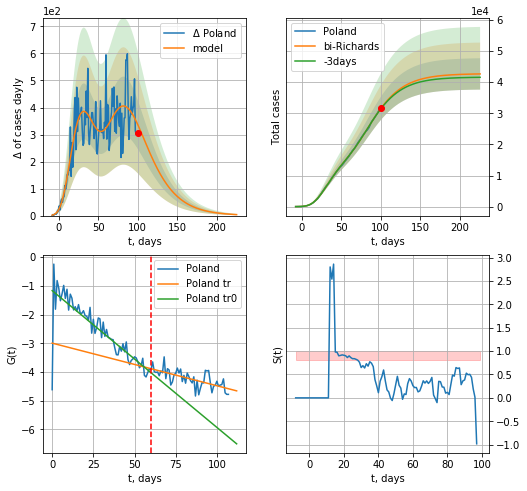

Poland data at: 2020-06-20
+3 day model MAPE: 0.004526
model: bi-Richards
coeffs: [ 2.39120938e+04  3.14672592e+00 -1.99935794e+01  1.28725617e-02]
rational stdev: 0.118119
forecast at the end of period: +126 days
	 deltaDaycases: 3
	 total cases: 42666 ± 5039
	 total death: 1816 ± 643
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.712988
 intercept: -1.168862
 slope: -0.047588
trend coefficient of determination: 0.449667
 intercept: -2.995445
 slope: -0.014825


In [697]:
vL = 60
x =  forecastRR('Poland',dfPL[:vL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RR('Poland',dfPL[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


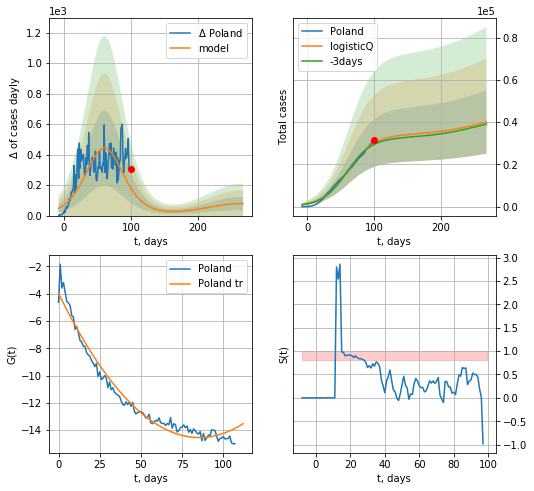

Poland data at: 2020-06-20
+3 day model MAPE: 0.022794
model: logisticQ
coeffs: [ 3.38200121e+04  2.74005412e-07  6.08249695e+01 -1.90604129e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.374831
forecast at the end of period: +168 days
	 deltaDaycases: 78
	 total cases: 40035 ± 15006
	 total death: 1704 ± 1916
trend coefficient of determination: 0.969474
 intercept_: -3.980512881790026
 coeffs_: [ 0.         -0.24710464  0.00144478]


In [698]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date    cases  active  death
115 2020-06-16  19495.0    3744  302.0
116 2020-06-17  19783.0    4021  303.0
117 2020-06-18  20036.0    4215  303.0
118 2020-06-19  20339.0    4449  304.0
119 2020-06-20  20633.0    4742  305.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


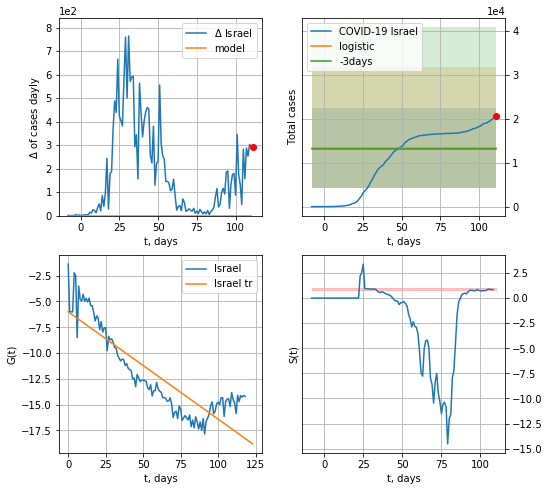

Israel data at: 2020-06-20
Exception occurs


In [699]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,12*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


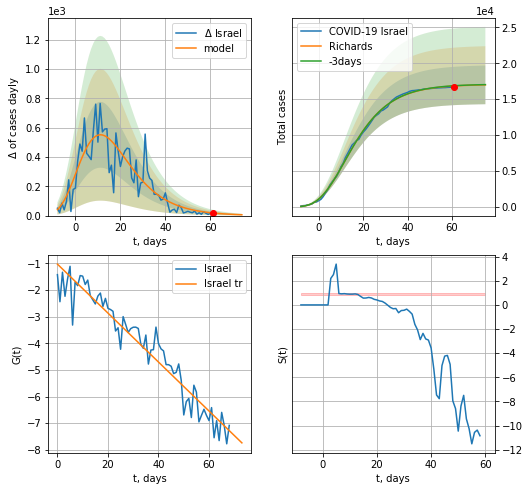

Israel data at: 2020-06-20
+3 day model MAPE: 0.001944
model: Richards
coeffs: [ 1.70515699e+04  6.43111297e+00 -3.67763089e+01  1.37701544e-02]
rational stdev: 0.158199
forecast at the end of period: +14 days
	 deltaDaycases: 5
	 total cases: 16989 ± 2687
	 total death: 251 ± 119
trend coefficient of determination: 0.925544
 intercept: -1.027514
 slope: -0.091953


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


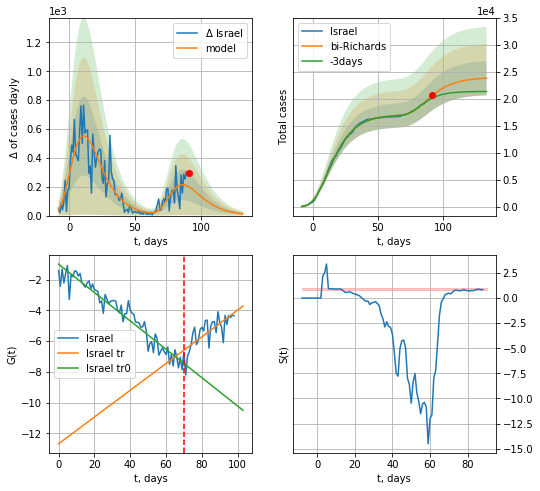

Israel data at: 2020-06-20
+3 day model MAPE: 0.023563
model: bi-Richards
coeffs: [6.91285209e+03 8.22607000e+00 3.20452301e+01 1.01922467e-02]
rational stdev: 0.132782
forecast at the end of period: +42 days
	 deltaDaycases: 12
	 total cases: 23822 ± 3163
	 total death: 352 ± 140
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.927871
 intercept: -0.987120
 slope: -0.092425
trend coefficient of determination: 0.560103
 intercept: -12.689020
 slope: 0.087105


In [701]:
x = forecastRR('Israel',dfIS[20:90],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=90-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


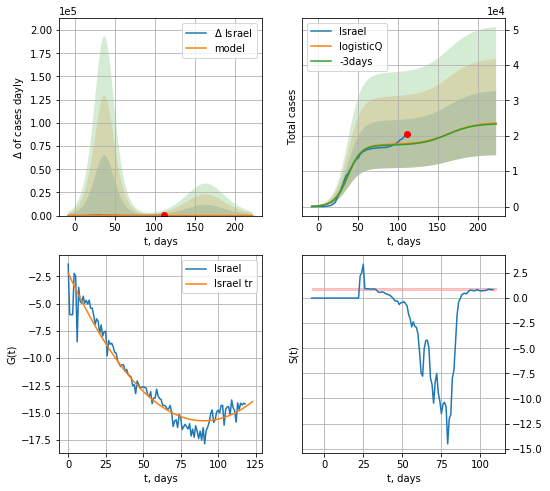

Israel data at: 2020-06-20
+3 day model MAPE: 0.012903
model: logisticQ
coeffs: [ 1.75505785e+04  3.28157620e-07  3.75813206e+01 -3.58499320e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.384010
forecast at the end of period: +112 days
	 deltaDaycases: 10
	 total cases: 23584 ± 9056
	 total death: 348 ± 400
trend coefficient of determination: 0.941769
 intercept_: -2.1978272624674506
 coeffs_: [ 0.         -0.29945147  0.00165688]


In [702]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


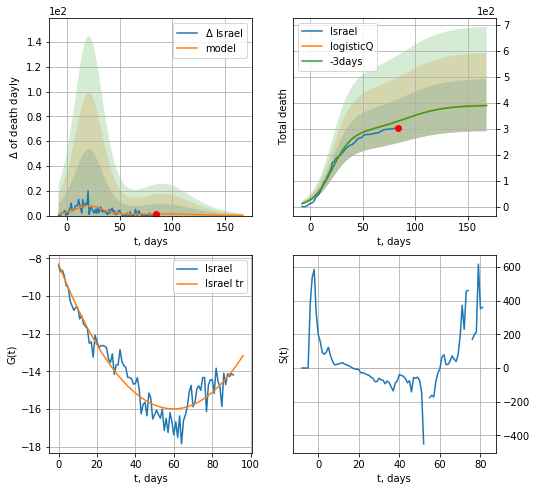

Israel data at: 2020-06-20
+3 day model MAPE: 0.002934
model: logisticQ
coeffs: [ 2.90667091e+02  3.76068770e-07  2.10324620e+01 -2.84576367e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.256429
forecast at the end of period: +84 days
	 total death: 391 ± 100
trend coefficient of determination: 0.913714
 intercept_: -8.30805278120151
 coeffs_: [ 0.         -0.25685828  0.00214842]


In [703]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


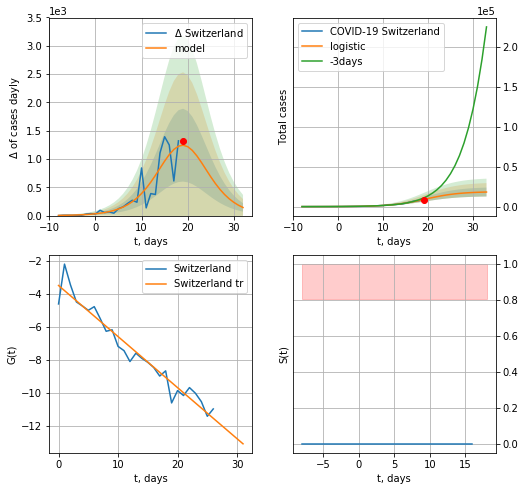

Switzerland data at: 2020-06-20
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +14 days
	 deltaDaycases:  143
	 total cases:  18220 ± 5576
	 total death:  1140 ± 1046
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


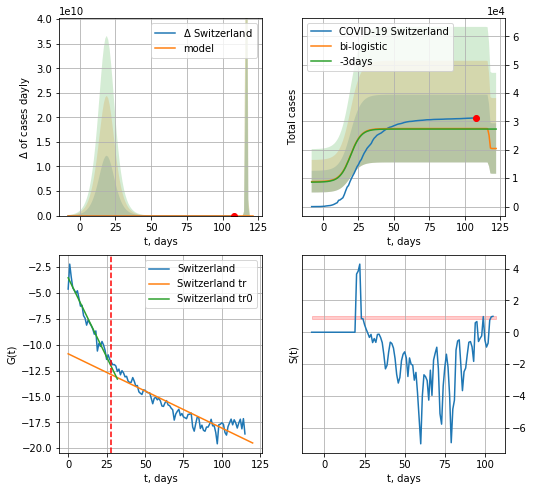

Switzerland data at: 2020-06-20
+3 day model MAPE: 0.006612926529673409
model: bi-logistic
coeffs:  [ 7.02925069e+03 -4.36911453e+00  1.17160109e+02] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.4339936432558518
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  20463 ± 8881
	 total death:  1281 ± 1667
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.859784
 intercept: -10.880198
 slope: -0.071801


In [705]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*14-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*14-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


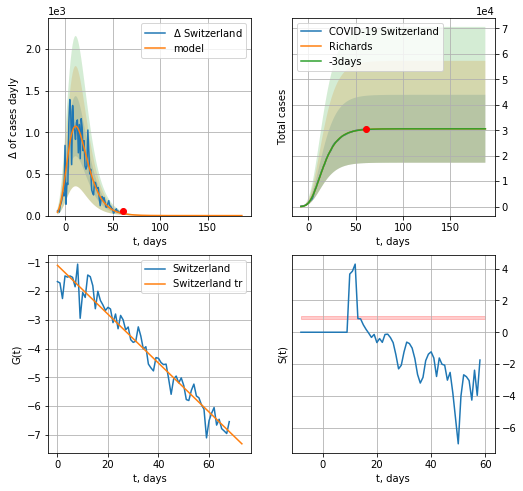

Switzerland data at: 2020-06-20
+3 day model MAPE: 0.000900
model: Richards
coeffs: [ 3.05802442e+04  7.81133256e+00 -3.41505008e+01  1.22973970e-02]
rational stdev: 0.435595
forecast at the end of period: +126 days
	 deltaDaycases: 0
	 total cases: 30580 ± 13320
	 total death: 1914 ± 2501
trend coefficient of determination: 0.956477
 intercept: -1.104106
 slope: -0.085019


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


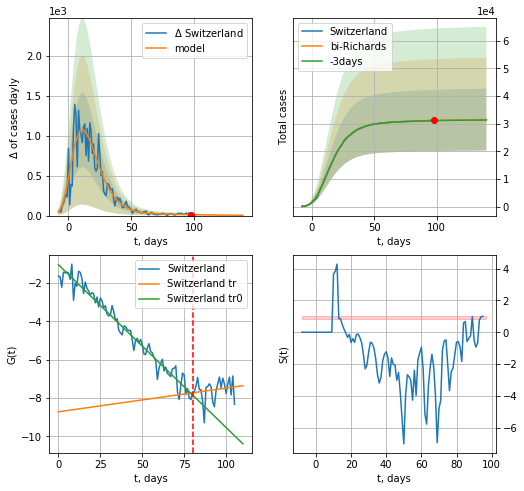

Switzerland data at: 2020-06-20
+3 day model MAPE: 0.001521
model: bi-Richards
coeffs: [ 9.83333305e+02  8.20319500e+00 -5.09136463e+01  4.96998538e-03]
rational stdev: 0.355186
forecast at the end of period: +42 days
	 deltaDaycases: 3
	 total cases: 31484 ± 11182
	 total death: 1971 ± 2100
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.962262
 intercept: -1.038744
 slope: -0.084966
trend coefficient of determination: 0.028281
 intercept: -8.712850
 slope: 0.012377


In [707]:
iL = 10
vL = 80 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*30-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:],d1,7*18-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


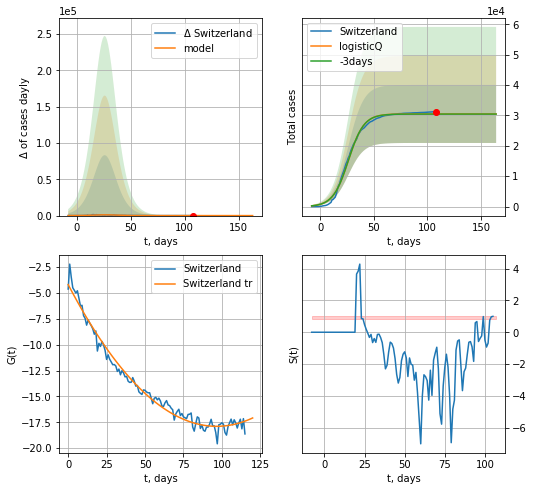

Switzerland data at: 2020-06-20
+3 day model MAPE: 0.001437
model: logisticQ
coeffs: [ 3.04872509e+04  5.56032799e-07  2.63079287e+01 -2.49759057e+05]
rational stdev: 0.313105
forecast at the end of period: +56 days
	 deltaDaycases: 0
	 total cases: 30487 ± 9545
	 total death: 1908 ± 1792
trend coefficient of determination: 0.981094
 intercept_: -4.193663531242498
 coeffs_: [ 0.         -0.28358836  0.0014684 ]


In [708]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=False,xcoef=koreaCoeffs)

In [709]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date    cases  active   death
98  2020-06-16  32476.0   17036   912.0
99  2020-06-17  33234.0   17348   943.0
100 2020-06-18  34063.0   17650   966.0
101 2020-06-19  34984.0   17966   985.0
102 2020-06-20  36560.0   19049  1002.0


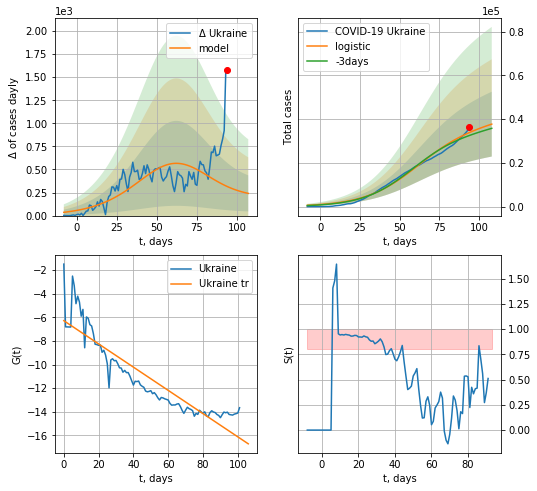

Ukraine data at: 2020-06-20
+3 day model MAPE: 0.04271355594522508
model: logistic
coeffs:  [3.73114657e+04 5.92417188e-02 6.18103060e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3929003302067199
forecast at the end of period: +14 days
	 deltaDaycases:  240
	 total cases:  37688 ± 14807
	 total death:  1032 ± 1216
trend coefficient of determination: 0.829107
 intercept: -6.288345
 slope: -0.098263


In [710]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


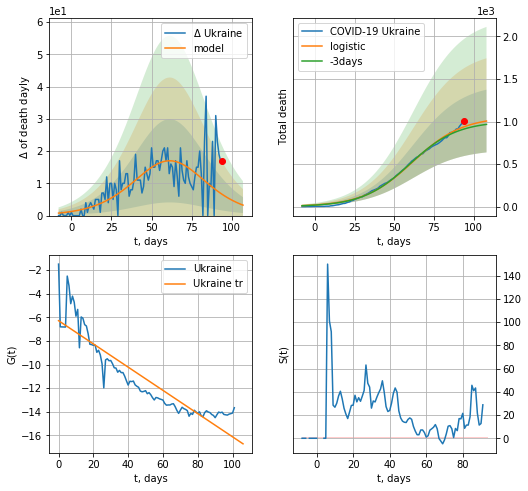

Ukraine data at: 2020-06-20
+3 day model MAPE: 0.03022151032504911
model: logistic
coeffs:  [1.05743881e+03 6.42597858e-02 6.17773773e+01]
rational stdev:  0.3666195166479663
forecast at the end of period: +14 days
	 total death:  1005 ± 368
trend coefficient of determination: 0.829107
 intercept: -6.288345
 slope: -0.098263


In [712]:
x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


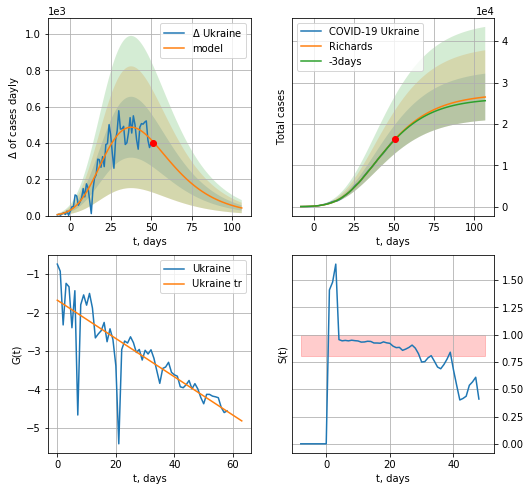

Ukraine data at: 2020-06-20
+3 day model MAPE: 0.005756
model: Richards
coeffs: [ 2.73152280e+04  5.78390520e-01 -1.00505543e+01  8.74755420e-02]
rational stdev: 0.213278
forecast at the end of period: +56 days
	 deltaDaycases: 41
	 total cases: 26492 ± 5650
	 total death: 726 ± 464
trend coefficient of determination: 0.678475
 intercept: -1.678868
 slope: -0.049847


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


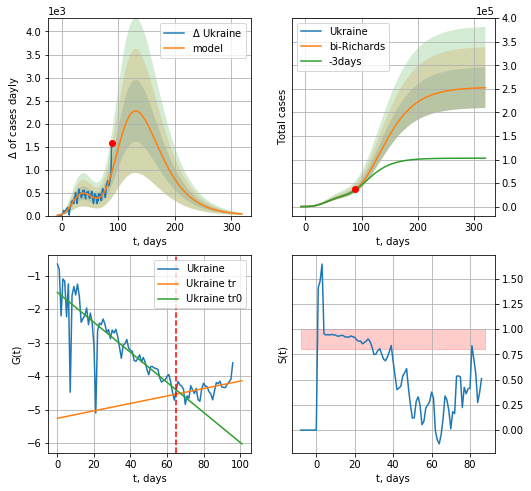

Ukraine data at: 2020-06-20
+3 day model MAPE: 0.015526
model: bi-Richards
coeffs: [2.26252737e+05 6.33851706e-01 1.89188007e+01 4.38218561e-02]
rational stdev: 0.170538
forecast at the end of period: +231 days
	 deltaDaycases: 33
	 total cases: 252366 ± 43038
	 total death: 6916 ± 3538
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.694904
 intercept: -1.498657
 slope: -0.044773
trend coefficient of determination: 0.195552
 intercept: -5.257943
 slope: 0.011090


In [713]:
vL = 65+5
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*20-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RR('Ukraine',dfUR[5:],d1,7*45-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


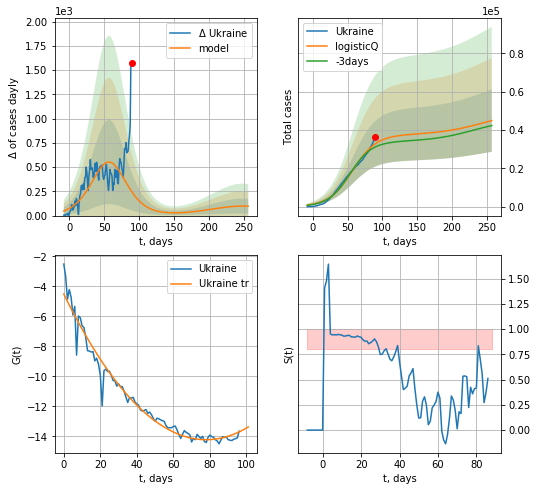

Ukraine data at: 2020-06-20
+3 day model MAPE: 0.054279
model: logisticQ
coeffs: [ 3.74497143e+04  3.45432429e-07  5.69675918e+01 -1.70404354e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.362882
forecast at the end of period: +168 days
	 deltaDaycases: 96
	 total cases: 44931 ± 16304
	 total death: 1231 ± 1340
trend coefficient of determination: 0.964408
 intercept_: -4.511338632924829
 coeffs_: [ 0.         -0.24912842  0.00159834]


In [714]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*36-dT,addpred=True,xcoef=koreaCoeffs)

In [715]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

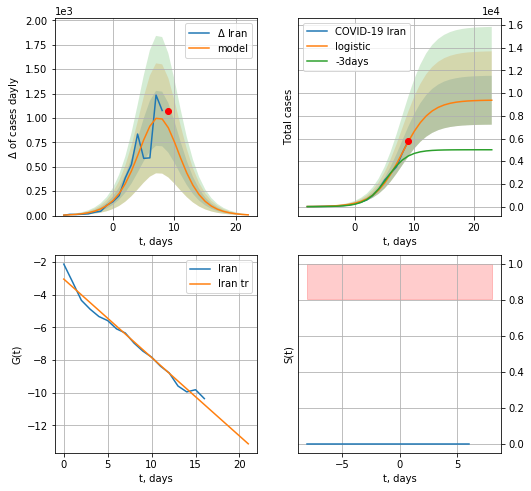

Iran data at: 2020-06-20
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +14 days
	 deltaDaycases:  7
	 total cases:  9371 ± 2152
	 total death:  439 ± 302
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


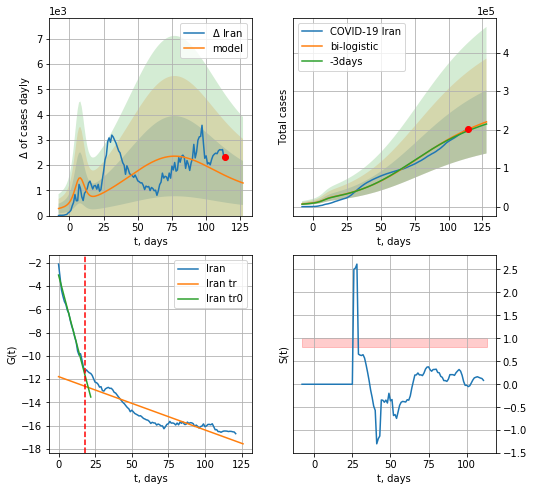

Iran data at: 2020-06-20
+3 day model MAPE: 0.01936565541602206
model: bi-logistic
coeffs:  [2.17958101e+05 4.14475871e-02 7.55272043e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3733776863161082
forecast at the end of period: +14 days
	 deltaDaycases:  1290
	 total cases:  220241 ± 82233
	 total death:  10335 ± 11576
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.808529
 intercept: -11.788591
 slope: -0.045805


In [717]:
x = forecast('Iran',dfIN[:18],d1,7*14-dT)
xx = forecast2('Iran',dfIN[:],d1,14*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


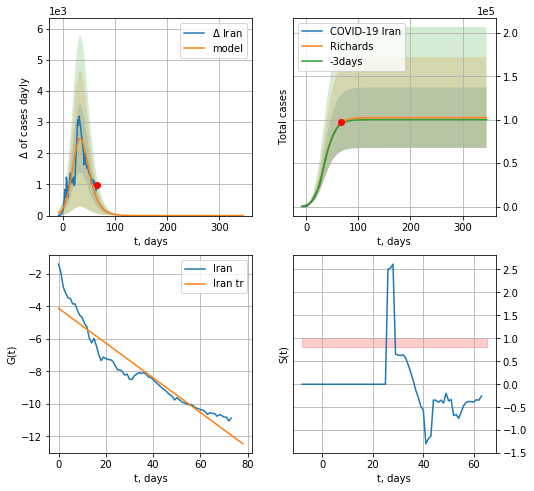

Iran data at: 2020-06-20
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478153e+05 1.52216321e-01 2.65523922e+01 5.45962709e-01]
rational stdev: 0.339941
forecast at the end of period: +280 days
	 deltaDaycases: 0
	 total cases: 102478 ± 34836
	 total death: 4809 ± 4904
trend coefficient of determination: 0.893485
 intercept: -4.118017
 slope: -0.106957


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


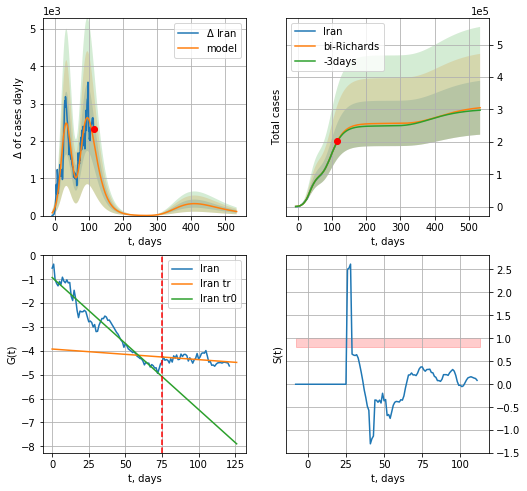

Iran data at: 2020-06-20
+3 day model MAPE: 0.006571
model: bi-Richards
coeffs: [1.54305151e+05 3.40754515e+00 1.94469563e+00 1.34022673e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.272608
forecast at the end of period: +420 days
	 deltaDaycases: 108
	 total cases: 305240 ± 83211
	 total death: 14324 ± 11714
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949245
 intercept: -0.926506
 slope: -0.055322
trend coefficient of determination: 0.135812
 intercept: -3.924007
 slope: -0.004446


In [718]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,52*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,72*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


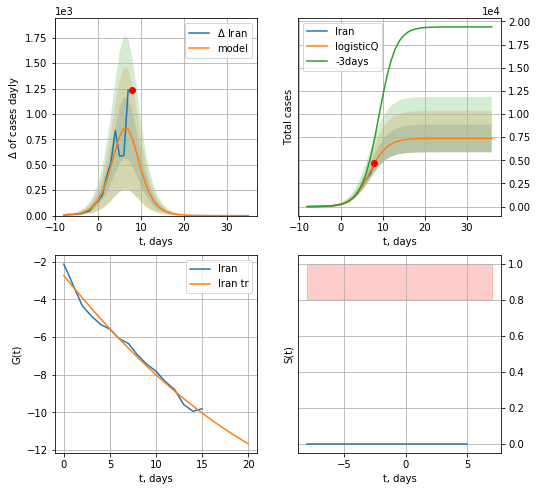

Iran data at: 2020-06-20
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 345 ± 210
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


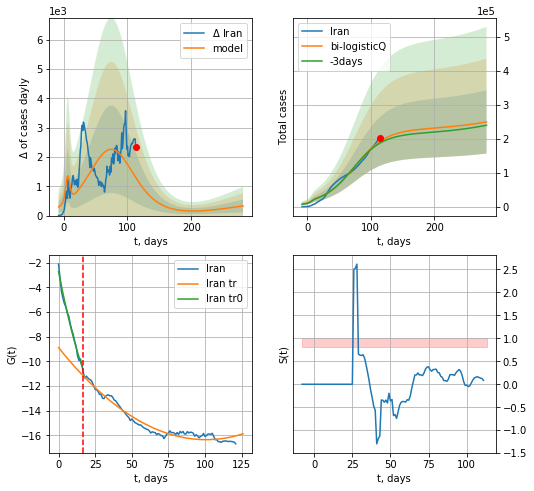

Iran data at: 2020-06-20
+3 day model MAPE: 0.026796
model: bi-logisticQ
coeffs: [ 2.19785402e+05  1.56330556e-07  7.49169337e+01 -2.62118280e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.373869
forecast at the end of period: +168 days
	 deltaDaycases: 327
	 total cases: 249319 ± 93212
	 total death: 11700 ± 13122
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.958984
 intercept_: -8.886727384654687
 coeffs_: [ 0.         -0.14820895  0.00073582]


In [719]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,36*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date     cases  active   death
108 2020-06-16  545458.0  243868  7284.0
109 2020-06-17  553301.0  241481  7478.0
110 2020-06-18  561091.0  239468  7660.0
111 2020-06-19  569063.0  236816  7841.0
112 2020-06-20  584680.0  236858  8111.0


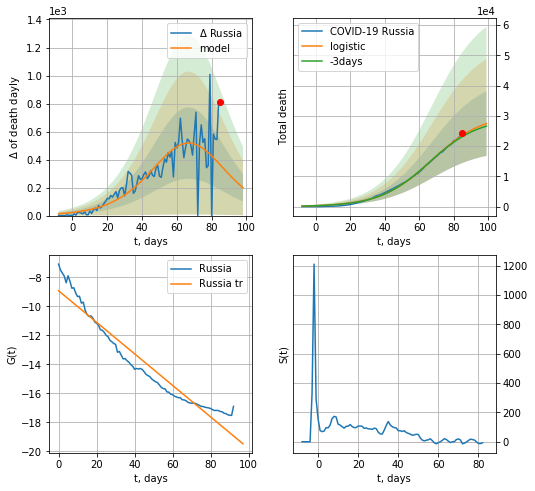

Russia data at: 2020-06-20
+3 day model MAPE: 0.018796606675212935
model: logistic
coeffs:  [3.06372618e+04 6.76171258e-02 6.71968252e+01]
rational stdev:  0.38850525699207616
forecast at the end of period: +14 days
	 total death:  27442 ± 10661
trend coefficient of determination: 0.932601
 intercept: -8.915382
 slope: -0.108954


In [721]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,14*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


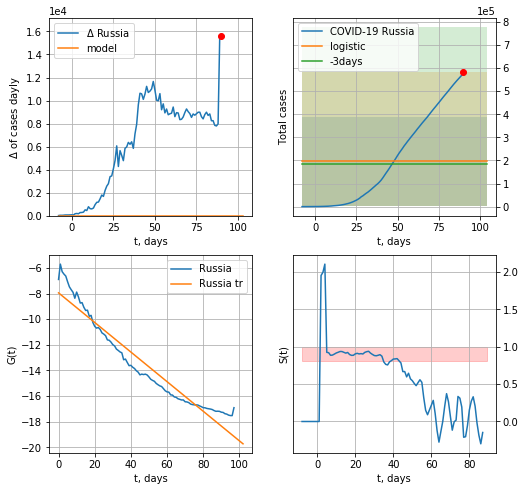

Russia data at: 2020-06-20
+3 day model MAPE: 0.06395742937285119
model: logistic
coeffs:  [ 1.95515687e+05 -5.74575331e+00  1.52658449e+02]
rational stdev:  0.9931964041756621
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  195515 ± 194185
	 total death:  2712 ± 8080
trend coefficient of determination: 0.930741
 intercept: -7.945492
 slope: -0.115420


In [722]:
x = forecast('Russia',dfRS[14:],d1,14*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


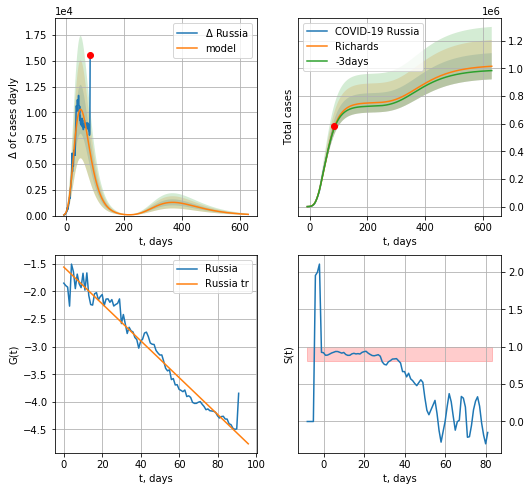

Russia data at: 2020-06-20
+3 day model MAPE: 0.011885
model: Richards
coeffs: [ 7.52160789e+05  2.24945409e+00 -5.84651488e+01  1.66951669e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.093460
forecast at the end of period: +546 days
	 deltaDaycases: 118
	 total cases: 1015419 ± 94900
	 total death: 14086 ± 3949
trend coefficient of determination: 0.961412
 intercept: -1.557273
 slope: -0.033359


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


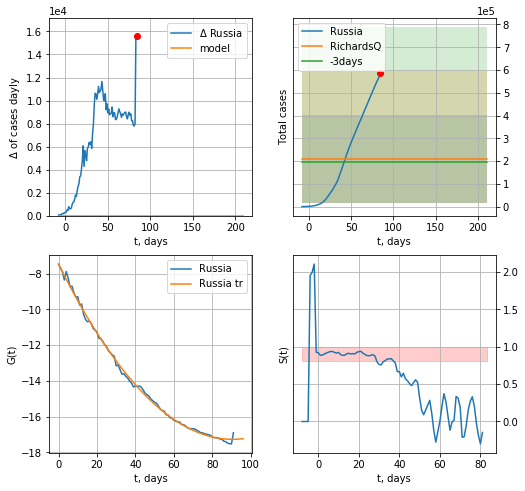

Russia data at: 2020-06-20
+3 day model MAPE: 0.061816
model: RichardsQ
coeffs: [ 2.08122376e+05  1.19960991e+01 -2.05697447e+03  1.74028467e+03
 -4.51663156e+00]
rational stdev: 0.930687
forecast at the end of period: +126 days
	 deltaDaycases: 0
	 total cases: 208122 ± 193696
	 total death: 2887 ± 8060
trend coefficient of determination: 0.997837
 intercept_: -7.4743711332346265
 coeffs_: [ 0.         -0.21630059  0.00119415]


In [723]:
x = forecastRR('Russia',dfRS[20:],d1,90*7-dT,addpred=True,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


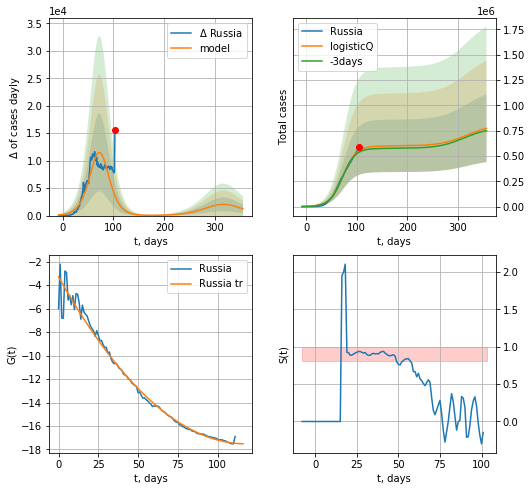

Russia data at: 2020-06-20
+3 day model MAPE: 0.026588
model: logisticQ
coeffs: [ 5.99142158e+05  6.07312380e-07  7.27032815e+01 -1.26291801e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.431732
forecast at the end of period: +252 days
	 deltaDaycases: 1228
	 total cases: 772935 ± 333700
	 total death: 10722 ± 13887
trend coefficient of determination: 0.980289
 intercept_: -3.297077178296588
 coeffs_: [ 0.         -0.24139469  0.00102407]


In [724]:
x = forecastRRR('Russia',dfRS[:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active  death
146 2020-06-16  17587.0     959  927.0
147 2020-06-17  17628.0     847  931.0
148 2020-06-18  17668.0     803  935.0
149 2020-06-19  17740.0     797  935.0
150 2020-06-20  17799.0     770  952.0


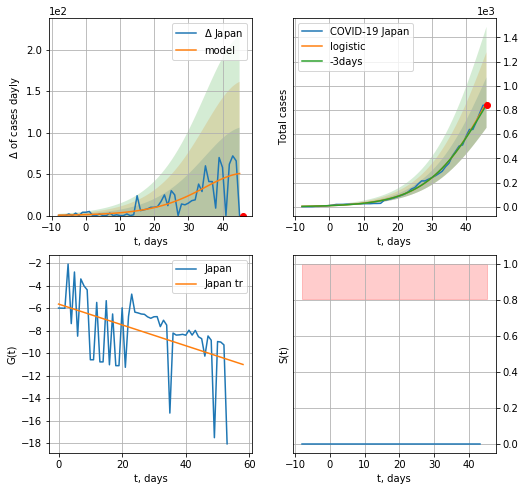

Japan data at: 2020-06-20
Exception occurs


In [725]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*12-dT)
    xx = forecast2('Japan',dfJP[:],d1,12*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

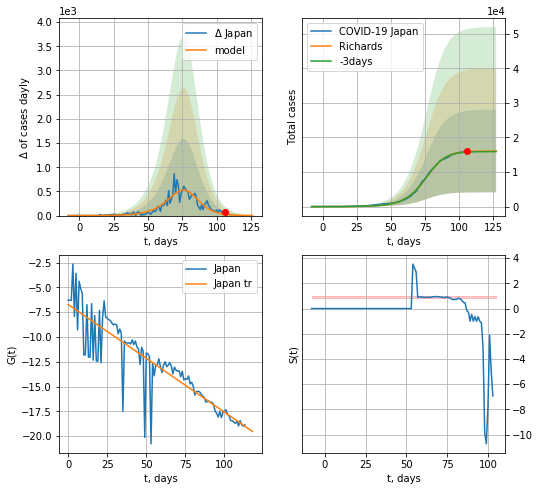

Japan data at: 2020-06-20
+3 day model MAPE: 0.009396
model: Richards
coeffs: [1.61043526e+04 1.05070375e-01 7.85362634e+01 1.40112813e+00]
rational stdev: 0.743333
forecast at the end of period: +21 days
	 deltaDaycases: 1
	 total cases: 16095 ± 11964
	 total death: 860 ± 1917
trend coefficient of determination: 0.778576
 intercept: -6.726919
 slope: -0.108522


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


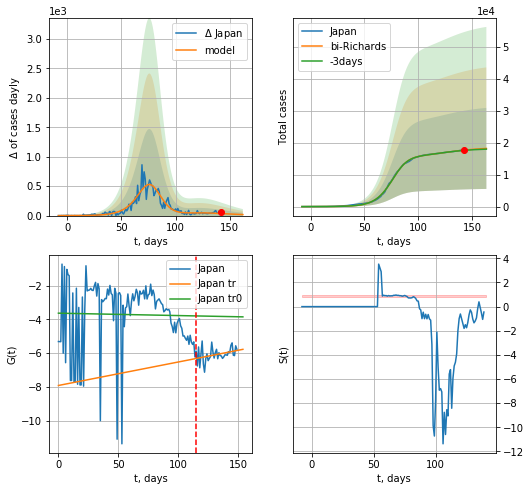

Japan data at: 2020-06-20
+3 day model MAPE: 0.005046
model: bi-Richards
coeffs: [2.51669381e+03 8.84377606e+00 1.80668535e+01 5.47049758e-03]
rational stdev: 0.696141
forecast at the end of period: +21 days
	 deltaDaycases: 17
	 total cases: 18238 ± 12696
	 total death: 975 ± 2036
bi-Richards approximation splitting point: 115
trend coefficient of determination: 0.000536
 intercept: -3.625790
 slope: -0.001418
trend coefficient of determination: 0.120973
 intercept: -7.914311
 slope: 0.013918


In [726]:
vL = 115
x = forecastRR('Japan',dfJP[:vL],d1,15*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[:],d1,15*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


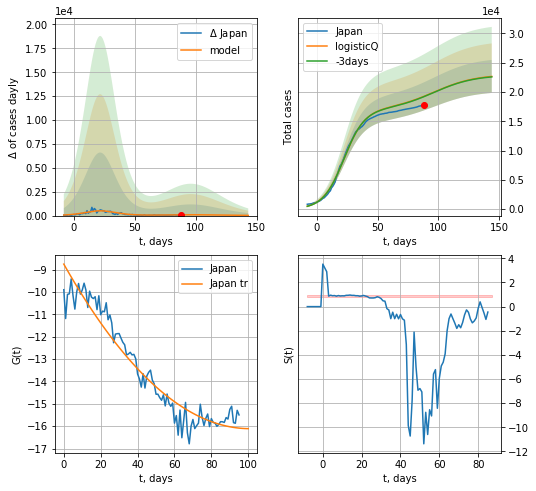

Japan data at: 2020-06-20
+3 day model MAPE: 0.002454
model: logisticQ
coeffs: [ 1.69989799e+04  1.08933929e-06  2.21751165e+01 -1.07035933e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.124357
forecast at the end of period: +56 days
	 deltaDaycases: 19
	 total cases: 22667 ± 2818
	 total death: 1212 ± 452
trend coefficient of determination: 0.927374
 intercept_: -8.746986676960455
 coeffs_: [ 0.         -0.1460489   0.00072415]


In [727]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


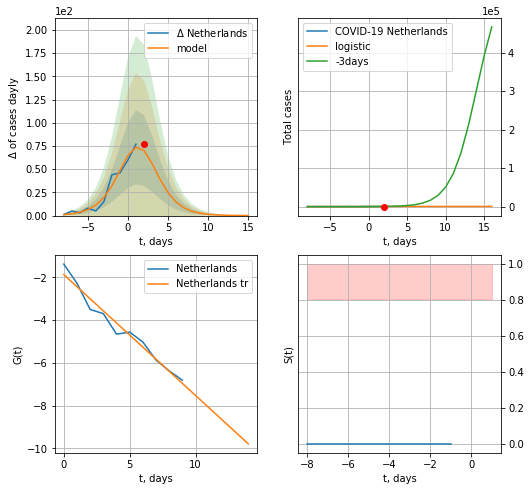

Netherlands data at: 2020-06-20
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  487 ± 115
	 total death:  59 ± 42
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


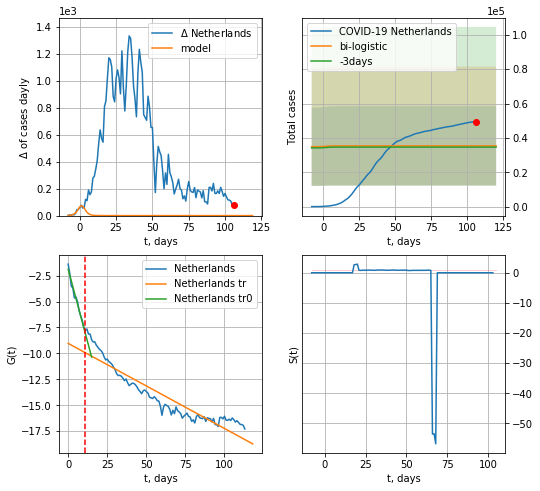

Netherlands data at: 2020-06-20
+3 day model MAPE: 0.02034272521154716
model: bi-logistic
coeffs:  [ 2.78833485e+04 -5.58610562e+00  1.64483868e+02] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.6530619514620547
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  35341 ± 23080
	 total death:  4347 ± 8516
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.869954
 intercept: -9.034408
 slope: -0.082107


In [729]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,14*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
           date  cases  active   death
110 2020-06-16  49087       0  6070.0
111 2020-06-17  49204       0  6074.0
112 2020-06-18  49319       0  6078.0
113 2020-06-19  49426       0  6081.0
114 2020-06-20  49502       0  6089.0


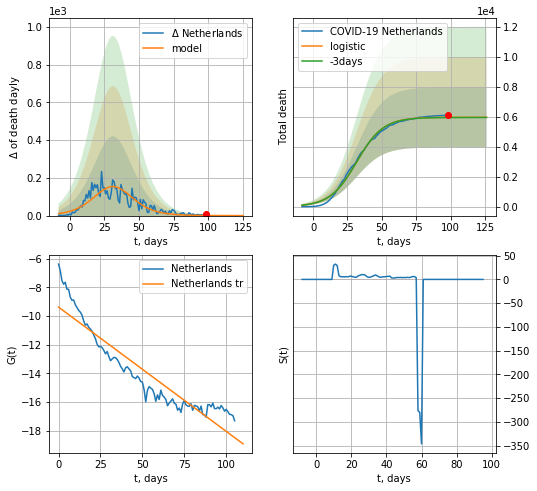

Netherlands data at: 2020-06-20
+3 day model MAPE: 0.0023662702360167354
model: logistic
coeffs:  [5.95483222e+03 1.03589490e-01 3.16612601e+01]
rational stdev:  0.3369917219359158
forecast at the end of period: +28 days
	 total death:  5954 ± 2006
trend coefficient of determination: 0.866871
 intercept: -9.375014
 slope: -0.086584


In [730]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


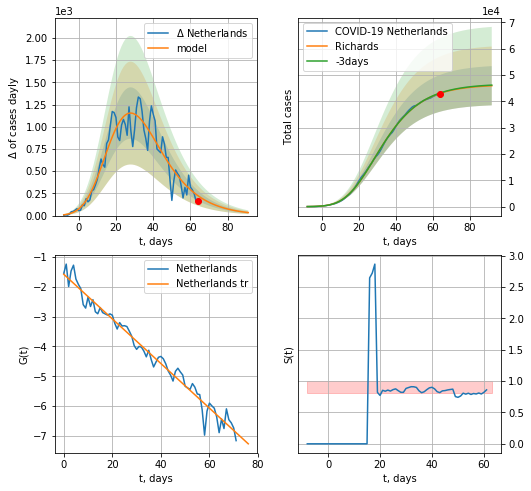

Netherlands data at: 2020-06-20
+3 day model MAPE: 0.002842
model: Richards
coeffs: [4.63365786e+04 4.92236139e-01 2.02382698e+00 1.47660483e-01]
rational stdev: 0.162270
forecast at the end of period: +28 days
	 deltaDaycases: 33
	 total cases: 45885 ± 7445
	 total death: 5644 ± 2747
trend coefficient of determination: 0.973735
 intercept: -1.579499
 slope: -0.074799


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


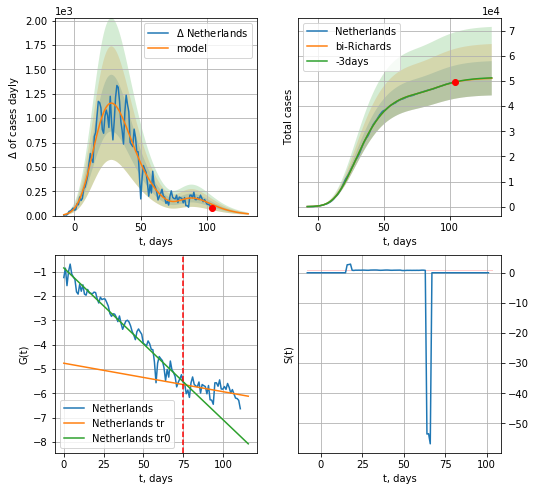

Netherlands data at: 2020-06-20
+3 day model MAPE: 0.001007
model: bi-Richards
coeffs: [4.96821254e+03 5.65878422e+00 3.80841836e+01 1.40413780e-02]
rational stdev: 0.133508
forecast at the end of period: +28 days
	 deltaDaycases: 17
	 total cases: 51080 ± 6819
	 total death: 6283 ± 2516
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.961285
 intercept: -0.841889
 slope: -0.062347
trend coefficient of determination: 0.177269
 intercept: -4.759475
 slope: -0.011697


In [731]:
vL = 75
x = forecastRR('Netherlands',dfNL[2:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[2:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


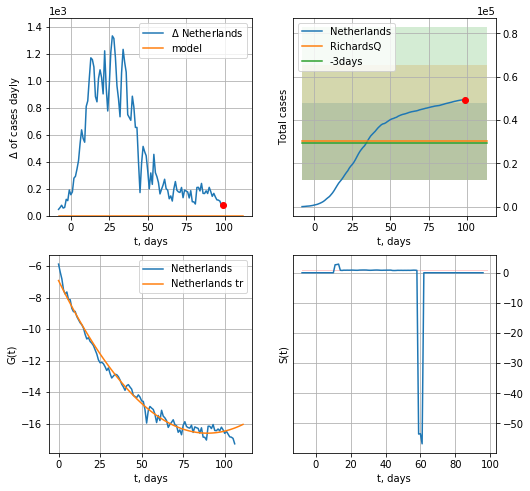

Netherlands data at: 2020-06-20
+3 day model MAPE: 0.018576
model: RichardsQ
coeffs: [ 3.01628519e+04  7.24605022e-01 -1.28113774e+03  1.07295771e+03
 -1.62811230e+00]
rational stdev: 0.583933
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 30162 ± 17613
	 total death: 3710 ± 6499
trend coefficient of determination: 0.987561
 intercept_: -6.918985441097015
 coeffs_: [ 0.         -0.21656789  0.00120956]


In [733]:
x = forecastQR('Netherlands',dfNL[7:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


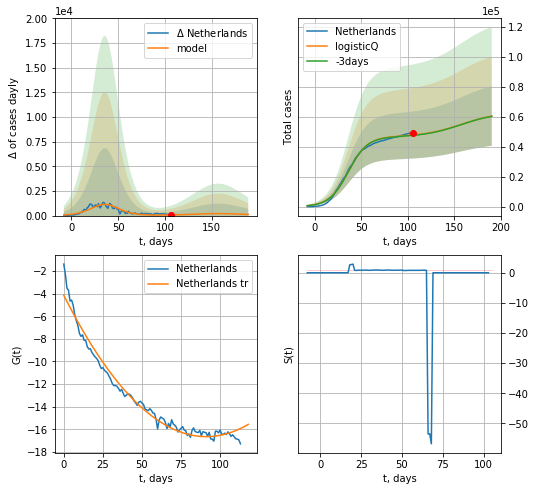

Netherlands data at: 2020-06-20
+3 day model MAPE: 0.005702
model: logisticQ
coeffs: [ 4.67600125e+04  3.45220299e-07  3.61135403e+01 -2.82947983e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.328367
forecast at the end of period: +84 days
	 deltaDaycases: 115
	 total cases: 60543 ± 19880
	 total death: 7447 ± 7336
trend coefficient of determination: 0.976026
 intercept_: -4.149425086523081
 coeffs_: [ 0.         -0.27430618  0.00150448]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


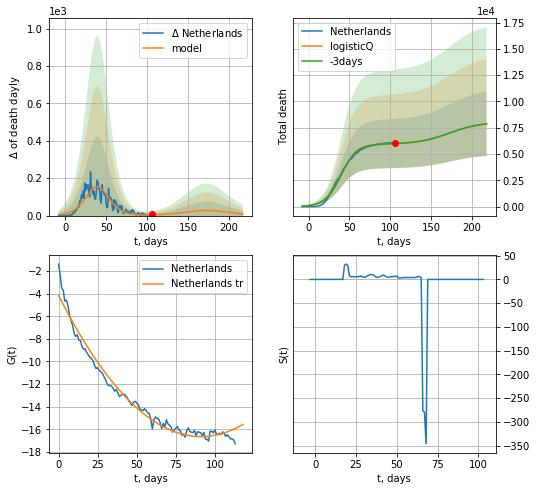

Netherlands data at: 2020-06-20
+3 day model MAPE: 0.002397
model: logisticQ
coeffs: [ 5.95327434e+03  4.55128923e-07  3.96577846e+01 -2.28051990e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.389609
forecast at the end of period: +112 days
	 total death: 7879 ± 3069
trend coefficient of determination: 0.976026
 intercept_: -4.149425086523081
 coeffs_: [ 0.         -0.27430618  0.00150448]


In [734]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [735]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


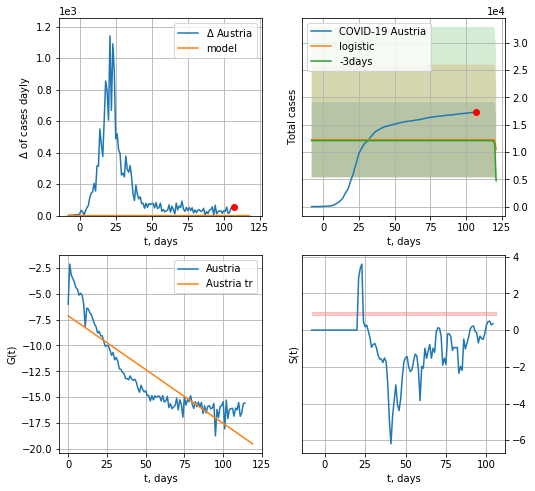

Austria data at: 2020-06-20
+3 day model MAPE: 0.013442999097906805
model: logistic
coeffs:  [ 1.15176811e+04 -3.48317782e+00  1.21483182e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.5618503484496076
forecast at the end of period: +14 days
	 deltaDaycases:  -1739
	 total cases:  10432 ± 5861
	 total death:  414 ± 697
trend coefficient of determination: 0.779581
 intercept: -7.126948
 slope: -0.104198


In [737]:
x = forecast('Austria',dfAT[:],d1,7*14-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

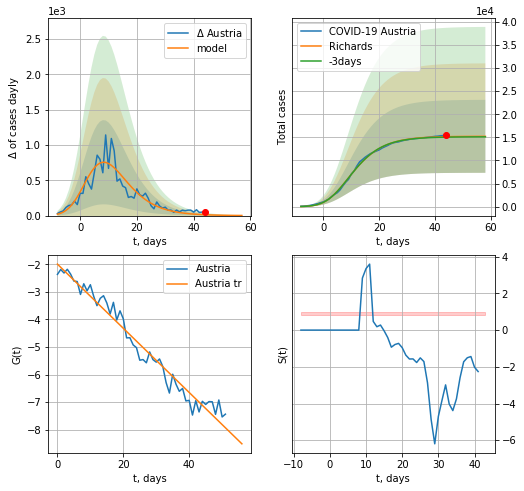

Austria data at: 2020-06-20
+3 day model MAPE: 0.006824
model: Richards
coeffs: [ 1.52413256e+04  8.30508829e-01 -3.03588001e+00  1.76502169e-01]
rational stdev: 0.518621
forecast at the end of period: +14 days
	 deltaDaycases: 1
	 total cases: 15230 ± 7898
	 total death: 604 ± 939
trend coefficient of determination: 0.965129
 intercept: -1.995756
 slope: -0.116348


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


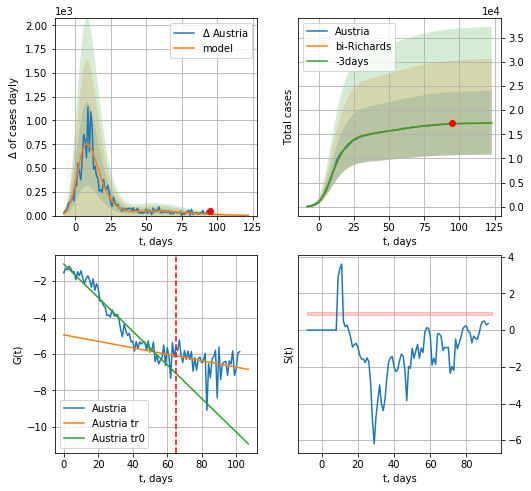

Austria data at: 2020-06-20
+3 day model MAPE: 0.002478
model: bi-Richards
coeffs: [ 2.21165983e+03  8.60840726e+00 -3.07694673e+01  6.58435167e-03]
rational stdev: 0.380532
forecast at the end of period: +28 days
	 deltaDaycases: 3
	 total cases: 17398 ± 6620
	 total death: 691 ± 788
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.933077
 intercept: -1.066431
 slope: -0.092187
trend coefficient of determination: 0.069370
 intercept: -4.951050
 slope: -0.017711


In [739]:
vL=65+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


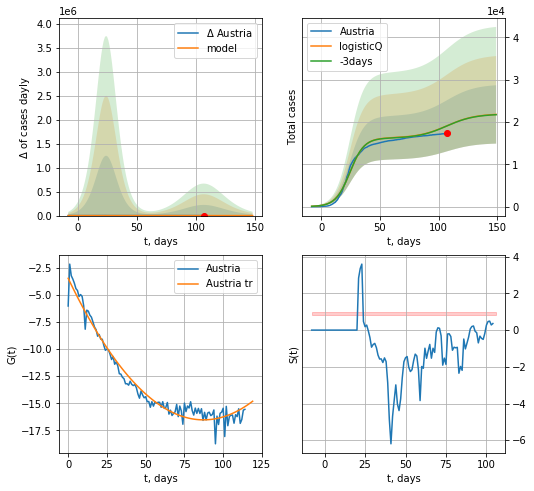

Austria data at: 2020-06-20
+3 day model MAPE: 0.001446
model: logisticQ
coeffs: [ 1.62116363e+04  4.38428540e-07  2.45656496e+01 -3.75354349e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.316355
forecast at the end of period: +42 days
	 deltaDaycases: 14
	 total cases: 21780 ± 6890
	 total death: 865 ± 820
trend coefficient of determination: 0.966365
 intercept_: -3.4392959306332767
 coeffs_: [ 0.         -0.30000719  0.00171765]


In [740]:
vL = 68
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


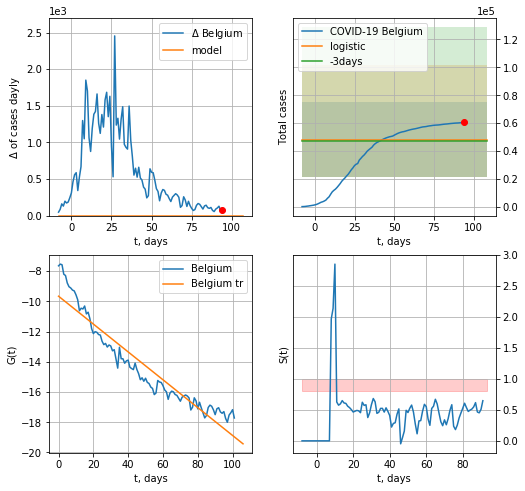

Belgium data at: 2020-06-20
+3 day model MAPE: 0.01745397222316775
model: logistic
coeffs:  [ 3.84637282e+04 -7.80297556e+00  2.54816288e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.5606487116092924
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  48079 ± 26955
	 total death:  7699 ± 12949
trend coefficient of determination: 0.905111
 intercept: -9.659467
 slope: -0.092146


In [742]:
vL=9
x = forecast('Belgium',dfBG[vL:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
           date  cases  active   death
107 2020-06-16  60155   33867  9663.0
108 2020-06-17  60244   33885  9675.0
109 2020-06-18  60348   33941  9683.0
110 2020-06-19  60476   34030  9695.0
111 2020-06-20  60550   34083  9696.0


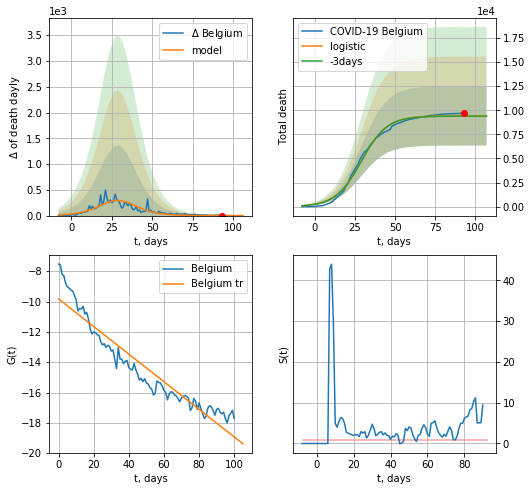

Belgium data at: 2020-06-20
+3 day model MAPE: 0.00288695203930291
model: logistic
coeffs:  [9.41868868e+03 1.24410561e-01 2.89780503e+01]
rational stdev:  0.3267950099869438
forecast at the end of period: +14 days
	 total death:  9418 ± 3077
trend coefficient of determination: 0.905047
 intercept: -9.831250
 slope: -0.090952


In [743]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,14*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


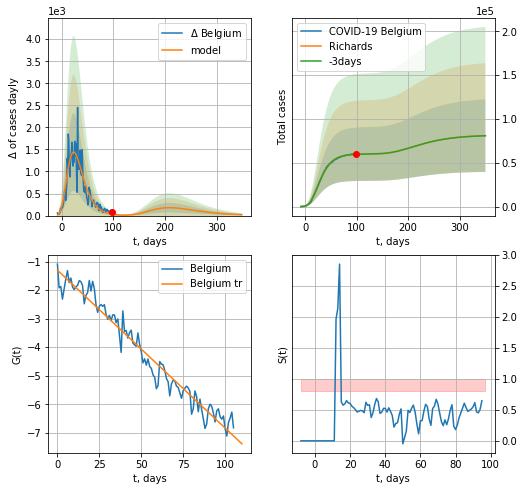

Belgium data at: 2020-06-20
+3 day model MAPE: 0.001869
model: Richards
coeffs: [ 6.00974381e+04  6.16103581e+00 -4.54238128e+01  1.06328037e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.510442
forecast at the end of period: +252 days
	 deltaDaycases: 20
	 total cases: 80962 ± 41326
	 total death: 12964 ± 19852
trend coefficient of determination: 0.959073
 intercept: -1.301727
 slope: -0.055303


In [744]:
x = forecastRR('Belgium',dfBG[5:],d1,48*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


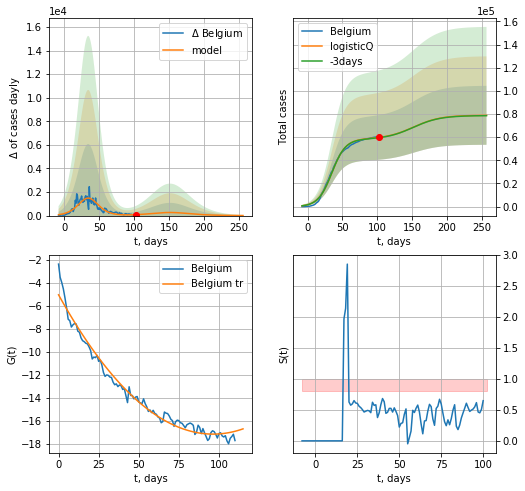

Belgium data at: 2020-06-20
+3 day model MAPE: 0.003742
model: logisticQ
coeffs: [ 5.83175083e+04  3.76712384e-07  3.48654531e+01 -2.69853234e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.322836
forecast at the end of period: +154 days
	 deltaDaycases: 4
	 total cases: 78876 ± 25464
	 total death: 12630 ± 12232
trend coefficient of determination: 0.977320
 intercept_: -5.037128779731841
 coeffs_: [ 0.         -0.25169693  0.0013067 ]


In [745]:
x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [746]:
dfBZ.tail()

,date,cases,active,death
112,2020-06-16,928834.0,406014,45456.0
113,2020-06-17,960309.0,410137,46665.0
114,2020-06-18,983359.0,415130,47869.0
115,2020-06-19,1038568.0,469118,49090.0
116,2020-06-20,1070139.0,476895,50058.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:80: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


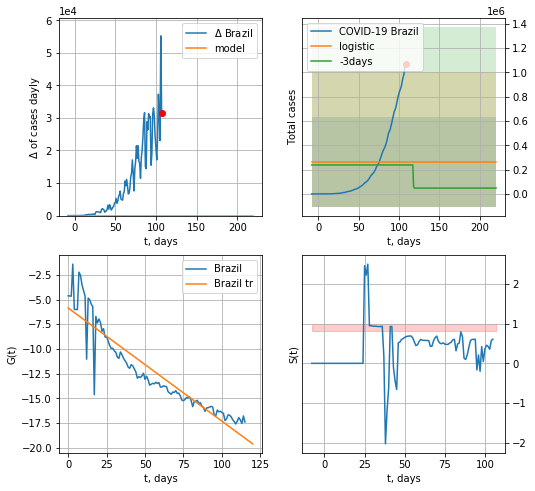

Brazil data at: 2020-06-20
+3 day model MAPE: 0.11305328767153106
model: logistic
coeffs:  [ 2.12090002e+05 -5.49591841e+00  8.83689447e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.3950327523473143
forecast at the end of period: +112 days
	 deltaDaycases:  0
	 total cases:  265112 ± 369840
	 total death:  12401 ± 51899
trend coefficient of determination: 0.864766
 intercept: -5.861941
 slope: -0.114586


In [747]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


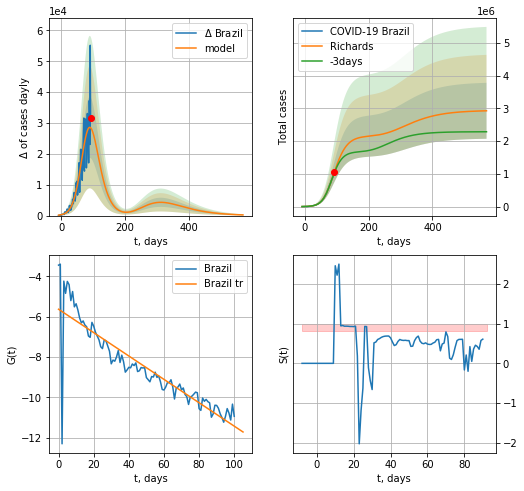

Brazil data at: 2020-06-20
+3 day model MAPE: 0.023212
model: Richards
coeffs: [2.15760247e+06 8.48557407e-02 7.62020566e+01 5.34206410e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.291903
forecast at the end of period: +476 days
	 deltaDaycases: 222
	 total cases: 2925149 ± 853859
	 total death: 136830 ± 119823
trend coefficient of determination: 0.785016
 intercept: -5.630323
 slope: -0.057960


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


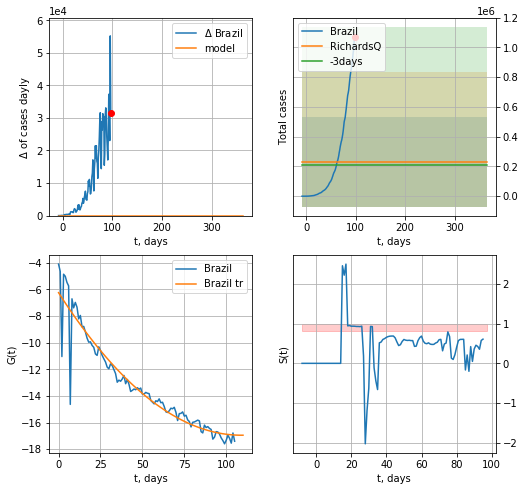

Brazil data at: 2020-06-20
+3 day model MAPE: 0.110316
model: RichardsQ
coeffs: [ 2.31911281e+05  1.30264448e+01 -1.88261153e+03  1.61108921e+03
 -4.42279032e+00]
rational stdev: 1.301659
forecast at the end of period: +266 days
	 deltaDaycases: 0
	 total cases: 231911 ± 301869
	 total death: 10848 ± 42361
trend coefficient of determination: 0.909697
 intercept_: -6.242703357268418
 coeffs_: [ 0.         -0.19652292  0.00090133]


In [749]:
x = forecastRR('Brazil',dfBZ[15:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


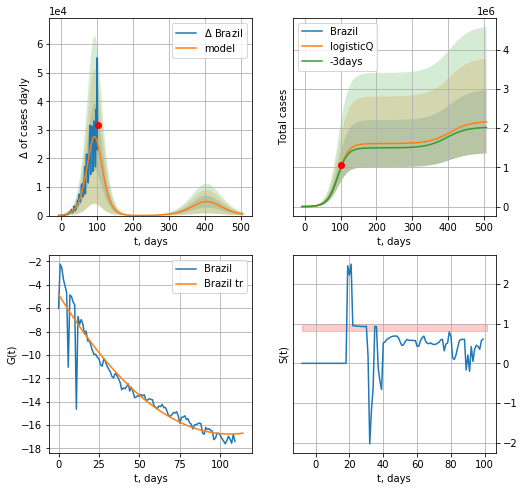

Brazil data at: 2020-06-20
+3 day model MAPE: 0.021320
model: logisticQ
coeffs: [ 1.60555599e+06  3.35847382e-06  9.30282664e+01 -2.04166850e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.373374
forecast at the end of period: +406 days
	 deltaDaycases: 546
	 total cases: 2158188 ± 805812
	 total death: 100953 ± 113079
trend coefficient of determination: 0.915491
 intercept_: -4.808768584294048
 coeffs_: [ 0.         -0.22624317  0.00107026]


In [750]:
x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [751]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date   cases  active  death
122 2020-06-16  7370.0     409  102.0
123 2020-06-17  7390.0     420  102.0
124 2020-06-18  7409.0     429  102.0
125 2020-06-19  7436.0     453  102.0
126 2020-06-20  7461.0     463  102.0


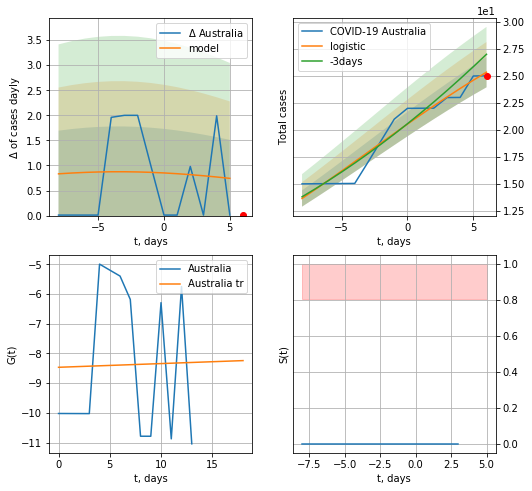

Australia data at: 2020-06-20
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +0 days
	 deltaDaycases:  0
	 total cases:  25 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


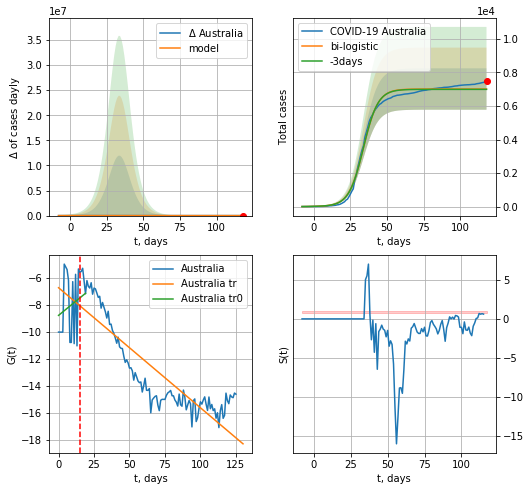

Australia data at: 2020-06-20
Exception occurs


In [752]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,12*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,12*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


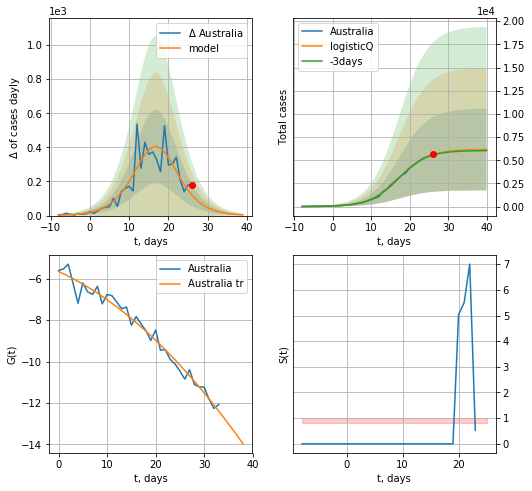

Australia data at: 2020-06-20
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16825959e+03  4.63202537e-05  1.72354346e+01 -5.67168730e+03]
rational stdev: 0.716728
forecast at the end of period: +14 days
	 deltaDaycases: 4
	 total cases: 6153 ± 4410
	 total death: 84 ± 180
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


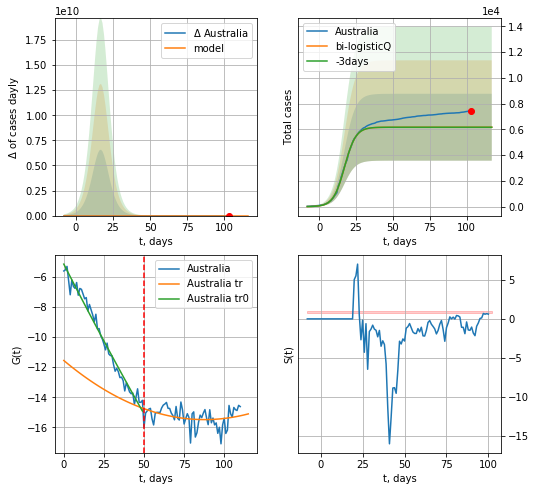

Australia data at: 2020-06-20
+3 day model MAPE: 0.000000
model: bi-logisticQ
coeffs: [-2.14622570e+00 -6.22036139e-02  2.46818813e+01  8.09607331e-03]
rational stdev: 0.420868
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 6168 ± 2596
	 total death: 84 ± 106
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.098264
 intercept_: -11.553900670290243
 coeffs_: [ 0.         -0.08949885  0.00051001]


In [754]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,14*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,14*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

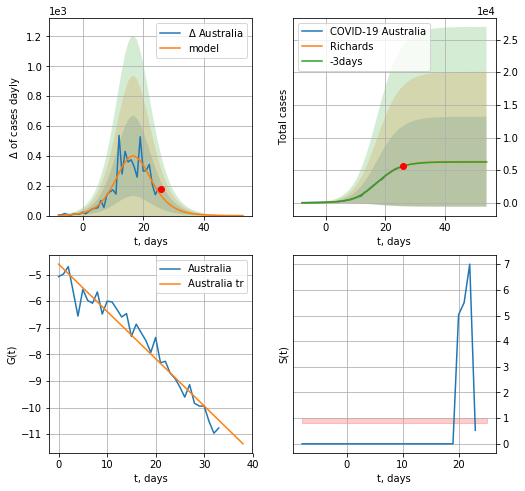

Australia data at: 2020-06-20
+3 day model MAPE: 0.004139
model: Richards
coeffs: [6.29844024e+03 2.85463605e-01 1.64695760e+01 8.48736456e-01]
rational stdev: 1.092498
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 6297 ± 6880
	 total death: 86 ± 281
trend coefficient of determination: 0.945167
 intercept: -4.606318
 slope: -0.177832


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


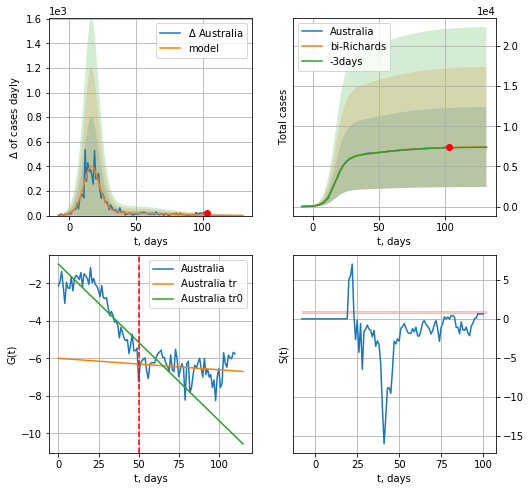

Australia data at: 2020-06-20
+3 day model MAPE: 0.003587
model: bi-Richards
coeffs: [ 1.16244171e+03  6.61219676e+00 -6.35243716e+01  6.69422872e-03]
rational stdev: 0.670301
forecast at the end of period: +28 days
	 deltaDaycases: 1
	 total cases: 7429 ± 4980
	 total death: 101 ± 203
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.754781
 intercept: -0.971403
 slope: -0.083417
trend coefficient of determination: 0.029320
 intercept: -5.999481
 slope: -0.006115


In [755]:
x = forecastRR('Australia',dfAS[15:50],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[15:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=50)

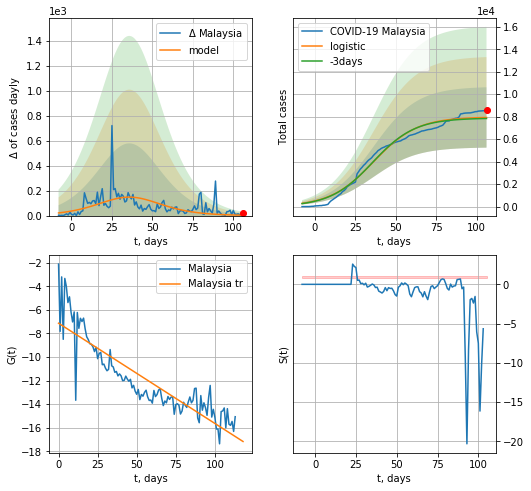

Malaysia data at: 2020-06-20


IndexError: index 115 is out of bounds for axis 0 with size 115

In [756]:
x = forecast('Malaysia',dfML[:],d1,12*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

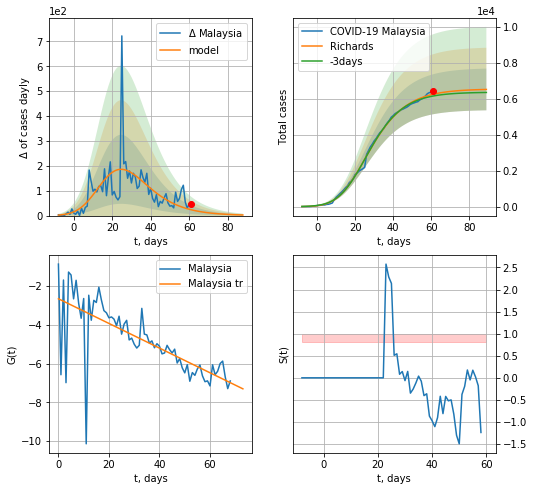

Malaysia data at: 2020-06-20
+3 day model MAPE: 0.016662
model: Richards
coeffs: [6.55738118e+03 3.88579492e-01 7.38231986e+00 2.20014246e-01]
rational stdev: 0.177891
forecast at the end of period: +28 days
	 deltaDaycases: 2
	 total cases: 6529 ± 1161
	 total death: 92 ± 49
trend coefficient of determination: 0.508698
 intercept: -2.652901
 slope: -0.063638


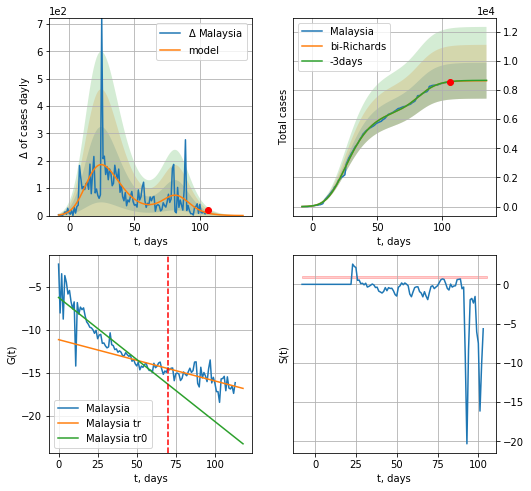

Malaysia data at: 2020-06-20
+3 day model MAPE: 0.001623
model: bi-Richards
coeffs: [2.07997995e+03 1.25030365e-01 8.28492593e+01 1.12179750e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.142428
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 8635 ± 1229
	 total death: 122 ± 52
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.817772
 intercept: -6.212337
 slope: -0.144859
trend coefficient of determination: 0.333473
 intercept: -11.136773
 slope: -0.048253


In [757]:
vL = 70
x = forecastRR('Malaysia',dfML[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:],d1,16*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


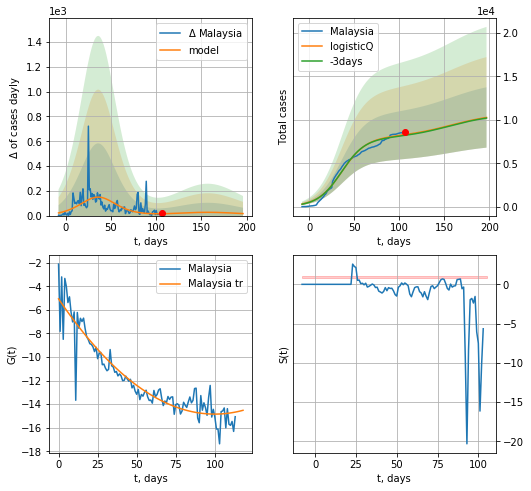

Malaysia data at: 2020-06-20
+3 day model MAPE: 0.010361
model: logisticQ
coeffs: [ 7.97533853e+03  1.62495086e-07  3.61832923e+01 -4.57098686e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.338537
forecast at the end of period: +91 days
	 deltaDaycases: 16
	 total cases: 10271 ± 3477
	 total death: 145 ± 147
trend coefficient of determination: 0.871149
 intercept_: -5.068496235053588
 coeffs_: [ 0.         -0.19570147  0.00097954]


In [758]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
109 2020-06-16  1506.5       2   22.0
110 2020-06-17  1507.0       3   22.0
111 2020-06-18  1507.5       3   22.0
112 2020-06-19  1509.0       5   22.0
113 2020-06-20  1511.0       7   22.0


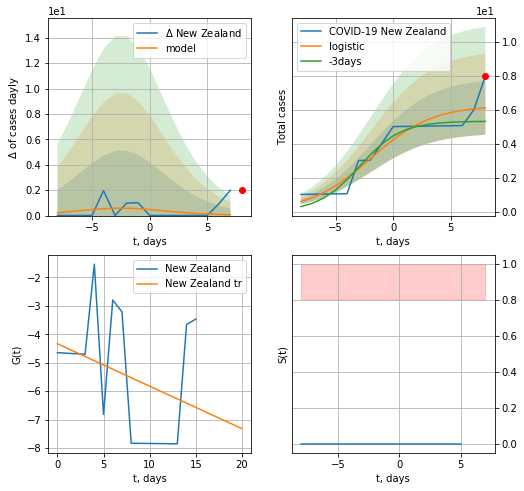

New Zealand data at: 2020-06-20
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +0 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


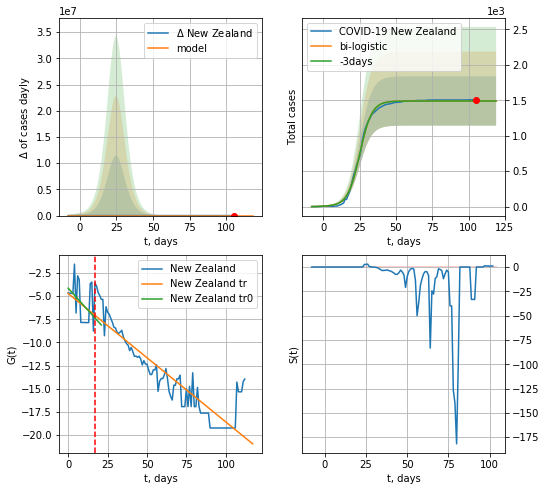

New Zealand data at: 2020-06-20
+3 day model MAPE: 0.0006021380101802464
model: bi-logistic
coeffs:  [1.48456941e+03 2.41231826e-01 2.51325148e+01] [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.23350305995535334
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  1490 ± 348
	 total death:  21 ± 14
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.816233
 intercept: -4.703445
 slope: -0.138835


In [759]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,12*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,14*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

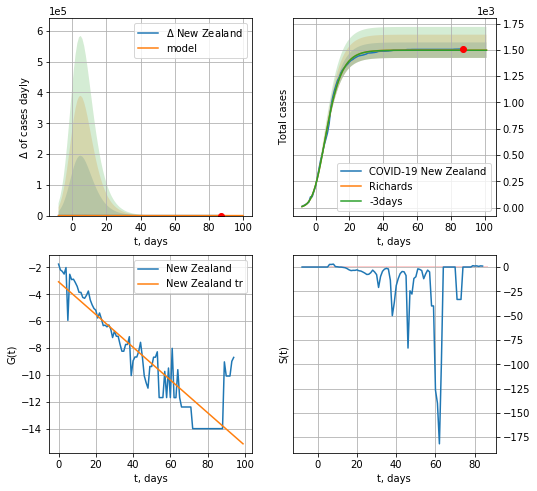

New Zealand data at: 2020-06-20
+3 day model MAPE: 0.000444
model: Richards
coeffs: [ 1.49743398e+03  6.42192016e-01 -1.71802066e+00  2.81794100e-01]
rational stdev: 0.049259
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 1497 ± 73
	 total death: 21 ± 3
trend coefficient of determination: 0.812747
 intercept: -3.073762
 slope: -0.121565


In [760]:
x = forecastRR('New Zealand',dfZL[18:],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


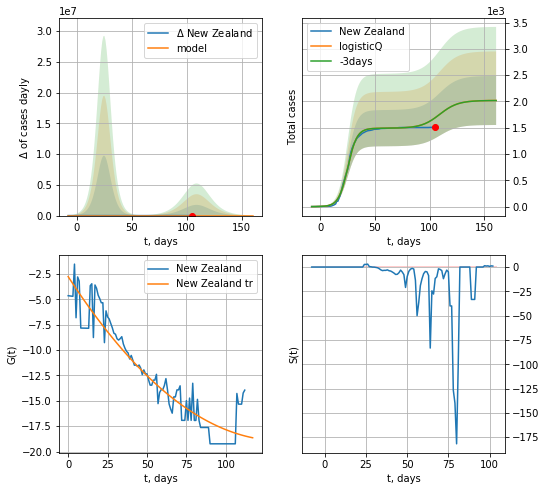

New Zealand data at: 2020-06-20
+3 day model MAPE: 0.000331
model: logisticQ
coeffs: [ 1.49108998e+03  2.18750997e-06  2.50856703e+01 -1.09191282e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.231016
forecast at the end of period: +56 days
	 deltaDaycases: 0
	 total cases: 2018 ± 466
	 total death: 29 ± 20
trend coefficient of determination: 0.887621
 intercept_: -2.763600275009921
 coeffs_: [ 0.         -0.23967537  0.00088869]


In [761]:
x = forecastRRR('New Zealand',dfZL[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
           date    cases  active  death
109 2020-06-16  55369.0   23778  318.0
110 2020-06-17  56032.0   22973  324.0
111 2020-06-18  56657.0   22303  331.0
112 2020-06-19  57333.0   21721  337.0
113 2020-06-20  57936.0   20844  343.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


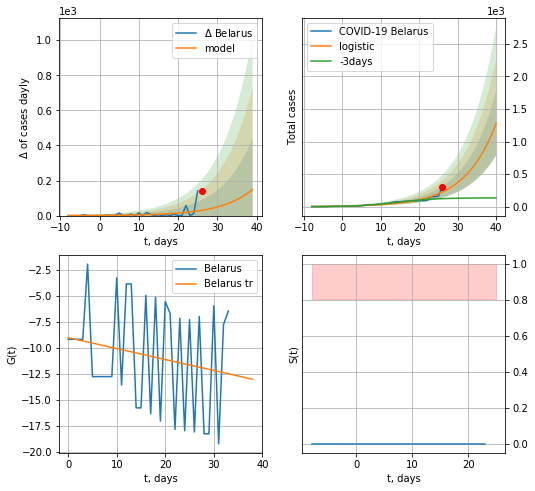

Belarus data at: 2020-06-20
+3 day model MAPE: 1.0426298586333318
model: logistic
coeffs:  [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.38452901172178605
forecast at the end of period: +14 days
	 deltaDaycases:  149
	 total cases:  1282 ± 493
	 total death:  7 ± 8
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


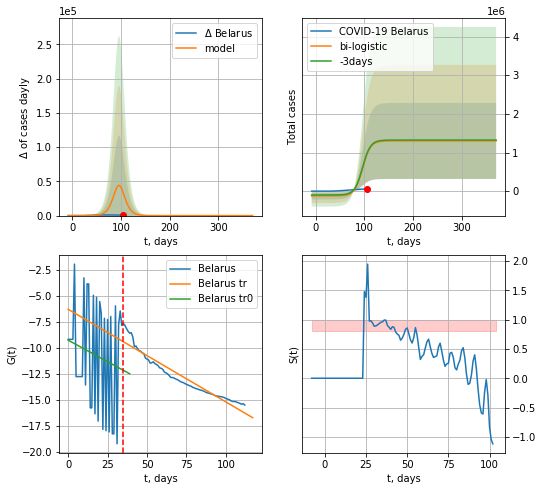

Belarus data at: 2020-06-20
+3 day model MAPE: 0.02296411609932732
model: bi-logistic
coeffs:  [-1.22346084e+05  4.86955256e+01 -1.13177768e+03] [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.7567515212860069
forecast at the end of period: +266 days
	 deltaDaycases:  0
	 total cases:  1299633 ± 983499
	 total death:  7694 ± 17467
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.919584
 intercept: -6.319254
 slope: -0.089088


In [763]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*14-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date    cases  active  death
109 2020-06-16  55369.0   23778  318.0
110 2020-06-17  56032.0   22973  324.0
111 2020-06-18  56657.0   22303  331.0
112 2020-06-19  57333.0   21721  337.0
113 2020-06-20  57936.0   20844  343.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


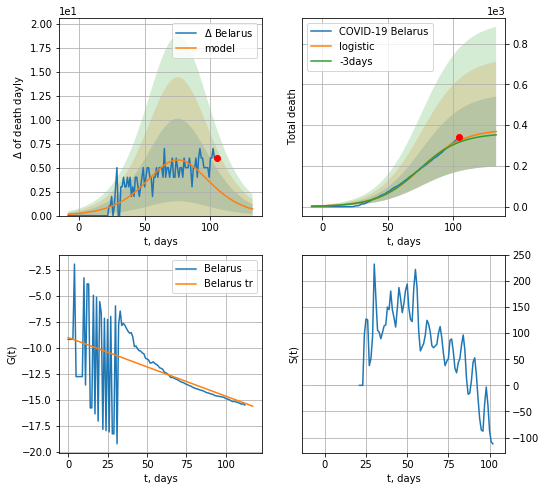

Belarus data at: 2020-06-20
+3 day model MAPE: 0.027802209652313625
model: logistic
coeffs:  [3.79519686e+02 6.12008483e-02 7.57358991e+01]
rational stdev:  0.4647390359170473
forecast at the end of period: +28 days
	 total death:  368 ± 171
trend coefficient of determination: 0.274846
 intercept: -9.036597
 slope: -0.056398


In [764]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


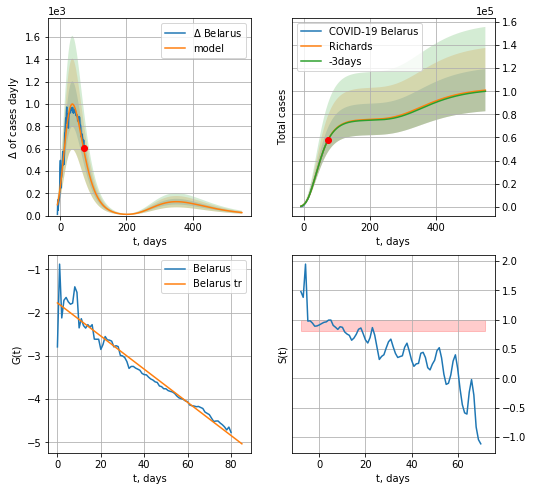

Belarus data at: 2020-06-20
+3 day model MAPE: 0.003553
model: Richards
coeffs: [ 7.57570750e+04  1.92785890e+00 -7.22541444e+01  1.87822882e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.180792
forecast at the end of period: +476 days
	 deltaDaycases: 27
	 total cases: 100940 ± 18249
	 total death: 597 ± 323
trend coefficient of determination: 0.944738
 intercept: -1.772993
 slope: -0.038360


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


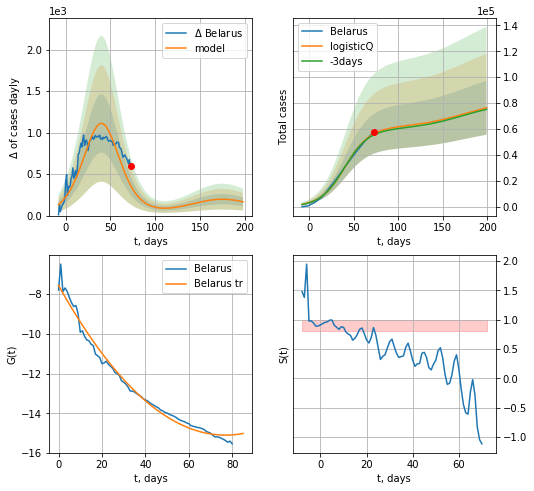

Belarus data at: 2020-06-20
+3 day model MAPE: 0.015934
model: logisticQ
coeffs: [ 6.12027071e+04  7.08806562e-07  4.02681896e+01 -1.02009165e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.272137
forecast at the end of period: +126 days
	 deltaDaycases: 166
	 total cases: 76408 ± 20793
	 total death: 452 ± 369
trend coefficient of determination: 0.985558
 intercept_: -7.5586427057538055
 coeffs_: [ 0.         -0.19609976  0.00127574]


In [765]:
x = forecastRR('Belarus',dfBR[32:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Belarus',dfBR[32:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


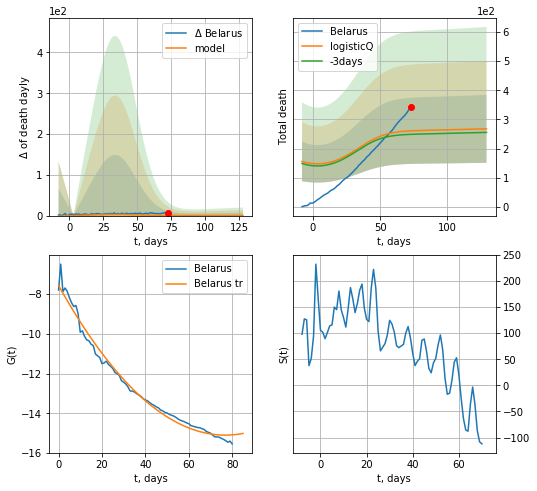

Belarus data at: 2020-06-20
+3 day model MAPE: 0.048435
model: logisticQ
coeffs: [ 2.20700102e+02  1.12446856e-03  7.98050064e+00 -1.09018783e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.435132
forecast at the end of period: +56 days
	 total death: 267 ± 116
trend coefficient of determination: 0.985558
 intercept_: -7.5586427057538055
 coeffs_: [ 0.         -0.19609976  0.00127574]


In [766]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

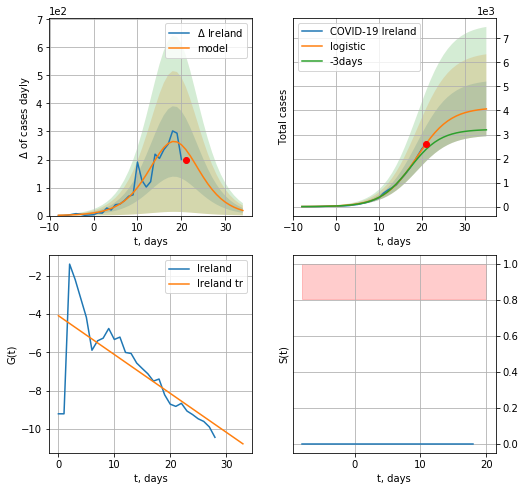

Ireland data at: 2020-06-20
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +14 days
	 deltaDaycases:  18
	 total cases:  4063 ± 1137
	 total death:  274 ± 229
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


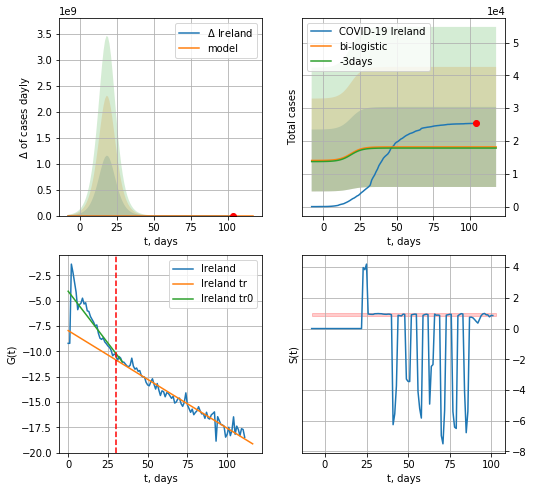

Ireland data at: 2020-06-20
+3 day model MAPE: 0.01907702212371044
model: bi-logistic
coeffs:  [ 1.12500176e+04 -9.81394116e+00  2.48307957e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6705332606001505
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  18189 ± 12196
	 total death:  1229 ± 2472
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.952629
 intercept: -7.951949
 slope: -0.096405


In [768]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,14*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


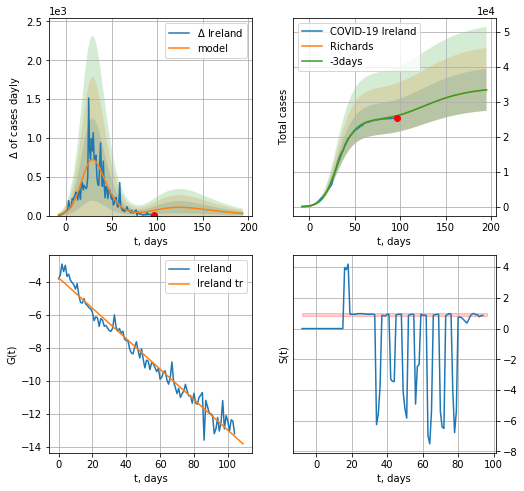

Ireland data at: 2020-06-20
+3 day model MAPE: 0.000217
model: Richards
coeffs: [2.52266305e+04 1.99397139e-01 2.21547412e+01 4.80559274e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.179422
forecast at the end of period: +98 days
	 deltaDaycases: 27
	 total cases: 33492 ± 6009
	 total death: 2263 ± 1218
trend coefficient of determination: 0.970194
 intercept: -3.744849
 slope: -0.092555


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


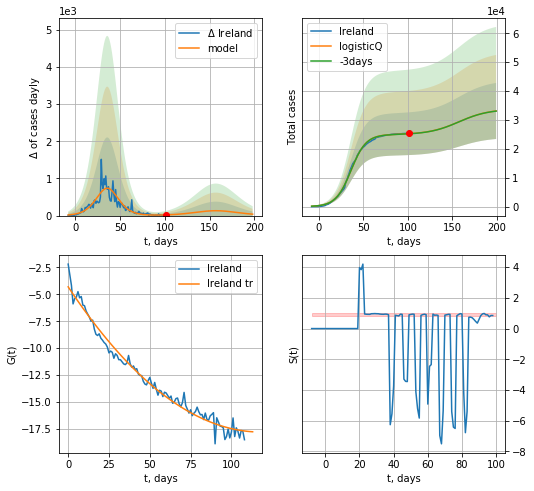

Ireland data at: 2020-06-20
+3 day model MAPE: 0.001642
model: logisticQ
coeffs: [ 2.49594772e+04  8.84573695e-07  3.60912613e+01 -1.33651713e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.293005
forecast at the end of period: +98 days
	 deltaDaycases: 38
	 total cases: 33116 ± 9703
	 total death: 2238 ± 1967
trend coefficient of determination: 0.979136
 intercept_: -4.30689749606147
 coeffs_: [ 0.         -0.22790536  0.00096365]


In [775]:
ivL = 7
vL = 90 + ivL
x = forecastRR('Ireland',dfIR[7:],d1,26*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Ireland',dfIR[7:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active   death
105 2020-06-16  215871   24834  3383.0
106 2020-06-17  220628   24602  3615.0
107 2020-06-18  225103   34821  3841.0
108 2020-06-19  231393   35809  4093.0
109 2020-06-20  236748   35844  4295.0


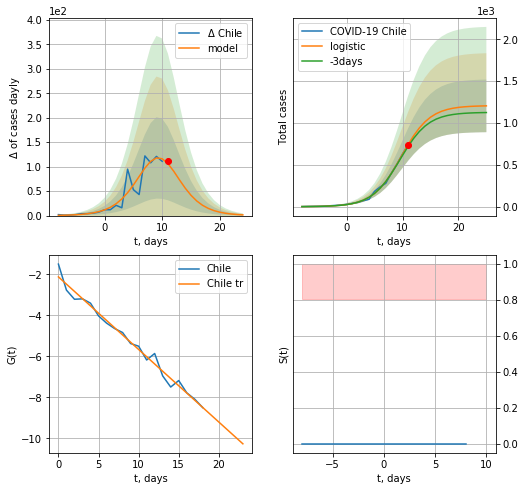

Chile data at: 2020-06-20
+3 day model MAPE: 0.03908987806693812
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +14 days
	 deltaDaycases:  1
	 total cases:  1204 ± 314
	 total death:  21 ± 16
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


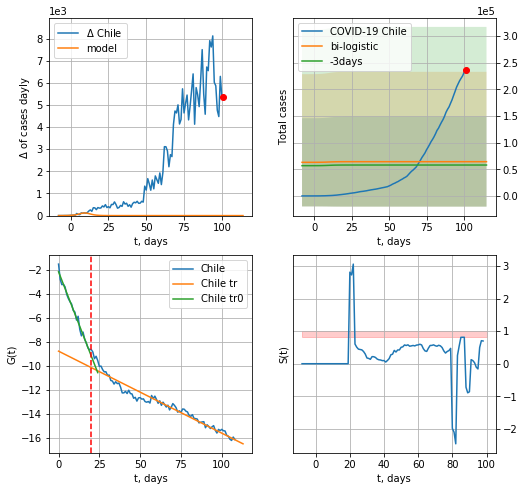

Chile data at: 2020-06-20
+3 day model MAPE: 0.10836657789994894
model: bi-logistic
coeffs:  [ 5.04782088e+04 -1.15080450e+01  2.88278386e+02] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.3117097320651887
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  64305 ± 84349
	 total death:  1166 ± 4588
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.942746
 intercept: -8.779559
 slope: -0.068536


In [777]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*14-dT)
xx = forecast2('Chile',dfCL[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


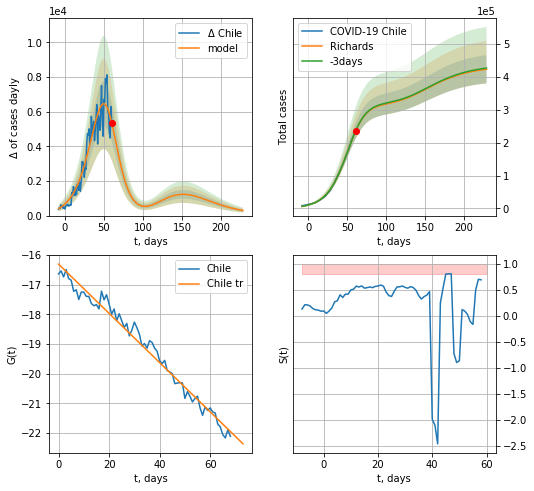

Chile data at: 2020-06-20
+3 day model MAPE: 0.001999
model: Richards
coeffs: [3.17813953e+05 6.28088378e-02 5.45140775e+01 1.48061045e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.101334
forecast at the end of period: +168 days
	 deltaDaycases: 289
	 total cases: 423530 ± 42918
	 total death: 7683 ± 2335
trend coefficient of determination: 0.978325
 intercept: -16.301132
 slope: -0.083051


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


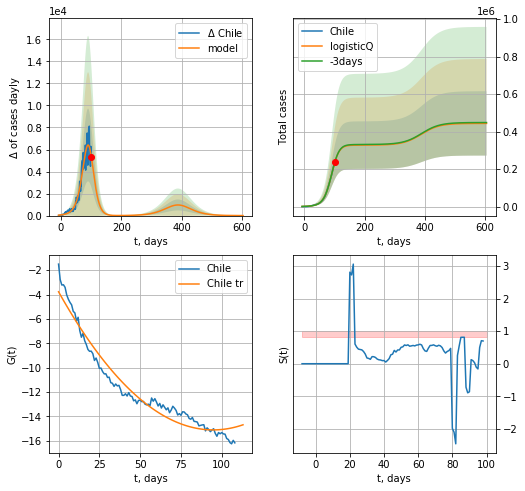

Chile data at: 2020-06-20
+3 day model MAPE: 0.002583
model: logisticQ
coeffs: [ 3.27584309e+05  1.72414158e-04  8.90088088e+01 -3.63494186e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.386589
forecast at the end of period: +504 days
	 deltaDaycases: 2
	 total cases: 443536 ± 171466
	 total death: 8046 ± 9331
trend coefficient of determination: 0.953096
 intercept_: -3.772404366810541
 coeffs_: [ 0.         -0.23908277  0.00126141]


In [778]:
vL = 20+10
x = forecastRR('Chile',dfCL[40:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Chile',dfCL[10:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-10)
x = forecastRRR('Chile',dfCL[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

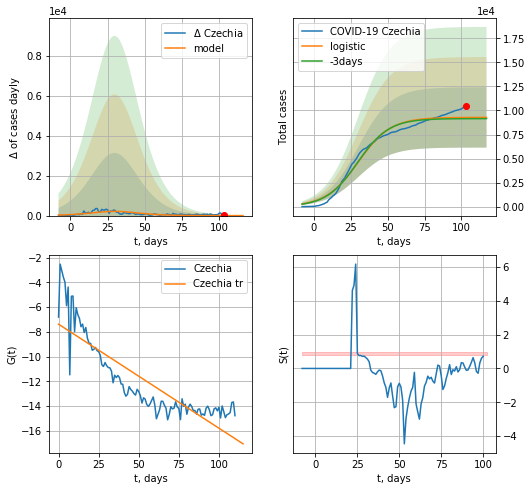

Czechia data at: 2020-06-20
+3 day model MAPE: 0.013599350988952293
model: logistic
coeffs:  [9.28202009e+03 9.09055371e-02 3.01017340e+01]
rational stdev:  0.3381188496161241
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  9278 ± 3137
	 total death:  298 ± 302
trend coefficient of determination: 0.736302
 intercept: -7.383214
 slope: -0.084016


In [780]:
x = forecast('Czechia',dfCH[:],d1,14*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


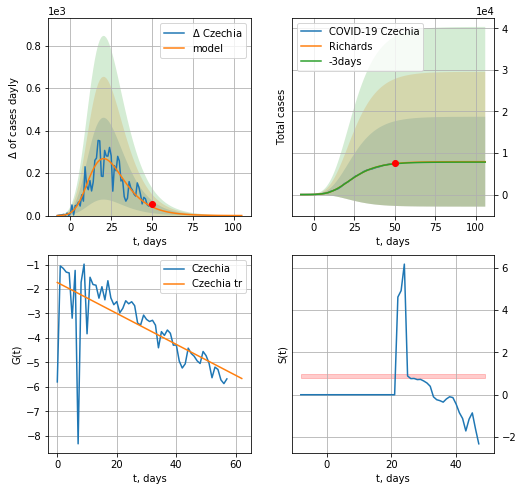

Czechia data at: 2020-06-20
+3 day model MAPE: 0.007369
model: Richards
coeffs: [ 7.90689533e+03  1.12645119e+00 -4.69210858e+00  8.53971991e-02]
rational stdev: 1.366945
forecast at the end of period: +56 days
	 deltaDaycases: 0
	 total cases: 7904 ± 10805
	 total death: 254 ± 1041
trend coefficient of determination: 0.470375
 intercept: -1.735202
 slope: -0.063324


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


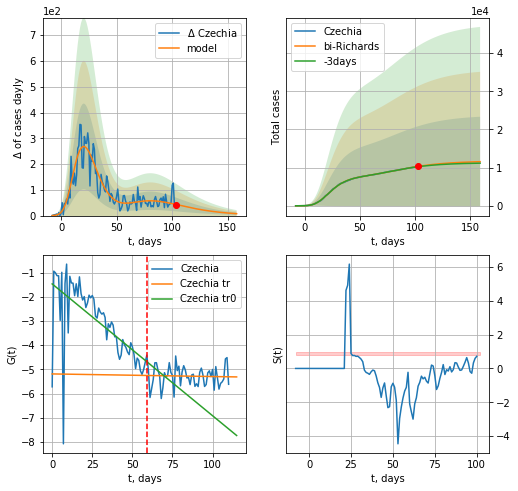

Czechia data at: 2020-06-20
+3 day model MAPE: 0.008883
model: bi-Richards
coeffs: [ 3.83809171e+03  3.68402107e+00 -3.17391512e+01  1.07047793e-02]
rational stdev: 1.018678
forecast at the end of period: +56 days
	 deltaDaycases: 7
	 total cases: 11555 ± 11771
	 total death: 371 ± 1133
bi-Richards approximation splitting point: 59
trend coefficient of determination: 0.396513
 intercept: -1.466057
 slope: -0.054490
trend coefficient of determination: 0.001437
 intercept: -5.186843
 slope: -0.001077


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


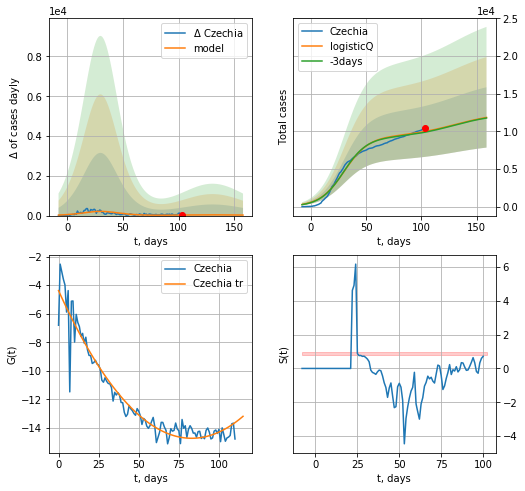

Czechia data at: 2020-06-20
+3 day model MAPE: 0.010126
model: logisticQ
coeffs: [ 9.28209111e+03  1.58442508e-07  3.01030822e+01 -5.73523877e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.338159
forecast at the end of period: +56 days
	 deltaDaycases: 26
	 total cases: 11849 ± 4006
	 total death: 381 ± 386
trend coefficient of determination: 0.929296
 intercept_: -4.384296911875373
 coeffs_: [ 0.         -0.24909853  0.00150077]


In [781]:
vL= 59
x = forecastRR('Czechia',dfCH[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Czechia',dfCH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

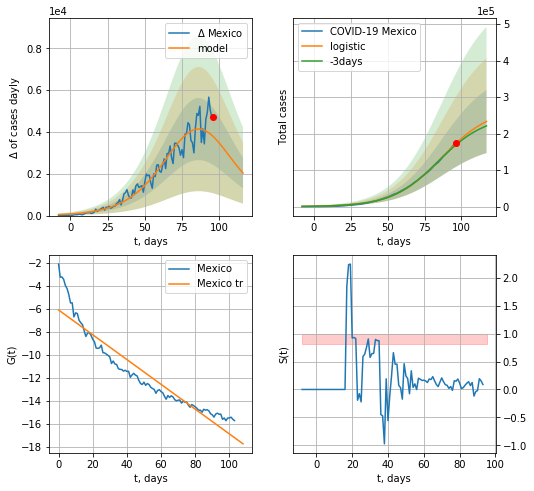

Mexico data at: 2020-06-20
+3 day model MAPE: 0.023968077099653408
model: logistic
coeffs:  [2.65717639e+05 6.19880631e-02 8.64223588e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3704641335884051
forecast at the end of period: +21 days
	 deltaDaycases:  2031
	 total cases:  233029 ± 86329
	 total death:  27639 ± 30717
trend coefficient of determination: 0.895524
 intercept: -6.067623
 slope: -0.107783


In [782]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


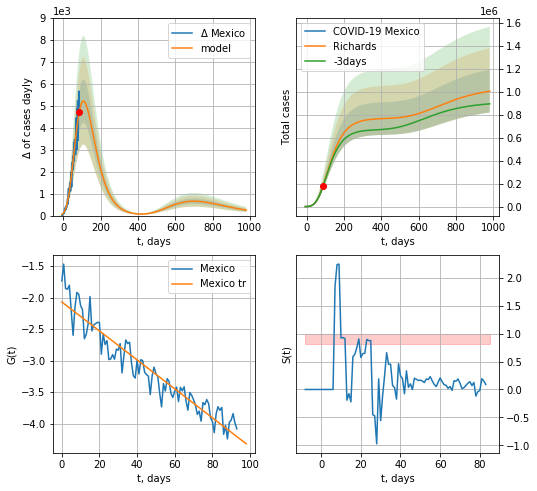

Mexico data at: 2020-06-20
+3 day model MAPE: 0.006773
model: Richards
coeffs: [ 7.67323198e+05  4.83663224e-01 -6.41220080e+01  3.88954863e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.185552
forecast at the end of period: +896 days
	 deltaDaycases: 249
	 total cases: 1003322 ± 186168
	 total death: 119005 ± 66244
trend coefficient of determination: 0.904100
 intercept: -2.070627
 slope: -0.022975


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


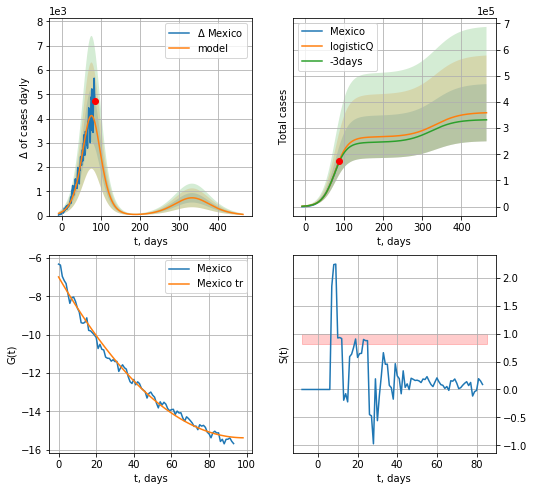

Mexico data at: 2020-06-20
+3 day model MAPE: 0.024176
model: logisticQ
coeffs: [ 2.66071696e+05  1.76961888e-06  7.64692645e+01 -3.49309258e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.304728
forecast at the end of period: +378 days
	 deltaDaycases: 49
	 total cases: 358720 ± 109311
	 total death: 42548 ± 38896
trend coefficient of determination: 0.990686
 intercept_: -6.991948869973772
 coeffs_: [ 0.         -0.17008901  0.00086152]


In [783]:
x = forecastRR('Mexico',dfMX[10:],d1,140*7-dT,addpred=True,xcoef=RkoreaCoeffs)#
x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
           date   cases  active  death     tests
99  2020-06-16  1778.0     245   76.0  375572.0
100 2020-06-17  1784.0     249   76.0  381225.0
101 2020-06-18  1792.0     254   76.0  386194.0
102 2020-06-19  1795.0     249   76.0  390457.0
103 2020-06-20  1795.0     249   76.0       NaN
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


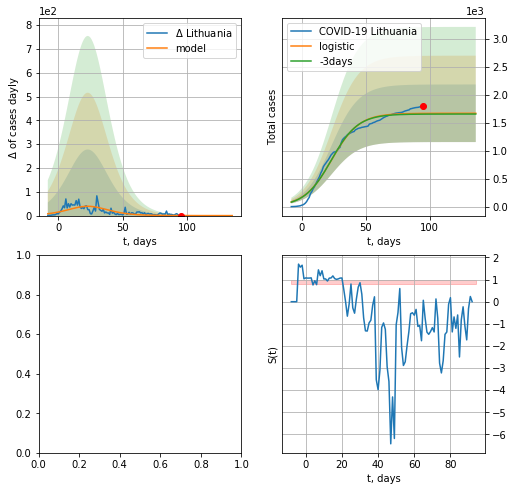

In [784]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [785]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [786]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

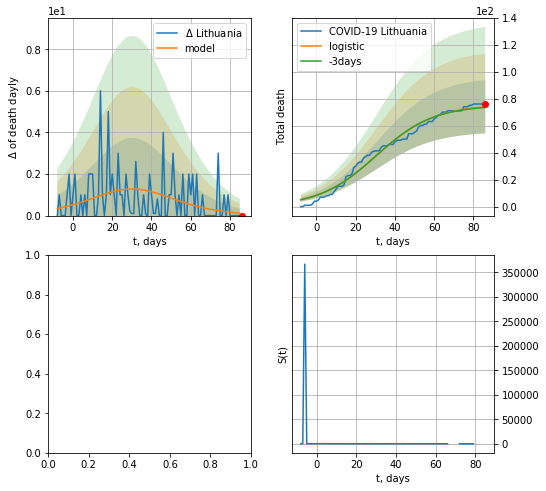

In [787]:
x = forecast('Lithuania',dfLT[9:],d1,7*12-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


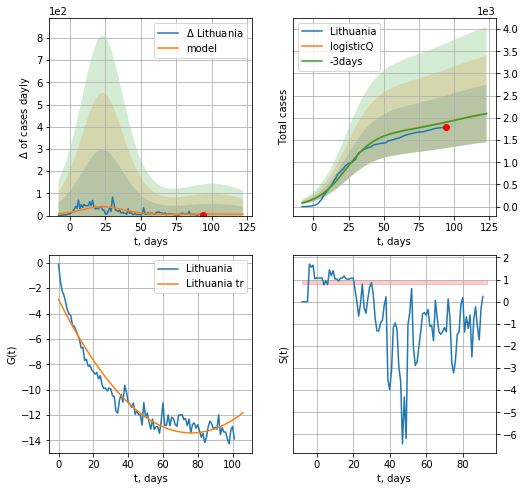

Lithuania data at: 2020-06-19
+3 day model MAPE: 0.004124
model: logisticQ
coeffs: [ 1.66744467e+03  2.05486864e-07  2.33408355e+01 -4.59624391e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.309219
forecast at the end of period: +29 days
	 deltaDaycases: 5
	 total cases: 2100 ± 649
	 total death: 89 ± 82
trend coefficient of determination: 0.932797
 intercept_: -2.8877628815726153
 coeffs_: [ 0.         -0.27581224  0.00180693]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


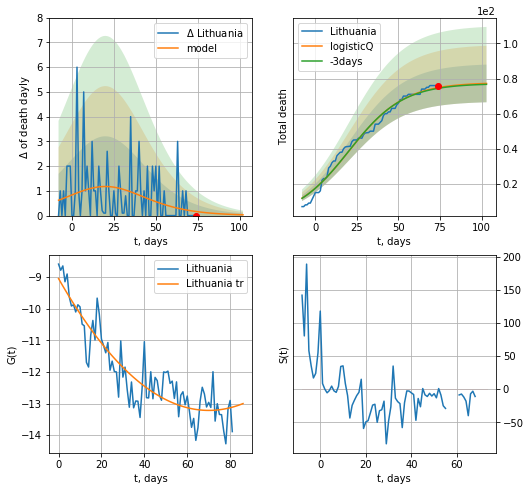

Lithuania data at: 2020-06-19
+3 day model MAPE: 0.005315
model: logisticQ
coeffs: [ 7.77433582e+01  4.18455400e-07  2.03797559e+01 -1.44581699e+05]
rational stdev: 0.139071
forecast at the end of period: +29 days
	 total death: 77 ± 10
trend coefficient of determination: 0.822480
 intercept_: -9.048122305379986
 coeffs_: [ 0.         -0.11902194  0.00084954]


In [474]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


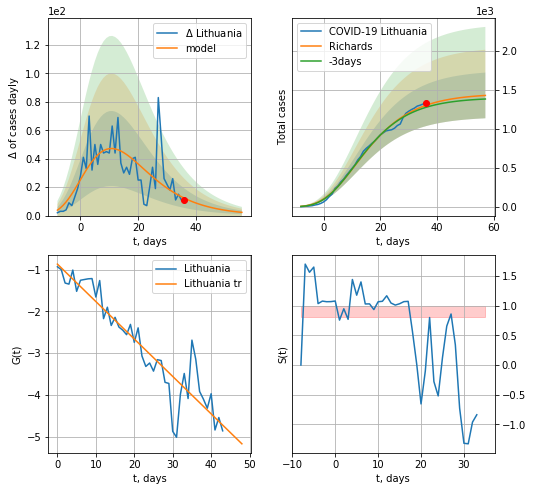

Lithuania data at: 2020-06-19
+3 day model MAPE: 0.021066
model: Richards
coeffs: [ 1.45212959e+03  9.67658542e+00 -4.16678055e+01  9.16998413e-03]
rational stdev: 0.205046
forecast at the end of period: +21 days
	 deltaDaycases: 2
	 total cases: 1427 ± 292
	 total death: 60 ± 36
trend coefficient of determination: 0.866665
 intercept: -0.867769
 slope: -0.089640


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


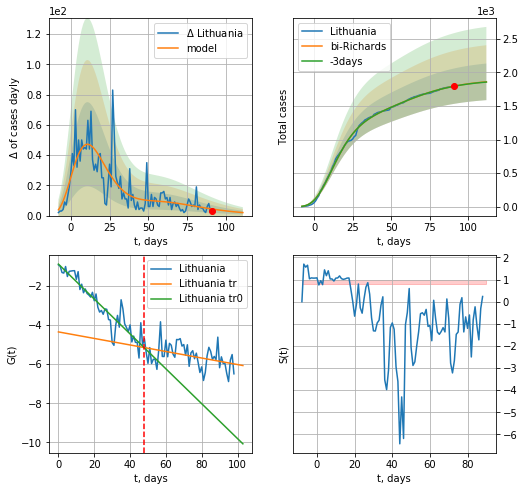

Lithuania data at: 2020-06-19
+3 day model MAPE: 0.000803
model: bi-Richards
coeffs: [ 4.49357061e+02  3.39047681e+00 -2.87688428e+01  1.37551367e-02]
rational stdev: 0.146503
forecast at the end of period: +21 days
	 deltaDaycases: 1
	 total cases: 1857 ± 272
	 total death: 78 ± 34
bi-Richards approximation splitting point: 48
trend coefficient of determination: 0.872791
 intercept: -0.901886
 slope: -0.088996
trend coefficient of determination: 0.165345
 intercept: -4.360109
 slope: -0.016651


In [479]:
vL = 48
x = forecastRR('Lithuania',dfLT[3:vL],d1,15*7-1-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[3:],d1,15*7-1-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


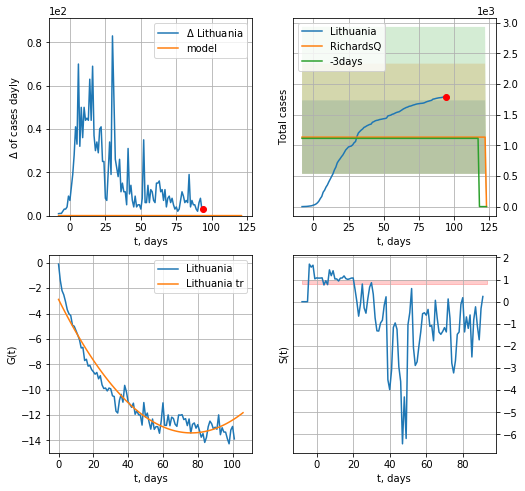

Lithuania data at: 2020-06-19
+3 day model MAPE: 0.017720
model: RichardsQ
coeffs: [ 1.13284563e+03 -1.83144341e+00 -1.54364384e+02  1.22410651e+02
  1.89169658e-01]
rational stdev: 0.528746
forecast at the end of period: +29 days
	 deltaDaycases: -1132
	 total cases: 0 ± 0
	 total death: 0 ± 0
trend coefficient of determination: 0.932797
 intercept_: -2.8877628815726153
 coeffs_: [ 0.         -0.27581224  0.00180693]


In [478]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date   cases  active  death
101 2020-06-16  4075.0      32  110.0
102 2020-06-17  4085.0      40  110.0
103 2020-06-18  4091.0      41  110.0
104 2020-06-19  4099.0      45  110.0
105 2020-06-20  4105.0      44  110.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


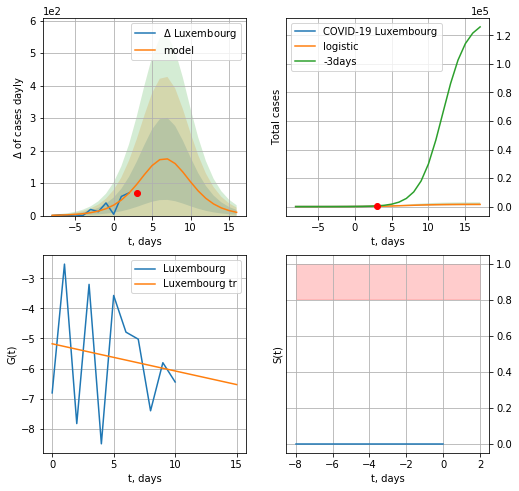

Luxembourg data at: 2020-06-20
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +14 days
	 deltaDaycases:  10
	 total cases:  1545 ± 496
	 total death:  41 ± 39
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


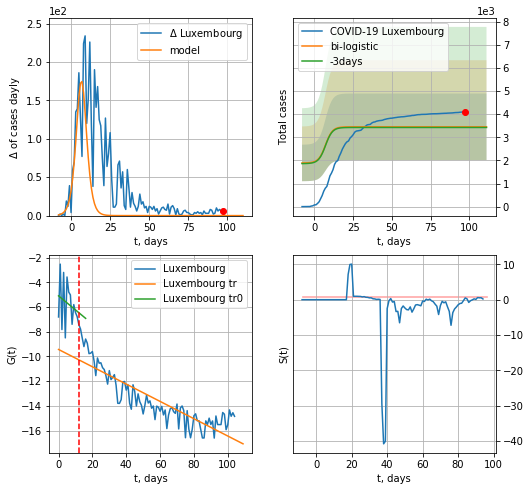

Luxembourg data at: 2020-06-20
+3 day model MAPE: 0.008180932610248144
model: bi-logistic
coeffs:  [1680.18756477   -6.50499903  242.30782783] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.41714814112620907
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  3453 ± 1440
	 total death:  92 ± 115
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.751822
 intercept: -9.436607
 slope: -0.070046


In [790]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,14*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,14*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


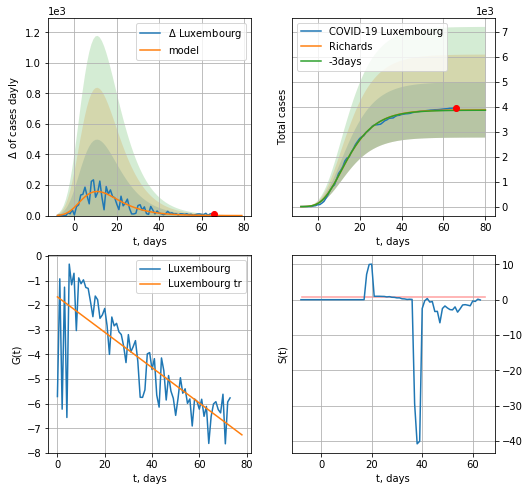

Luxembourg data at: 2020-06-20
+3 day model MAPE: 0.003345
model: Richards
coeffs: [ 3.88162927e+03  1.99569941e+01 -3.56216724e+01  5.55736951e-03]
rational stdev: 0.285969
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 3879 ± 1109
	 total death: 103 ± 88
trend coefficient of determination: 0.626779
 intercept: -1.663811
 slope: -0.071855


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


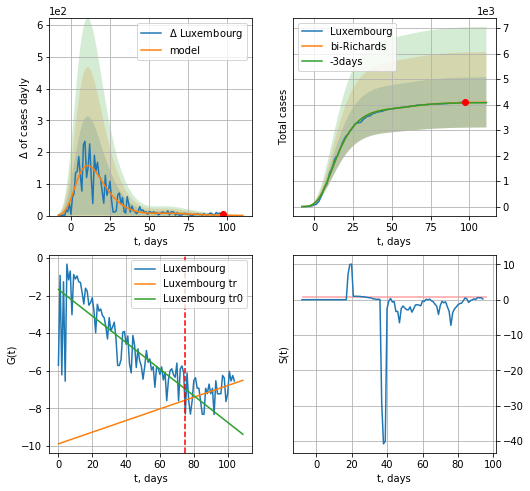

Luxembourg data at: 2020-06-20
+3 day model MAPE: 0.003013
model: bi-Richards
coeffs: [ 2.14294975e+02  3.01715185e+01 -1.22789703e+01  2.55589793e-03]
rational stdev: 0.240884
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 4089 ± 985
	 total death: 109 ± 78
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.627085
 intercept: -1.670815
 slope: -0.070776
trend coefficient of determination: 0.147140
 intercept: -9.893887
 slope: 0.031032


In [791]:
vL = 75
x = forecastRR("Luxembourg",dfLX[:vL],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[:],d1,14*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


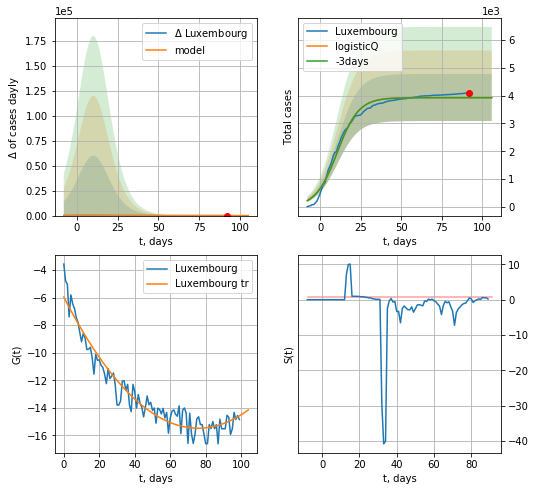

Luxembourg data at: 2020-06-20
+3 day model MAPE: 0.002487
model: logisticQ
coeffs: [ 3.93353552e+03  4.46494437e-07  1.05795133e+01 -3.37083513e+05]
rational stdev: 0.215238
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 3933 ± 846
	 total death: 105 ± 67
trend coefficient of determination: 0.927509
 intercept_: -5.963893443851157
 coeffs_: [ 0.         -0.25118746  0.00165833]


In [793]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,14*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
           date    cases   active   death
108 2020-06-16  47943.0  20289.0  3970.0
109 2020-06-17  48490.0  20602.0  4007.0
110 2020-06-18  49097.0  20887.0  4087.0
111 2020-06-19  49731.0  21129.0  4156.0
112 2020-06-20  49731.0  21129.0  4156.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

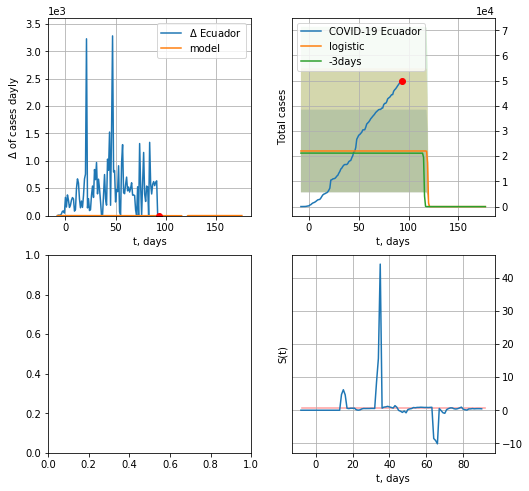

In [794]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


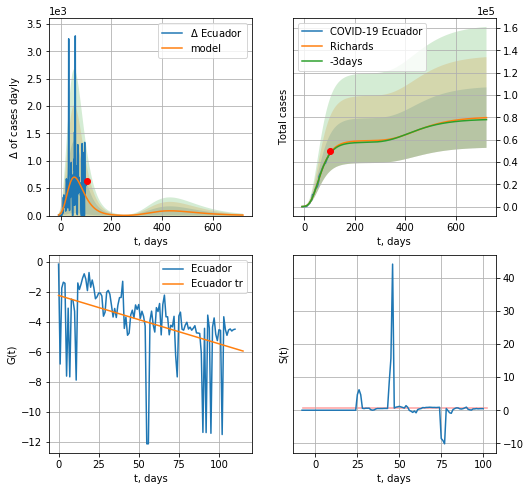

Ecuador data at: 2020-06-19
+3 day model MAPE: 0.010493
model: Richards
coeffs: [ 5.91405077e+04  2.84733877e+00 -8.32363391e+01  1.14061101e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.339866
forecast at the end of period: +617 days
	 deltaDaycases: 9
	 total cases: 79719 ± 27093
	 total death: 6662 ± 6792
trend coefficient of determination: 0.193254
 intercept: -2.232368
 slope: -0.032278


In [314]:
x = forecastRR("Ecuador",dfED[:],d1,100*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


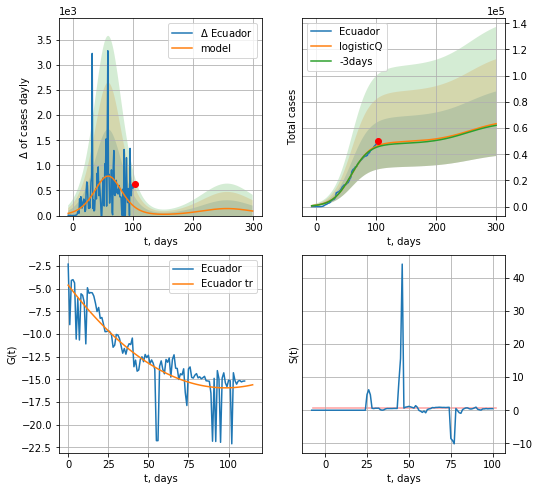

Ecuador data at: 2020-06-19
+3 day model MAPE: 0.019900
model: logisticQ
coeffs: [ 4.93362641e+04  4.02196751e-07  5.89519268e+01 -1.58359275e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.389395
forecast at the end of period: +197 days
	 deltaDaycases: 90
	 total cases: 63296 ± 24647
	 total death: 5289 ± 6178
trend coefficient of determination: 0.734517
 intercept_: -4.61399887057786
 coeffs_: [ 0.         -0.23071931  0.00117614]


In [315]:
x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date   cases  active  death
112 2020-06-16  7112.0     586  326.0
113 2020-06-17  7117.0     591  326.0
114 2020-06-18  7119.0     593  326.0
115 2020-06-19  7133.0     607  326.0
116 2020-06-20  7142.0     616  326.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


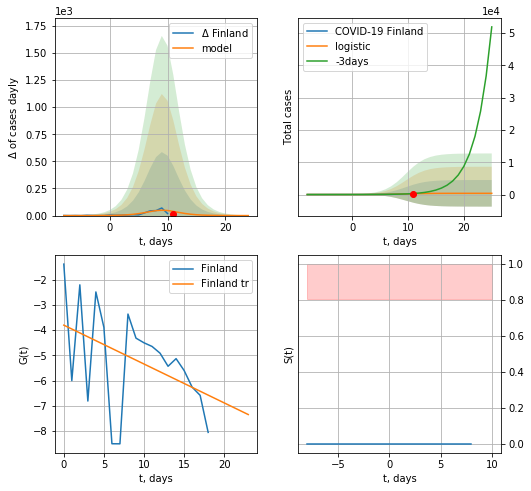

Finland data at: 2020-06-20
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  373 ± 4114
	 total death:  17 ± 562
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


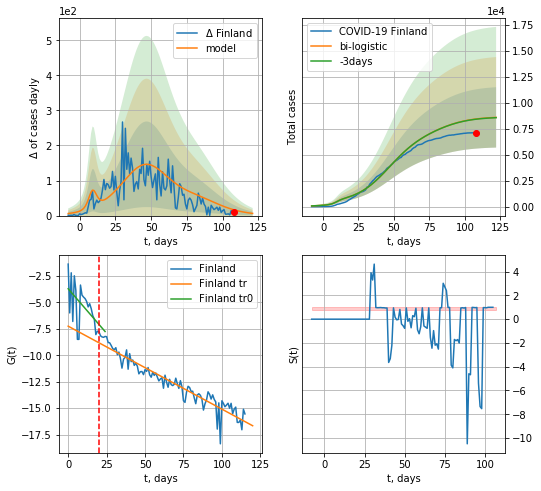

Finland data at: 2020-06-20
+3 day model MAPE: 0.0026521568015879173
model: bi-logistic
coeffs:  [6.64253722e+03 8.46547945e-02 4.63994596e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3380720884927602
forecast at the end of period: +14 days
	 deltaDaycases:  6
	 total cases:  8603 ± 2908
	 total death:  392 ± 397
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.906102
 intercept: -7.253054
 slope: -0.078435


In [796]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,7*14-dT)
xx = forecast2("Finland",dfFI[:],d1,14*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


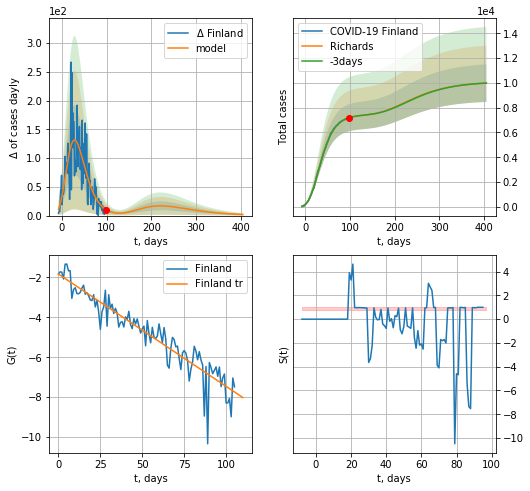

Finland data at: 2020-06-20
+3 day model MAPE: 0.001492
model: Richards
coeffs: [ 7.40639502e+03  5.56492127e-01 -1.90887561e+01  9.06276934e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.151656
forecast at the end of period: +308 days
	 deltaDaycases: 1
	 total cases: 9981 ± 1513
	 total death: 455 ± 207
trend coefficient of determination: 0.879928
 intercept: -1.830270
 slope: -0.056269


In [797]:
x = forecastRR("Finland",dfFI[10:],d1,56*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


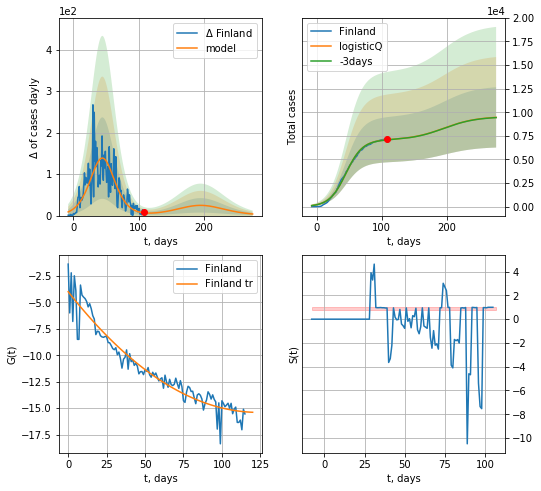

Finland data at: 2020-06-20
+3 day model MAPE: 0.002671
model: logisticQ
coeffs: [ 7.05673827e+03  4.02279459e-07  4.48700349e+01 -1.94982495e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.337962
forecast at the end of period: +168 days
	 deltaDaycases: 3
	 total cases: 9455 ± 3195
	 total death: 431 ± 436
trend coefficient of determination: 0.920811
 intercept_: -3.9968362230749843
 coeffs_: [ 0.         -0.18442274  0.00074548]


In [798]:
x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases  active  death
98  2020-06-16   3453  1455.0  181.0
99  2020-06-17   3542  1478.0  184.0
100 2020-06-18   3674  1543.0  190.0
101 2020-06-19   3755  1554.0  193.0
102 2020-06-20   3872  1646.0  199.0


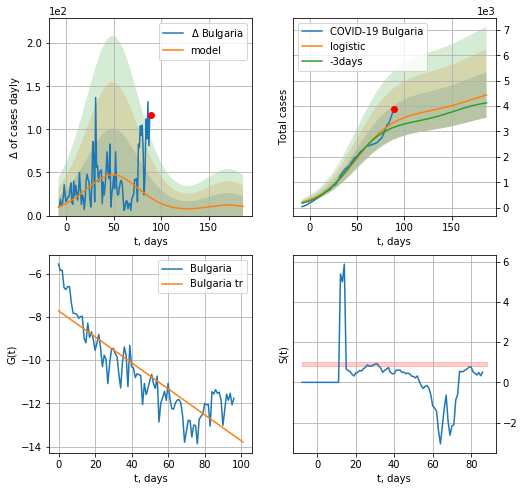

Bulgaria data at: 2020-06-20
+3 day model MAPE: 0.06185447181567391
model: logistic
coeffs:  [3.80213140e+03 4.97875533e-02 4.92397034e+01]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.2012305702453761
forecast at the end of period: +98 days
	 deltaDaycases:  10
	 total cases:  4439 ± 893
	 total death:  228 ± 137
trend coefficient of determination: 0.761988
 intercept: -7.720969
 slope: -0.060103


In [799]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


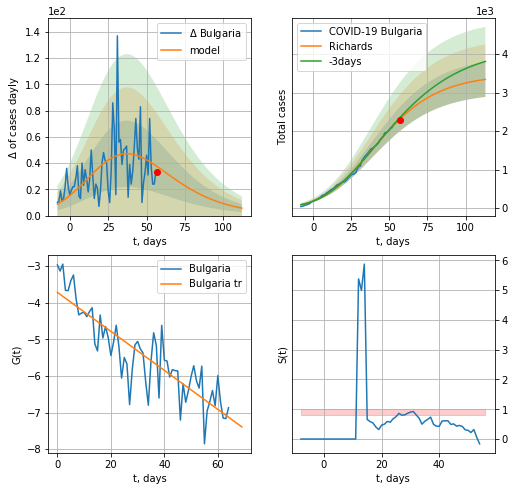

Bulgaria data at: 2020-06-20
+3 day model MAPE: 0.017234
model: Richards
coeffs: [3.47700933e+03 1.26494372e-01 1.24703961e+01 3.39631762e-01]
rational stdev: 0.135837
forecast at the end of period: +56 days
	 deltaDaycases: 5
	 total cases: 3344 ± 454
	 total death: 171 ± 69
trend coefficient of determination: 0.758376
 intercept: -3.716230
 slope: -0.053312


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


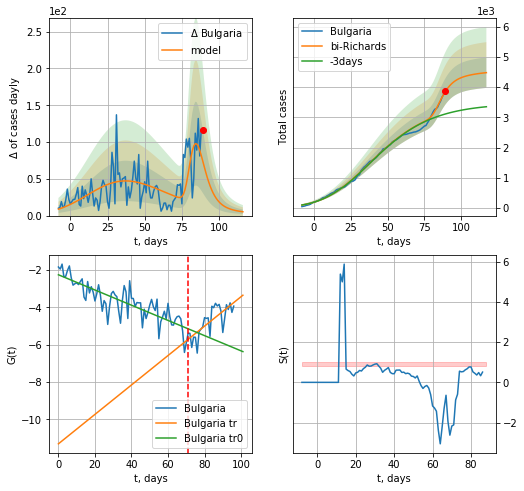

Bulgaria data at: 2020-06-20
+3 day model MAPE: 0.253703
model: bi-Richards
coeffs: [1.11970504e+03 3.89406391e+00 7.05299048e+01 5.22372181e-02]
rational stdev: 0.112790
forecast at the end of period: +28 days
	 deltaDaycases: 5
	 total cases: 4482 ± 505
	 total death: 230 ± 77
bi-Richards approximation splitting point: 71
trend coefficient of determination: 0.693419
 intercept: -2.250394
 slope: -0.040767
trend coefficient of determination: 0.573944
 intercept: -11.308507
 slope: 0.078833


In [800]:
vL = 71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,20*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,16*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


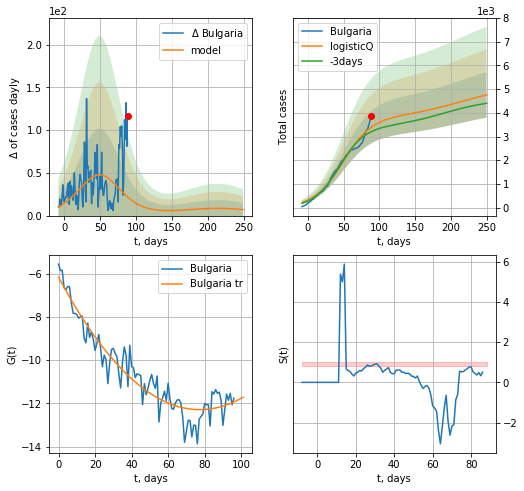

Bulgaria data at: 2020-06-20
+3 day model MAPE: 0.060880
model: logisticQ
coeffs: [ 3.80120749e+03  3.14966487e-07  4.92298822e+01 -1.58033489e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.201330
forecast at the end of period: +161 days
	 deltaDaycases: 7
	 total cases: 4754 ± 957
	 total death: 244 ± 147
trend coefficient of determination: 0.900764
 intercept_: -6.164554080004375
 coeffs_: [ 0.         -0.15840708  0.00102402]


In [801]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
110 2020-06-16  3135.3    81.0   58.0
111 2020-06-17  3141.0    86.0   58.0
112 2020-06-18  3146.0    80.0   58.0
113 2020-06-19  3147.0    71.0   58.0
114 2020-06-20  3148.0    72.0   58.0


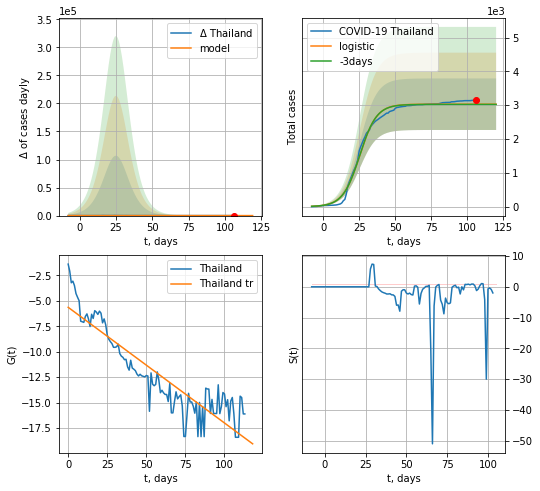

Thailand data at: 2020-06-20
+3 day model MAPE: 0.0021646678756669082
model: logistic
coeffs:  [3.02998043e+03 1.70424791e-01 2.53713274e+01]
rational stdev:  0.2515240245797376
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  3029 ± 762
	 total death:  55 ± 41
trend coefficient of determination: 0.816360
 intercept: -5.631866
 slope: -0.113674


In [802]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,14*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [803]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


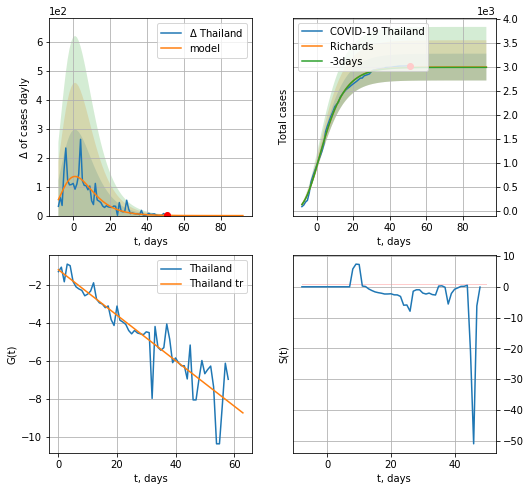

Thailand data at: 2020-06-20
+3 day model MAPE: 0.001961
model: Richards
coeffs: [ 2.99626186e+03  1.57389308e+01 -3.79335147e+01  7.82164356e-03]
rational stdev: 0.093313
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 2996 ± 279
	 total death: 55 ± 15
trend coefficient of determination: 0.845848
 intercept: -1.208266
 slope: -0.119672


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


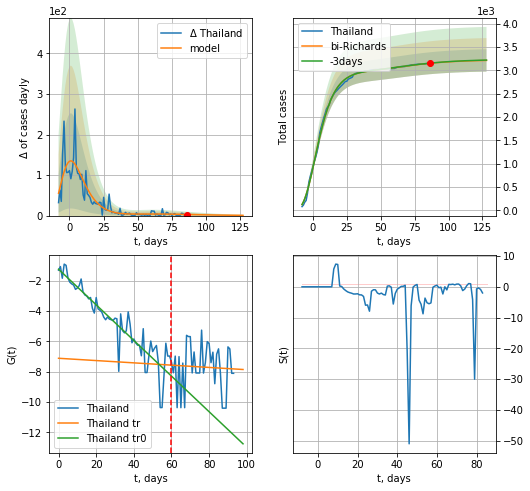

Thailand data at: 2020-06-20
+3 day model MAPE: 0.000721
model: bi-Richards
coeffs: [ 2.30563314e+02  7.19460026e+00 -4.75451536e+01  6.26201706e-03]
rational stdev: 0.074480
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 3213 ± 239
	 total death: 59 ± 13
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.843214
 intercept: -1.238722
 slope: -0.117511
trend coefficient of determination: 0.002377
 intercept: -7.113167
 slope: -0.007550


In [804]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


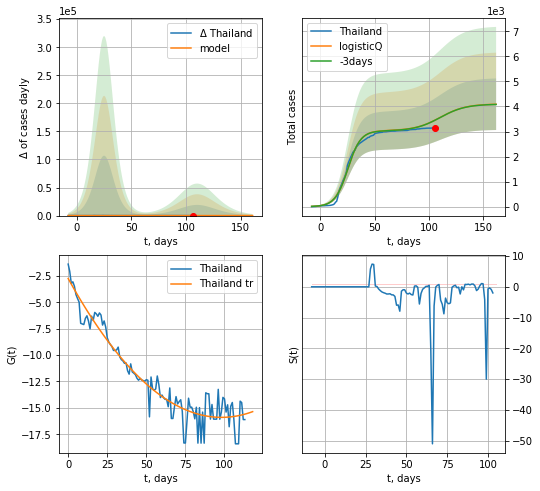

Thailand data at: 2020-06-20
+3 day model MAPE: 0.001067
model: logisticQ
coeffs: [ 3.02998297e+03  6.43009928e-07  2.53718547e+01 -2.64927854e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.251712
forecast at the end of period: +56 days
	 deltaDaycases: 1
	 total cases: 4090 ± 1029
	 total death: 75 ± 56
trend coefficient of determination: 0.918580
 intercept_: -2.7496137095713067
 coeffs_: [ 0.         -0.26808514  0.00136649]


In [805]:
x = forecastRRR("Thailand",dfTH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

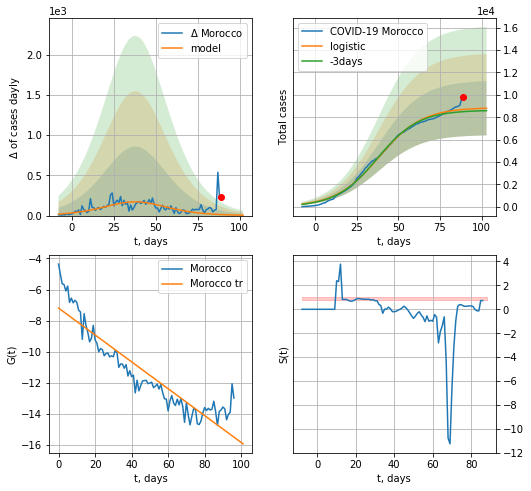

Morocco data at: 2020-06-20
+3 day model MAPE: 0.022758128540419635
model: logistic
coeffs:  [8.86266892e+03 7.71121733e-02 3.82046175e+01]
rational stdev:  0.2751344567725944
forecast at the end of period: +14 days
	 deltaDaycases:  4
	 total cases:  8803 ± 2422
	 total death:  190 ± 156
trend coefficient of determination: 0.851029
 intercept: -7.187402
 slope: -0.086391


In [807]:
x = forecast("Morocco",dfMR[5:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


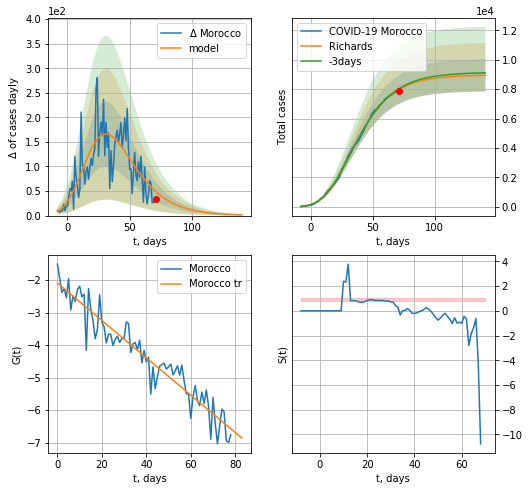

Morocco data at: 2020-06-20
+3 day model MAPE: 0.007136
model: Richards
coeffs: [ 8.96264305e+03  3.75980236e-01 -4.65869999e+00  1.43312992e-01]
rational stdev: 0.122854
forecast at the end of period: +70 days
	 deltaDaycases: 1
	 total cases: 8938 ± 1098
	 total death: 193 ± 71
trend coefficient of determination: 0.909402
 intercept: -2.092888
 slope: -0.057450


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


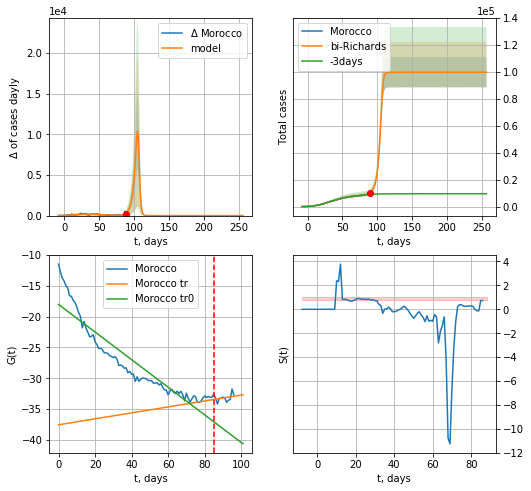

Morocco data at: 2020-06-20
+3 day model MAPE: 0.107737
model: bi-Richards
coeffs: [9.06681027e+04 2.38433658e-01 1.07059429e+02 3.14666470e+00]
rational stdev: 0.112322
forecast at the end of period: +168 days
	 deltaDaycases: 0
	 total cases: 99630 ± 11190
	 total death: 2156 ± 726
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.864349
 intercept: -18.048425
 slope: -0.223434
trend coefficient of determination: 0.075435
 intercept: -37.533732
 slope: 0.048193


In [808]:
vL = 85 + 5
x = forecastRR("Morocco",dfMR[5:vL-5],d1,22*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Morocco",dfMR[5:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


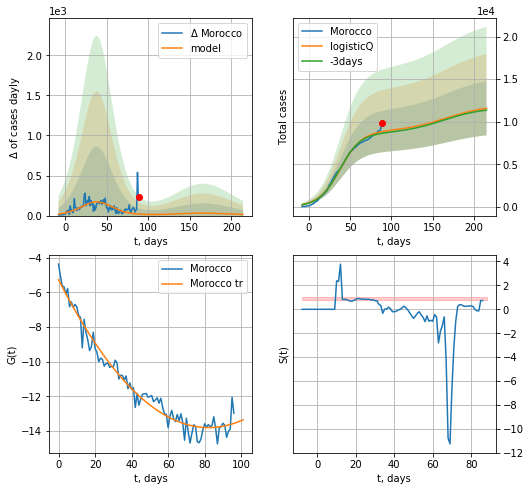

Morocco data at: 2020-06-20
+3 day model MAPE: 0.022184
model: logisticQ
coeffs: [ 8.86220490e+03  4.18875948e-07  3.82040909e+01 -1.84015426e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.275237
forecast at the end of period: +126 days
	 deltaDaycases: 14
	 total cases: 11585 ± 3188
	 total death: 250 ± 206
trend coefficient of determination: 0.965583
 intercept_: -5.264157789237208
 coeffs_: [ 0.         -0.20786413  0.00126538]


In [809]:
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

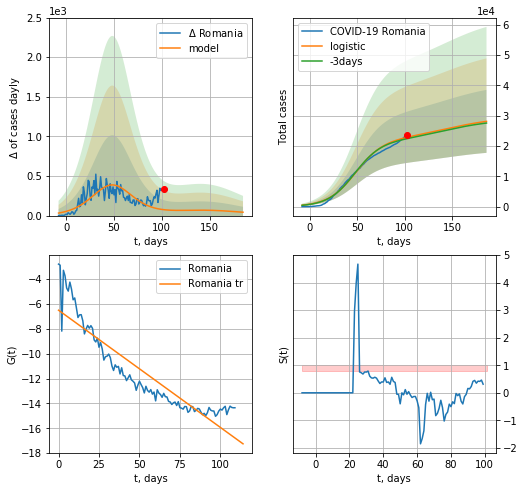

Romania data at: 2020-06-20
+3 day model MAPE: 0.01994103579592489
model: logistic
coeffs:  [2.19456703e+04 6.90463316e-02 4.84232057e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.36933064262622756
forecast at the end of period: +84 days
	 deltaDaycases:  42
	 total cases:  28113 ± 10383
	 total death:  1777 ± 1968
trend coefficient of determination: 0.831572
 intercept: -6.508600
 slope: -0.094213


In [810]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


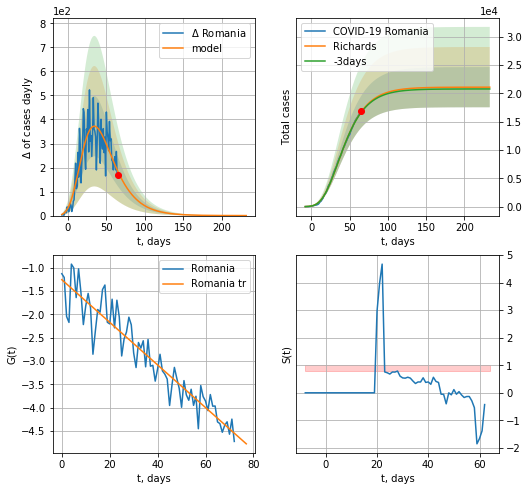

Romania data at: 2020-06-20
+3 day model MAPE: 0.005850
model: Richards
coeffs: [ 2.10984931e+04  4.16077879e+00 -5.77105071e+01  1.15870983e-02]
rational stdev: 0.168180
forecast at the end of period: +168 days
	 deltaDaycases: 0
	 total cases: 21097 ± 3548
	 total death: 1333 ± 672
trend coefficient of determination: 0.890440
 intercept: -1.255986
 slope: -0.045756


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


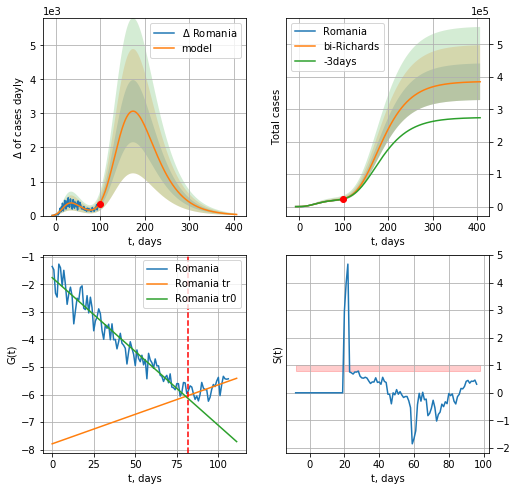

Romania data at: 2020-06-20
+3 day model MAPE: 0.004168
model: bi-Richards
coeffs: [3.64857200e+05 2.10907313e-01 8.41456802e+01 1.14411260e-01]
rational stdev: 0.146440
forecast at the end of period: +308 days
	 deltaDaycases: 32
	 total cases: 384639 ± 56326
	 total death: 24313 ± 10681
bi-Richards approximation splitting point: 82
trend coefficient of determination: 0.935099
 intercept: -1.758203
 slope: -0.053587
trend coefficient of determination: 0.329604
 intercept: -7.786239
 slope: 0.021410


In [811]:
vL = 82+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Romania",dfRM[8:],d1,56*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


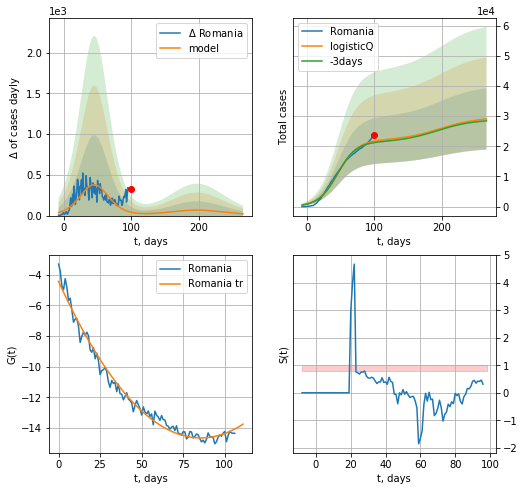

Romania data at: 2020-06-20
+3 day model MAPE: 0.022462
model: logisticQ
coeffs: [ 2.19626313e+04  2.61201630e-07  4.54524186e+01 -2.63448797e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.349642
forecast at the end of period: +168 days
	 deltaDaycases: 21
	 total cases: 29085 ± 10169
	 total death: 1838 ± 1927
trend coefficient of determination: 0.983817
 intercept_: -4.429064939873518
 coeffs_: [ 0.         -0.23893987  0.00139595]


In [812]:
xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [813]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
129 2020-06-16  1226062  160832  130031.0
130 2020-06-17  1231940  162609  130284.0
131 2020-06-18  1236419  161623  130491.0
132 2020-06-19  1239542  160965  131797.0
133 2020-06-20  1242834  160958  131919.0


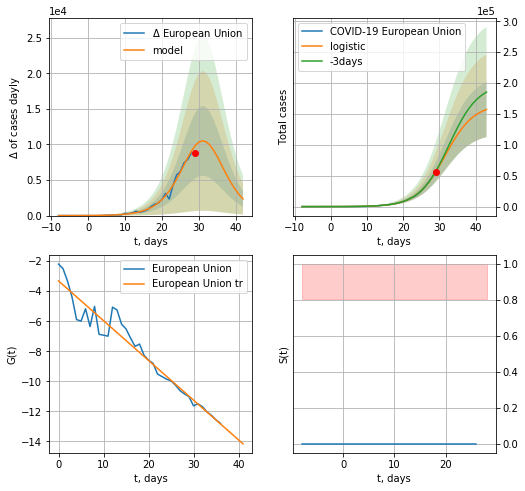

European Union data at: 2020-06-20
+3 day model MAPE: 0.026537291805373914
model: logistic
coeffs:  [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.28380142507641165
forecast at the end of period: +14 days
	 deltaDaycases:  2340
	 total cases:  157149 ± 44599
	 total death:  16680 ± 14201
trend coefficient of determination: 0.942451
 intercept: -3.318380
 slope: -0.264437


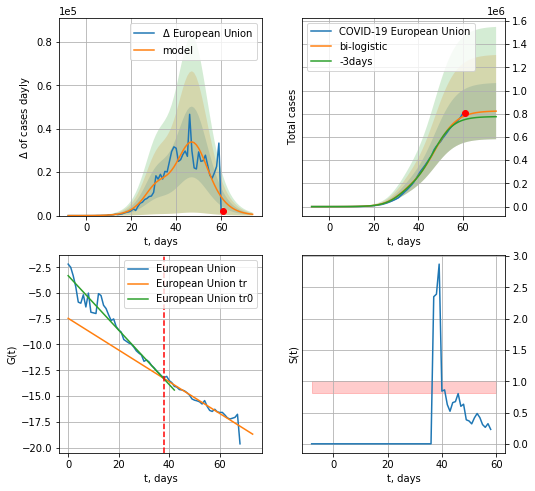

European Union data at: 2020-06-20
+3 day model MAPE: 0.046518861456193536
model: bi-logistic
coeffs:  [6.59401208e+05 2.01830792e-01 4.76685424e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.2940888577461115
forecast at the end of period: +14 days
	 deltaDaycases:  588
	 total cases:  822576 ± 241910
	 total death:  87311 ± 77031
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend coefficient of determination: 0.919570
 intercept: -7.459861
 slope: -0.154008


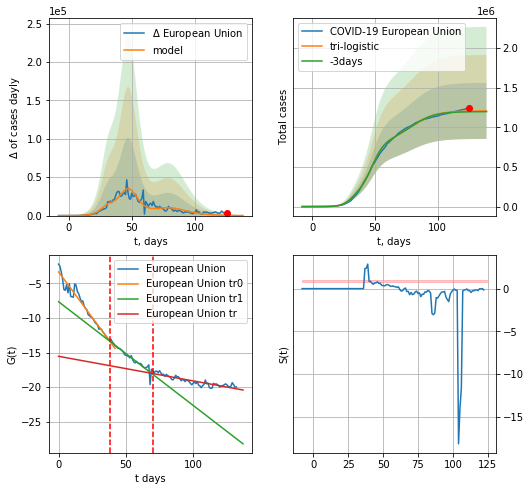

European Union data at: 2020-06-20
+3 day model MAPE: 0.007194650903347574
model: tri-logistic
coeffs:  [3.82317388e+05 1.05276852e-01 7.97811274e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01 6.59401208e+05
 2.01830792e-01 4.76685424e+01]
forecast rational stdev:  0.2927262223642934
forecast at the end of period: +14 days
	 deltaDaycases:  82
	 total cases:  1206788 ± 353258
	 total death:  128093 ± 112488
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend1 coefficient of determination: 0.917507
 intercept: -7.641441
 slope: -0.150225
trend coefficient of determination: 0.795233
 intercept: -15.549009
 slope: -0.035626


In [815]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,14*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,14*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,14*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


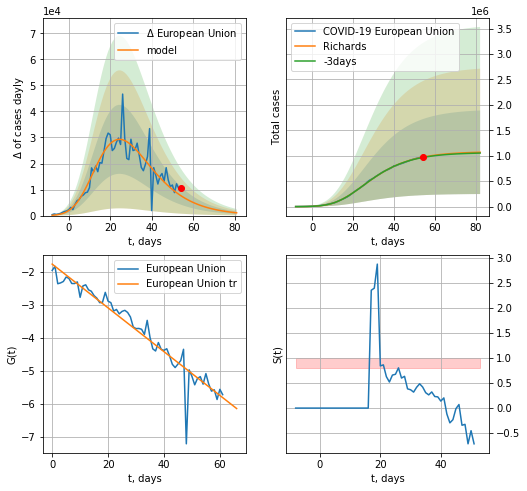

European Union data at: 2020-06-20
+3 day model MAPE: 0.007559
model: Richards
coeffs: [ 1.08235898e+06  8.91256786e-01 -6.99260106e+00  8.61059421e-02]
rational stdev: 0.768581
forecast at the end of period: +28 days
	 deltaDaycases: 1068
	 total cases: 1068858 ± 821504
	 total death: 113452 ± 261591
trend coefficient of determination: 0.920526
 intercept: -1.769267
 slope: -0.066303


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


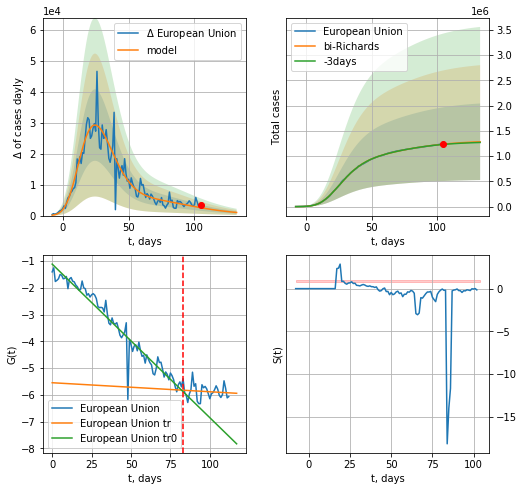

European Union data at: 2020-06-20
+3 day model MAPE: 0.004379
model: bi-Richards
coeffs: [ 2.25879818e+05  4.50989566e+00 -3.24229069e+01  9.16947002e-03]
rational stdev: 0.590398
forecast at the end of period: +28 days
	 deltaDaycases: 1007
	 total cases: 1283117 ± 757549
	 total death: 136194 ± 241225
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.943413
 intercept: -1.112282
 slope: -0.057406
trend coefficient of determination: 0.011356
 intercept: -5.545522
 slope: -0.003372


In [816]:
vL = 83+20
x = forecastRR("European Union",dfEU[20:vL-20],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


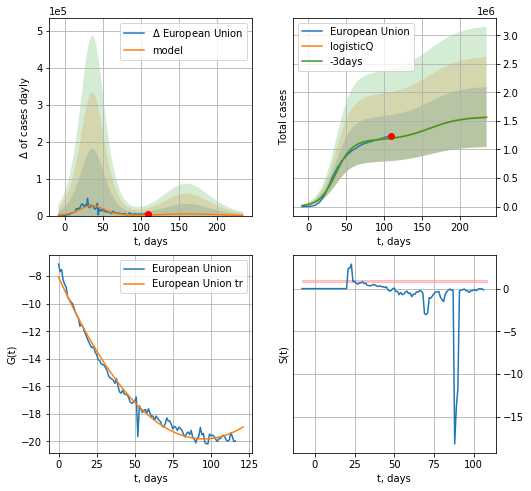

European Union data at: 2020-06-20
+3 day model MAPE: 0.006172
model: logisticQ
coeffs: [ 1.16776376e+06  2.49098889e-07  3.67900808e+01 -3.72943699e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.335024
forecast at the end of period: +126 days
	 deltaDaycases: 568
	 total cases: 1569098 ± 525685
	 total death: 166549 ± 167393
trend coefficient of determination: 0.986948
 intercept_: -8.05826870287411
 coeffs_: [ 0.         -0.24701208  0.00129732]


In [817]:
x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/numpy/lib/function_base.py:1269: RuntimeWarning: invalid value encountered in subtract
  a = op(a[slice1], a[slice2])
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


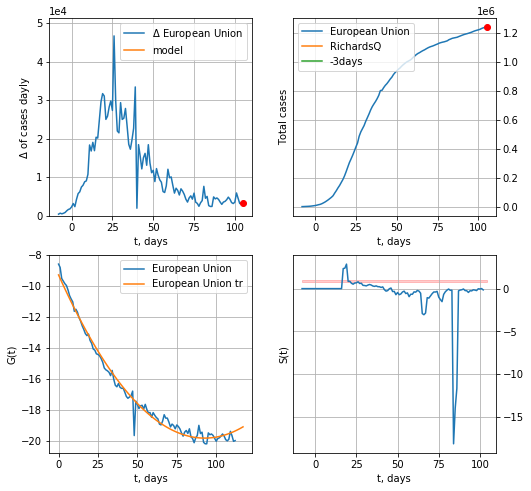

European Union data at: 2020-06-20
+3 day model MAPE: nan
model: RichardsQ
coeffs: [ 7.35726466e+05  5.34496139e+00 -1.42014837e+03  1.20956315e+03
 -2.56287932e+00]
S.Korea scenario coeffs: [ 3.69179628e-01  4.55901153e+01  3.02600169e-01 -6.49668395e+01
  2.33503320e-03]
rational stdev: 0.610351
forecast at the end of period: +14 days


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:115: RuntimeWarning: invalid value encountered in double_scalars


ValueError: cannot convert float NaN to integer

In [818]:
x = forecastQR("European Union",dfEU[20:],d1,14*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [291]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [292]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [293]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [294]:
#dfIC[:]

IC
           date   cases  active  death
107 2020-06-16  1812.0       6   10.0
108 2020-06-17  1815.0       8   10.0
109 2020-06-18  1816.0       5   10.0
110 2020-06-19  1819.0       8   10.0
111 2020-06-20  1822.0       7   10.0


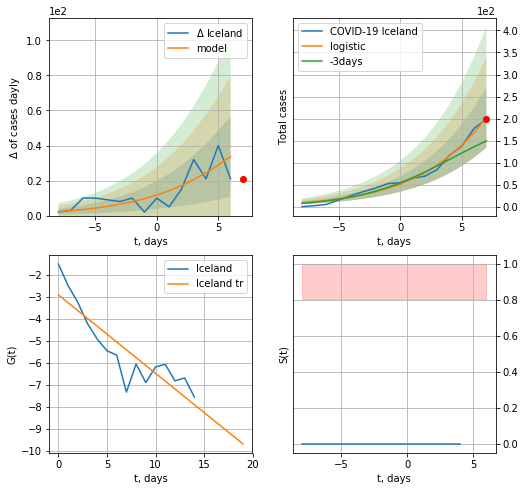

Iceland data at: 2020-06-20
Exception occurs


In [819]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,12*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


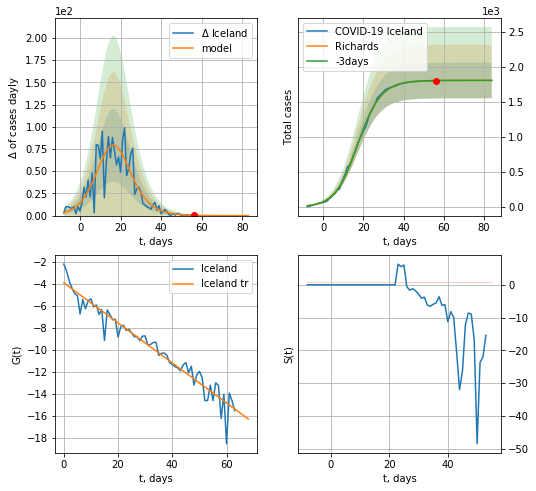

Iceland data at: 2020-06-20
+3 day model MAPE: 0.000574
model: Richards
coeffs: [1.80664071e+03 1.96329707e-01 1.60140797e+01 8.56236679e-01]
rational stdev: 0.141183
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 1806 ± 255
	 total death: 9 ± 3
trend coefficient of determination: 0.937183
 intercept: -3.923109
 slope: -0.181532


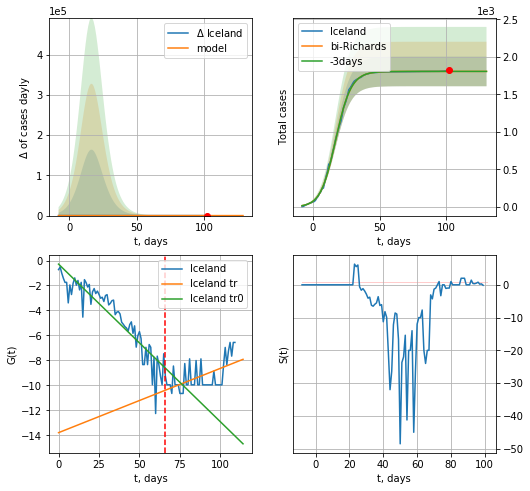

Iceland data at: 2020-06-20
+3 day model MAPE: 0.000000
model: bi-Richards
coeffs: [9.94607524 0.0793011  9.88034407 0.0198369 ]
rational stdev: 0.109509
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 1806 ± 197
	 total death: 9 ± 2
bi-Richards approximation splitting point: 66
trend coefficient of determination: 0.839997
 intercept: -0.288970
 slope: -0.126157
trend coefficient of determination: 0.301424
 intercept: -13.778245
 slope: 0.051478


In [820]:
vL = 66
x = forecastRR("Iceland",dfIC[1:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[1:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


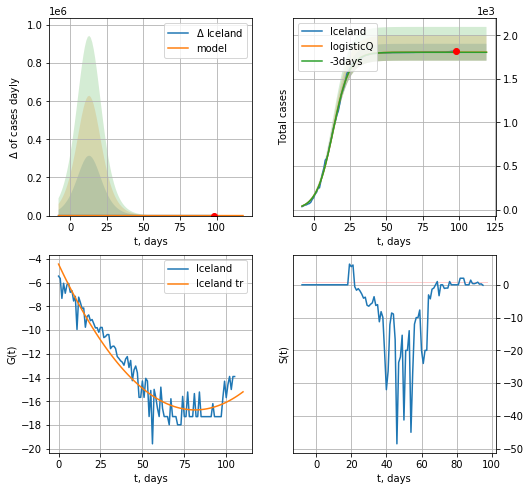

Iceland data at: 2020-06-20
+3 day model MAPE: 0.000383
model: logisticQ
coeffs: [ 1.80492933e+03  6.49657285e-06  1.33466769e+01 -2.71766786e+04]
rational stdev: 0.053638
forecast at the end of period: +21 days
	 deltaDaycases: 0
	 total cases: 1804 ± 96
	 total death: 9 ± 1
trend coefficient of determination: 0.921026
 intercept_: -4.428647454540725
 coeffs_: [ 0.         -0.30242829  0.00185852]


In [821]:
x = forecastRRR("Iceland",dfIC[5:],d1,15*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date  cases   active  death
98  2020-06-16  21962   7731.0  457.0
99  2020-06-17  22597   8353.0  470.0
100 2020-06-18  23351   9094.0  475.0
101 2020-06-19  24274   9430.0  485.0
102 2020-06-20  25222  10370.0  493.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


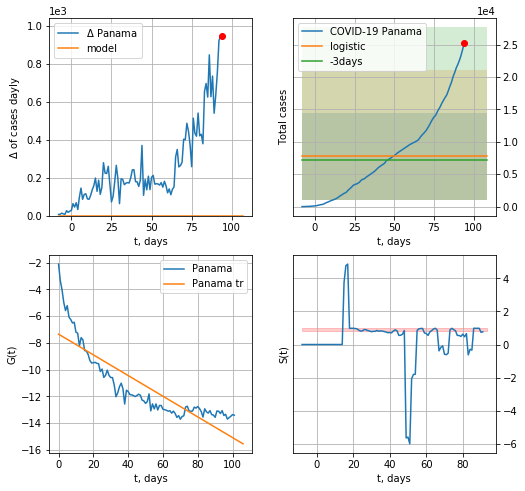

Panama data at: 2020-06-20
+3 day model MAPE: 0.06856341699682451
model: logistic
coeffs:  [ 7.73617475e+03 -6.06658564e+00  1.73026290e+02]
rational stdev:  0.8617360306279934
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  7736 ± 6666
	 total death:  151 ± 390
trend coefficient of determination: 0.746686
 intercept: -7.344230
 slope: -0.077464


In [823]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


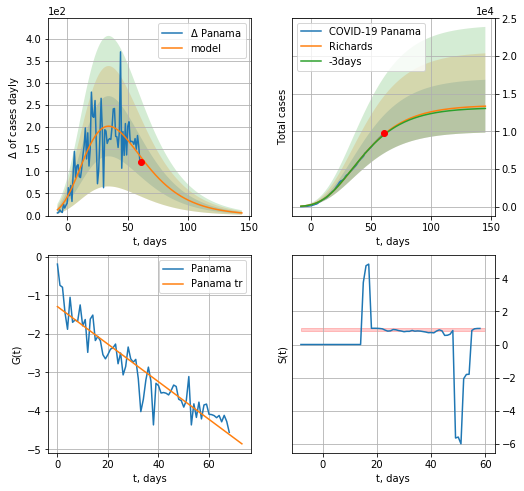

Panama data at: 2020-06-20
+3 day model MAPE: 0.008184
model: Richards
coeffs: [ 1.34885246e+04  2.34173945e+00 -6.38327516e+01  1.75366113e-02]
rational stdev: 0.263123
forecast at the end of period: +84 days
	 deltaDaycases: 6
	 total cases: 13344 ± 3511
	 total death: 260 ± 205
trend coefficient of determination: 0.871686
 intercept: -1.291480
 slope: -0.048815


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


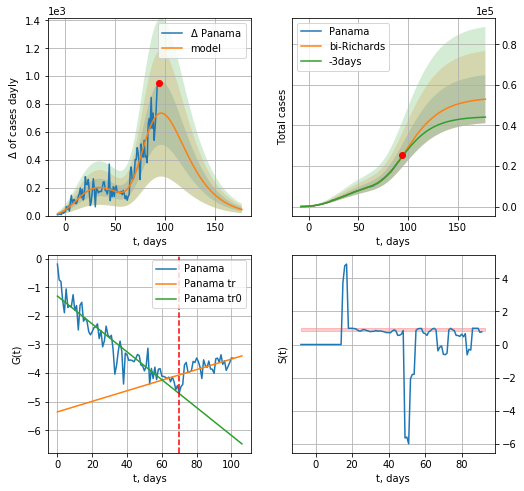

Panama data at: 2020-06-20
+3 day model MAPE: 0.020464
model: bi-Richards
coeffs: [4.04112696e+04 2.38833400e+00 1.45913119e+01 1.97985036e-02]
rational stdev: 0.224153
forecast at the end of period: +84 days
	 deltaDaycases: 44
	 total cases: 52972 ± 11874
	 total death: 1035 ± 695
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.874658
 intercept: -1.309168
 slope: -0.048691
trend coefficient of determination: 0.313105
 intercept: -5.355032
 slope: 0.018454


In [824]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,24*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


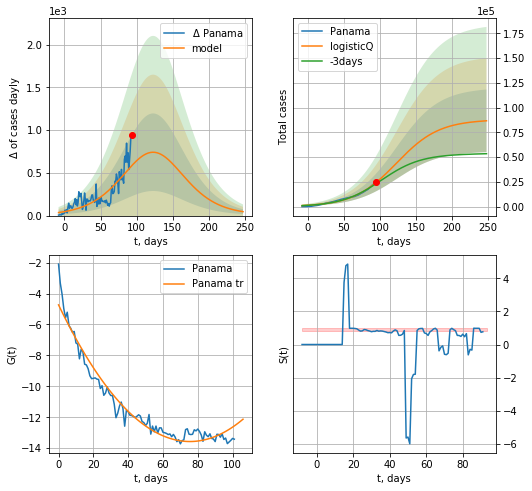

Panama data at: 2020-06-20
+3 day model MAPE: 0.053556
model: logisticQ
coeffs: [ 8.76324862e+04  1.27998041e-06  1.23025048e+02 -2.63150730e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.364684
forecast at the end of period: +154 days
	 deltaDaycases: 46
	 total cases: 86631 ± 31593
	 total death: 1693 ± 1852
trend coefficient of determination: 0.954067
 intercept_: -4.735167380317111
 coeffs_: [ 0.         -0.23401331  0.00155002]


In [825]:
x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

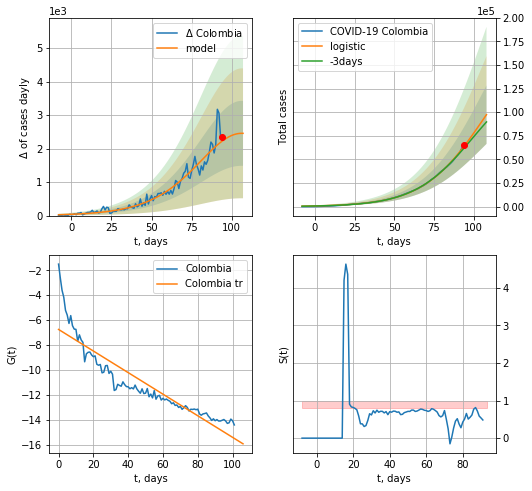

Colombia data at: 2020-06-20
+3 day model MAPE: 0.03405160264702614
model: logistic
coeffs:  [1.88601959e+05 5.20626245e-02 1.06726073e+02]
rational stdev:  0.3178916906632897
forecast at the end of period: +14 days
	 deltaDaycases:  2453
	 total cases:  97427 ± 30971
	 total death:  3155 ± 3008
trend coefficient of determination: 0.831922
 intercept: -6.749804
 slope: -0.086658


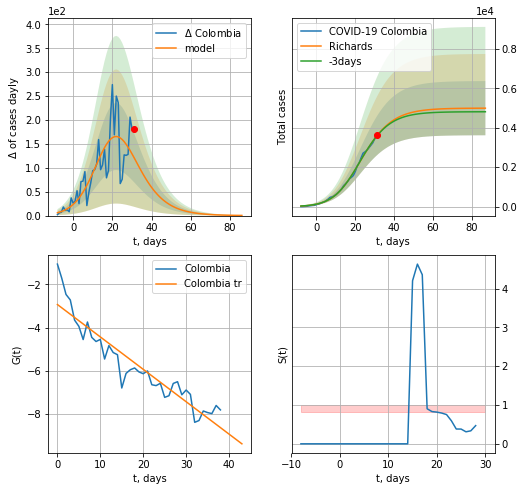

Colombia data at: 2020-06-20
+3 day model MAPE: 0.003507
model: Richards
coeffs: [4.99315067e+03 1.95979830e-01 1.78374870e+01 5.90307623e-01]
rational stdev: 0.275146
forecast at the end of period: +56 days
	 deltaDaycases: 0
	 total cases: 4990 ± 1373
	 total death: 161 ± 132
trend coefficient of determination: 0.874880
 intercept: -2.931794
 slope: -0.150492


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


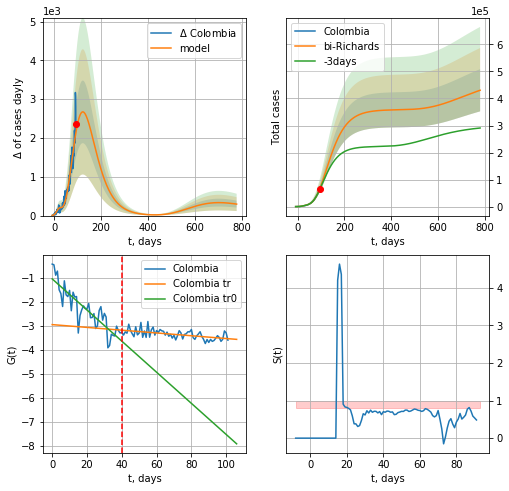

Colombia data at: 2020-06-20
+3 day model MAPE: 0.036285
model: bi-Richards
coeffs: [ 3.53694932e+05  8.39206300e-01 -5.46705147e+01  2.47806510e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.181498
forecast at the end of period: +686 days
	 deltaDaycases: 295
	 total cases: 430422 ± 78120
	 total death: 13942 ± 7591
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.751452
 intercept: -1.047572
 slope: -0.064840
trend coefficient of determination: 0.290336
 intercept: -2.953625
 slope: -0.005797


In [827]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,14*7-dT)
x = forecastRR("Colombia",dfCB[:40],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,110*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=40)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


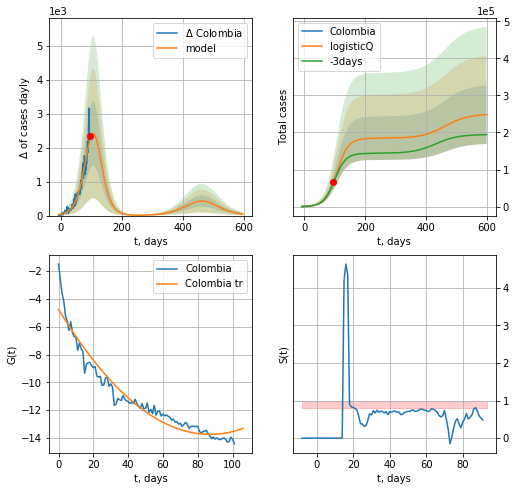

Colombia data at: 2020-06-20
+3 day model MAPE: 0.034494
model: logisticQ
coeffs: [ 1.84414164e+05  4.78699576e-06  1.05959738e+02 -1.08869237e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.318347
forecast at the end of period: +504 days
	 deltaDaycases: 45
	 total cases: 247957 ± 78936
	 total death: 8031 ± 7669
trend coefficient of determination: 0.939672
 intercept_: -4.756722077635518
 coeffs_: [ 0.         -0.20624748  0.00118408]


In [828]:
x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases  active  death
104 2020-06-16  11147.0  2517.0  788.0
105 2020-06-17  11268.0  2526.0  799.0
106 2020-06-18  11385.0  2496.0  811.0
107 2020-06-19  11504.0  2483.0  825.0
108 2020-06-20  11631.0  2470.0  837.0


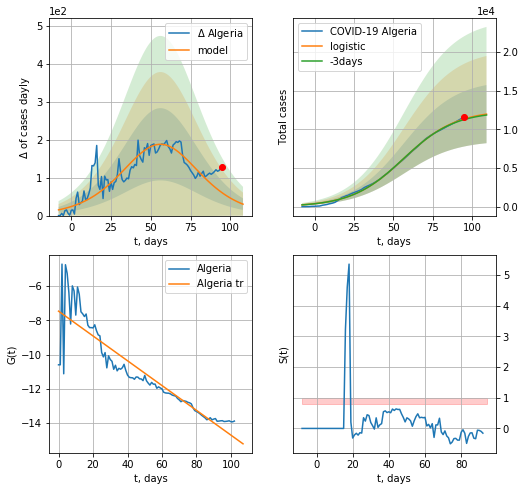

Algeria data at: 2020-06-20
+3 day model MAPE: 0.00767452798547855
model: logistic
coeffs:  [1.24737035e+04 6.03277671e-02 5.65643050e+01]
rational stdev:  0.3138295017565706
forecast at the end of period: +14 days
	 deltaDaycases:  30
	 total cases:  11967 ± 3755
	 total death:  861 ± 810
trend coefficient of determination: 0.829430
 intercept: -7.470733
 slope: -0.072287


In [830]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,14*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


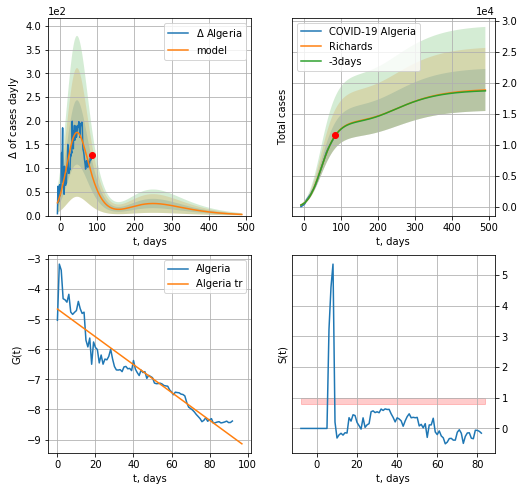

Algeria data at: 2020-06-20
+3 day model MAPE: 0.002027
model: Richards
coeffs: [1.40000057e+04 9.89991805e-02 2.38325040e+01 4.13026351e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.179415
forecast at the end of period: +406 days
	 deltaDaycases: 2
	 total cases: 18897 ± 3390
	 total death: 1359 ± 731
trend coefficient of determination: 0.907590
 intercept: -4.659887
 slope: -0.046207


In [831]:
x = forecastRR("Algeria",dfAR[15:],d1,70*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


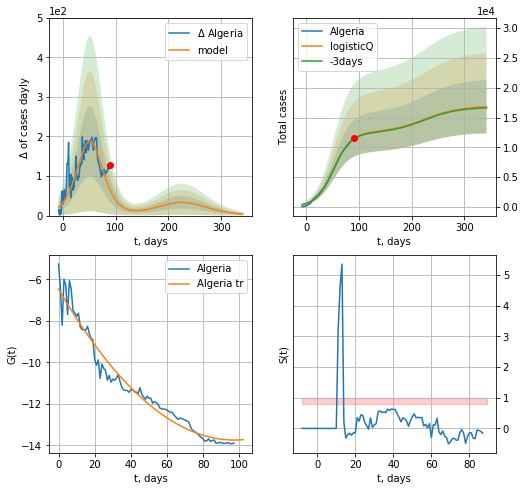

Algeria data at: 2020-06-20
+3 day model MAPE: 0.007319
model: logisticQ
coeffs: [ 1.25095050e+04  9.61224013e-07  5.16837729e+01 -6.22912076e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.265739
forecast at the end of period: +252 days
	 deltaDaycases: 3
	 total cases: 16812 ± 4467
	 total death: 1209 ± 963
trend coefficient of determination: 0.960493
 intercept_: -6.475920219485421
 coeffs_: [ 0.         -0.1493902   0.00076806]


In [832]:
x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

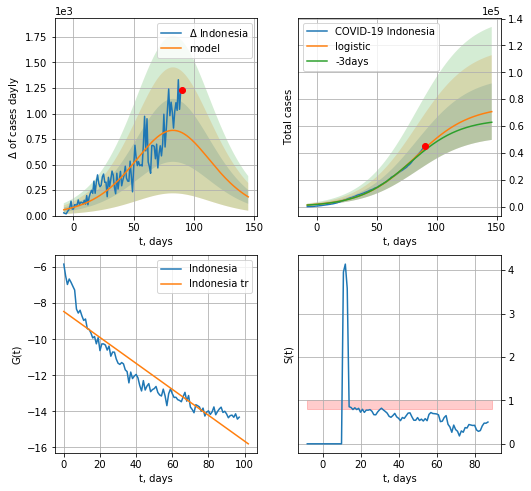

Indonesia data at: 2020-06-20
+3 day model MAPE: 0.034090807410249474
model: logistic
coeffs:  [7.50015760e+04 4.45423107e-02 8.30330584e+01]
rational stdev:  0.29707953899220907
forecast at the end of period: +56 days
	 deltaDaycases:  183
	 total cases:  70721 ± 21009
	 total death:  3814 ± 3399
trend coefficient of determination: 0.866180
 intercept: -8.460683
 slope: -0.071917


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


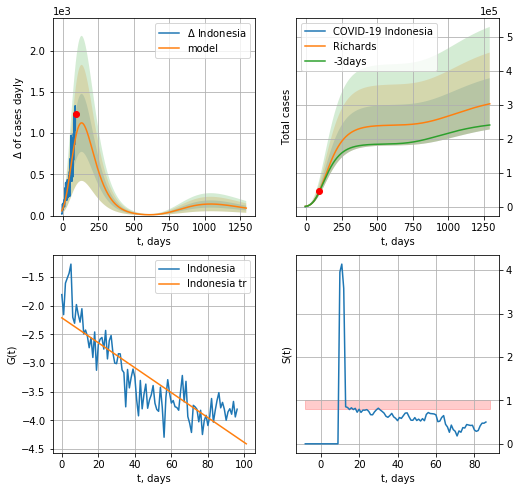

Indonesia data at: 2020-06-20
+3 day model MAPE: 0.021432
model: Richards
coeffs: [ 2.40767615e+05  6.82284387e-01 -1.78477580e+02  1.87653646e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.249304
forecast at the end of period: +1204 days
	 deltaDaycases: 90
	 total cases: 303404 ± 75639
	 total death: 16366 ± 12240
trend coefficient of determination: 0.750099
 intercept: -2.211952
 slope: -0.021751


In [833]:
x = forecast("Indonesia",dfIE[5:],d1,20*7-dT)
x = forecastRR("Indonesia",dfIE[6:],d1,184*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


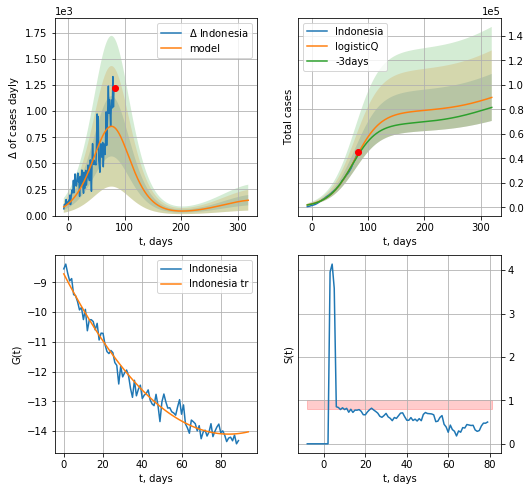

Indonesia data at: 2020-06-20
+3 day model MAPE: 0.031245
model: logisticQ
coeffs: [ 7.80140911e+04  4.58575035e-06  7.67928199e+01 -9.45789120e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.214130
forecast at the end of period: +238 days
	 deltaDaycases: 146
	 total cases: 89625 ± 19191
	 total death: 4834 ± 3105
trend coefficient of determination: 0.977813
 intercept_: -8.717607492904655
 coeffs_: [ 0.         -0.12811859  0.0007623 ]


In [834]:
x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


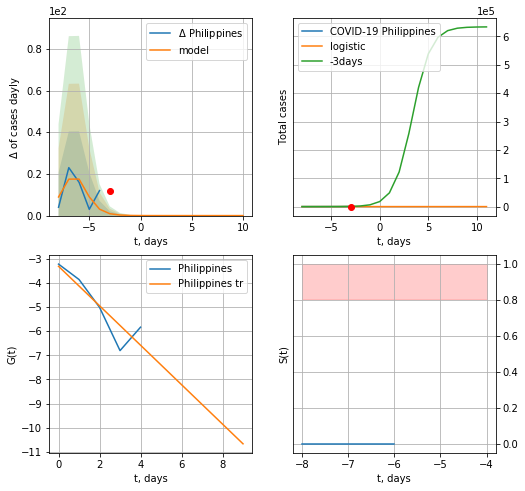

Philippines data at: 2020-06-20
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  2 ± 1
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


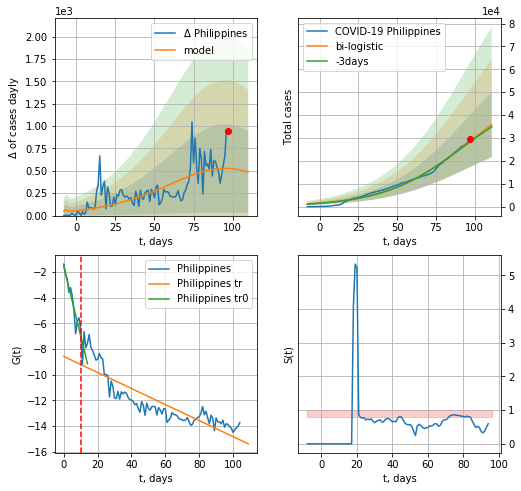

Philippines data at: 2020-06-20
+3 day model MAPE: 0.014466806018077944
model: bi-logistic
coeffs:  [5.57282114e+04 3.78233011e-02 9.56112213e+01] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.3975093693292187
forecast at the end of period: +14 days
	 deltaDaycases:  487
	 total cases:  35813 ± 14236
	 total death:  1400 ± 1669
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.753456
 intercept: -8.581371
 slope: -0.062443


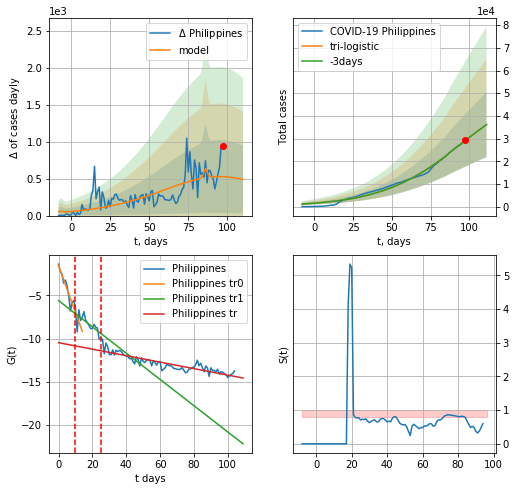

Philippines data at: 2020-06-20
+3 day model MAPE: 0.001342088970752074
model: tri-logistic
coeffs:  [354.03606679   1.48801919  86.50383367] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  5.57282114e+04
  3.78233011e-02  9.56112213e+01]
forecast rational stdev:  0.3969215352894795
forecast at the end of period: +14 days
	 deltaDaycases:  487
	 total cases:  36167 ± 14355
	 total death:  1414 ± 1683
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.777563
 intercept: -10.466543
 slope: -0.037461


In [836]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,14*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,14*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,14*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


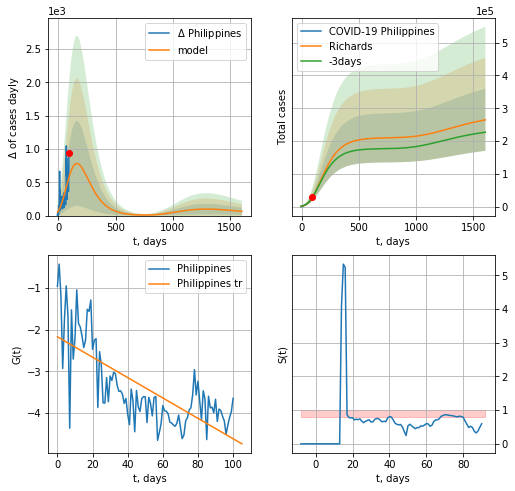

Philippines data at: 2020-06-20
+3 day model MAPE: 0.010827
model: Richards
coeffs: [ 2.10213971e+05  5.23403974e-01 -2.22818326e+02  1.95267300e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.357198
forecast at the end of period: +1512 days
	 deltaDaycases: 64
	 total cases: 264597 ± 94513
	 total death: 10349 ± 11089
trend coefficient of determination: 0.533291
 intercept: -2.170793
 slope: -0.024400


In [837]:
x = forecastRR("Philippines",dfPH[4:],d1,228*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


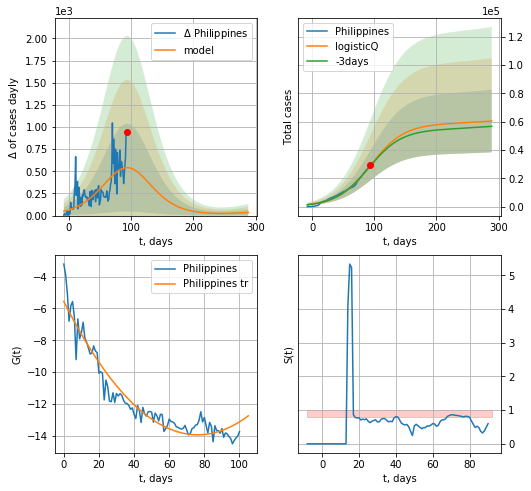

Philippines data at: 2020-06-20
+3 day model MAPE: 0.012433
model: logisticQ
coeffs: [ 5.85047299e+04  8.20380904e-07  9.39623326e+01 -4.49160907e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.366224
forecast at the end of period: +196 days
	 deltaDaycases: 34
	 total cases: 60464 ± 22143
	 total death: 2365 ± 2598
trend coefficient of determination: 0.924329
 intercept_: -5.560828853816815
 coeffs_: [ 0.         -0.21971976  0.00144104]


In [838]:
x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
           date   cases  active  death
108 2020-06-16  3148.0    1589  185.0
109 2020-06-17  3203.0    1642  187.0
110 2020-06-18  3227.0    1665  188.0
111 2020-06-19  3237.0    1674  189.0
112 2020-06-20  3256.0    1692  190.0


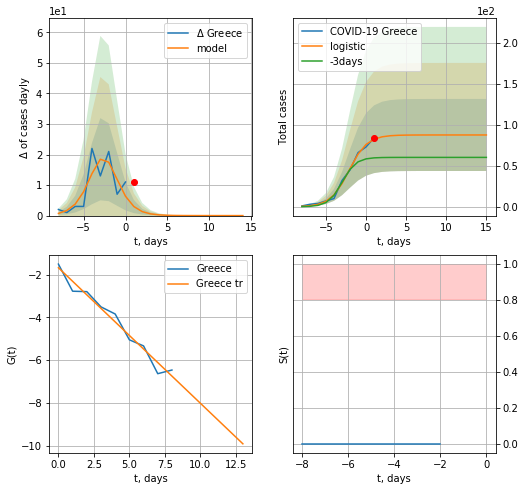

Greece data at: 2020-06-20
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  5 ± 7
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


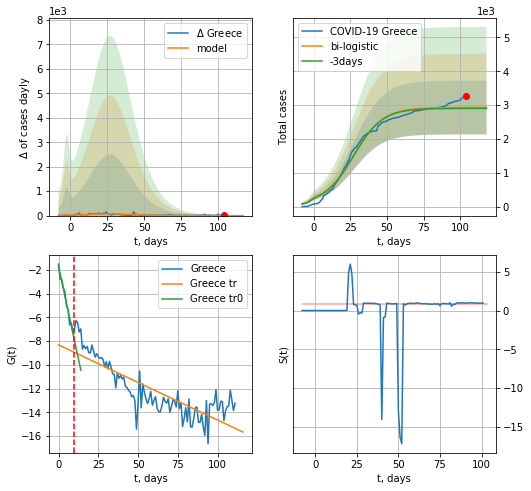

Greece data at: 2020-06-20
+3 day model MAPE: 0.009486966306512275
model: bi-logistic
coeffs:  [2.84277291e+03 9.93721984e-02 2.74072253e+01] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.2708758089385733
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  2929 ± 793
	 total death:  170 ± 138
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.682630
 intercept: -8.313484
 slope: -0.063423


In [840]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,14*7-dT)
xx = forecast2("Greece",dfGC[:],d1,14*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


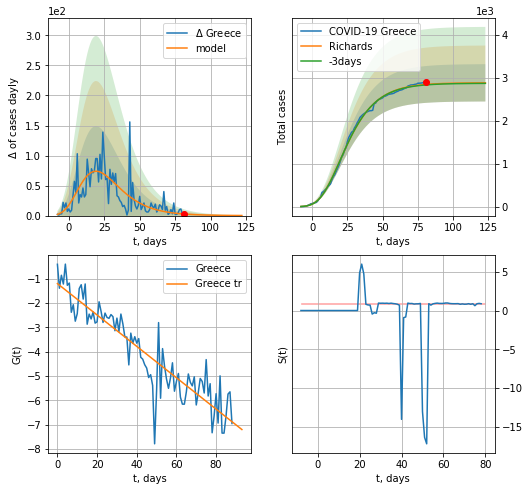

Greece data at: 2020-06-20
+3 day model MAPE: 0.003716
model: Richards
coeffs: [ 2.88621480e+03  7.21651977e+00 -4.66145013e+01  9.69412199e-03]
rational stdev: 0.150576
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 2884 ± 434
	 total death: 168 ± 75
trend coefficient of determination: 0.832984
 intercept: -1.208411
 slope: -0.064431


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


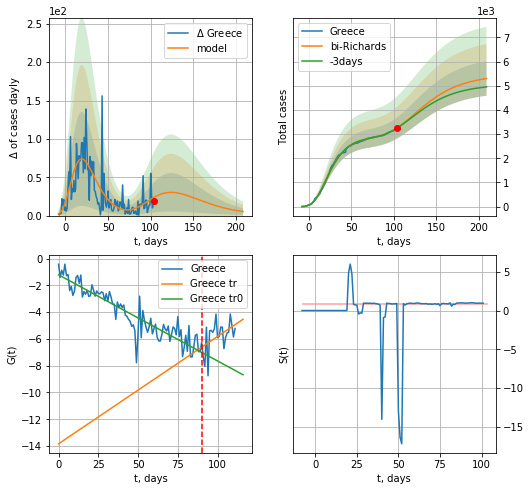

Greece data at: 2020-06-20
+3 day model MAPE: 0.002655
model: bi-Richards
coeffs: [ 2.58066252e+03  3.58890774e+00 -2.34115080e+01  8.89091347e-03]
rational stdev: 0.134332
forecast at the end of period: +105 days
	 deltaDaycases: 5
	 total cases: 5298 ± 711
	 total death: 309 ± 124
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.837513
 intercept: -1.204355
 slope: -0.064400
trend coefficient of determination: 0.218259
 intercept: -13.836632
 slope: 0.080258


In [841]:
vL = 90
x = forecastRR("Greece",dfGC[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[:],d1,27*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


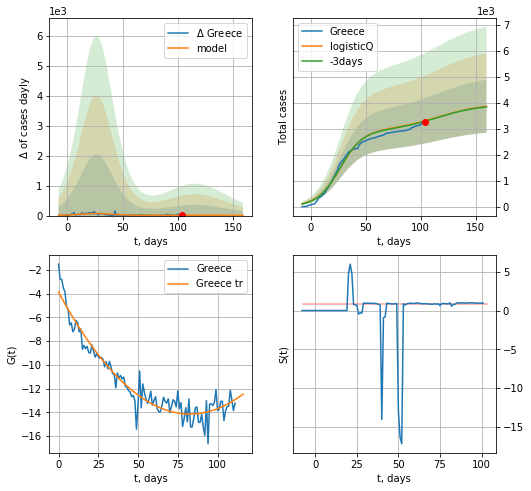

Greece data at: 2020-06-20
+3 day model MAPE: 0.005260
model: logisticQ
coeffs: [ 2.93654520e+03  2.32492516e-07  2.67058173e+01 -4.10678016e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.263577
forecast at the end of period: +56 days
	 deltaDaycases: 4
	 total cases: 3862 ± 1018
	 total death: 225 ± 177
trend coefficient of determination: 0.923027
 intercept_: -3.8735058369509385
 coeffs_: [ 0.         -0.24879032  0.00150598]


In [842]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
           date  cases  active  death
102 2020-06-16   4077     994  567.0
103 2020-06-17   4078     964  567.0
104 2020-06-18   4079     947  568.0
105 2020-06-19   4081     932  568.0
106 2020-06-20   4094     935  570.0


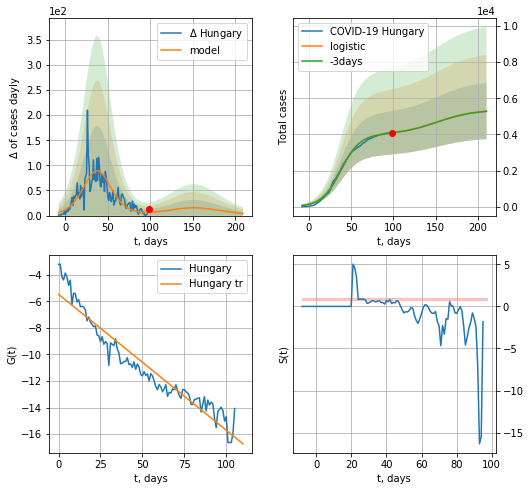

Hungary data at: 2020-06-20
+3 day model MAPE: 0.004085721163408957
model: logistic
coeffs:  [3.99204679e+03 8.89773882e-02 3.78699534e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.29333908910114526
forecast at the end of period: +112 days
	 deltaDaycases:  4
	 total cases:  5292 ± 1552
	 total death:  736 ± 647
trend coefficient of determination: 0.921998
 intercept: -5.470929
 slope: -0.102284


In [843]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


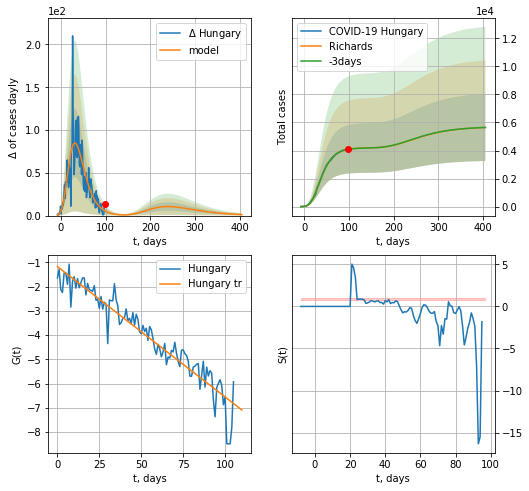

Hungary data at: 2020-06-20
+3 day model MAPE: 0.000334
model: Richards
coeffs: [ 4.18815839e+03  2.65012550e+00 -3.78567019e+01  2.09887913e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.423505
forecast at the end of period: +308 days
	 deltaDaycases: 1
	 total cases: 5643 ± 2389
	 total death: 785 ± 997
trend coefficient of determination: 0.903577
 intercept: -1.177347
 slope: -0.053785


In [844]:
x = forecastRR("Hungary",dfHG[:],d1,56*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


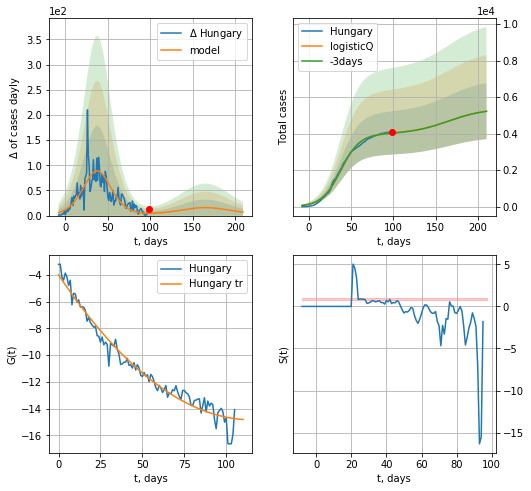

Hungary data at: 2020-06-20
+3 day model MAPE: 0.004204
model: logisticQ
coeffs: [ 3.99195944e+03  4.13083170e-07  3.78702641e+01 -2.15310971e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.293434
forecast at the end of period: +112 days
	 deltaDaycases: 6
	 total cases: 5238 ± 1537
	 total death: 729 ± 641
trend coefficient of determination: 0.964917
 intercept_: -4.003758570431726
 coeffs_: [ 0.         -0.18693192  0.00080619]


In [845]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


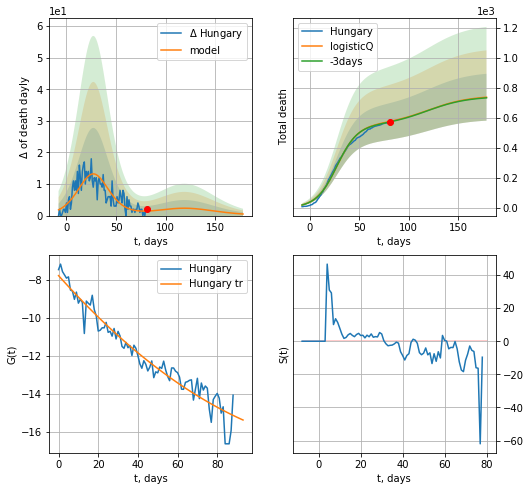

Hungary data at: 2020-06-20
+3 day model MAPE: 0.005479
model: logisticQ
coeffs: [ 5.53331398e+02  5.36457483e-07  2.74420254e+01 -1.76523754e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.211950
forecast at the end of period: +98 days
	 total death: 738 ± 156
trend coefficient of determination: 0.938616
 intercept_: -7.783054732041301
 coeffs_: [ 0.         -0.11637335  0.00037347]


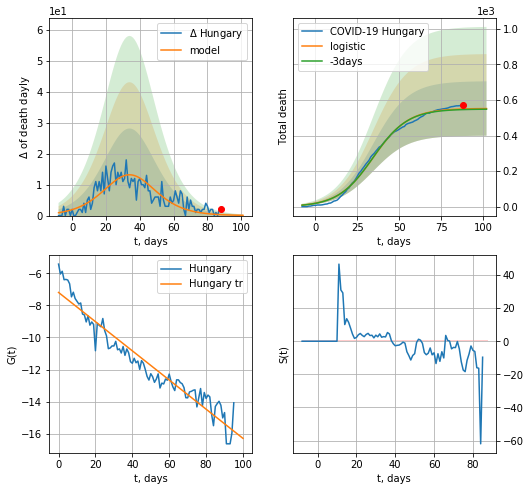

Hungary data at: 2020-06-20
+3 day model MAPE: 0.006404329545305812
model: logistic
coeffs:  [5.52680640e+02 9.54475660e-02 3.44157017e+01]
rational stdev:  0.2769554079821341
forecast at the end of period: +14 days
	 total death:  551 ± 152
trend coefficient of determination: 0.927432
 intercept: -7.192956
 slope: -0.090962


In [847]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,14*7-dT,cases='death')

MT
           date  cases  active  death
100 2020-06-16  656.0      39    9.0
101 2020-06-17  662.0      43    9.0
102 2020-06-18  663.0      44    9.0
103 2020-06-19  663.5      41    9.0
104 2020-06-20  664.0      39    9.0


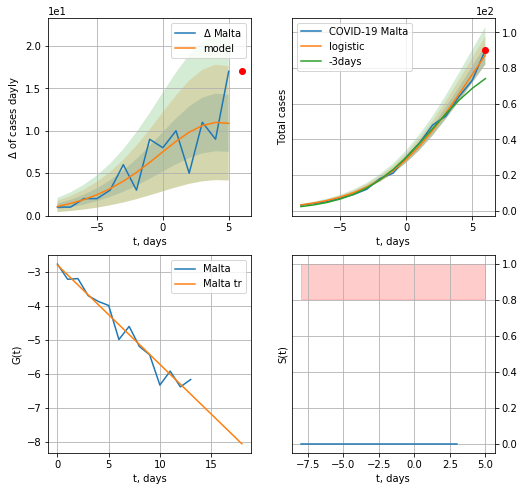

Malta data at: 2020-06-20
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +0 days
	 deltaDaycases:  10
	 total cases:  87 ± 5
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


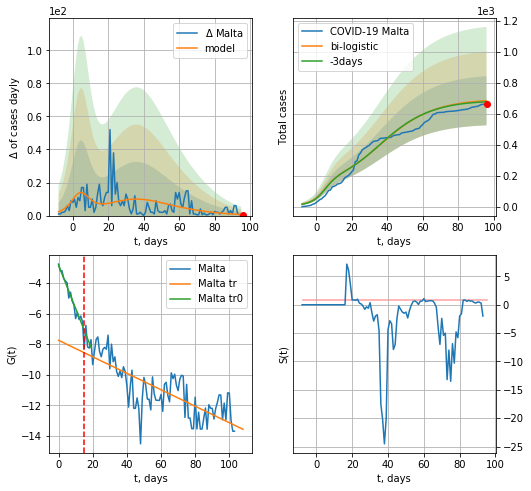

Malta data at: 2020-06-20
Exception occurs


In [849]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    x = forecast("Malta",dfMT[:15],d1,7*12-dT,pMAPE=False)
    xx = forecast2("Malta",dfMT[:],d1,7*12-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


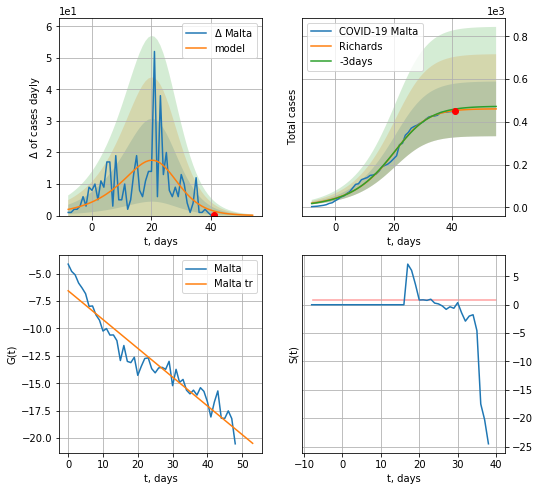

Malta data at: 2020-06-20
+3 day model MAPE: 0.016229
model: Richards
coeffs: [4.60753453e+02 9.94315746e-02 2.41437164e+01 1.98427317e+00]
rational stdev: 0.277865
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 460 ± 127
	 total death: 6 ± 5
trend coefficient of determination: 0.914701
 intercept: -6.567936
 slope: -0.262394


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


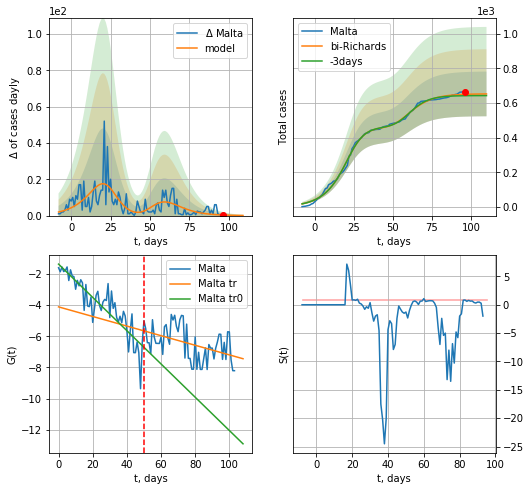

Malta data at: 2020-06-20
+3 day model MAPE: 0.012733
model: bi-Richards
coeffs: [1.91868817e+02 7.27477683e-01 4.35411647e+01 1.56961428e-01]
rational stdev: 0.197406
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 652 ± 128
	 total death: 8 ± 4
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.783126
 intercept: -1.370430
 slope: -0.106799
trend coefficient of determination: 0.195561
 intercept: -4.115044
 slope: -0.030811


In [851]:
vL = 50
x = forecastRR("Malta",dfMT[:vL],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,14*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


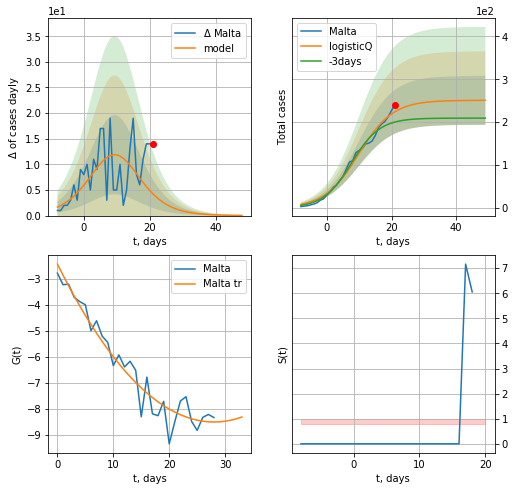

Malta data at: 2020-06-20
+3 day model MAPE: 0.130140
model: logisticQ
coeffs: [ 2.50920068e+02  3.54275509e-06  9.84690922e+00 -5.35768463e+04]
rational stdev: 0.227624
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 250 ± 57
	 total death: 3 ± 2
trend coefficient of determination: 0.935484
 intercept_: -2.4264251666881744
 coeffs_: [ 0.         -0.43368994  0.00773877]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


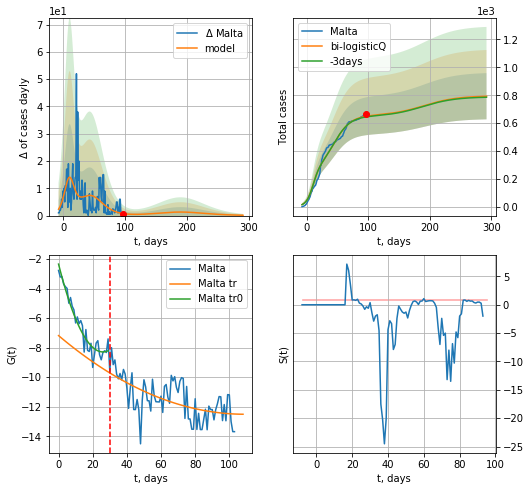

Malta data at: 2020-06-20
+3 day model MAPE: 0.007062
model: bi-logisticQ
coeffs: [ 4.02892815e+02  2.05326655e-07  4.36335227e+01 -3.53358750e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.208597
forecast at the end of period: +196 days
	 deltaDaycases: 0
	 total cases: 793 ± 165
	 total death: 10 ± 6
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.928360
 intercept_: -2.3445378489560733
 coeffs_: [ 0.         -0.45826686  0.00882824]
trend coefficient of determination: 0.379856
 intercept_: -7.184930955084123
 coeffs_: [ 0.         -0.09770206  0.00044813]


In [852]:
x = forecastRRR("Malta",dfMT[:30],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
           date   cases  active  death
98  2020-06-16  1552.5    96.0   28.0
99  2020-06-17  1561.0    96.0   28.0
100 2020-06-18  1562.0    91.0   28.0
101 2020-06-19  1576.0   101.0   28.0
102 2020-06-20  1587.0   112.0   28.0


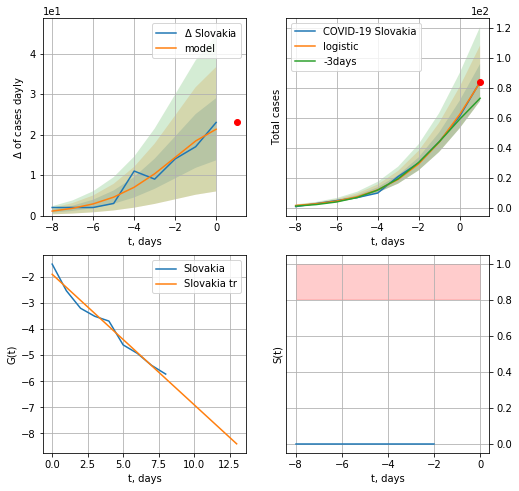

Slovakia data at: 2020-06-20
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +0 days
	 deltaDaycases:  21
	 total cases:  83 ± 12
	 total death:  1 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


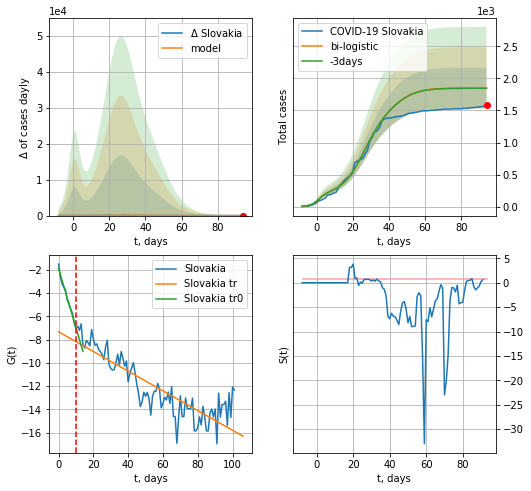

Slovakia data at: 2020-06-20
Exception ocurs


In [853]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,12*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


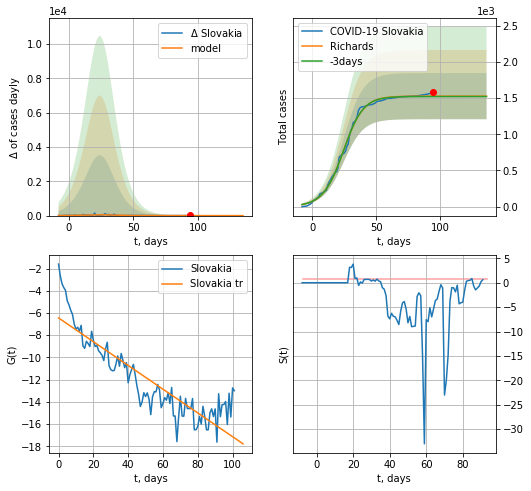

Slovakia data at: 2020-06-20
+3 day model MAPE: 0.003172
model: Richards
coeffs: [1.52595254e+03 1.19866279e-01 2.50776921e+01 1.08983230e+00]
rational stdev: 0.208771
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 1525 ± 318
	 total death: 26 ± 16
trend coefficient of determination: 0.786458
 intercept: -6.448668
 slope: -0.106901


In [854]:
x = forecastRR("Slovakia",dfSL[:],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


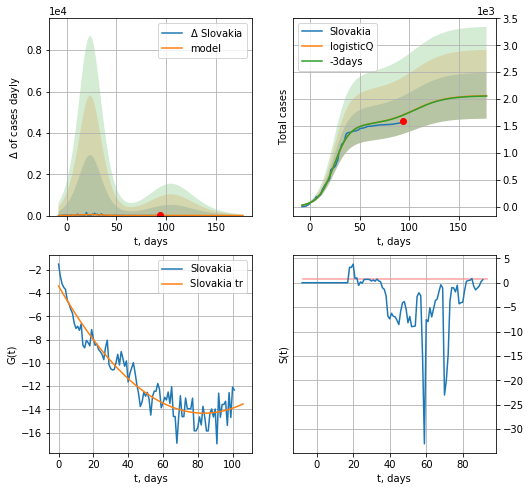

Slovakia data at: 2020-06-20
+3 day model MAPE: 0.002431
model: logisticQ
coeffs: [ 1.52751087e+03  9.53846254e-06  2.41031508e+01 -1.32203422e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.206684
forecast at the end of period: +84 days
	 deltaDaycases: 0
	 total cases: 2063 ± 426
	 total death: 36 ± 22
trend coefficient of determination: 0.913275
 intercept_: -3.3866065370154335
 coeffs_: [ 0.         -0.26217661  0.00156968]


In [855]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
           date   cases  active  death
103 2020-06-16  1499.0    31.0  109.0
104 2020-06-17  1503.0    35.0  109.0
105 2020-06-18  1511.0    43.0  109.0
106 2020-06-19  1513.0    45.0  109.0
107 2020-06-20  1519.0    51.0  109.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


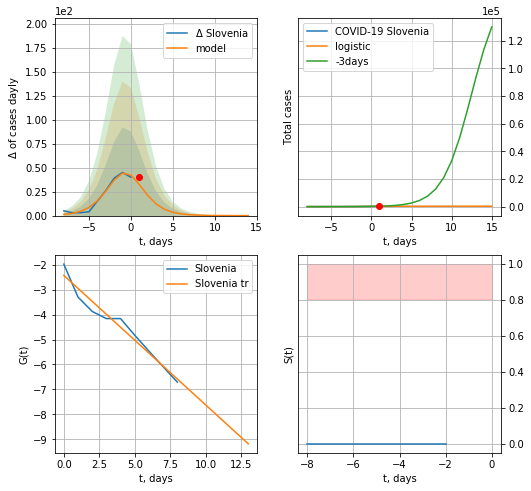

Slovenia data at: 2020-06-20
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  261 ± 138
	 total death:  18 ± 28
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


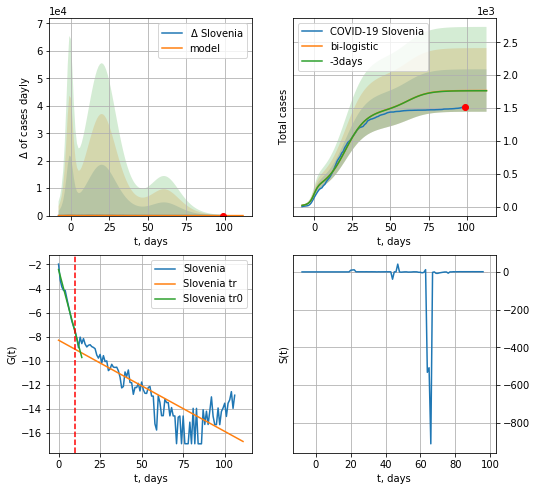

Slovenia data at: 2020-06-20
+3 day model MAPE: 0.0020942062163789533
model: bi-logistic
coeffs:  [1.20458978e+03 1.45449246e-01 2.05338390e+01] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.18256093635699513
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  1766 ± 322
	 total death:  126 ± 69
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.701548
 intercept: -8.289720
 slope: -0.075744


In [857]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*14-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


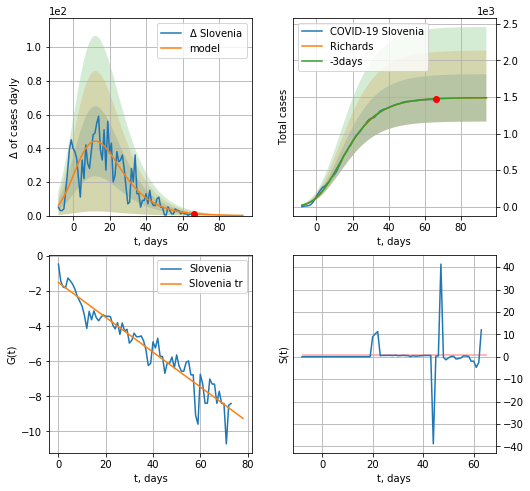

Slovenia data at: 2020-06-20
+3 day model MAPE: 0.001211
model: Richards
coeffs: [ 1.48860897e+03  5.69202399e-01 -8.90072420e+00  1.52510532e-01]
rational stdev: 0.217393
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 1487 ± 323
	 total death: 106 ± 69
trend coefficient of determination: 0.915958
 intercept: -1.505070
 slope: -0.099296


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


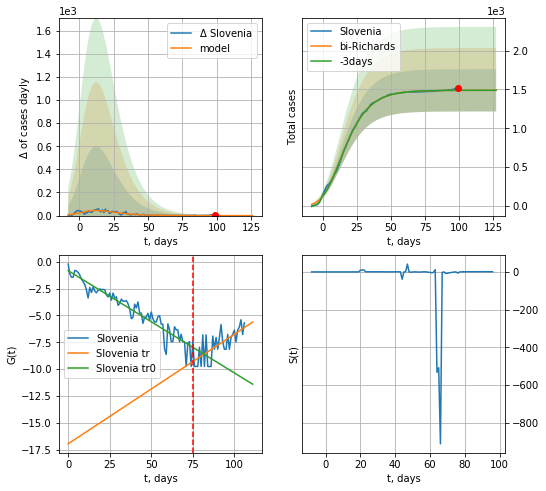

Slovenia data at: 2020-06-20
+3 day model MAPE: 0.000000
model: bi-Richards
coeffs: [1.38193515e+02 2.34675200e-02 9.63438172e+00 2.12663917e-02]
rational stdev: 0.182697
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 1488 ± 271
	 total death: 106 ± 58
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.904642
 intercept: -0.828947
 slope: -0.095239
trend coefficient of determination: 0.474823
 intercept: -16.952946
 slope: 0.102085


In [858]:
vL = 75
x = forecastRR("Slovenia",dfSV[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


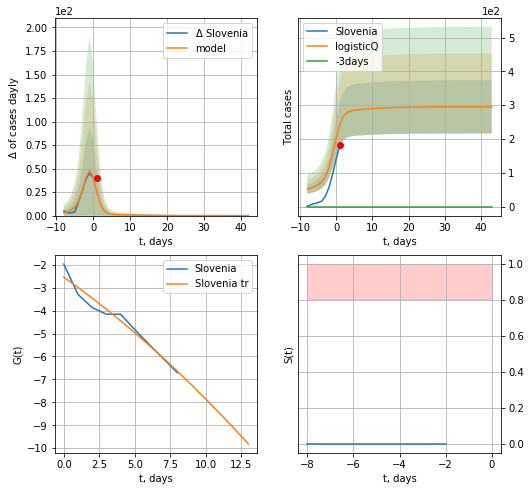

Slovenia data at: 2020-06-20
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 295 ± 78
	 total death: 21 ± 16
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:234: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


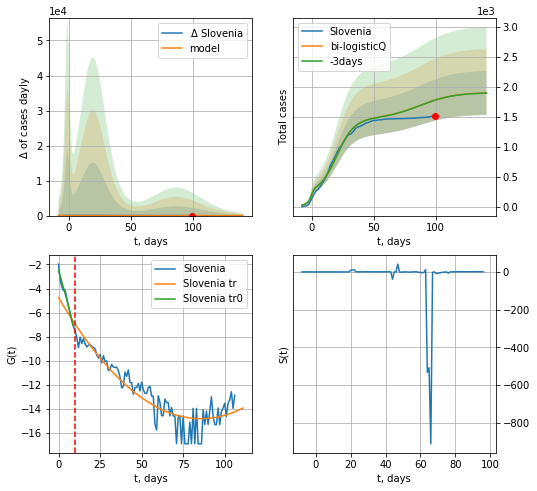

Slovenia data at: 2020-06-20
+3 day model MAPE: 0.000924
model: bi-logisticQ
coeffs: [ 1.24814157e+03  5.61392333e-07  1.99520498e+01 -2.52230060e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.193253
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 1898 ± 366
	 total death: 136 ± 78
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.845779
 intercept_: -4.752766541216764
 coeffs_: [ 0.         -0.23477428  0.00137098]


In [859]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases  active  death
98  2020-06-16  12426   659.0  256.0
99  2020-06-17  12522   754.0  257.0
100 2020-06-18  12616   847.0  258.0
101 2020-06-19  12709   939.0  259.0
102 2020-06-20  12803  1032.0  260.0


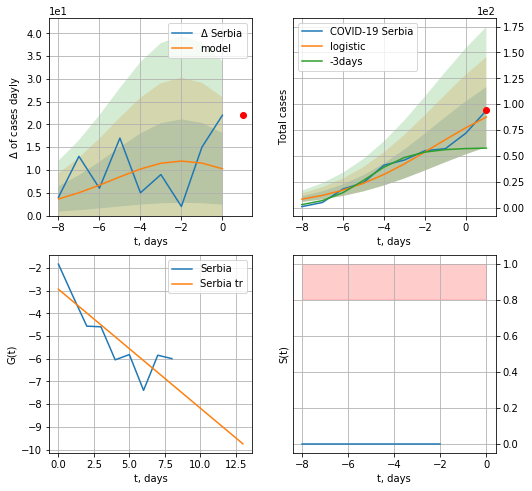

Serbia data at: 2020-06-20
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +0 days
	 deltaDaycases:  10
	 total cases:  87 ± 29
	 total death:  1 ± 0
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


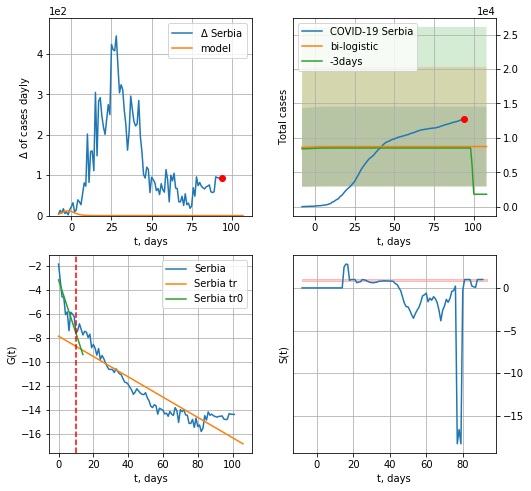

Serbia data at: 2020-06-20
+3 day model MAPE: 0.025062548534170146
model: bi-logistic
coeffs:  [ 6.89331331e+03 -1.75936157e+00  1.17345721e+02] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.6638678336116416
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  8736 ± 5799
	 total death:  177 ± 352
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.835478
 intercept: -7.843870
 slope: -0.084713


In [860]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,12*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


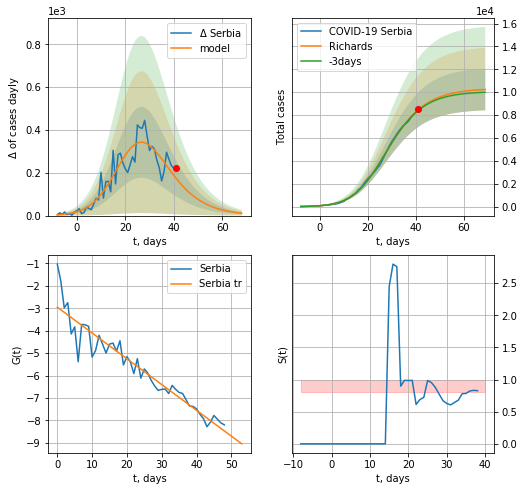

Serbia data at: 2020-06-20
+3 day model MAPE: 0.007628
model: Richards
coeffs: [1.03310156e+04 2.23147111e-01 2.10152369e+01 5.03005273e-01]
rational stdev: 0.178090
forecast at the end of period: +28 days
	 deltaDaycases: 11
	 total cases: 10237 ± 1823
	 total death: 207 ± 110
trend coefficient of determination: 0.905867
 intercept: -2.952078
 slope: -0.114857


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


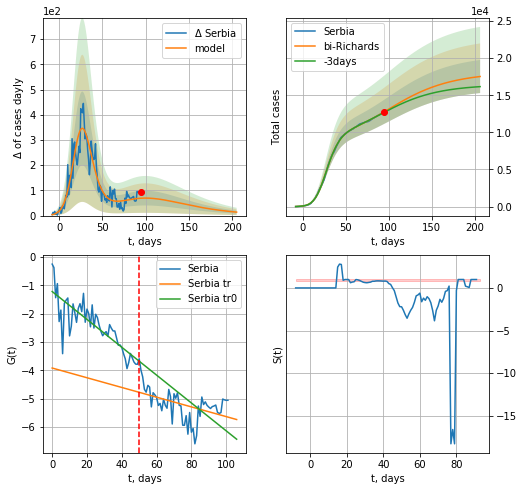

Serbia data at: 2020-06-20
+3 day model MAPE: 0.006190
model: bi-Richards
coeffs: [ 7.77324905e+03  1.62590591e+00 -7.14451852e+01  1.49785503e-02]
rational stdev: 0.127105
forecast at the end of period: +112 days
	 deltaDaycases: 13
	 total cases: 17523 ± 2227
	 total death: 355 ± 135
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.685141
 intercept: -1.215713
 slope: -0.049196
trend coefficient of determination: 0.216576
 intercept: -3.917069
 slope: -0.017157


In [861]:
vL=50
x = forecastRR("Serbia",dfSB[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


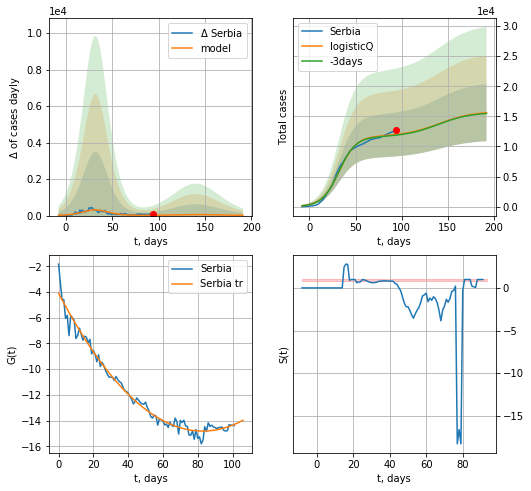

Serbia data at: 2020-06-20
+3 day model MAPE: 0.010302
model: logisticQ
coeffs: [ 1.17075352e+04  3.72732535e-07  3.22152442e+01 -2.89478352e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.304201
forecast at the end of period: +98 days
	 deltaDaycases: 12
	 total cases: 15616 ± 4750
	 total death: 317 ± 289
trend coefficient of determination: 0.979674
 intercept_: -4.08699075656446
 coeffs_: [ 0.         -0.25890769  0.00156308]


In [862]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
           date   cases  active  death
108 2020-06-16  2255.0     8.0  107.0
109 2020-06-17  2258.0    10.0  107.0
110 2020-06-18  2269.0    20.0  107.0
111 2020-06-19  2280.0    31.0  107.0
112 2020-06-20  2299.0    50.0  107.0


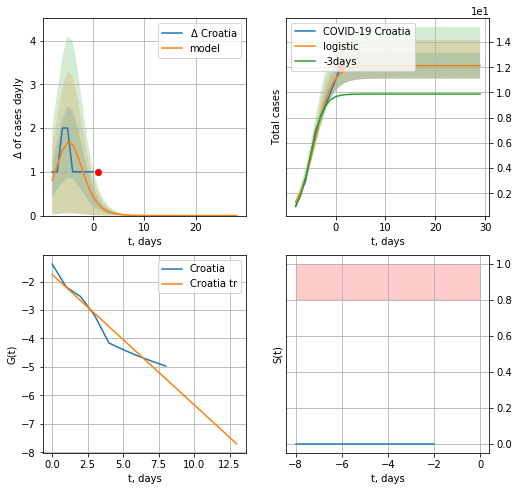

Croatia data at: 2020-06-20
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +28 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


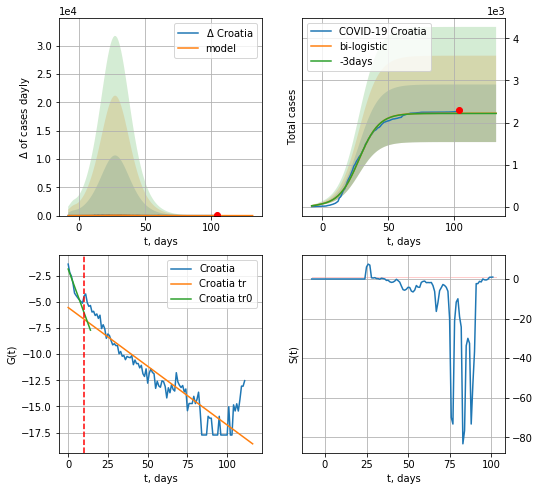

Croatia data at: 2020-06-20
+3 day model MAPE: 0.0019280319107474392
model: bi-logistic
coeffs:  [2.20819948e+03 1.30724765e-01 2.78547567e+01] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.3083272187546699
forecast at the end of period: +28 days
	 deltaDaycases:  0
	 total cases:  2220 ± 684
	 total death:  103 ± 95
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.833819
 intercept: -5.538525
 slope: -0.112414


In [863]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    x = forecast("Croatia",dfCT[:10],d1,16*7-dT,pMAPE=False)
    xx = forecast2("Croatia",dfCT[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


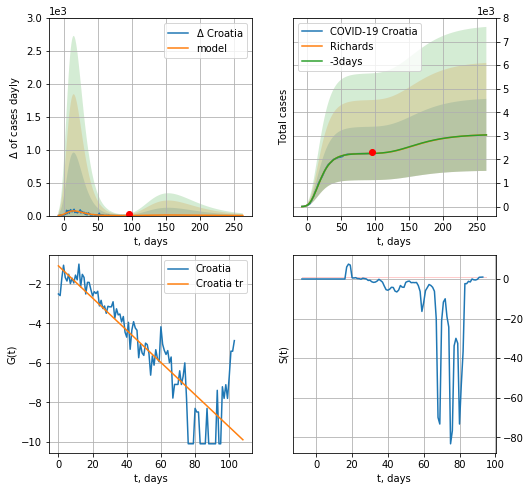

Croatia data at: 2020-06-20
+3 day model MAPE: 0.000685
model: Richards
coeffs: [ 2.25547131e+03  9.08569924e+00 -3.88956066e+01  9.52555439e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.501714
forecast at the end of period: +168 days
	 deltaDaycases: 0
	 total cases: 3042 ± 1526
	 total death: 141 ± 212
trend coefficient of determination: 0.792251
 intercept: -1.085253
 slope: -0.081516


In [864]:
x = forecastRR("Croatia",dfCT[8:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


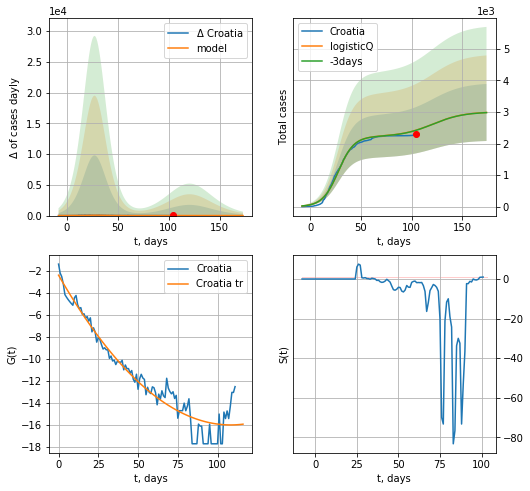

Croatia data at: 2020-06-20
+3 day model MAPE: 0.001346
model: logisticQ
coeffs: [ 2.22120140e+03  5.20339501e-07  2.77509913e+01 -2.48649052e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.302833
forecast at the end of period: +70 days
	 deltaDaycases: 1
	 total cases: 2983 ± 903
	 total death: 138 ± 125
trend coefficient of determination: 0.933389
 intercept_: -2.394744704850389
 coeffs_: [ 0.         -0.25183436  0.00116353]


In [865]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
           date  cases  active   death
102 2020-06-16  47856   33360  1766.0
103 2020-06-17  49219   34228  1850.0
104 2020-06-18  50437   34971  1938.0
105 2020-06-19  52211   36266  2017.0
106 2020-06-20  53758   37325  2106.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


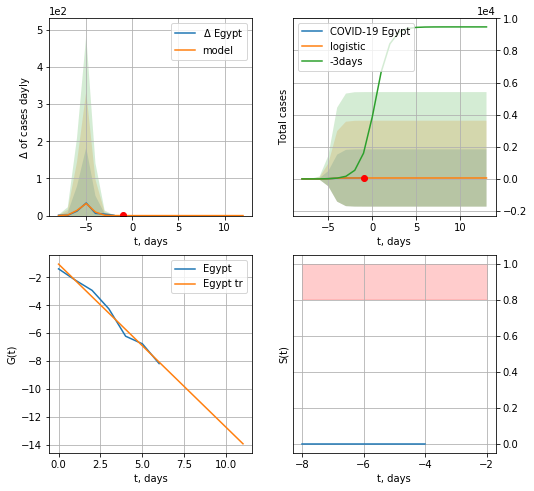

Egypt data at: 2020-06-20
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  2 ± 182
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


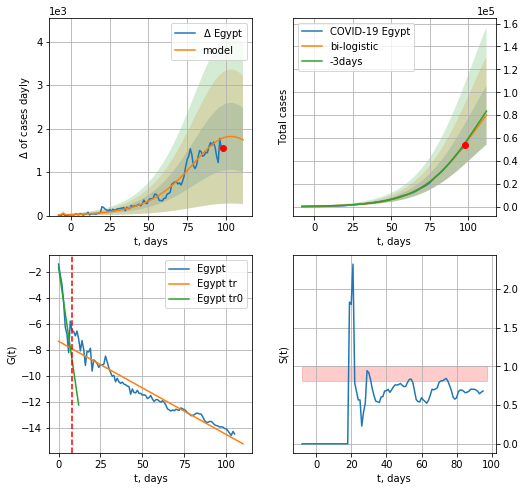

Egypt data at: 2020-06-20
+3 day model MAPE: 0.017558426232520602
model: bi-logistic
coeffs:  [1.26812497e+05 5.64316304e-02 1.03093162e+02] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.32180437094082487
forecast at the end of period: +14 days
	 deltaDaycases:  1738
	 total cases:  79940 ± 25725
	 total death:  3131 ± 3022
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.940235
 intercept: -7.318299
 slope: -0.071642


In [867]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*14-dT)
xx = forecast2("Egypt",dfEG[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


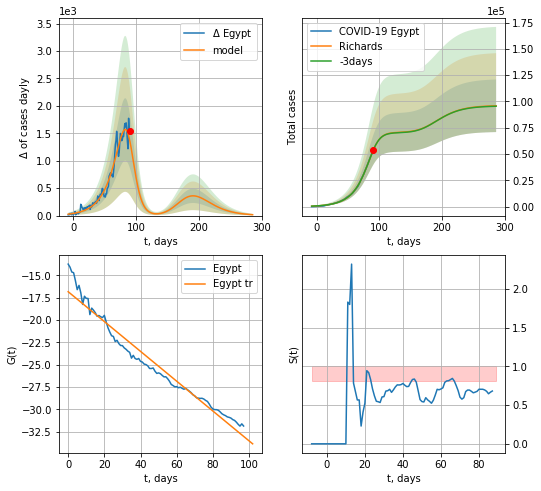

Egypt data at: 2020-06-20
+3 day model MAPE: 0.000127
model: Richards
coeffs: [7.06675490e+04 5.03931060e-02 9.03780316e+01 2.59923689e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.260544
forecast at the end of period: +196 days
	 deltaDaycases: 16
	 total cases: 95919 ± 24991
	 total death: 3757 ± 2936
trend coefficient of determination: 0.959115
 intercept: -16.836049
 slope: -0.166816


In [868]:
x = forecastRR("Egypt",dfEG[8:],d1,40*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


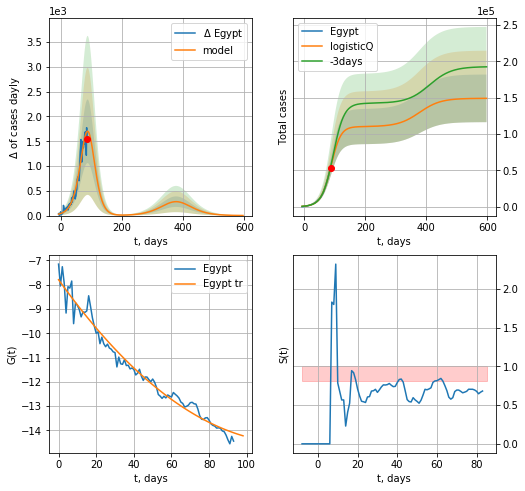

Egypt data at: 2020-06-20
+3 day model MAPE: 0.022765
model: logisticQ
coeffs: [ 1.10201374e+05  6.55600622e-05  8.64842798e+01 -8.54398594e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.219748
forecast at the end of period: +511 days
	 deltaDaycases: 1
	 total cases: 149168 ± 32779
	 total death: 5843 ± 3851
trend coefficient of determination: 0.973601
 intercept_: -7.79550197849286
 coeffs_: [ 0.         -0.10830236  0.000436  ]


In [869]:
x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date  cases   active   death
105 2020-06-16  22700  12126.0   712.0
106 2020-06-17  24254  12711.0   773.0
107 2020-06-18  25717  13528.0   856.0
108 2020-06-19  27352  14222.0   925.0
109 2020-06-20  29222  14998.0  1013.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


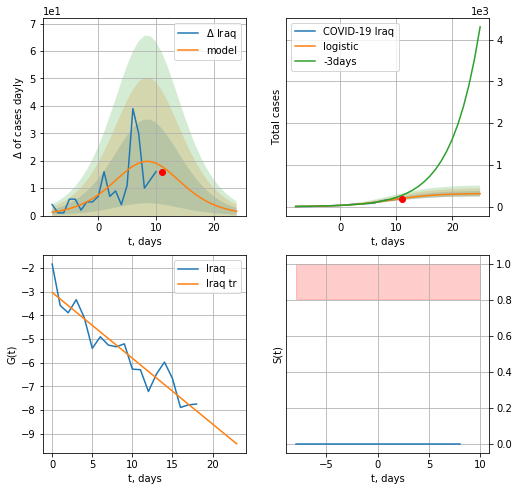

Iraq data at: 2020-06-20
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +14 days
	 deltaDaycases:  1
	 total cases:  311 ± 64
	 total death:  10 ± 6
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


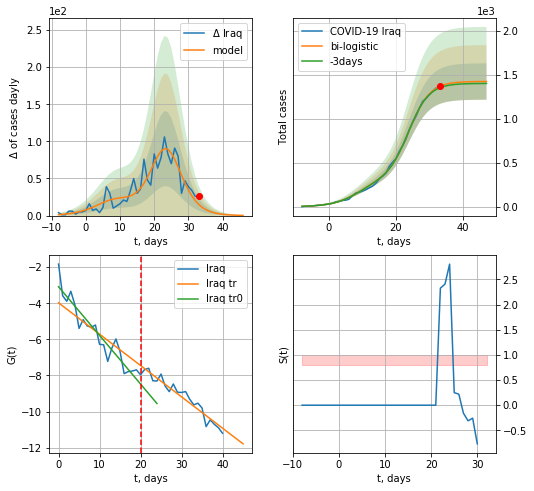

Iraq data at: 2020-06-20
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  1425 ± 207
	 total death:  49 ± 21
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


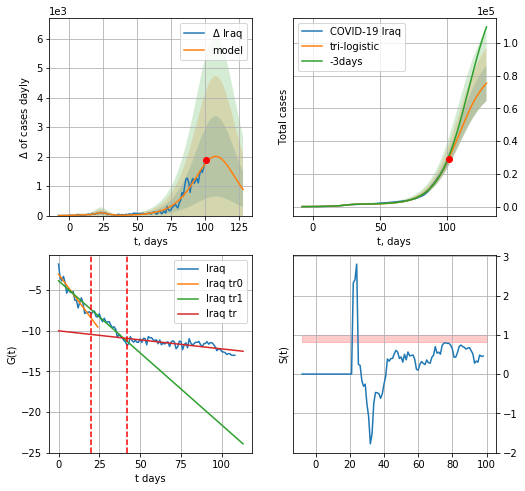

Iraq data at: 2020-06-20
+3 day model MAPE: 0.04789561610474815
model: tri-logistic
coeffs:  [8.40843193e+04 9.55630127e-02 1.08292221e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.14379186450974699
forecast at the end of period: +28 days
	 deltaDaycases:  888
	 total cases:  75299 ± 10827
	 total death:  2610 ± 1125
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.532830
 intercept: -10.024274
 slope: -0.022192


In [871]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,14*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,14*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

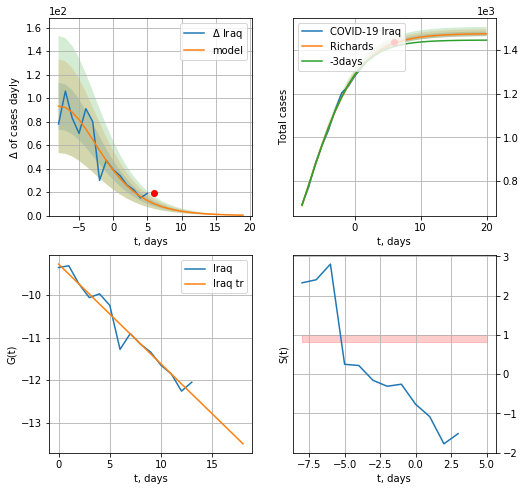

Iraq data at: 2020-06-20
+3 day model MAPE: 0.011697
model: Richards
coeffs: [ 1.47400012e+03  2.42837570e-01 -7.14620263e+00  1.06275201e+00]
rational stdev: 0.007118
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 1472 ± 10
	 total death: 51 ± 1
trend coefficient of determination: 0.953375
 intercept: -9.277934
 slope: -0.234196


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


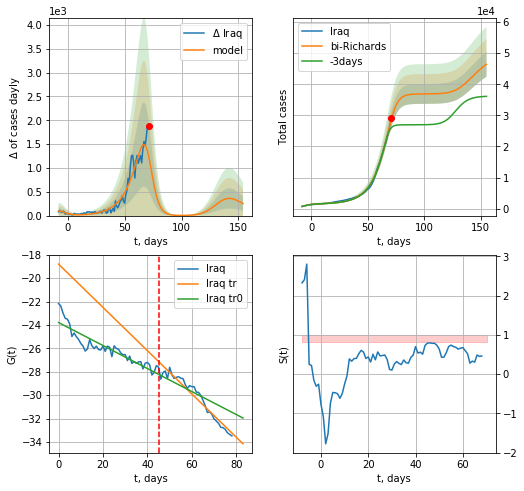

Iraq data at: 2020-06-20
+3 day model MAPE: 0.140008
model: bi-Richards
coeffs: [3.54056038e+04 8.94183847e-02 7.15788515e+01 2.98924342e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.086490
forecast at the end of period: +84 days
	 deltaDaycases: 251
	 total cases: 46395 ± 4012
	 total death: 1608 ± 417
bi-Richards approximation splitting point: 45
trend coefficient of determination: 0.822941
 intercept: -23.790909
 slope: -0.098416
trend coefficient of determination: 0.937829
 intercept: -18.795634
 slope: -0.185162


In [872]:
vL=75#25+10
x = forecastRR("Iraq",dfIQ[30:vL-30],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[30:],d1,24*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-30)

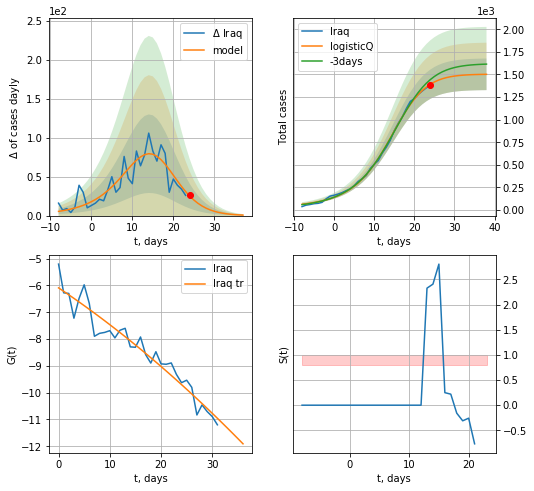

Iraq data at: 2020-06-20
+3 day model MAPE: 0.041008
model: logisticQ
coeffs: [ 1.50291916e+03  2.94853860e-03  1.34415511e+01 -5.72228334e+01]
rational stdev: 0.116469
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 1501 ± 174
	 total death: 52 ± 18
trend coefficient of determination: 0.930646
 intercept_: -6.090644942877015
 coeffs_: [ 0.         -0.12791486 -0.00093535]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


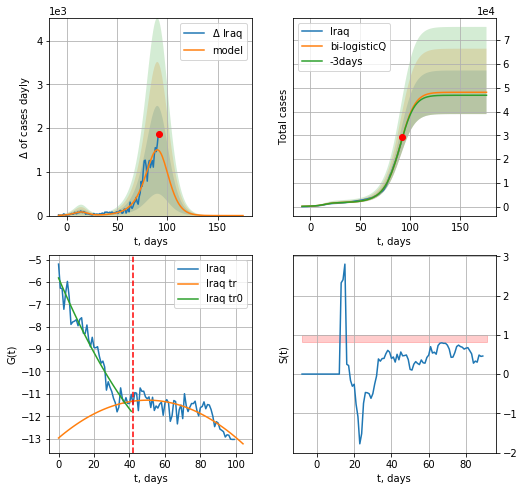

Iraq data at: 2020-06-20
+3 day model MAPE: 0.004982
model: bi-logisticQ
coeffs: [ 4.65887985e+04  6.65903391e-04  8.92263053e+01 -1.03579181e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.190467
forecast at the end of period: +84 days
	 deltaDaycases: 0
	 total cases: 48097 ± 9160
	 total death: 1667 ± 952
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.941003
 intercept_: -5.824005146615983
 coeffs_: [ 0.         -0.18682641  0.00101526]
trend coefficient of determination: 0.661573
 intercept_: -12.970344740147988
 coeffs_: [ 0.          0.06737773 -0.00067177]


In [873]:
x = forecastRRR("Iraq",dfIQ[9:42],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [874]:
#len(dfAR)

AR
           date    cases  active  death
104 2020-06-16  11147.0  2517.0  788.0
105 2020-06-17  11268.0  2526.0  799.0
106 2020-06-18  11385.0  2496.0  811.0
107 2020-06-19  11504.0  2483.0  825.0
108 2020-06-20  11631.0  2470.0  837.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


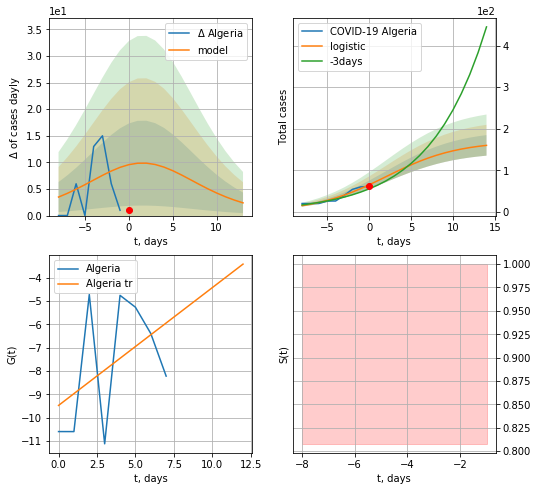

Algeria data at: 2020-06-20
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +14 days
	 deltaDaycases:  2
	 total cases:  159 ± 24
	 total death:  11 ± 5
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


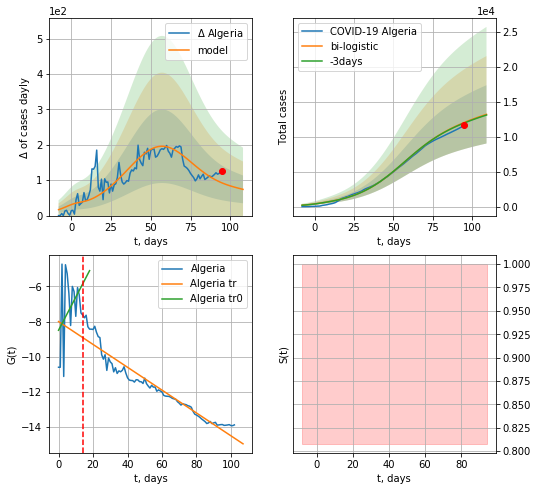

Algeria data at: 2020-06-20
+3 day model MAPE: 0.006335209657289742
model: bi-logistic
coeffs:  [1.21688170e+04 6.26690273e-02 5.66973646e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.31544962817274047
forecast at the end of period: +14 days
	 deltaDaycases:  74
	 total cases:  13209 ± 4166
	 total death:  950 ± 899
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.926546
 intercept: -7.997778
 slope: -0.065028


In [876]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*14-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*14-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


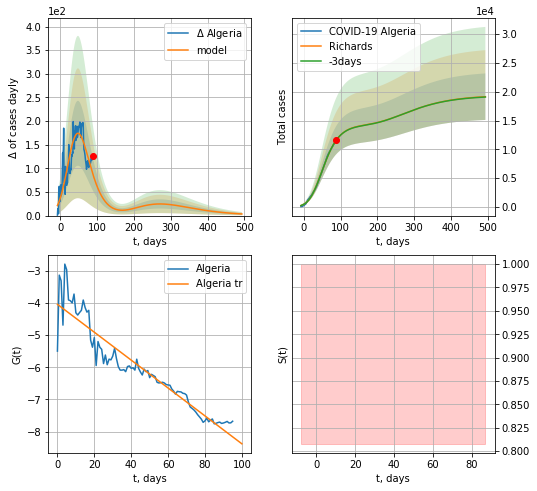

Algeria data at: 2020-06-20
+3 day model MAPE: 0.000839
model: Richards
coeffs: [1.42480353e+04 1.14667320e-01 2.01351081e+01 3.37620222e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.210931
forecast at the end of period: +406 days
	 deltaDaycases: 3
	 total cases: 19145 ± 4038
	 total death: 1377 ± 871
trend coefficient of determination: 0.891694
 intercept: -4.043575
 slope: -0.043365


In [877]:
x = forecastRR("Algeria",dfAR[12:],d1,70*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


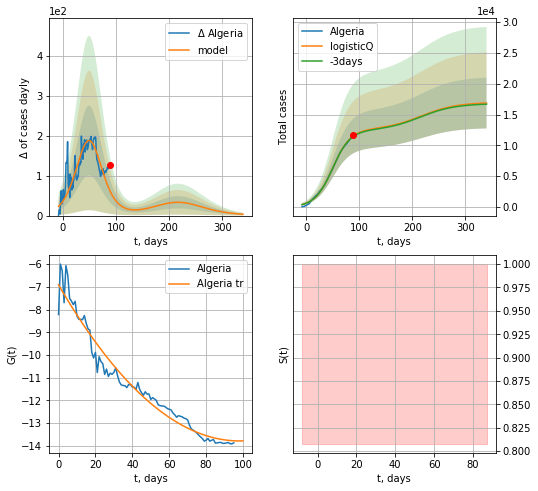

Algeria data at: 2020-06-20
+3 day model MAPE: 0.007108
model: logisticQ
coeffs: [ 1.25307509e+04  1.18606974e-06  4.97529980e+01 -5.02837963e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.244111
forecast at the end of period: +252 days
	 deltaDaycases: 3
	 total cases: 16861 ± 4116
	 total death: 1213 ± 888
trend coefficient of determination: 0.958818
 intercept_: -6.910638450444292
 coeffs_: [ 0.         -0.1403476   0.00071532]


In [878]:
x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date  cases  active  death
96  2020-06-16  985.0   151.0   18.0
97  2020-06-17  985.0   151.0   18.0
98  2020-06-18  985.0   148.0   19.0
99  2020-06-19  985.0   148.0   19.0
100 2020-06-20  985.0   142.0   19.0


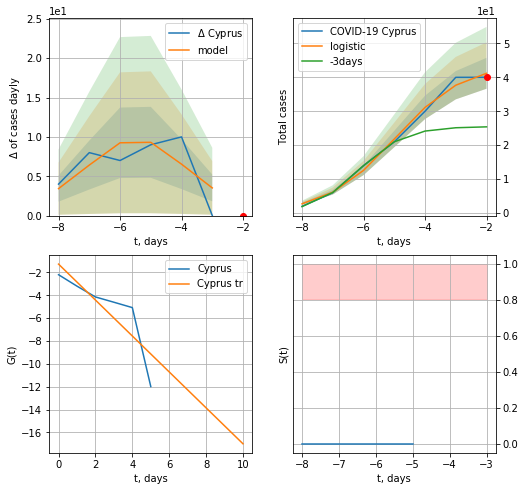

Cyprus data at: 2020-06-20
Exception occurs


In [879]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*12-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,12*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


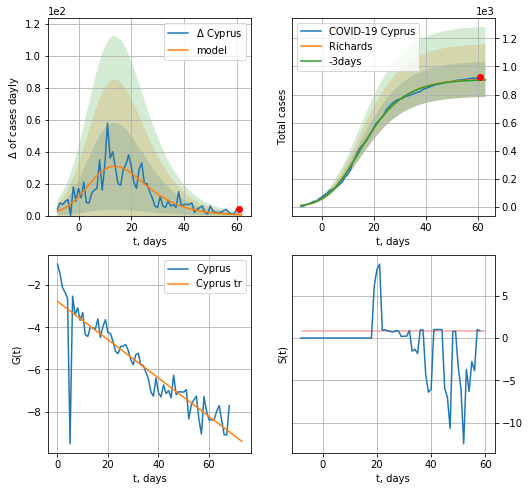

Cyprus data at: 2020-06-18
+3 day model MAPE: 0.004368
model: Richards
coeffs: [9.11933822e+02 3.20830854e-01 3.99756256e+00 3.34642778e-01]
rational stdev: 0.137523
forecast at the end of period: +2 days
	 deltaDaycases: 0
	 total cases: 907 ± 124
	 total death: 17 ± 7
trend coefficient of determination: 0.787995
 intercept: -2.772129
 slope: -0.090979


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:209: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

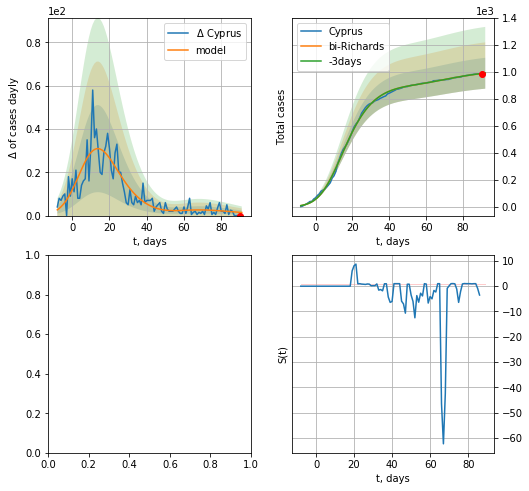

In [340]:
vL=70
x = forecastRR("Cyprus",dfCP[:vL],d1,12*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[:],d1,12*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

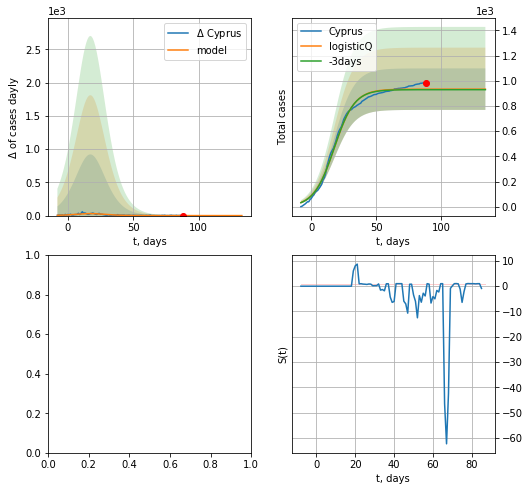

In [330]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases    active   death
101 2020-06-16  237156  104895.0  7056.0
102 2020-06-17  240908  105029.0  7257.0
103 2020-06-18  244388  105737.0  7461.0
104 2020-06-19  247925  104745.0  7660.0
105 2020-06-20  251338  104714.0  7861.0


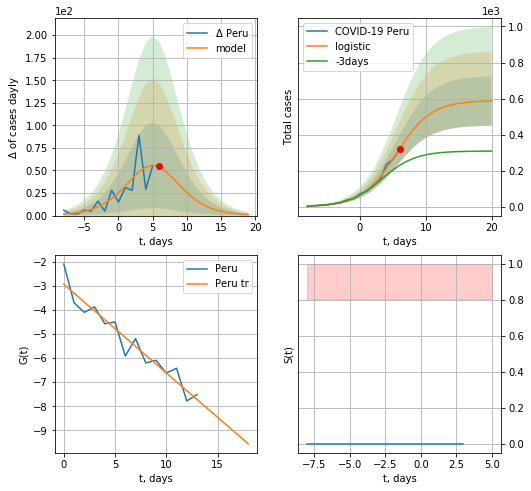

Peru data at: 2020-06-20
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +14 days
	 deltaDaycases:  1
	 total cases:  586 ± 136
	 total death:  18 ± 12
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


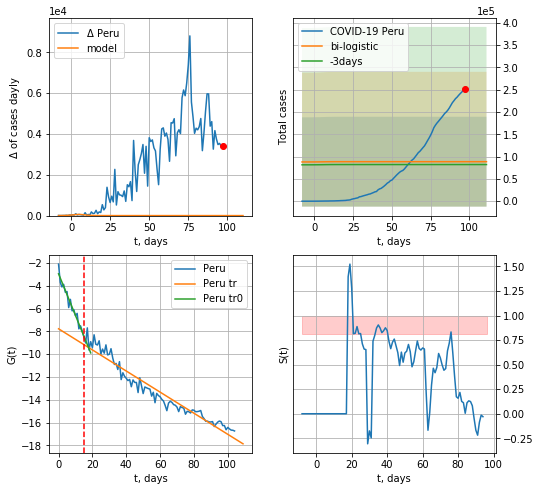

Peru data at: 2020-06-20
+3 day model MAPE: 0.07847943091177702
model: bi-logistic
coeffs:  [ 7.03517314e+04 -9.45703772e+00  2.38204993e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.1369027704328365
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  88528 ± 100648
	 total death:  2768 ± 9440
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.941231
 intercept: -7.772512
 slope: -0.092550


In [881]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*14-dT)
xx = forecast2("Peru",dfPU[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


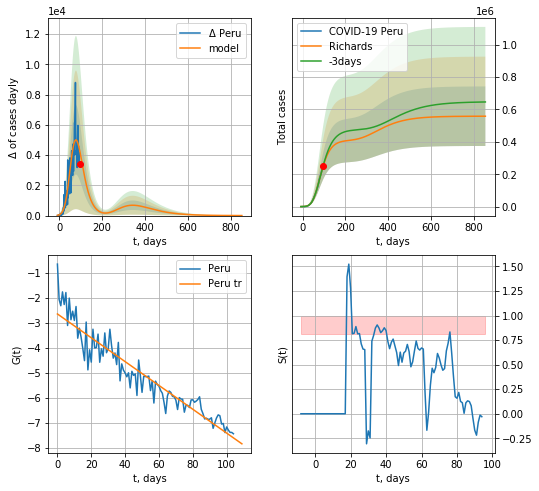

Peru data at: 2020-06-20
+3 day model MAPE: 0.015797
model: Richards
coeffs: [4.09992354e+05 1.48431045e-01 4.16769037e+01 2.51402109e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.329290
forecast at the end of period: +756 days
	 deltaDaycases: 2
	 total cases: 558357 ± 183861
	 total death: 17463 ± 17251
trend coefficient of determination: 0.891589
 intercept: -2.635889
 slope: -0.047628


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


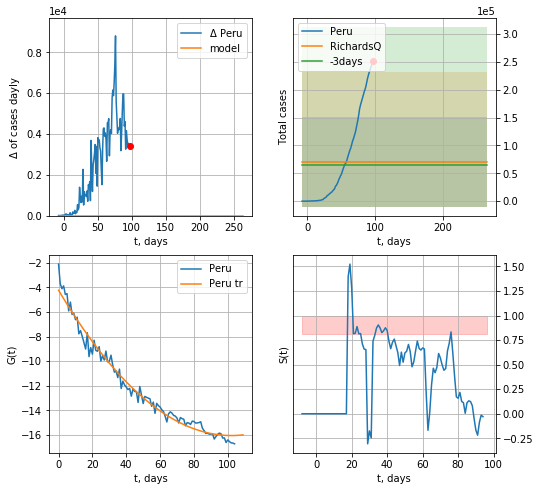

Peru data at: 2020-06-20
+3 day model MAPE: 0.078469
model: RichardsQ
coeffs: [ 7.08626604e+04  2.55122467e+01 -3.71289663e+03  3.18031633e+03
 -8.76322968e+00]
rational stdev: 1.138156
forecast at the end of period: +168 days
	 deltaDaycases: 0
	 total cases: 70862 ± 80652
	 total death: 2216 ± 7566
trend coefficient of determination: 0.977836
 intercept_: -4.226694184209896
 coeffs_: [ 0.         -0.2318375   0.00113554]


In [882]:
x = forecastRR("Peru",dfPU[:],d1,120*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


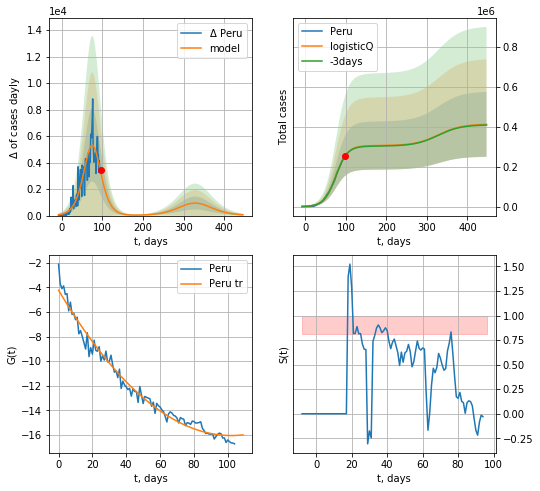

Peru data at: 2020-06-20
+3 day model MAPE: 0.004001
model: logisticQ
coeffs: [ 3.05134168e+05  1.40045971e-06  7.53391890e+01 -4.96889337e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.394862
forecast at the end of period: +350 days
	 deltaDaycases: 58
	 total cases: 411534 ± 162499
	 total death: 12871 ± 15246
trend coefficient of determination: 0.977836
 intercept_: -4.226694184209896
 coeffs_: [ 0.         -0.2318375   0.00113554]


In [883]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date   cases    active    death
108 2020-06-16  354161  154688.0  11921.0
109 2020-06-17  367264  160564.0  12262.0
110 2020-06-18  381485  163697.0  12605.0
111 2020-06-19  396182  169003.0  12970.0
112 2020-06-20  412210  170618.0  13285.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


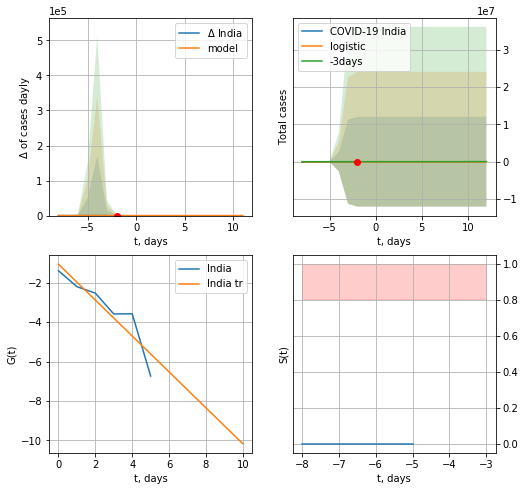

India data at: 2020-06-20
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


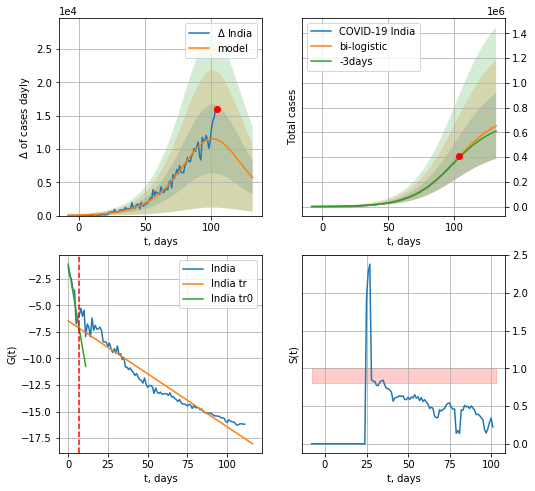

India data at: 2020-06-20
+3 day model MAPE: 0.022121105812213625
model: bi-logistic
coeffs:  [7.39622121e+05 6.18674453e-02 1.01087089e+02] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.4085451063181127
forecast at the end of period: +28 days
	 deltaDaycases:  5712
	 total cases:  652504 ± 266577
	 total death:  21029 ± 25773
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.935783
 intercept: -6.454475
 slope: -0.099794


In [885]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*14-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


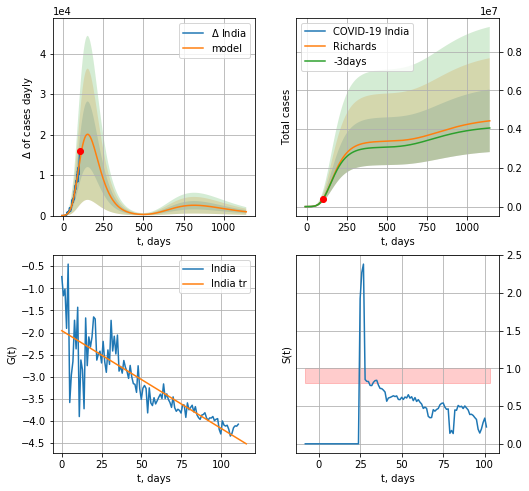

India data at: 2020-06-20
+3 day model MAPE: 0.003872
model: Richards
coeffs: [ 3.38196707e+06  2.61005607e-01 -1.21588494e+01  6.38335721e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.364821
forecast at the end of period: +1036 days
	 deltaDaycases: 941
	 total cases: 4428762 ± 1615703
	 total death: 142733 ± 156215
trend coefficient of determination: 0.721262
 intercept: -1.959142
 slope: -0.022043


In [886]:
x = forecastRR("India",dfID[:],d1,160*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


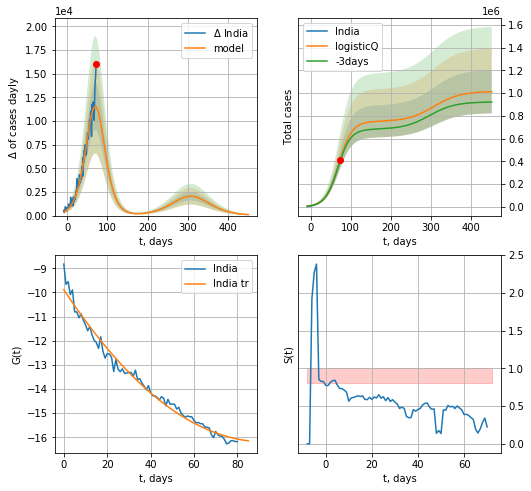

India data at: 2020-06-20
+3 day model MAPE: 0.021379
model: logisticQ
coeffs: [ 7.49970181e+05  4.48212280e-06  7.05164458e+01 -1.36618285e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.187738
forecast at the end of period: +378 days
	 deltaDaycases: 96
	 total cases: 1012469 ± 190079
	 total death: 32630 ± 18377
trend coefficient of determination: 0.981889
 intercept_: -9.884809079465501
 coeffs_: [ 0.         -0.13648294  0.00073891]


In [887]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date    cases   active  death
104 2020-06-16  34159.0  23107.0  878.0
105 2020-06-17  35552.0  24127.0  913.0
106 2020-06-18  37510.0  25841.0  948.0
107 2020-06-19  39570.0  26740.0  979.0
108 2020-06-20  41204.0  28006.0  992.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


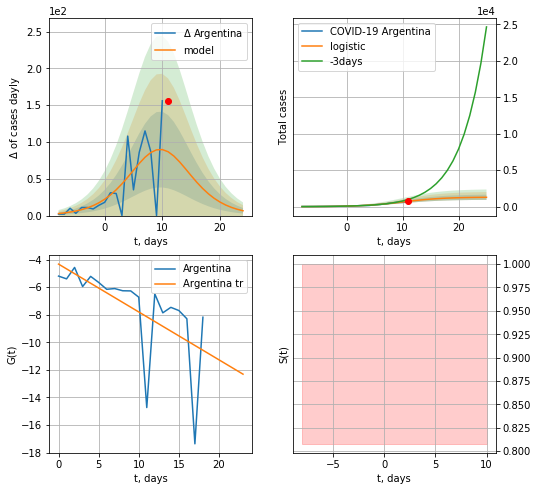

Argentina data at: 2020-06-20
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +14 days
	 deltaDaycases:  6
	 total cases:  1284 ± 356
	 total death:  30 ± 24
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


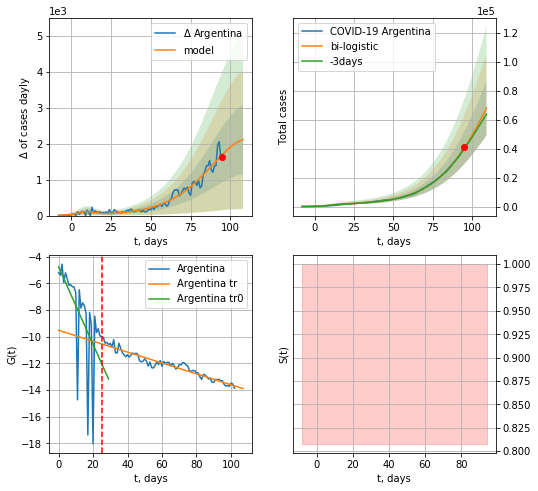

Argentina data at: 2020-06-20
+3 day model MAPE: 0.02065118631343991
model: bi-logistic
coeffs:  [1.48019817e+05 5.78481318e-02 1.12489232e+02] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.27588588356314026
forecast at the end of period: +14 days
	 deltaDaycases:  2114
	 total cases:  67917 ± 18737
	 total death:  1635 ± 1353
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.922485
 intercept: -9.519856
 slope: -0.040824


In [889]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*14-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,14*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


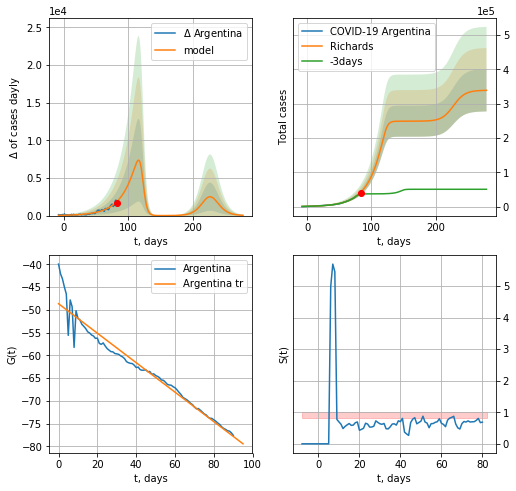

Argentina data at: 2020-06-20
+3 day model MAPE: 0.158276
model: Richards
coeffs: [2.49220377e+05 4.54516356e-02 1.22620211e+02 6.99565716e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.181746
forecast at the end of period: +196 days
	 deltaDaycases: 37
	 total cases: 339212 ± 61650
	 total death: 8166 ± 4452
trend coefficient of determination: 0.950362
 intercept: -48.655724
 slope: -0.323832


In [890]:
x = forecastRR('Argentina',dfAG[17:].fillna(0),d1,40*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


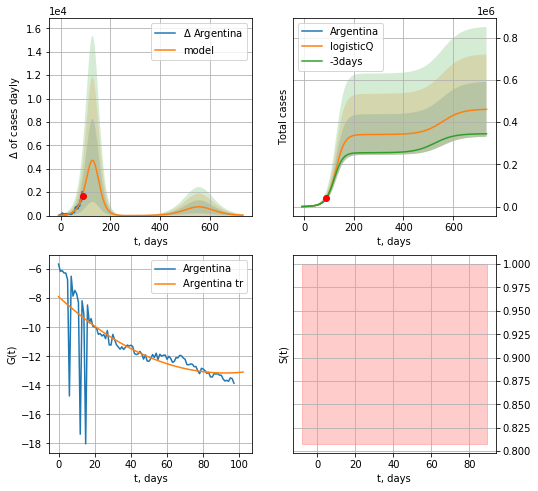

Argentina data at: 2020-06-20
+3 day model MAPE: 0.006070
model: logisticQ
coeffs: [ 3.41355831e+05  6.01172884e-05  1.27472368e+02 -7.92083249e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.282373
forecast at the end of period: +644 days
	 deltaDaycases: 34
	 total cases: 460897 ± 130145
	 total death: 11096 ± 9399
trend coefficient of determination: 0.524931
 intercept_: -7.8905953849066375
 coeffs_: [ 0.         -0.11430076  0.00062132]


In [891]:
x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


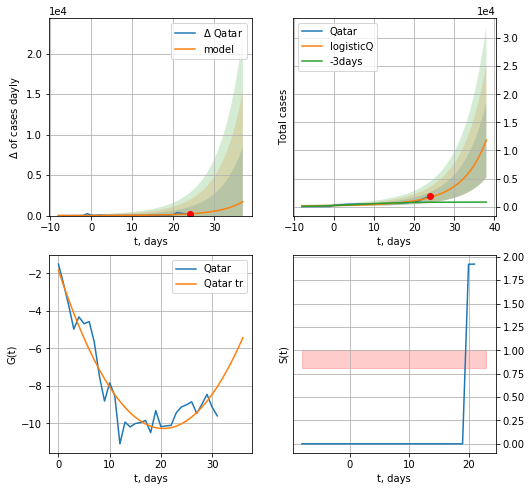

Qatar data at: 2020-06-20
+3 day model MAPE: 1.403655
model: logisticQ
coeffs: [ 4.67633524e+06  1.32940266e-03  6.79779167e+01 -1.11960120e+02]
rational stdev: 0.567221
forecast at the end of period: +14 days
	 deltaDaycases: 1728
	 total cases: 11839 ± 6715
	 total death: 12 ± 20
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


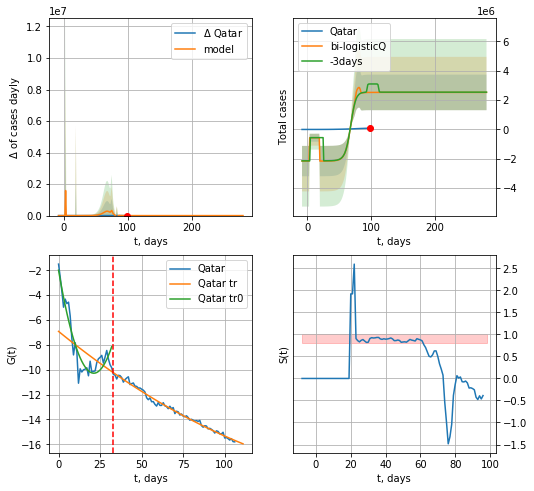

Qatar data at: 2020-06-20
+3 day model MAPE: 0.185849
model: bi-logisticQ
coeffs: [-1.59050604e+06  6.91039774e+00  1.90817170e+01  3.92210934e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.479541
forecast at the end of period: +182 days
	 deltaDaycases: 0
	 total cases: 2522520 ± 1209651
	 total death: 2741 ± 3943
bi-logisticQ approximation splitting point: 33
trend coefficient of determination: 0.887233
 intercept_: -1.9921673153050232
 coeffs_: [ 0.         -0.78114612  0.01840466]
trend coefficient of determination: 0.988624
 intercept_: -6.9153689137263115
 coeffs_: [ 0.         -0.10881807  0.00024637]


In [893]:
vL=33
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*14-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


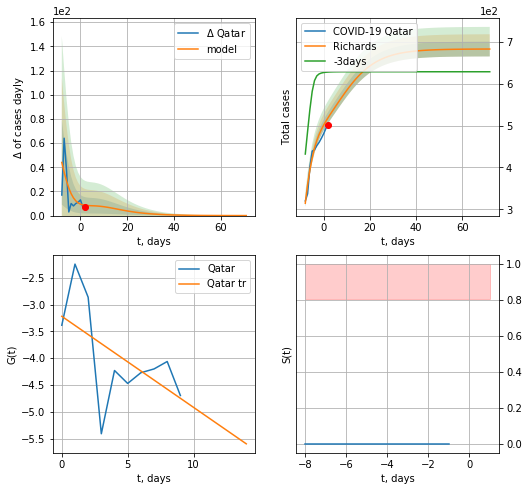

Qatar data at: 2020-06-20
+3 day model MAPE: 0.158936
model: Richards
coeffs: [ 5.01317281e+02  4.80174609e+00 -1.84019810e+01  6.85383715e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.025817
forecast at the end of period: +70 days
	 deltaDaycases: 0
	 total cases: 682 ± 17
	 total death: 0 ± 0
trend coefficient of determination: 0.312842
 intercept: -3.219590
 slope: -0.169880


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


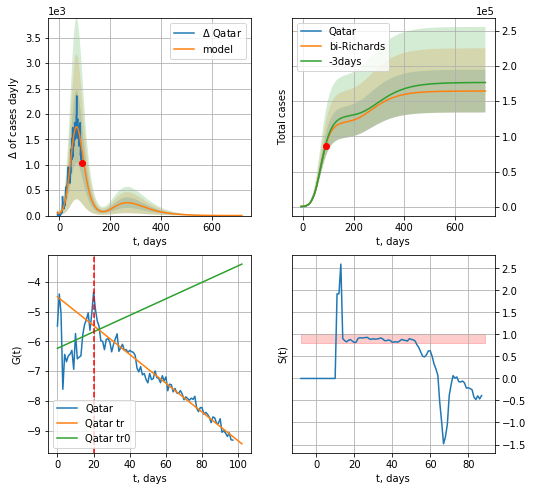

Qatar data at: 2020-06-20
+3 day model MAPE: 0.011511
model: bi-Richards
coeffs: [1.20231558e+05 1.11270009e-01 5.02254794e+01 4.29443015e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.184686
forecast at the end of period: +630 days
	 deltaDaycases: 0
	 total cases: 164280 ± 30340
	 total death: 178 ± 98
bi-Richards approximation splitting point: 20
trend coefficient of determination: 0.042359
 intercept: -6.234612
 slope: 0.027723
trend coefficient of determination: 0.956774
 intercept: -4.505457
 slope: -0.048374


In [894]:
vL = 29
x = forecastRR('Qatar',dfQR[9:vL-9].fillna(0),d1,22*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Qatar',dfQR[9:].fillna(0),d1,102*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-9)

In [895]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
122 2020-06-16  42982.0   13828  293.0
123 2020-06-17  43364.0   13532  295.0
124 2020-06-18  43752.0   13213  298.0
125 2020-06-19  44145.0   12849  300.0
126 2020-06-20  44533.0   12478  301.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


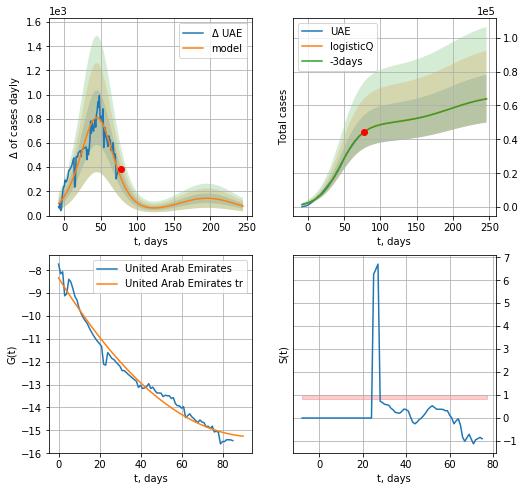

UAE data at: 2020-06-20
+3 day model MAPE: 0.002019
model: logisticQ
coeffs: [ 4.93941700e+04  1.10596553e-06  4.49677152e+01 -5.89736274e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.220177
forecast at the end of period: +168 days
	 deltaDaycases: 78
	 total cases: 64048 ± 14102
	 total death: 432 ± 285
trend coefficient of determination: 0.977911
 intercept_: -8.329988270718271
 coeffs_: [ 0.         -0.14472121  0.00075351]


In [896]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


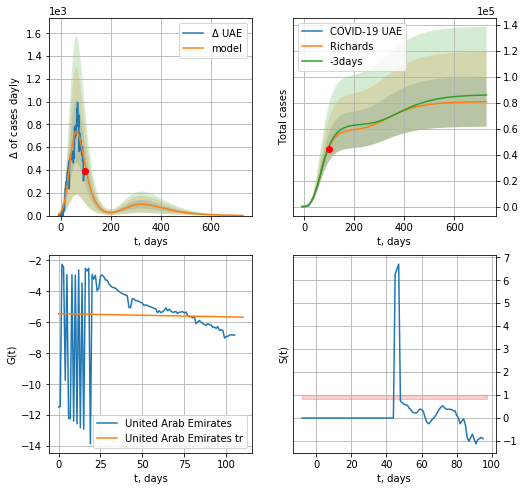

UAE data at: 2020-06-20
+3 day model MAPE: 0.012062
model: Richards
coeffs: [5.93149299e+04 1.90480876e-01 1.96797743e+01 1.95204245e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.237945
forecast at the end of period: +630 days
	 deltaDaycases: 1
	 total cases: 80685 ± 19198
	 total death: 545 ± 389
trend coefficient of determination: 0.000613
 intercept: -5.441413
 slope: -0.001999


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


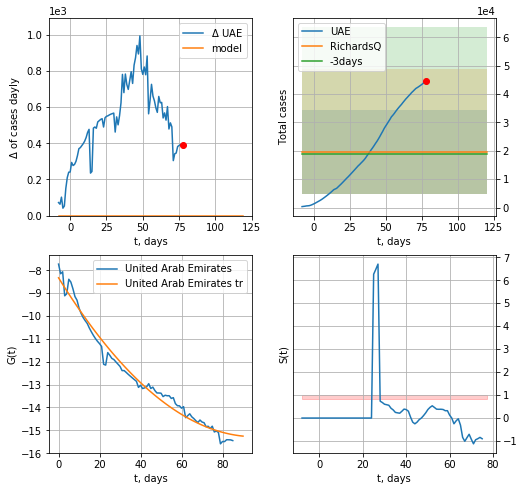

UAE data at: 2020-06-20
+3 day model MAPE: 0.046834
model: RichardsQ
coeffs: [ 1.95958506e+04 -2.01043221e+00 -1.00651147e+02 -1.22584722e+01
 -4.07165418e-02]
rational stdev: 0.749934
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 19595 ± 14695
	 total death: 132 ± 296
trend coefficient of determination: 0.977911
 intercept_: -8.329988270718271
 coeffs_: [ 0.         -0.14472121  0.00075351]


In [897]:
vL = 40
x = forecastRR('UAE',dfUAE[20:],d1,102*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('UAE',dfUAE[:],d1,102*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [898]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
           date     cases  active   death
105 2020-06-16  136315.0   45723  1052.0
106 2020-06-17  141234.0   48481  1091.0
107 2020-06-18  145991.0   50937  1139.0
108 2020-06-19  150292.0   53344  1184.0
109 2020-06-20  154233.0   54086  1230.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


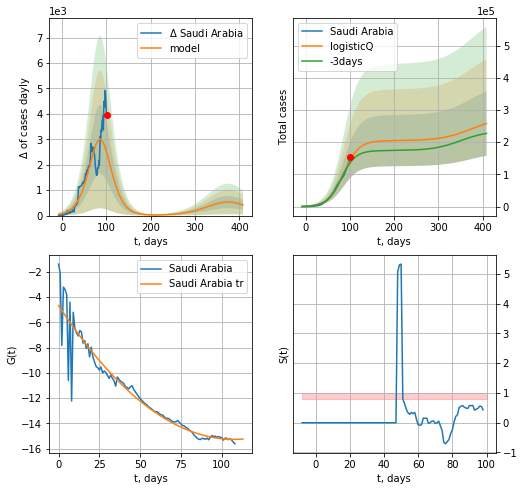

Saudi Arabia data at: 2020-06-20
+3 day model MAPE: 0.061445
model: logisticQ
coeffs: [ 2.04656185e+05  6.20637956e-07  8.59363053e+01 -9.43508947e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.387623
forecast at the end of period: +308 days
	 deltaDaycases: 419
	 total cases: 257856 ± 99951
	 total death: 2056 ± 2390
trend coefficient of determination: 0.910026
 intercept_: -4.669079494802286
 coeffs_: [ 0.         -0.19703378  0.00091644]


In [899]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,56*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


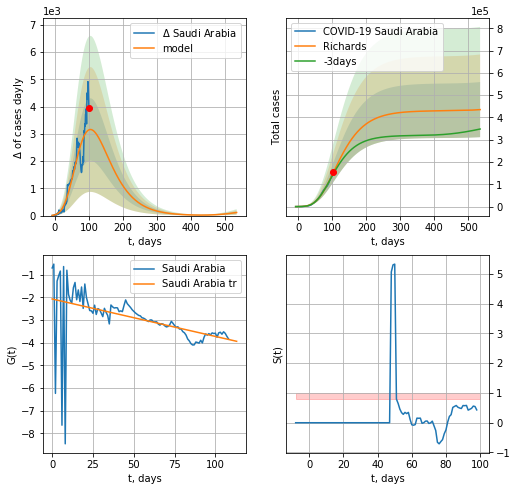

Saudi Arabia data at: 2020-06-20
+3 day model MAPE: 0.039780
model: Richards
coeffs: [ 4.30479836e+05  1.46022260e+00 -1.08370987e+02  1.37636419e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.284191
forecast at the end of period: +434 days
	 deltaDaycases: 113
	 total cases: 435130 ± 123660
	 total death: 3470 ± 2958
trend coefficient of determination: 0.214351
 intercept: -2.071836
 slope: -0.016532


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


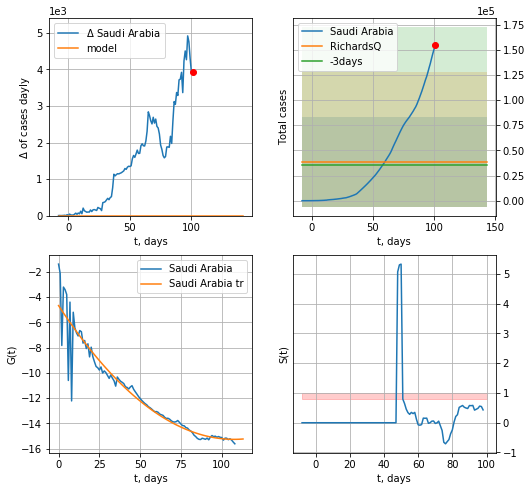

Saudi Arabia data at: 2020-06-20
+3 day model MAPE: 0.087618
model: RichardsQ
coeffs: [ 3.87712729e+04  1.41046988e+01 -1.97058772e+03  1.69956368e+03
 -4.67601859e+00]
rational stdev: 1.151289
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 38771 ± 44636
	 total death: 309 ± 1067
trend coefficient of determination: 0.910026
 intercept_: -4.669079494802286
 coeffs_: [ 0.         -0.19703378  0.00091644]


In [900]:
x = forecastRR('Saudi Arabia',dfSA[:],d1,74*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
           date   cases  active  death
98  2020-06-16  1915.0     533   11.0
99  2020-06-17  1924.0     516   11.0
100 2020-06-18  1947.0     515   11.0
101 2020-06-19  1950.0     493   11.0
102 2020-06-20  1950.0     467   11.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


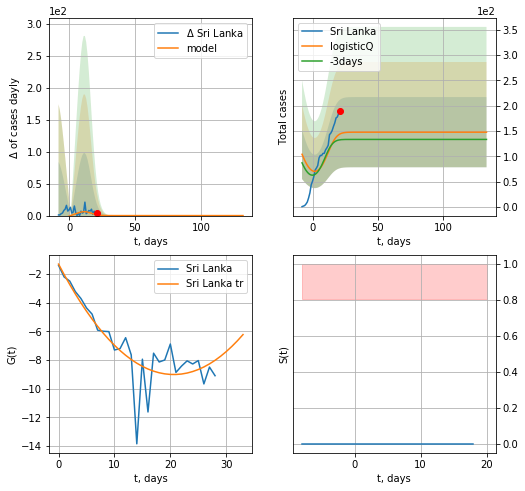

Sri Lanka data at: 2020-06-20
+3 day model MAPE: 0.092819
model: logisticQ
coeffs: [ 1.47873470e+02  1.02179685e-02  4.75701897e+00 -1.32324113e+00]
rational stdev: 0.468203
forecast at the end of period: +112 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

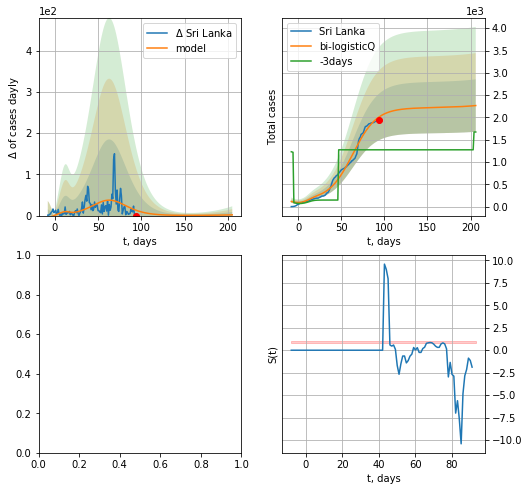

In [901]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 30
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

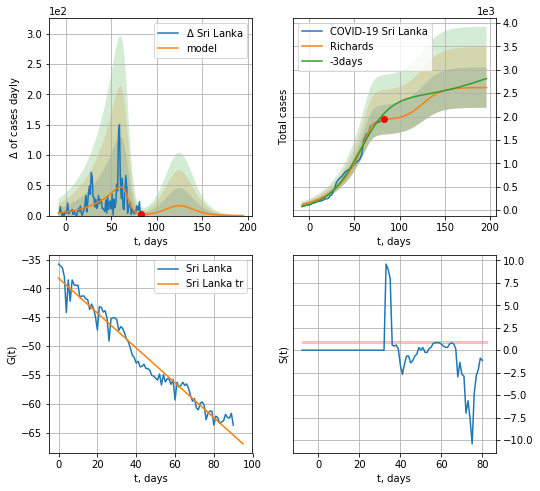

Sri Lanka data at: 2020-06-19
+3 day model MAPE: 0.074969
model: Richards
coeffs: [1.92422822e+03 3.67826575e-02 6.78446621e+01 7.55439491e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.165058
forecast at the end of period: +113 days
	 deltaDaycases: 0
	 total cases: 2620 ± 432
	 total death: 14 ± 6
trend coefficient of determination: 0.960502
 intercept: -38.210746
 slope: -0.302348


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


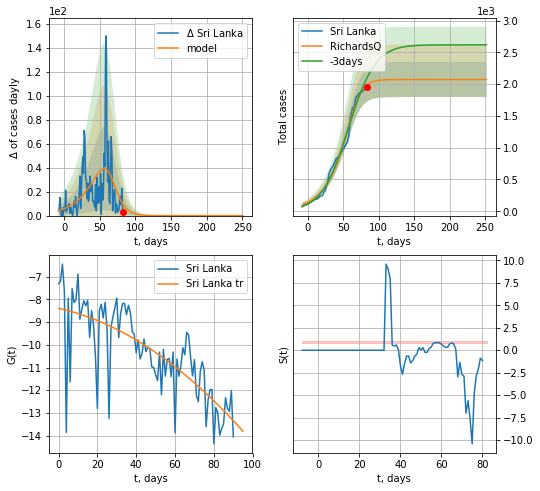

Sri Lanka data at: 2020-06-19
+3 day model MAPE: 0.055497
model: RichardsQ
coeffs: [ 2.07392142e+03  1.28257430e-05  6.49174372e+01 -3.23328405e+03
  2.69186543e+00]
rational stdev: 0.133089
forecast at the end of period: +169 days
	 deltaDaycases: 0
	 total cases: 2073 ± 276
	 total death: 11 ± 4
trend coefficient of determination: 0.575833
 intercept_: -8.39091109540447
 coeffs_: [ 0.         -0.01881052 -0.00040213]


In [435]:
vL=52
x = forecastRR('Sri Lanka',dfSri[10:],d1,28*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Sri Lanka',dfSri[10:],d1,30*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
109 2020-06-15  148921.0   89692  2839.0
110 2020-06-16  154760.0   93348  2975.0
111 2020-06-17  160118.0   97810  3093.0
112 2020-06-18  165062.0  100450  3229.0
113 2020-06-19  171666.0  104780  3382.0


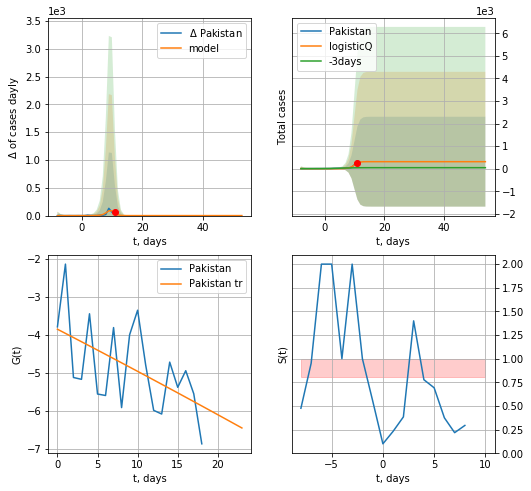

Pakistan data at: 2020-06-19
+3 day model MAPE: 5.954391
model: logisticQ
coeffs: [ 3.10300107e+02  5.80299152e-02  9.88962591e+00 -1.18245381e+01]
rational stdev: 6.420495
forecast at the end of period: +43 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


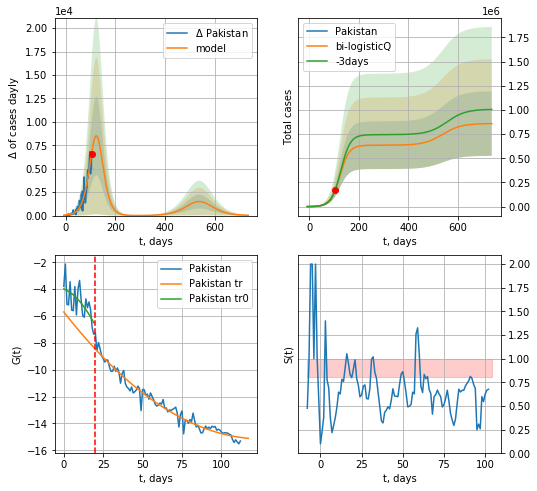

Pakistan data at: 2020-06-19
+3 day model MAPE: 0.013018
model: bi-logisticQ
coeffs: [ 6.34741343e+05  5.68668790e-06  1.23353744e+02 -9.31589617e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.388342
forecast at the end of period: +631 days
	 deltaDaycases: 29
	 total cases: 858750 ± 333488
	 total death: 16918 ± 19709
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.963186
 intercept_: -5.697633971020043
 coeffs_: [ 0.         -0.15026192  0.00059654]


In [436]:
dfPS = read_df(pd.DataFrame(),"PS")
vL= 20
x = forecastRRR('Pakistan',dfPS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Pakistan',dfPS[:],d1,102*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


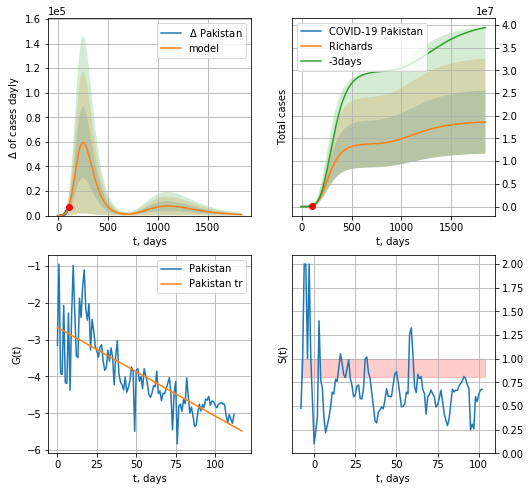

Pakistan data at: 2020-06-19
+3 day model MAPE: 0.010342
model: Richards
coeffs: [1.38185460e+07 8.55427506e-02 9.67951536e+01 1.46856627e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.374837
forecast at the end of period: +1737 days
	 deltaDaycases: 842
	 total cases: 18626616 ± 6981936
	 total death: 366963 ± 412653
trend coefficient of determination: 0.616689
 intercept: -2.666786
 slope: -0.024086


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


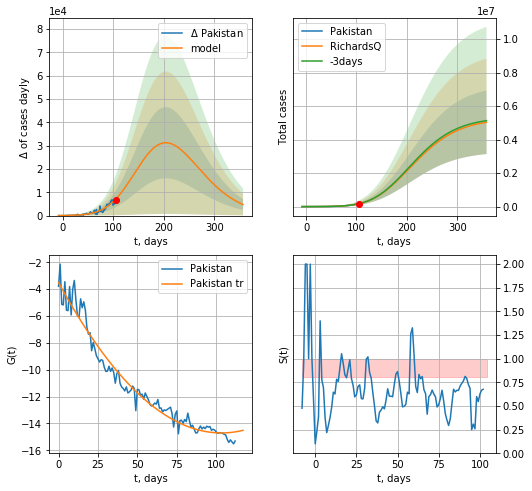

Pakistan data at: 2020-06-19
+3 day model MAPE: 0.005995
model: RichardsQ
coeffs: [ 5.24715319e+06  3.61403133e-04 -5.98710777e+01 -3.81567965e+02
  5.46591292e-02]
rational stdev: 0.376852
forecast at the end of period: +253 days
	 deltaDaycases: 4740
	 total cases: 5037429 ± 1898364
	 total death: 99242 ± 112198
trend coefficient of determination: 0.961846
 intercept_: -3.4963667526235414
 coeffs_: [ 0.         -0.2170218   0.00104986]


In [437]:
x = forecastRR('Pakistan',dfPS[:],d1,260*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
99  2020-06-15   90619.0   55383  1209.0
100 2020-06-16   94481.0   56955  1262.0
101 2020-06-17   98489.0   58995  1305.0
102 2020-06-18  102292.0   60785  1343.0
103 2020-06-19  105535.0   61202  1388.0


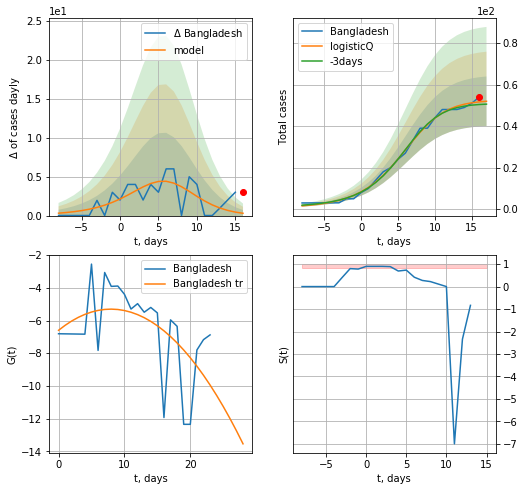

Bangladesh data at: 2020-06-19
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923176e+01  5.83632898e-03  5.49442770e+00 -5.18799455e+01]
rational stdev: 0.229670
forecast at the end of period: +1 days
	 deltaDaycases: 0
	 total cases: 51 ± 11
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


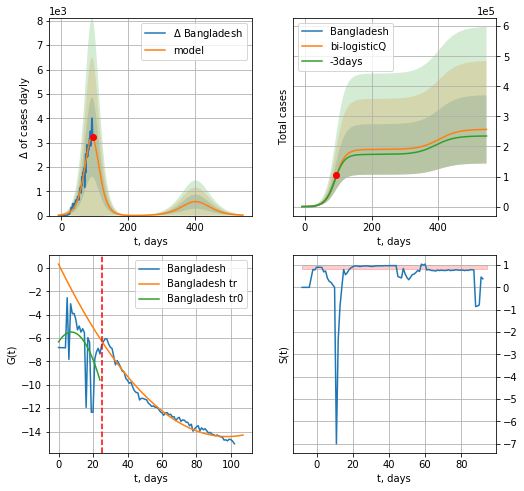

Bangladesh data at: 2020-06-19
+3 day model MAPE: 0.021930
model: bi-logisticQ
coeffs: [ 1.89924061e+05  2.82449213e-06  9.21455400e+01 -2.39750056e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.442518
forecast at the end of period: +449 days
	 deltaDaycases: 17
	 total cases: 256722 ± 113604
	 total death: 3376 ± 4481
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.980928
 intercept_: 0.32747853729594034
 coeffs_: [ 0.         -0.30186454  0.00154393]


In [438]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
x = forecastRRR('Bangladesh',dfBN[:vL],d1,12*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


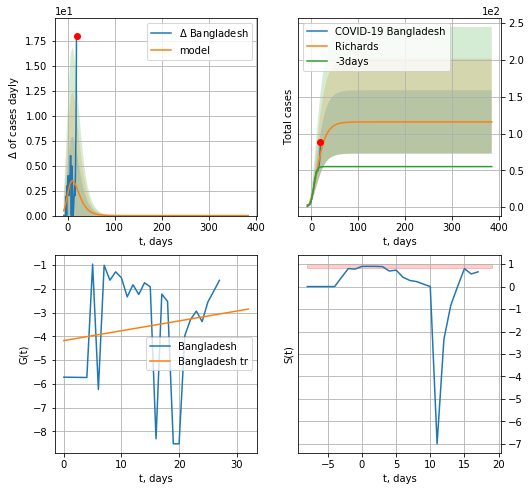

Bangladesh data at: 2020-06-19
+3 day model MAPE: 0.373626
model: Richards
coeffs: [ 1.15736925e+02  6.45824667e+00 -4.20178539e+01  1.27654554e-02]
rational stdev: 0.371727
forecast at the end of period: +365 days
	 deltaDaycases: 0
	 total cases: 115 ± 43
	 total death: 1 ± 1
trend coefficient of determination: 0.020746
 intercept: -4.180817
 slope: 0.041430


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


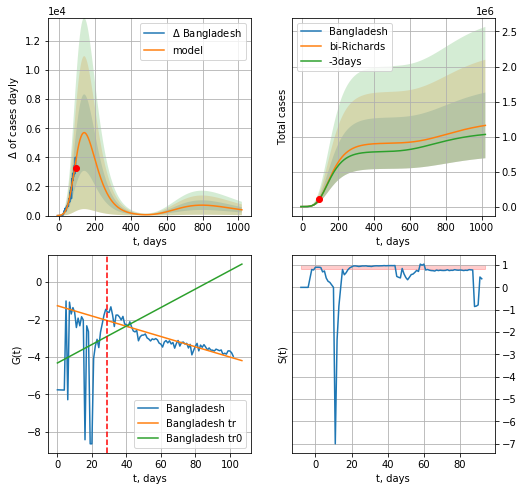

Bangladesh data at: 2020-06-19
+3 day model MAPE: 0.004033
model: bi-Richards
coeffs: [ 9.06799078e+05  4.21545528e-01 -4.10052113e+01  4.14007192e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.404363
forecast at the end of period: +925 days
	 deltaDaycases: 398
	 total cases: 1159217 ± 468744
	 total death: 15246 ± 18494
bi-Richards approximation splitting point: 29
trend coefficient of determination: 0.031843
 intercept: -4.319638
 slope: 0.049343
trend coefficient of determination: 0.823201
 intercept: -1.262990
 slope: -0.027392


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


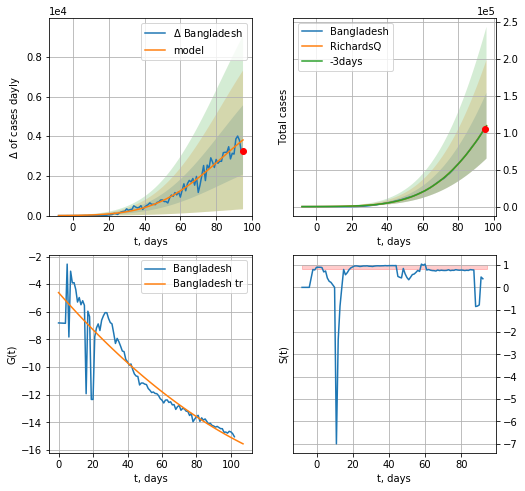

Bangladesh data at: 2020-06-19
+3 day model MAPE: 0.002247
model: RichardsQ
coeffs: [ 6.80905590e+05  2.21335208e-03 -3.04778274e+02 -3.06750739e+02
  1.09256017e-02]
rational stdev: 0.406524
forecast at the end of period: +1 days
	 deltaDaycases: 3812
	 total cases: 109429 ± 44485
	 total death: 1439 ± 1754
trend coefficient of determination: 0.852322
 intercept_: -4.612177152417076
 coeffs_: [ 0.         -0.14172545  0.00036823]


In [439]:
vL=29
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:],d1,144*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Bangladesh',dfBN[:],d1,12*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date    cases  active  death
112 2020-06-15  36431.0    8602  298.0
113 2020-06-16  36958.0    8449  303.0
114 2020-06-17  37533.0    8331  306.0
115 2020-06-18  38074.0    8254  308.0
116 2020-06-19  38678.0    8175  313.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


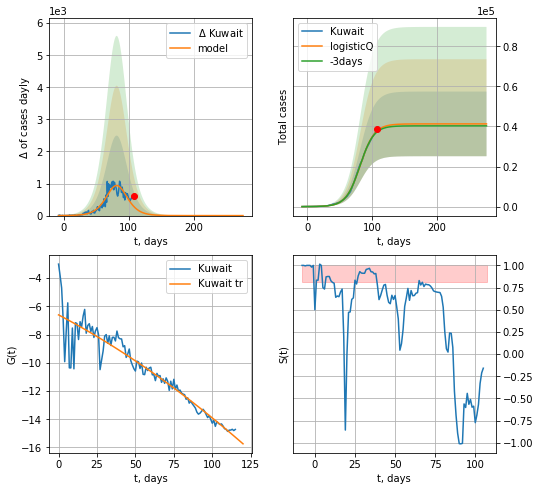

Kuwait data at: 2020-06-19
+3 day model MAPE: 0.013312
model: logisticQ
coeffs: [ 4.12656740e+04  5.11347618e-06  8.19080306e+01 -1.77356619e+04]
rational stdev: 0.390764
forecast at the end of period: +169 days
	 deltaDaycases: 0
	 total cases: 41265 ± 16125
	 total death: 333 ± 390
trend coefficient of determination: 0.887114
 intercept_: -6.601840905770651
 coeffs_: [ 0.         -0.05740943 -0.00015626]


In [440]:
dfKW = read_df(pd.DataFrame(),"KW")
x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


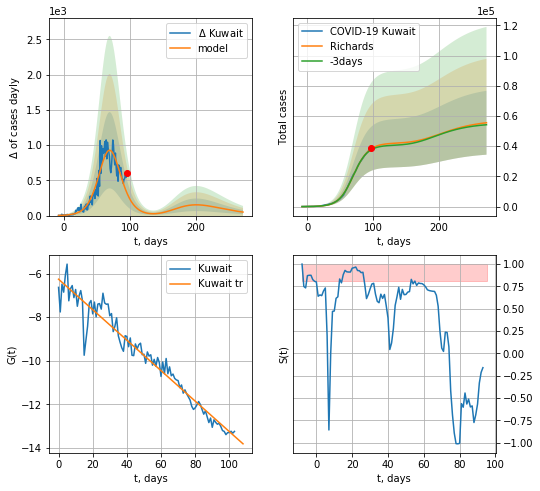

Kuwait data at: 2020-06-19
+3 day model MAPE: 0.015521
model: Richards
coeffs: [4.21023077e+04 9.79582986e-02 6.78973421e+01 8.59599064e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.380811
forecast at the end of period: +176 days
	 deltaDaycases: 49
	 total cases: 55520 ± 21142
	 total death: 449 ± 512
trend coefficient of determination: 0.948000
 intercept: -6.259880
 slope: -0.069892


In [441]:
iL= 12
vL = 26 + iL
x = forecastRR('Kuwait',dfKW[iL:],d1,37*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Kuwait',dfKW[iL:],d1,37*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date    cases  active  death
106 2020-06-15  23271.0    8641  605.0
107 2020-06-16  23686.0    8938  615.0
108 2020-06-17  24105.0    9256  633.0
109 2020-06-18  24645.0    9717  635.0
110 2020-06-19  25068.0    9816  647.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


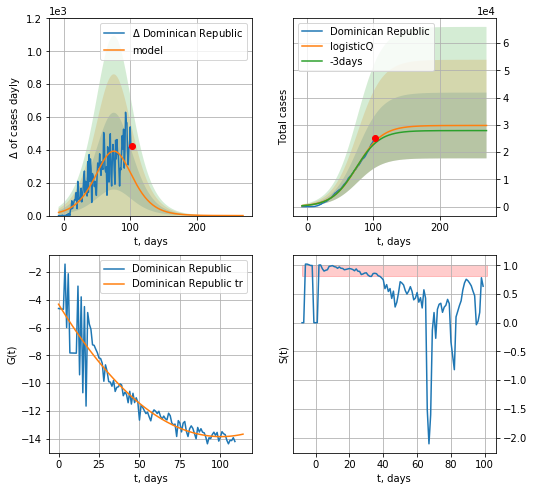

Dominican Republic data at: 2020-06-19
+3 day model MAPE: 0.029038
model: logisticQ
coeffs: [ 2.97870301e+04  4.37844678e-07  7.57202506e+01 -1.20307692e+05]
rational stdev: 0.404930
forecast at the end of period: +169 days
	 deltaDaycases: 0
	 total cases: 29786 ± 12061
	 total death: 768 ± 932
trend coefficient of determination: 0.869010
 intercept_: -4.316761544028688
 coeffs_: [ 0.         -0.19018145  0.00094776]


In [442]:
dfDM = read_df(pd.DataFrame(),"DM")
x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


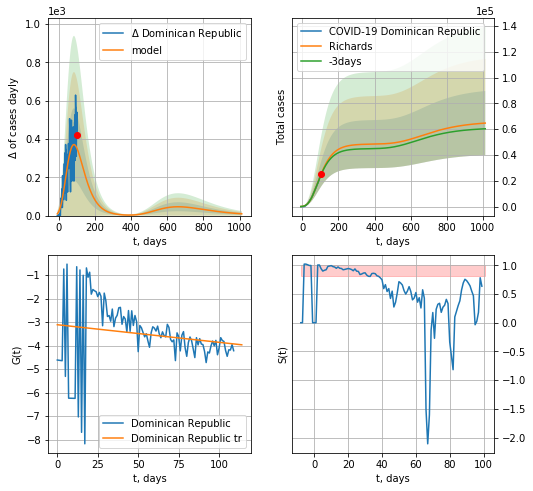

Dominican Republic data at: 2020-06-19
+3 day model MAPE: 0.014911
model: Richards
coeffs: [ 4.85174877e+04  1.54032786e+00 -1.21194564e+02  1.35753788e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.383907
forecast at the end of period: +911 days
	 deltaDaycases: 9
	 total cases: 64738 ± 24853
	 total death: 1670 ± 1923
trend coefficient of determination: 0.029761
 intercept: -3.114038
 slope: -0.007488


In [443]:
x = forecastRR('Dominican Republic',dfDM[:],d1,142*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

MD
           date    cases  active  death
100 2020-06-15  11879.0    4561  417.0
101 2020-06-16  12254.0    4930  423.0
102 2020-06-17  12732.0    5222  433.0
103 2020-06-18  13106.0    5410  444.0
104 2020-06-19  13556.0    5581  450.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


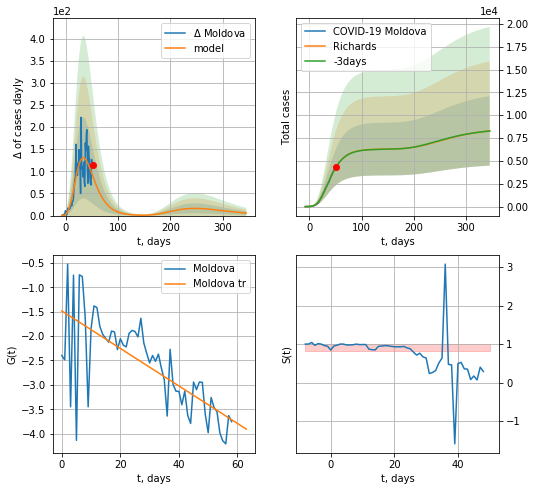

Moldova data at: 2020-06-19
+3 day model MAPE: 0.000788
model: Richards
coeffs: [ 6.30547574e+03  3.98849226e+00 -4.11476415e+01  1.42380272e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.458349
forecast at the end of period: +295 days
	 deltaDaycases: 5
	 total cases: 8278 ± 3794
	 total death: 274 ± 376
trend coefficient of determination: 0.512179
 intercept: -1.485671
 slope: -0.038427


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


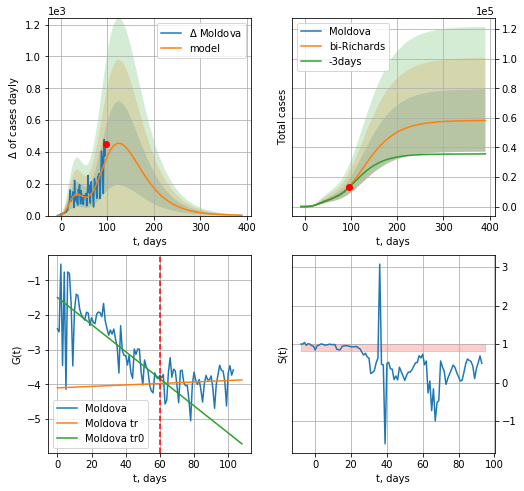

Moldova data at: 2020-06-19
+3 day model MAPE: 0.028185
model: bi-Richards
coeffs: [ 5.20053719e+04  1.25952901e+00 -4.07926059e+01  1.89538400e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.362186
forecast at the end of period: +295 days
	 deltaDaycases: 2
	 total cases: 58222 ± 21087
	 total death: 1932 ± 2099
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.534527
 intercept: -1.495217
 slope: -0.039092
trend coefficient of determination: 0.005040
 intercept: -4.102647
 slope: 0.002122


In [444]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,54*7-dT,addpred=True,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Moldova",dfMD[:],d1,54*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [454]:
#np.diff(dfAF["cases"])

AF
           date    cases  active  death
102 2020-06-15  73533.0   32098   1568
103 2020-06-16  76334.0   32646   1625
104 2020-06-17  80412.0   34407   1674
105 2020-06-18  83890.0   37233   1737
106 2020-06-19  87715.0   38059   1831


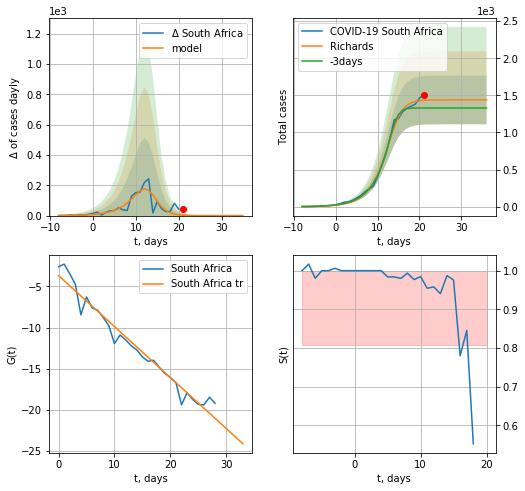

South Africa data at: 2020-06-19
+3 day model MAPE: 0.079443
model: Richards
coeffs: [1.43832007e+03 3.09188728e-01 1.37785508e+01 2.13840807e+00]
rational stdev: 0.227967
forecast at the end of period: +15 days
	 deltaDaycases: 0
	 total cases: 1438 ± 327
	 total death: 30 ± 20
trend coefficient of determination: 0.961533
 intercept: -3.675972
 slope: -0.619731


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


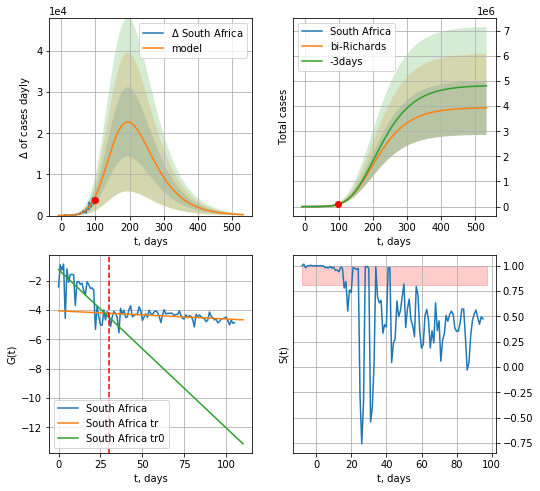

South Africa data at: 2020-06-19
+3 day model MAPE: 0.002933
model: bi-Richards
coeffs: [3.94156414e+06 1.11712626e-01 8.32121743e+01 1.50972035e-01]
rational stdev: 0.273275
forecast at the end of period: +435 days
	 deltaDaycases: 224
	 total cases: 3929776 ± 1073909
	 total death: 82031 ± 67251
bi-Richards approximation splitting point: 30
trend coefficient of determination: 0.520085
 intercept: -1.229348
 slope: -0.108180
trend coefficient of determination: 0.147934
 intercept: -4.046078
 slope: -0.005553


In [460]:
dfAF = read_df(pd.DataFrame(),"AF")
dfAF = dfAF.fillna(0)
try:
    vL = 30
    x = forecastRR("South Africa",dfAF[:vL],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("South Africa",dfAF[:],d1,74*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [ ]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [483]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695]


In [484]:
df.head(10)
#df.columns[18]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,NewRecovered,Population,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,,\n,,,"1,337,466",North America,\nNorth America\n,,"+6,113",433,"+4,577",,"19,364",,"2,700,859","153,642","1,209,751",,
1,,\n,,,"727,337",South America,\nSouth America\n,,"+1,036",25,416,,"12,432",,"1,746,976","70,324","949,315",,
2,,\n,,,"863,448",Europe,\nEurope\n,,"+8,472",117,"+5,734",,"6,321",,"2,306,239","187,504","1,255,287",,
3,,\n,,,"639,559",Asia,\nAsia\n,,"+7,429",160,"+5,185",,"15,905",,"1,867,917","47,451","1,180,907",,
4,,\n,,,"146,922",Africa,\nAfrica\n,,180,10,163,,481,,"300,021","7,951","145,148",,
5,,\n,,,470,Australia/Oceania,\nOceania\n,,27,,15,,2,,"9,079",124,"8,485",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"3,715,257",All,World,59.9,"+23,257",745,"+16,090",,"54,509",,"8,931,812","467,011","4,749,544",,"1,146"
8,1,142,"2,713",12,"1,235,657",North America,USA,369,,,,"330,949,344","16,529","84,532","2,330,578","121,980","972,941","27,975,863","7,042"
9,2,199,"4,245",88,"476,895",South America,Brazil,236,,,,"212,516,958","8,318","11,339","1,070,139","50,058","543,186","2,409,830","5,036"


In [485]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"1,337,466",North America,\nNorth America\n,,"+6,113",433,"+4,577",,"19,364",,"2,700,859","153,642","1,209,751",,
1,,\n,,,"727,337",South America,\nSouth America\n,,"+1,036",25,416,,"12,432",,"1,746,976","70,324","949,315",,
2,,\n,,,"863,448",Europe,\nEurope\n,,"+8,472",117,"+5,734",,"6,321",,"2,306,239","187,504","1,255,287",,
3,,\n,,,"639,559",Asia,\nAsia\n,,"+7,429",160,"+5,185",,"15,905",,"1,867,917","47,451","1,180,907",,
4,,\n,,,"146,922",Africa,\nAfrica\n,,180,10,163,,481,,"300,021","7,951","145,148",,


In [486]:
df[df["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
115,108,"1,517","35,828",7,249,Europe,Lithuania,28,,,,"2,722,962",16,"143,394","1,795",76,"1,470","390,457",659
348,109,"1,517","35,828",7,249,Europe,Lithuania,28,3,,8,"2,722,962",16,"143,394","1,795",76,"1,470","390,457",659
580,109,"1,520","35,828",7,254,Europe,Lithuania,28,8,,13,"2,722,962",16,"141,829","1,792",76,"1,462","386,194",658


In [487]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [488]:
df.head(35)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"1,337,466",North America,\nNorth America\n,,"+6,113",433,"+4,577",,"19,364",,"2,700,859","153,642","1,209,751",,
1,,\n,,,"727,337",South America,\nSouth America\n,,"+1,036",25,416,,"12,432",,"1,746,976","70,324","949,315",,
2,,\n,,,"863,448",Europe,\nEurope\n,,"+8,472",117,"+5,734",,"6,321",,"2,306,239","187,504","1,255,287",,
3,,\n,,,"639,559",Asia,\nAsia\n,,"+7,429",160,"+5,185",,"15,905",,"1,867,917","47,451","1,180,907",,
4,,\n,,,"146,922",Africa,\nAfrica\n,,180,10,163,,481,,"300,021","7,951","145,148",,
5,,\n,,,470,Australia/Oceania,\nOceania\n,,27,,15,,2,,"9,079",124,"8,485",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"3,715,257",All,World,59.9,"+23,257",745,"+16,090",,"54,509",,"8,931,812","467,011","4,749,544",,"1,146"
8,1,142,"2,713",12,"1,235,657",North America,USA,369,,,,"330,949,344","16,529","84,532","2,330,578","121,980","972,941","27,975,863","7,042"
9,2,199,"4,245",88,"476,895",South America,Brazil,236,,,,"212,516,958","8,318","11,339","1,070,139","50,058","543,186","2,409,830","5,036"


In [489]:
df.at[13, 'TotalRecovered'] = 0
df.at[12, 'TotalRecovered'] = 0
df.at[31, 'TotalRecovered'] = 0
df.at[34, 'TotalRecovered'] = 0
df.at[13,"ActiveCases"] = 0
df.at[12,"ActiveCases"] = 0
df.at[31,"ActiveCases"] = 0
df.at[34,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [490]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1337466,North America,\nNorth America\n,NaN,6113.0,433.0,"+4,577",,19364.0,NaN,2700859,153642.0,1209751.0,NaN,NaN
1,,\n,,,727337,South America,\nSouth America\n,NaN,1036.0,25.0,416,,12432.0,NaN,1746976,70324.0,949315.0,NaN,NaN
2,,\n,,,863448,Europe,\nEurope\n,NaN,8472.0,117.0,"+5,734",,6321.0,NaN,2306239,187504.0,1255287.0,NaN,NaN
3,,\n,,,639559,Asia,\nAsia\n,NaN,7429.0,160.0,"+5,185",,15905.0,NaN,1867917,47451.0,1180907.0,NaN,NaN
4,,\n,,,146922,Africa,\nAfrica\n,NaN,180.0,10.0,163,,481.0,NaN,300021,7951.0,145148.0,NaN,NaN
5,,\n,,,470,Australia/Oceania,\nOceania\n,NaN,27.0,NaN,15,,2.0,NaN,9079,124.0,8485.0,NaN,NaN
6,,\n,,,55,,\n\n,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
7,,\n,,,3715257,All,World,59.9,23257.0,745.0,"+16,090",,54509.0,NaN,8931812,467011.0,4749544.0,NaN,1146.0
8,1,142,"2,713",12,1235657,North America,USA,369.0,NaN,NaN,,"330,949,344",16529.0,84532.0,2330578,121980.0,972941.0,27975863.0,7042.0
9,2,199,"4,245",88,476895,South America,Brazil,236.0,NaN,NaN,,"212,516,958",8318.0,11339.0,1070139,50058.0,543186.0,2409830.0,5036.0


In [491]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
226,,,,,639559,Asia,Total:,NaN,7429.0,160.0,"+5,185",,15905.0,NaN,1867917,47451.0,1180907.0,NaN,NaN
227,,,,,146922,Africa,Total:,NaN,180.0,10.0,163,,481.0,NaN,300021,7951.0,145148.0,NaN,NaN
228,,,,,470,Australia/Oceania,Total:,NaN,27.0,NaN,,,2.0,NaN,9079,124.0,8485.0,NaN,NaN
229,,,,,55,,Total:,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
230,NaN,NaN,NaN,NaN,160958,Europe,European Union,296.280399,9.0,0.0,NaN,NaN,2672.0,57894.987629,1242834,131919.0,590858.0,25777773.0,2791.314015


In [492]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1337466,North America,North America,NaN,6113.0,433.0,"+4,577",,19364.0,NaN,2700859,153642.0,1209751.0,NaN,NaN
1,,\n,,,727337,South America,South America,NaN,1036.0,25.0,416,,12432.0,NaN,1746976,70324.0,949315.0,NaN,NaN
2,,\n,,,863448,Europe,Europe,NaN,8472.0,117.0,"+5,734",,6321.0,NaN,2306239,187504.0,1255287.0,NaN,NaN
3,,\n,,,639559,Asia,Asia,NaN,7429.0,160.0,"+5,185",,15905.0,NaN,1867917,47451.0,1180907.0,NaN,NaN
4,,\n,,,146922,Africa,Africa,NaN,180.0,10.0,163,,481.0,NaN,300021,7951.0,145148.0,NaN,NaN


In [493]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [494]:
#df

In [495]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1337466,North America,North America,NaN,6113.0,433.0,"+4,577",,19364.0,NaN,2700859,153642.0,1209751.0,NaN,NaN
1,,\n,,,727337,South America,South America,NaN,1036.0,25.0,416,,12432.0,NaN,1746976,70324.0,949315.0,NaN,NaN
2,,\n,,,863448,Europe,Europe,NaN,8472.0,117.0,"+5,734",,6321.0,NaN,2306239,187504.0,1255287.0,NaN,NaN
3,,\n,,,639559,Asia,Asia,NaN,7429.0,160.0,"+5,185",,15905.0,NaN,1867917,47451.0,1180907.0,NaN,NaN
4,,\n,,,146922,Africa,Africa,NaN,180.0,10.0,163,,481.0,NaN,300021,7951.0,145148.0,NaN,NaN
5,,\n,,,470,Australia/Oceania,Oceania,NaN,27.0,NaN,15,,2.0,NaN,9079,124.0,8485.0,NaN,NaN
7,,\n,,,3715257,All,World,59.9,23257.0,745.0,"+16,090",,54509.0,NaN,8931812,467011.0,4749544.0,NaN,1146.0
8,1,142,"2,713",12,1235657,North America,USA,369.0,NaN,NaN,,"330,949,344",16529.0,84532.0,2330578,121980.0,972941.0,27975863.0,7042.0
9,2,199,"4,245",88,476895,South America,Brazil,236.0,NaN,NaN,,"212,516,958",8318.0,11339.0,1070139,50058.0,543186.0,2409830.0,5036.0
10,3,250,"17,992",9,236858,Europe,Russia,56.0,7728.0,109.0,"+5,119","145,932,915",2300.0,116481.0,584680,8111.0,339711.0,16998453.0,4006.0


In [496]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [497]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Hungary HG
France FR
Estonia ES
Morocco MR
Ireland IR
New Zealand ZL
Serbia SB
Canada CA
European Union EU
Slovenia SV
Greece GC
Luxembourg LX
Bulgaria BL
Israel IS
Germany GR
Iran IN
Sweden SW
Bangladesh BN
Saudi Arabia SA
Qatar QR
Kuwait KW
China CN
Croatia CT
Philippines PH
Latvia LV
World World
Turkey TR
Indonesia IE
Japan JP
Spain SP
Slovakia SL
Finland FI
Singapore SG
Norway NG
Switzerland SZ
Ukraine Ukr
Russia RS
Dominican Republic DM
Czechia CH
Italy IT
Iraq IQ
Iceland IC
Belgium BG
Panama PM
India ID
UK GB
Peru PU
S. Korea KR
Colombia CB
Algeria AR
UAE UAE
Thailand TH
Mexico MX
Austria AT
Argentina AG
South Africa AF
Romania RM
Netherlands NL
Belarus BR
Pakistan PS
Lithuania LT
Poland PL
Malta MT
Denmark DK
Portugal PT
Egypt EG
USA US
Australia AS
Brazil BZ
Ecuador ED
Moldova MD
Sri Lanka Sri
Cyprus CP
Chile CL
Malaysia ML


In [498]:
len(countryDic)

75

In [499]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-06-20,2700859,1337466,153642.0
South America
South America 2020-06-20,1746976,727337,70324.0
Europe
Europe 2020-06-20,2306239,863448,187504.0
Asia
Asia 2020-06-20,1867917,639559,47451.0
Africa
Africa 2020-06-20,300021,146922,7951.0
Oceania
Oceania 2020-06-20,9079,470,124.0
World
World 2020-06-20,8931812,3715257,467011.0
USA
USA 2020-06-20,2330578,1235657,121980.0
Brazil
Brazil 2020-06-20,1070139,476895,50058.0
Russia
Russia 2020-06-20,584680,236858,8111.0
India
India 2020-06-20,412210,170618,13285.0
UK
UK 2020-06-20,303110,0,42589.0
Spain
Spain 2020-06-20,293018,0,28322.0
Peru
Peru 2020-06-20,251338,104714,7861.0
Italy
Italy 2020-06-20,238275,21212,34610.0
Chile
Chile 2020-06-20,236748,35844,4295.0
Iran
Iran 2020-06-20,202584,31693,9507.0
Germany
Germany 2020-06-20,191216,7555,8961.0
Turkey
Turkey 2020-06-20,186493,22738,4927.0
Pakistan
Pakistan 2020-06-20,176617,105224,3501.0
Mexico
Mexico 2020-06-20,175202,22735,20781.0
France
France 2020-06-20,160093

Dominica
Dominica 2020-06-20,18,0,nan
Fiji
Fiji 2020-06-20,18,0,nan
Saint Kitts and Nevis
Saint Kitts and Nevis 2020-06-20,15,0,nan
Falkland Islands
Falkland Islands 2020-06-20,13,0,nan
Greenland
Greenland 2020-06-20,13,0,nan
Turks and Caicos
Turks and Caicos 2020-06-20,12,0,1.0
Vatican City
Vatican City 2020-06-20,12,0,nan
Montserrat
Montserrat 2020-06-20,11,0,1.0
Seychelles
Seychelles 2020-06-20,11,0,nan
MS Zaandam
MS Zaandam 2020-06-20,9,7,2.0
Western Sahara
Western Sahara 2020-06-20,9,0,1.0
British Virgin Islands
British Virgin Islands 2020-06-20,8,0,1.0
Papua New Guinea
Papua New Guinea 2020-06-20,8,0,nan
Caribbean Netherlands
Caribbean Netherlands 2020-06-20,7,0,nan
St. Barth
St. Barth 2020-06-20,6,0,nan
Lesotho
Lesotho 2020-06-20,4,2,nan
Anguilla
Anguilla 2020-06-20,3,0,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-06-20,1,0,nan
China
China 2020-06-20,83378,331,4634.0
Total:
Total: 2020-06-20,2700859,1337466,153642.0
Total:
Total: 2020-06-20,2700859,1337466,153642.0
Total

In [500]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [501]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaHG.csv 2020-06-20,4094,935,570.0

append data/coronaFR.csv 2020-06-20,160093,56148,29633.0

append data/coronaES.csv 2020-06-20,1981,148,69.0

append data/coronaMR.csv 2020-06-20,9839,1403,213.0

append data/coronaIR.csv 2020-06-20,25374,961,1715.0

append data/coronaZL.csv 2020-06-20,1511,7,22.0

append data/coronaSB.csv 2020-06-20,12803,1032,260.0

append data/coronaCA.csv 2020-06-20,101019,29121,8410.0

append data/coronaEU.csv 2020-06-20,1242834,160958,131919.0

append data/coronaSV.csv 2020-06-20,1519,51,109.0

append data/coronaGC.csv 2020-06-20,3256,1692,190.0

append data/coronaLX.csv 2020-06-20,4105,44,110.0

append data/coronaBL.csv 2020-06-20,3872,1646,199.0

append data/coronaIS.csv 2020-06-20,20633,4742,305.0

append data/coronaGR.csv 2020-06-20,191216,7555,8961.0

append data/coronaIN.csv 2020-06-20,202584,31693,9507.0

append data/coronaSW.csv 2020-06-20,56043,0,5053.0

append data/coronaBN.csv 2020-06-20,108775,63357,1425.0

append data/coronaSA.csv 20

In [21]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [ ]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

In [ ]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [ ]:
dfc.head()#[['date', 'cases']]

In [ ]:
date(2012, 3, 16)

In [ ]:
len(countriesEU)

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [122]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

87759686.0 11283.646111911128


In [123]:
TT/7.7776e3

11283.646111911128

In [124]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

46659.02305954441

In [367]:
sum(dfp.Population)/1e6

16014.157998

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [397]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

53138.63826331259

In [398]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [399]:
#dfAll

In [400]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

14872.243140359802

In [467]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China"         
]

In [468]:
len(CList)

72

In [469]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

5577035987

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400